Jupyter Notebook of the Avacado Price Prediction Dataset <br>
Notebook is by Solomon Sonya 0xSolomonSonya <br>
Some code and data cells in this notebook may have been augmented from ChatGPT, Copilot, Gemini, other Generative AI models, and online resources. 

### This notebook is primarily based on references, code, and notes from:
* Regression Models Evaluation Metrics, Marcin Rutecki, https://www.kaggle.com/code/marcinrutecki/regression-models-evaluation-metrics, Retrieved 2025-02-06
* Outlier detection methods!, Marcin Rutecki, https://www.kaggle.com/code/marcinrutecki/outlier-detection-methods, Retrieved 2025-02-18

### Additional References:
* "Data Science + Python + Machine Learning | 2 Hour Course For Beginners", https://www.youtube.com/watch?v=OSbUA5Q9Cec

We have 2 types of functions to focus in this notebook: inference and loss
* <b><u>inference</b></u>: the trained model used to create predictions from our input data
* <b><u>loss function:</b></u> measures the accuracy of our model to the ground truth in order to help us conclude how well our model generalizes to new, unseen data

# configure dependencies

In [1]:
#!pip install lightgbm

# imports

In [2]:
%%time
print('loading imports...')

%matplotlib inline

# Import data and general utilities
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import statistics as st
import scipy as sp
import sklearn
from tqdm import tqdm

import plotly.graph_objs as go
import plotly.subplots as sp
import ipywidgets as widgets
import math
import statsmodels
import warnings
import io
import inspect
import sys
import datetime
import ipywidgets as widgets
import traceback
import os
from tabulate import tabulate
import pprint

from scipy.stats.mstats import winsorize
from IPython.display import display, HTML
from collections import Counter  
from scipy.stats import skew, kurtosis

# Scaling and preprocessing
from sklearn.preprocessing import RobustScaler, StandardScaler, LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error, median_absolute_error, explained_variance_score, mean_squared_log_error
from sklearn.inspection import permutation_importance
import statsmodels.api as sm
from sklearn.linear_model import HuberRegressor
from sklearn.metrics import rand_score
from statsmodels.stats.stattools import durbin_watson
from scipy.stats import zscore
from scipy.stats import median_abs_deviation

# Learning and prediction algorithms (Classifiers)
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import AdaBoostClassifier, GradientBoostingClassifier, ExtraTreesClassifier, BaggingClassifier, StackingClassifier, VotingClassifier, HistGradientBoostingClassifier
from xgboost import XGBRegressor
from sklearn.cluster import DBSCAN

# Learning and prediction algorithms (Regressors)
from sklearn.linear_model import LinearRegression, Ridge, Lasso, SGDRegressor, ElasticNet, LassoCV, RidgeCV, ElasticNetCV, BayesianRidge, ARDRegression, HuberRegressor, RANSACRegressor, TheilSenRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import LinearSVR, SVR
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, AdaBoostRegressor, ExtraTreesRegressor, HistGradientBoostingRegressor 
from xgboost import XGBRegressor 
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.neural_network import MLPRegressor 
from sklearn.ensemble import ExtraTreesRegressor 
from sklearn.neighbors import KNeighborsRegressor
from catboost import CatBoostRegressor
from lightgbm import LGBMRegressor

# Statsmodels
from statsmodels.graphics.gofplots import ProbPlot
from statsmodels.formula.api import ols
import statsmodels.api as sm

# Other sklearn utilities
from sklearn import tree
from sklearn.model_selection import GridSearchCV #For grid search

#to ignore warnings
warnings.filterwarnings("ignore")


print('\nimports complete\n')

loading imports...

imports complete

CPU times: user 2.63 s, sys: 247 ms, total: 2.88 s
Wall time: 9.86 s


# Helper Functions

### Get Time

In [3]:
def get_time():
    formatted_time = ""

    try:
        now = datetime.datetime.now()

        year = now.year
        month = now.month
        day = now.day
        hour = now.hour
        min = now.minute

        formatted_time = "{}-{:02}-{:02}-{:02}{:02}".format(year, month, day, hour, min)

    except Exception as error:
        print_exception(error, inspect.currentframe().f_code.co_name, False)

    return formatted_time

### Calculate Time Duration

In [4]:
def calculate_time_duration(datetime_duration):
    formatted_time = ""

    try:
        days = datetime_duration.days
        hours = datetime_duration.seconds // 3600
        minutes = (datetime_duration.seconds % 3600) // 60
        # seconds = str(divmod(datetime_duration.seconds, 1))
        seconds = datetime_duration.seconds % 60

        formatted_time = f"{days} day(s), {hours} hour(s), {minutes} minute(s), {seconds} second(s)"

    except Exception as error:
        print_exception(error, inspect.currentframe().f_code.co_name, False)

    return formatted_time

### Display Sum NaN Function

In [5]:
def display_NaN_columns(dataframe):
    try:
        
        lst_nan_sum = dataframe.isna().sum()

        filtered_cols_with_na_sum_greater_than_zero = lst_nan_sum[lst_nan_sum > 0]

        if len(filtered_cols_with_na_sum_greater_than_zero) < 1:
            print("NO COLS WITH NaN!!!!!!!!!!!!")
        else:
            print(f'Columns with NaN: {len(filtered_cols_with_na_sum_greater_than_zero)}')
            print(filtered_cols_with_na_sum_greater_than_zero)
        
        
    except Exception as error:
        print_exception(error, inspect.currentframe().f_code.co_name, False) 

### Check Unique Cols

In [6]:
def print_nunique(SERIES, num_columns):
    # iterate through df
    if num_columns < 1:
        num_columns = 1
    try:
        count = 0
        for col, vol in SERIES.items():
            print(f'{col}:  {vol}', end='\t\t\t\t')
            count += 1
            
            if count % num_columns == 0:
                print('')
            
    except Exception as error:
        print_exception(error, inspect.currentframe().f_code.co_name, False)

### Feature Importance

In [7]:
lst_coef_only_models = ['svm_regressor_linear_1', 'linear_regression', 'linear_regressor', 'svm_regressor_linear_1', 'svm_regressor_linear_2', 'lasso_regressor', 'grid_search_regressor']
lst_coef_models = ['logistic_regression', 'perceptron', 'sgd_classifier', 'passive_aggressive', 'ridge_classifier', 'linear_svc', 'svc', 'svc_nu']
lst_all_feature_importance = ['decision_tree_pruned_regressor', 'decision_tree_regressor', 'bagging_classifier', 'random_forest_regressor', 'extra_trees_regressor', 'xgb_regressor_1', 'xgb_regressor_2', 'lgbm_regressor', 'decision_tree_regressor', 'decision_tree_pruned_regressor', 'gradient_boosting_regressor_1', 'gradient_boosting_regressor_2', 'gradient_boosting_regressor_3', 'random_forest_regressor', 'random_forest_regressor_1', 'random_forest_regressor_2', ] 
lst_permutation_importance = ['nbc_gaussian', 'knn_regressor_1', 'knn_regressor_2', 'ada_boost_regressor', 'quadratic_discriminant', 'linear_discriminant', 'hist_gradient_boosting_regressor', 'gaussian_process_regressor', 'mlp_regressor_1', 'mlp_regressor_2', 'nbc_bernoulli', 'ransac_regressor', 'svm_regressor', 'svm_rbf_regressor', 'svm_poly_regressor', 'svm_sigmoid_regressor', 'theil_sen_regressor']
lst_get_feature_importance = ['catboost_regressor',]

def display_feature_importance_chart(model, model_name, lst_feature_names, num_coefficients_to_display, figure_save_name_ok_to_be_null, X_test, y_test, display_chart):

    try: 
        ftr_importance = None;
        
        # not all functions have the same protocol to extract feature importance coefficients
        ####################################################################################
        # model.coef_   --> lst_coef_only_models
        ####################################################################################
        if model_name in lst_coef_only_models:
            try:
                ftr_importance = np.abs(model.coef_)

                if ftr_importance.ndim > 1:
                    ftr_importance = np.mean(np.abs(ftr_importance), axis=0) #Average across the first dimension
            except:
                ftr_importance = np.abs(model.coef_)

        ####################################################################################
        # model.coef_[0] --> lst_coef_models
        ####################################################################################
        elif model_name in lst_coef_models:
            ftr_importance = np.abs(model.coef_[0])

        ####################################################################################
        # model.feature_importances_ --> lst_all_feature_importance
        ####################################################################################
        elif model_name in lst_all_feature_importance:
            if hasattr(model, 'estimators_'): #Added a check to see if the model has the attribute estimators_
                try:
                    all_feature_importances = np.array([tree.feature_importances_ for tree in model.estimators_])
    
                    # Average the feature importances across all trees
                    mean_feature_importances = np.mean(all_feature_importances, axis=0)
    
                    ftr_importance = mean_feature_importances
                except:
                    ftr_importance = model.feature_importances_

            # check if we have importances:
            if ftr_importance is None or len(ftr_importance) < 1:
                ftr_importance = model.feature_importances_
                    
            else: # tree based models
                ftr_importance = model.feature_importances_ #If it does not have the attribute, then it is a single model, so it has feature_importances_ directly
        
        ####################################################################################
        # results.importances_mean --> lst_permutation_importance
        ####################################################################################        
        elif model_name in lst_permutation_importance:
            results = permutation_importance(model, X_test, y_test, scoring='neg_mean_squared_error', n_repeats=10, random_state=42, n_jobs=-1) #Added n_jobs and changed scoring to neg_mean_squared_error for regressors

            # Get feature importances
            importance = results.importances_mean
            ftr_importance = np.abs(importance)

        ####################################################################################
        # get_feature_importance()  --> lst_get_feature_importance
        ####################################################################################
        elif model_name in lst_get_feature_importance:
            ftr_importance = model.get_feature_importance()

            if ftr_importance is None or len(ftr_importance) < 1:
                #You can also specify the type of importance you want.
                ftr_importance = model.get_feature_importance(type="PredictionValuesChange") #Other options include "LossFunctionChange" and "ShapValues"
            
                                             
        ####################################################################################
        # else model.coef_
        ####################################################################################
        else:            
            ftr_importance = np.abs(model.coef_)

        return display_feature_importance(model_name, lst_feature_names, ftr_importance, num_coefficients_to_display, figure_save_name_ok_to_be_null, display_chart)
        
    except Exception as e:
        print(f"* * * Error in display_feature_importance_chart for {model_name}: {e}")
        return None

In [8]:
#display feature importance
def display_feature_importance(model_name, list_col_names, feature_importances, num_features, figure_save_name_ok_to_be_null, display_chart):
    try:
        # make directory
        os.makedirs('./feature_importance', exist_ok=True)
        os.makedirs('./feature_importance_data', exist_ok=True)

        
        #plot importances
        feature_names = list_col_names
        importances = feature_importances
        indices = np.argsort(importances)

        # save coefficients to file
        # reverse indices
        reverse_indices = indices[::-1]
        try:
            if figure_save_name_ok_to_be_null is not None and len(figure_save_name_ok_to_be_null) > 0:
                # Export to a file
                with open(str('./feature_importance_data/' + figure_save_name_ok_to_be_null) + '.csv', 'w') as file:
                    # write header
                    file.write(str(model_name) + '_feature,importance_coefficient\n')
                    
                    # write values
                    for i in reverse_indices:
                        file.write(str(list_col_names[i]) + "," + str(importances[i]) + '\n')
        except:
            pass
        

        # reduce the number of values to print to cell
        if num_features > 0:
            indices = np.argsort(importances)[-num_features:]

        
        figure_height = math.ceil(num_features / 2)
        
        if figure_height < 1:
            figure_height = math.ceil(len(feature_importances) / 3)
        
        plt.figure(figsize=(15, figure_height))
        plt.title("Feature Importances for model [" + str(model_name) + "]")
        plt.barh(range(len(indices)), importances[indices], align="center", edgecolor='black')
        plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
        plt.xlabel("Relative Importance")
        plt.grid(axis='x', linestyle='--', alpha=0.7)

        # ensure all text fits within figure
        plt.tight_layout()
        
        try:
          if figure_save_name_ok_to_be_null is not None and len(figure_save_name_ok_to_be_null) > 0:
              # Save the figure
              plt.savefig('./feature_importance/' + str(figure_save_name_ok_to_be_null) + '.png', bbox_inches='tight')    # add 'tight' to ensure all text fits inside the figure
        except:
            pass
          
               
        dict_coefficients = dict()
        
        if display_chart:        
            #display list of coefficients
            print("coefficients:\n====================")        
            if num_features > 0:
                reverse_indices = indices[::-1]
                
            #print
            for i in reverse_indices:
                print(str(list_col_names[i]) + "\t" + str(importances[i]))
                dict_coefficients[str(list_col_names[i])] = str(importances[i])

            # show chart
            plt.show()

        return dict_coefficients, plt
            
    except Exception as error:
        print(error)
        print(inspect.currentframe().f_code.co_name)

    print('\n')

# Display BoxPlot of Features

In [9]:
def plot_boxplot_plotly(df_to_analyze, plot_title, fill_color):
    num_cols = 4
    num_rows = int(np.ceil(len(df_to_analyze.columns) / num_cols))
    
    # Create a subplot grid
    fig = sp.make_subplots(rows=num_rows, cols=num_cols, subplot_titles=df_to_analyze.columns)

    # Iterate through each feature and create a boxplot
    for i, col in enumerate(df_to_analyze.columns):
        row = (i // num_cols) + 1
        col_pos = (i % num_cols) + 1

        if fill_color is None:
            fig.add_trace(go.Box(y=df_to_analyze[col], name=col, boxpoints="outliers"),row=row, col=col_pos)
        else:
            fig.add_trace(go.Box(y=df_to_analyze[col], name=col, boxpoints="outliers", marker_color=fill_color),row=row, col=col_pos)

    # Update layout
    fig.update_layout(
        title_text=plot_title,
        height=500 * num_rows,  # Adjust figure height dynamically
        showlegend=False
    )

    fig.show()

# Separate Function to display Histogram and KDE Plot

In [10]:
def plot_kde_histplot(df_to_analyze, set_y_as_density, num_cols, plot_title):           

    # set num rows
    num_rows = int(np.ceil(len(df_to_analyze.columns)/num_cols))

    # set y label
    y_label = 'Frequency'
    if set_y_as_density:
        y_label = 'Density'    

    
    fig, axes = plt.subplots(num_rows, num_cols,figsize=(20, 6*num_cols))
    
    fig.suptitle(plot_title,y=0.99, size=20)
    
    axes = axes.flatten()
    
    for i, attr in enumerate(df_to_analyze.columns):
        if set_y_as_density:
            #sns.kdeplot(df_to_analyze[attr], ax=axes[i], fill=True,  alpha=0.7, linewidth=0.75, edgecolor='k')
            sns.kdeplot(df_to_analyze[attr], ax=axes[i], fill=True,  linewidth=0.75)
        else:
            sns.histplot(df_to_analyze[attr], bins=10, ax=axes[i], linewidth=1, kde=True)
            axes[i].set_ylabel(y_label)
            axes[i].grid(True, axis='y', linestyle='--')
            
        SKEW = str(round(df_to_analyze[attr].skew(axis = 0, skipna = True),2))
        KURTOSIS = str(round(df_to_analyze[attr].kurt(axis = 0, skipna = True),2))
        
        axes[i].set_title(f'{attr} - skewness: {SKEW}, kurtosis: {KURTOSIS}'  )
        axes[i].tick_params(axis='both', which='both', labelsize=10)

        # add mean and median line
        mean_attr = df_to_analyze[attr].mean()
        median_attr = df_to_analyze[attr].median()
    
        axes[i].axvline(mean_attr, color='orange', linestyle='--', label=f'Mean: {mean_attr:.2f}')
        axes[i].axvline(median_attr, color='green', linestyle='-', label=f'Median: {median_attr:.2f}')
    
        axes[i].legend()

    # Hide unused subplots if num_cols * num_rows > num features
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

# Display Histogram and KDE Plot

In [11]:
def display_hist_kde_plot(df_to_analyze, set_y_as_density, num_cols, plot_title):           

    # set num rows
    num_rows = int(np.ceil(len(df_to_analyze.columns)/num_cols))

    # set y label
    y_label = 'Frequency'
    if set_y_as_density:
        y_label = 'Density'    
    
    # uncomment out below if you wish to share x and y data points
    #fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 8), sharex=True, sharey=True)
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(20, 6*num_cols), sharex=False, sharey=False)
    fig.suptitle(plot_title,y=1, size=20)
    
    # flatten subplot for iteration
    axes = axes.flatten()        
    
    # plot histogram in each subplot
    for i, attr in enumerate(lst_features):
        sns.kdeplot(df_to_analyze[attr], ax=axes[i], color='red', linewidth=2, alpha=0.8)
        axes[i].hist(df_to_analyze[attr], bins=10, edgecolor='black', alpha=0.7, density=set_y_as_density)

        SKEW = str(round(df_to_analyze[attr].skew(axis = 0, skipna = True),2))
        KURTOSIS = str(round(df_to_analyze[attr].kurt(axis = 0, skipna = True),2))
        
        axes[i].set_title(f'{attr} - skewness: {SKEW}, kurtosis: {KURTOSIS}')
        axes[i].set_xlabel(attr)
        axes[i].set_ylabel(y_label)
        axes[i].tick_params(axis='both', which='both', labelsize=10)
    
        # add mean and median line
        mean_attr = df_to_analyze[attr].mean()
        median_attr = df_to_analyze[attr].median()
    
        axes[i].axvline(mean_attr, color='orange', linestyle='--', label=f'Mean: {mean_attr:.2f}')
        axes[i].axvline(median_attr, color='green', linestyle='-', label=f'Median: {median_attr:.2f}')
    
        axes[i].legend()
        axes[i].grid(True, axis='y', linestyle='--')
    
    # Hide unused subplots if num_cols * num_rows > num features
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])
    
    
    plt.tight_layout()
    plt.show()

# Create Holdout and Standardize the Dataset

In [12]:
def standardize_dataset(df_X, y, TEST_SIZE_PERCENTAGE, RANDOM_STATE, dict_standard_scaler, scaler_description):
    try:
        
        ############################################################################################
        # create hold-out
        ############################################################################################
        X_train, X_test, y_train, y_test = train_test_split(df_X, y, test_size=TEST_SIZE_PERCENTAGE, random_state=RANDOM_STATE)
        
        
        print(f'X_train: {X_train.shape}')
        print(f'y_train: {len(y_train)}\n')
        print(f'X_test: {X_test.shape}')
        print(f'y_test: {len(y_test)}')
        
        ############################################################################################
        # Standardize Dataset
        ############################################################################################
        SCALE_DATA = True
        
        # assign scaler
        scaler = StandardScaler()
        
        # instantiate scaler, fit, and scale X_train
        scaler = StandardScaler()
        X_train_scaled = scaler.fit_transform(X_train)
        X_test_scaled = scaler.transform(X_test)

        # store the scaler - i.e., store the description of this scaler used for outlier transformation e.g., 'before_transformation', 'iqr', 'zscore', etc
        dict_standard_scaler[scaler_description] = scaler
        
        # convert scaled numpy array to pd    
        df_X_train = pd.DataFrame(X_train_scaled, columns=X_train.columns)
        df_X_test = pd.DataFrame(X_test_scaled, columns=X_test.columns)
        
        return df_X_train, df_X_test, y_train, y_test
        
    except Exception as e:
        print('\n\n* * * EXCEPTION caught in instantiate_and_model_data mtd')
        print(f"Exception message: {e}")  # Print the exception message
        traceback.print_exc()  # Print the full stack trace

# Display Dataframe as HTML Styled Widget

In [13]:
def print_df_styled_widget(df_to_print, PRECISION):
    styled_df = df_to_print.style.format(precision=PRECISION, thousands=",", decimal=".").format_index(str.lower, axis=1)
    display(HTML(styled_df.to_html()))

<hr style="height:30px;color:#000;background-color:#000;">

# Import Data

In [14]:
df = pd.read_csv('avocado_original.csv', sep=',')

In [15]:
df

,Unnamed: 0,Date,AveragePrice,Total Volume,4046,4225,4770,Total Bags,Small Bags,Large Bags,XLarge Bags,type,year,region
0,0,2015-12-27,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0,conventional,2015,Albany
1,1,2015-12-20,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0,conventional,2015,Albany
2,2,2015-12-13,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0,conventional,2015,Albany
3,3,2015-12-06,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0,conventional,2015,Albany
4,4,2015-11-29,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0,conventional,2015,Albany
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18244,7,2018-02-04,1.63,17074.83,2046.96,1529.20,0.00,13498.67,13066.82,431.85,0.0,organic,2018,WestTexNewMexico
18245,8,2018-01-28,1.71,13888.04,1191.70,3431.50,0.00,9264.84,8940.04,324.80,0.0,organic,2018,WestTexNewMexico
18246,9,2018-01-21,1.87,13766.76,1191.92,2452.79,727.94,9394.11,9351.80,42.31,0.0,organic,2018,WestTexNewMexico
18247,10,2018-01-14,1.93,16205.22,1527.63,2981.04,727.01,10969.54,10919.54,50.00,0.0,organic,2018,WestTexNewMexico


# View Columns

In [16]:
list(df.columns)

['Unnamed: 0',
 'Date',
 'AveragePrice',
 'Total Volume',
 '4046',
 '4225',
 '4770',
 'Total Bags',
 'Small Bags',
 'Large Bags',
 'XLarge Bags',
 'type',
 'year',
 'region']

# Rename Cols

In [17]:
#   old name: new name
col_rename = {'Unnamed: 0': 'unnamed_0',
              'Date' : 'date',
              'AveragePrice': 'average_price',
              'Total Volume' : 'total_volume', 
              'Total Bags' : 'total_bags',
              'Small Bags' : 'small_bags',                    
              'Large Bags' : 'large_bags',
              'XLarge Bags' : 'xlarge-bags',
             }

# df = df.rename(columns=col_rename)
# or
df.rename(columns=col_rename, inplace=True)
df

,unnamed_0,date,average_price,total_volume,4046,4225,4770,total_bags,small_bags,large_bags,xlarge-bags,type,year,region
0,0,2015-12-27,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0,conventional,2015,Albany
1,1,2015-12-20,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0,conventional,2015,Albany
2,2,2015-12-13,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0,conventional,2015,Albany
3,3,2015-12-06,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0,conventional,2015,Albany
4,4,2015-11-29,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0,conventional,2015,Albany
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18244,7,2018-02-04,1.63,17074.83,2046.96,1529.20,0.00,13498.67,13066.82,431.85,0.0,organic,2018,WestTexNewMexico
18245,8,2018-01-28,1.71,13888.04,1191.70,3431.50,0.00,9264.84,8940.04,324.80,0.0,organic,2018,WestTexNewMexico
18246,9,2018-01-21,1.87,13766.76,1191.92,2452.79,727.94,9394.11,9351.80,42.31,0.0,organic,2018,WestTexNewMexico
18247,10,2018-01-14,1.93,16205.22,1527.63,2981.04,727.01,10969.54,10919.54,50.00,0.0,organic,2018,WestTexNewMexico


# Drop Column

In [18]:
try:
    df.drop('unnamed_0', axis=1, inplace=True)
except:
    pass

df

,date,average_price,total_volume,4046,4225,4770,total_bags,small_bags,large_bags,xlarge-bags,type,year,region
0,2015-12-27,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0,conventional,2015,Albany
1,2015-12-20,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0,conventional,2015,Albany
2,2015-12-13,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0,conventional,2015,Albany
3,2015-12-06,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0,conventional,2015,Albany
4,2015-11-29,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0,conventional,2015,Albany
...,...,...,...,...,...,...,...,...,...,...,...,...,...
18244,2018-02-04,1.63,17074.83,2046.96,1529.20,0.00,13498.67,13066.82,431.85,0.0,organic,2018,WestTexNewMexico
18245,2018-01-28,1.71,13888.04,1191.70,3431.50,0.00,9264.84,8940.04,324.80,0.0,organic,2018,WestTexNewMexico
18246,2018-01-21,1.87,13766.76,1191.92,2452.79,727.94,9394.11,9351.80,42.31,0.0,organic,2018,WestTexNewMexico
18247,2018-01-14,1.93,16205.22,1527.63,2981.04,727.01,10969.54,10919.54,50.00,0.0,organic,2018,WestTexNewMexico


# Dataset Characteristics
* Date: The date of the observation
* AveragePrice: the average price of a single avocado
* type: conventional or organic
* year: the year
* Region: the city or region of the observation
* Total Volume: Total number of avocados sold
* 4046: Total number of avocados with PLU 4046 sold
* 4225: Total number of avocados with PLU 4225 sold
* 4770: Total number of avocados with PLU 4770 sold

### Boston House Prices

https://www.kaggle.com/datasets/vikrishnan/boston-house-prices

Each record in the database describes a Boston suburb or town. The data was drawn from the Boston Standard Metropolitan Statistical Area (SMSA) in 1970. The attributes are deﬁned as follows (taken from the UCI Machine Learning Repository1): CRIM: per capita crime rate by town

* CRIM:     per capita crime rate by town
* ZN:       proportion of residential land zoned for lots over 25,000 sq.ft.
* INDUS:    proportion of non-retail business acres per town
* CHAS:     Charles River dummy variable (= 1 if tract bounds river; 0 otherwise)
* NOX:      nitric oxides concentration (parts per 10 million)
* RM:       average number of rooms per dwelling
* AGE:      proportion of owner-occupied units built prior to 1940
* DIS:      weighted distances to five Boston employment centres
* RAD:      index of accessibility to radial highways
* TAX:      full-value property-tax rate per 10 000 USD
* PTRATIO:  pupil-teacher ratio by town
* B:        1000 (Bk - 0.63)^2 where Bk is the proportion of black people by town
* LSTAT:    % lower status of the population
* MEDV:     Median value of owner-occupied homes in $1000's


# Save updated dataset

In [19]:
df.to_csv('./avocado.csv', sep=',', index=False)

# PPrint DF

In [20]:
# this can be a very useful function to print contents of dataframe when the default printing scheme doesn't display the df in an easy to read manner
def print_df(dataframe):
    with pd.option_context('display.max_rows', None, 'display.max_columns', None):
        print(tabulate(dataframe, headers='keys', tablefmt='pretty'))

#print_df(df.describe())

<hr style="height:30px;color:#000;background-color:#000;">

# View Sample of the Dataset

In [21]:
df.head(6)

,date,average_price,total_volume,4046,4225,4770,total_bags,small_bags,large_bags,xlarge-bags,type,year,region
0,2015-12-27,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0,conventional,2015,Albany
1,2015-12-20,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0,conventional,2015,Albany
2,2015-12-13,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0,conventional,2015,Albany
3,2015-12-06,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0,conventional,2015,Albany
4,2015-11-29,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0,conventional,2015,Albany
5,2015-11-22,1.26,55979.78,1184.27,48067.99,43.61,6683.91,6556.47,127.44,0.0,conventional,2015,Albany


In [22]:
df.tail(6)

,date,average_price,total_volume,4046,4225,4770,total_bags,small_bags,large_bags,xlarge-bags,type,year,region
18243,2018-02-11,1.57,15986.17,1924.28,1368.32,0.00,12693.57,12437.35,256.22,0.0,organic,2018,WestTexNewMexico
18244,2018-02-04,1.63,17074.83,2046.96,1529.20,0.00,13498.67,13066.82,431.85,0.0,organic,2018,WestTexNewMexico
18245,2018-01-28,1.71,13888.04,1191.70,3431.50,0.00,9264.84,8940.04,324.80,0.0,organic,2018,WestTexNewMexico
18246,2018-01-21,1.87,13766.76,1191.92,2452.79,727.94,9394.11,9351.80,42.31,0.0,organic,2018,WestTexNewMexico
18247,2018-01-14,1.93,16205.22,1527.63,2981.04,727.01,10969.54,10919.54,50.00,0.0,organic,2018,WestTexNewMexico
18248,2018-01-07,1.62,17489.58,2894.77,2356.13,224.53,12014.15,11988.14,26.01,0.0,organic,2018,WestTexNewMexico


In [23]:
df.sample(7, replace=False)

,date,average_price,total_volume,4046,4225,4770,total_bags,small_bags,large_bags,xlarge-bags,type,year,region
3322,2016-02-07,0.81,302337.87,4898.28,177380.94,30149.60,89909.05,22076.72,61180.85,6651.48,conventional,2016,CincinnatiDayton
12999,2016-06-26,1.72,3794.29,2437.58,118.08,25.30,1213.33,1213.33,0.00,0.00,organic,2016,Jacksonville
15456,2017-07-02,1.44,19735.70,435.47,3969.82,0.00,15330.41,343.28,14987.13,0.00,organic,2017,Detroit
4837,2016-12-18,1.15,93106.80,29593.90,26460.78,125.18,36926.94,35874.46,1052.48,0.00,conventional,2016,Roanoke
4395,2016-06-19,1.26,485945.76,53199.36,322695.72,27247.57,82803.11,80128.11,0.00,2675.00,conventional,2016,NorthernNewEngland
4679,2016-01-03,0.94,2171818.57,999388.89,840637.85,19331.34,312460.49,291734.88,19418.04,1307.57,conventional,2016,Plains
12011,2016-06-26,0.92,16159.03,2096.10,5307.76,0.00,8755.17,1075.61,7679.56,0.00,organic,2016,Atlanta


# View df

In [24]:
display(df)

,date,average_price,total_volume,4046,4225,4770,total_bags,small_bags,large_bags,xlarge-bags,type,year,region
0,2015-12-27,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0,conventional,2015,Albany
1,2015-12-20,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0,conventional,2015,Albany
2,2015-12-13,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0,conventional,2015,Albany
3,2015-12-06,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0,conventional,2015,Albany
4,2015-11-29,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0,conventional,2015,Albany
...,...,...,...,...,...,...,...,...,...,...,...,...,...
18244,2018-02-04,1.63,17074.83,2046.96,1529.20,0.00,13498.67,13066.82,431.85,0.0,organic,2018,WestTexNewMexico
18245,2018-01-28,1.71,13888.04,1191.70,3431.50,0.00,9264.84,8940.04,324.80,0.0,organic,2018,WestTexNewMexico
18246,2018-01-21,1.87,13766.76,1191.92,2452.79,727.94,9394.11,9351.80,42.31,0.0,organic,2018,WestTexNewMexico
18247,2018-01-14,1.93,16205.22,1527.63,2981.04,727.01,10969.54,10919.54,50.00,0.0,organic,2018,WestTexNewMexico


# Check info

In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18249 entries, 0 to 18248
Data columns (total 13 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   date           18249 non-null  object 
 1   average_price  18249 non-null  float64
 2   total_volume   18249 non-null  float64
 3   4046           18249 non-null  float64
 4   4225           18249 non-null  float64
 5   4770           18249 non-null  float64
 6   total_bags     18249 non-null  float64
 7   small_bags     18249 non-null  float64
 8   large_bags     18249 non-null  float64
 9   xlarge-bags    18249 non-null  float64
 10  type           18249 non-null  object 
 11  year           18249 non-null  int64  
 12  region         18249 non-null  object 
dtypes: float64(9), int64(1), object(3)
memory usage: 1.8+ MB


# Assign numerical, non-numerical cols and dependent var name

In [26]:
df

,date,average_price,total_volume,4046,4225,4770,total_bags,small_bags,large_bags,xlarge-bags,type,year,region
0,2015-12-27,1.33,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0,conventional,2015,Albany
1,2015-12-20,1.35,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0,conventional,2015,Albany
2,2015-12-13,0.93,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0,conventional,2015,Albany
3,2015-12-06,1.08,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0,conventional,2015,Albany
4,2015-11-29,1.28,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0,conventional,2015,Albany
...,...,...,...,...,...,...,...,...,...,...,...,...,...
18244,2018-02-04,1.63,17074.83,2046.96,1529.20,0.00,13498.67,13066.82,431.85,0.0,organic,2018,WestTexNewMexico
18245,2018-01-28,1.71,13888.04,1191.70,3431.50,0.00,9264.84,8940.04,324.80,0.0,organic,2018,WestTexNewMexico
18246,2018-01-21,1.87,13766.76,1191.92,2452.79,727.94,9394.11,9351.80,42.31,0.0,organic,2018,WestTexNewMexico
18247,2018-01-14,1.93,16205.22,1527.63,2981.04,727.01,10969.54,10919.54,50.00,0.0,organic,2018,WestTexNewMexico


# Check unique Counts

In [27]:
df.nunique()

date               169
average_price      259
total_volume     18237
4046             17702
4225             18103
4770             12071
total_bags       18097
small_bags       17321
large_bags       15082
xlarge-bags       5588
type                 2
year                 4
region              54
dtype: int64

In [28]:
# df[lst_all_numerical_cols].value_counts()

# Describe the df

In [29]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
average_price,18249.0,1.405978,4.026766e-01,0.44,1.10,1.37,1.66,3.25
total_volume,18249.0,850644.013009,3.453545e+06,84.56,10838.58,107376.76,432962.29,62505646.52
4046,18249.0,293008.424531,1.264989e+06,0.00,854.07,8645.30,111020.20,22743616.17
4225,18249.0,295154.568356,1.204120e+06,0.00,3008.78,29061.02,150206.86,20470572.61
4770,18249.0,22839.735993,1.074641e+05,0.00,0.00,184.99,6243.42,2546439.11
total_bags,18249.0,239639.202060,9.862424e+05,0.00,5088.64,39743.83,110783.37,19373134.37
small_bags,18249.0,182194.686696,7.461785e+05,0.00,2849.42,26362.82,83337.67,13384586.80
large_bags,18249.0,54338.088145,2.439660e+05,0.00,127.47,2647.71,22029.25,5719096.61
xlarge-bags,18249.0,3106.426507,1.769289e+04,0.00,0.00,0.00,132.50,551693.65
year,18249.0,2016.147899,9.399385e-01,2015.00,2015.00,2016.00,2017.00,2018.00


# Set df of Features

In [30]:
DEPENDENT_VAR_NAME = 'average_price'
print(f'dependent var set to --> {DEPENDENT_VAR_NAME}\n')

# all non-numeric cols
lst_non_numerical_cols = ['date', 'type', 'region']

# categorical vals
lst_categorical_cols = ['region', 'type']

# time series
lst_time_series_cols = ['date', 'year']

# all numeric cols (including ground truth if applicable)
lst_all_numerical_cols = df.columns.drop(lst_categorical_cols).drop(lst_time_series_cols)

# assign dependent var
lst_features = df[lst_all_numerical_cols].columns.drop(DEPENDENT_VAR_NAME)
print('lst_features --> ', list(lst_features), '\n')


# create df_X_features
df_X_features = df[lst_features]
print(f'dataframe of X features is named --> df_X_features:')
print_df(df_X_features.head(5))

# separate function to print the dataframe
print('\n\n')
print_df_styled_widget(df_X_features.head(5), 2)

# set dict of scalers
dict_standard_scalers = dict()
print('\ndict_standard_scalers has been initialized.')

dependent var set to --> average_price

lst_features -->  ['total_volume', '4046', '4225', '4770', 'total_bags', 'small_bags', 'large_bags', 'xlarge-bags'] 

dataframe of X features is named --> df_X_features:
+---+--------------+---------+-----------+-------+------------+------------+------------+-------------+
|   | total_volume |  4046   |   4225    | 4770  | total_bags | small_bags | large_bags | xlarge-bags |
+---+--------------+---------+-----------+-------+------------+------------+------------+-------------+
| 0 |   64236.62   | 1036.74 | 54454.85  | 48.16 |  8696.87   |  8603.62   |   93.25    |     0.0     |
| 1 |   54876.98   | 674.28  | 44638.81  | 58.33 |  9505.56   |  9408.07   |   97.49    |     0.0     |
| 2 |  118220.22   |  794.7  | 109149.67 | 130.5 |  8145.35   |  8042.21   |   103.14   |     0.0     |
| 3 |   78992.15   | 1132.0  | 71976.41  | 72.58 |  5811.16   |   5677.4   |   133.76   |     0.0     |
| 4 |   51039.6    | 941.48  | 43838.39  | 75.78 |  6183.95   

,total_volume,4046,4225,4770,total_bags,small_bags,large_bags,xlarge-bags
0,"64,236.62","1,036.74","54,454.85",48.16,"8,696.87","8,603.62",93.25,0.00
1,"54,876.98",674.28,"44,638.81",58.33,"9,505.56","9,408.07",97.49,0.00
2,"118,220.22",794.70,"109,149.67",130.50,"8,145.35","8,042.21",103.14,0.00
3,"78,992.15","1,132.00","71,976.41",72.58,"5,811.16","5,677.40",133.76,0.00
4,"51,039.60",941.48,"43,838.39",75.78,"6,183.95","5,986.26",197.69,0.00



dict_standard_scalers has been initialized.


# View Population Variation

In [31]:
df[lst_all_numerical_cols].var(axis=0, ddof=0)

average_price    1.621395e-01
total_volume     1.192632e+13
4046             1.600110e+12
4225             1.449826e+12
4770             1.154789e+10
total_bags       9.726208e+11
small_bags       5.567519e+11
large_bags       5.951613e+10
xlarge-bags      3.130214e+08
dtype: float64

# Time Stamp

In [32]:
analysis_start_time = datetime.datetime.now()
analysis_start_time_text = get_time()
print(f'ready for EDA timestamp: {analysis_start_time_text}')

ready for EDA timestamp: 2025-02-24-0709


<hr style="height:30px;color:#000;background-color:#F00;">

# <b><u>Exploratory Data Analysis (EDA)</b></u>

In [33]:
df[lst_features]

,total_volume,4046,4225,4770,total_bags,small_bags,large_bags,xlarge-bags
0,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0
1,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0
2,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0
3,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0
4,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0
...,...,...,...,...,...,...,...,...
18244,17074.83,2046.96,1529.20,0.00,13498.67,13066.82,431.85,0.0
18245,13888.04,1191.70,3431.50,0.00,9264.84,8940.04,324.80,0.0
18246,13766.76,1191.92,2452.79,727.94,9394.11,9351.80,42.31,0.0
18247,16205.22,1527.63,2981.04,727.01,10969.54,10919.54,50.00,0.0


In [34]:
df_X_features

,total_volume,4046,4225,4770,total_bags,small_bags,large_bags,xlarge-bags
0,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0
1,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0
2,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0
3,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0
4,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0
...,...,...,...,...,...,...,...,...
18244,17074.83,2046.96,1529.20,0.00,13498.67,13066.82,431.85,0.0
18245,13888.04,1191.70,3431.50,0.00,9264.84,8940.04,324.80,0.0
18246,13766.76,1191.92,2452.79,727.94,9394.11,9351.80,42.31,0.0
18247,16205.22,1527.63,2981.04,727.01,10969.54,10919.54,50.00,0.0


# <b>Empirically Analyze Feature Distributions</b>

<b>Skewness (measure asymmetry of our data distribution)</b>
* Positive skew: The tail of the distribution extends longer to the right.   
* Negative skew: The tail extends longer to the left.  
* General guidelines:
    - -0.5 to 0.5: Approximately symmetrical.
    - 1 to -0.5 or 0.5 to 1: Moderately skewed.
    - Less than -1 or greater than 1: Highly skewed.
* Heavily skewed data: Look for skewness values with an absolute value greater than 1. This indicates a significant departure from symmetry, suggesting a longer tail on one side and potentially the presence of outliers in that tail.
<br>

<br>
<b>Kurtosis (measures the "tailedness" of a distribution. It describes how much of the data is concentrated in the tails compared to a normal distribution.) </b>

* Leptokurtic: High kurtosis --> Heavy tails, more outliers. The distribution has a sharper peak and thinner shoulders.   
* Platykurtic: Low kurtosis --> "Plateau" Light tails, fewer outliers. The distribution has a flatter peak and thicker shoulders.  
* Mesokurtic: Kurtosis of 3 --> Similar to a normal distribution
* General guidelines:
    * Kurtosis greater than 3: Heavy tails, more outliers (leptokurtic).
    * Kurtosis less than 3: Light tails, fewer outliers (platykurtic).
    * Large outliers: High kurtosis values (significantly greater than 3) indicate heavy tails and a higher probability of extreme values (outliers).   

<b>Considering Skewness and Kurtosis together:</b>

* High positive skewness and high kurtosis are strong indicators of heavily skewed data with large outliers on the right side.
* High negative skewness and high kurtosis: This suggests heavily skewed data with large outliers on the left side.

source: Gemini

In [35]:
df_describe = df_X_features.describe().T
df_describe['skew'] = df_X_features.skew()
df_describe['kurtosis'] = df_X_features.kurt()

df_describe

,count,mean,std,min,25%,50%,75%,max,skew,kurtosis
total_volume,18249.0,850644.013009,3.453545e+06,84.56,10838.58,107376.76,432962.29,62505646.52,9.007687,92.104458
4046,18249.0,293008.424531,1.264989e+06,0.00,854.07,8645.30,111020.20,22743616.17,8.648220,86.809113
4225,18249.0,295154.568356,1.204120e+06,0.00,3008.78,29061.02,150206.86,20470572.61,8.942466,91.949022
4770,18249.0,22839.735993,1.074641e+05,0.00,0.00,184.99,6243.42,2546439.11,10.159396,132.563441
total_bags,18249.0,239639.202060,9.862424e+05,0.00,5088.64,39743.83,110783.37,19373134.37,9.756072,112.272156
small_bags,18249.0,182194.686696,7.461785e+05,0.00,2849.42,26362.82,83337.67,13384586.80,9.540660,107.012885
large_bags,18249.0,54338.088145,2.439660e+05,0.00,127.47,2647.71,22029.25,5719096.61,9.796455,117.999481
xlarge-bags,18249.0,3106.426507,1.769289e+04,0.00,0.00,0.00,132.50,551693.65,13.139751,233.602612


# <b>View Feature Distributions - Univariate Analysis</b>

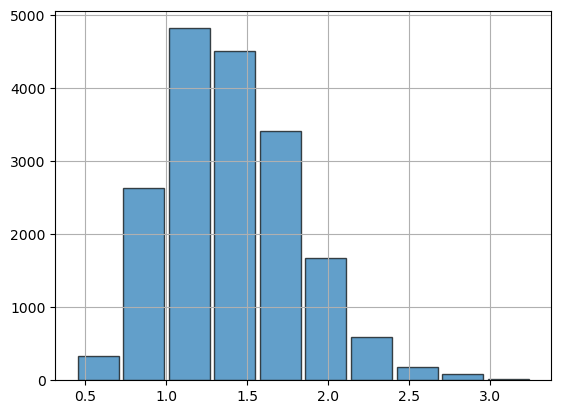

In [36]:
df_to_analyze = df[lst_all_numerical_cols]

df_to_analyze[df_to_analyze.columns[0]].hist(alpha=0.7, rwidth=0.9, edgecolor='black', density=False);
#sns.kdeplot(df_to_analyze[df_to_analyze.columns[0]], color='red', fill=False);

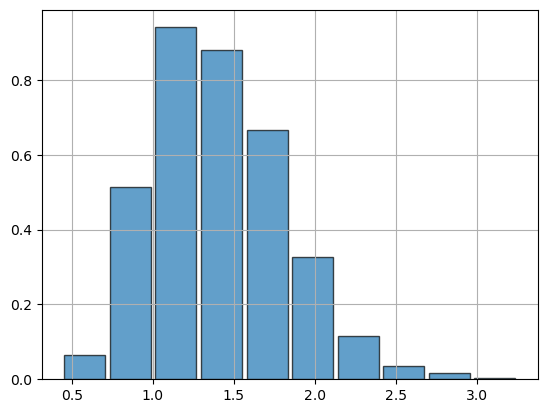

In [37]:
df_to_analyze = df[lst_all_numerical_cols]

df_to_analyze[df_to_analyze.columns[0]].hist(alpha=0.7, rwidth=0.9, edgecolor='black', density=True);
#sns.kdeplot(df_to_analyze[df_to_analyze.columns[0]], color='red', fill=False);

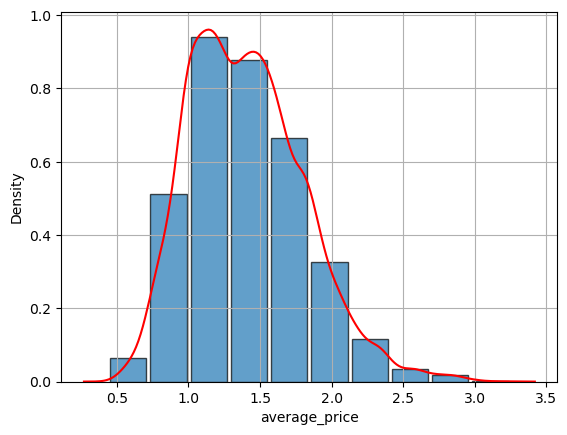

In [38]:
df_to_analyze = df[lst_all_numerical_cols]

df_to_analyze[df_to_analyze.columns[0]].hist(alpha=0.7, rwidth=0.9, edgecolor='black', density=True);
sns.kdeplot(df_to_analyze[df_to_analyze.columns[0]], color='red', fill=False);

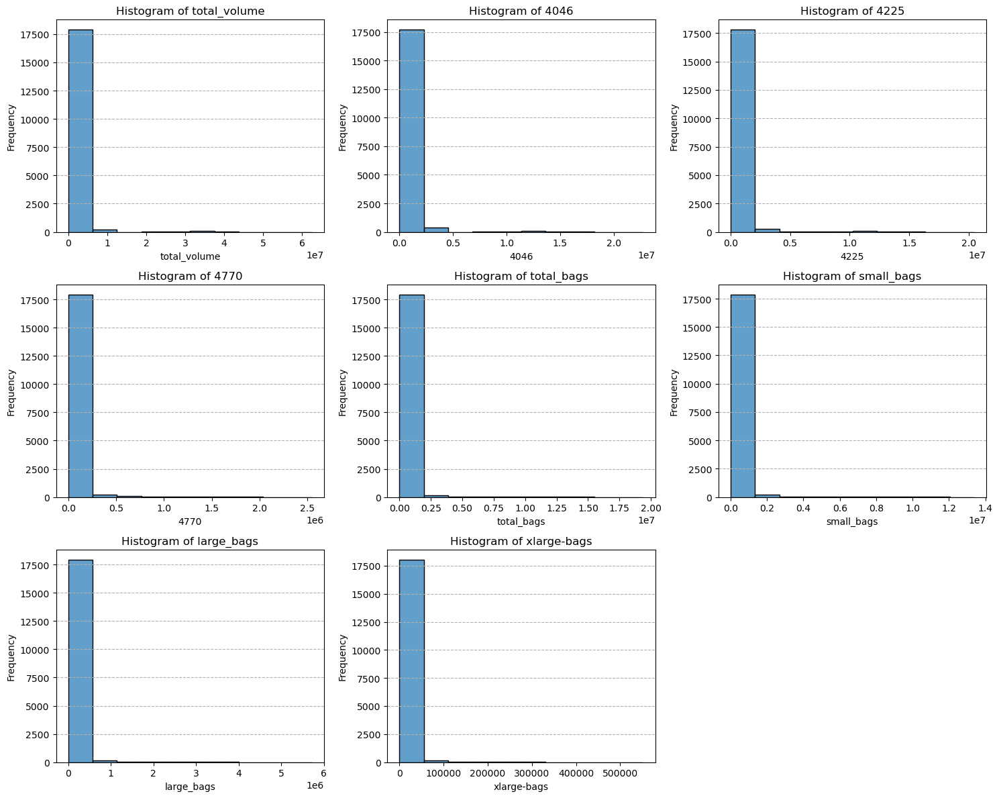

CPU times: user 1.79 s, sys: 7.8 ms, total: 1.8 s
Wall time: 4.49 s


In [39]:
%%time

# create 2X2 grid for subplots
#fig, axes = plt.subplots(2, 2, figsize=(10, 8), sharex=True, sharey=True)
#fig, axes = plt.subplots(2, 2, figsize=(10, 8)) # uncomment above to share same x and y scale

# set df to analyze
df_to_analyze = df_X_features


# set num rows and cols
num_cols = 3
num_rows = int(np.ceil(len(df_to_analyze.columns)/num_cols))

# create grid for subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 4*num_cols), sharex=False, sharey=False)

# flatten subplot for iteration
axes = axes.flatten()


# plot histogram in each subplot
for i, attr in enumerate(df_to_analyze.columns):
    #axes[i].hist(df_to_analyze[attr], bins=10, edgecolor='black', alpha=0.7) # can specify number of bins
    #axes[i].hist(df_to_analyze[attr], edgecolor='black', alpha=0.7) #df_to_analyze[attr], ax=axes[i], 
    
    sns.histplot(df_to_analyze[attr], bins=10, kde=False, edgecolor='black', alpha=0.7, ax=axes[i])

    
    
    axes[i].set_title(f'Histogram of {attr}')
    axes[i].set_xlabel(attr)
    axes[i].set_ylabel('Frequency')
    axes[i].tick_params(axis='both', which='both', labelsize=10)
    axes[i].grid(True, axis='y', linestyle='--')

# Hide unused subplots if num_cols * num_rows > num features
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])


plt.tight_layout()
plt.show()

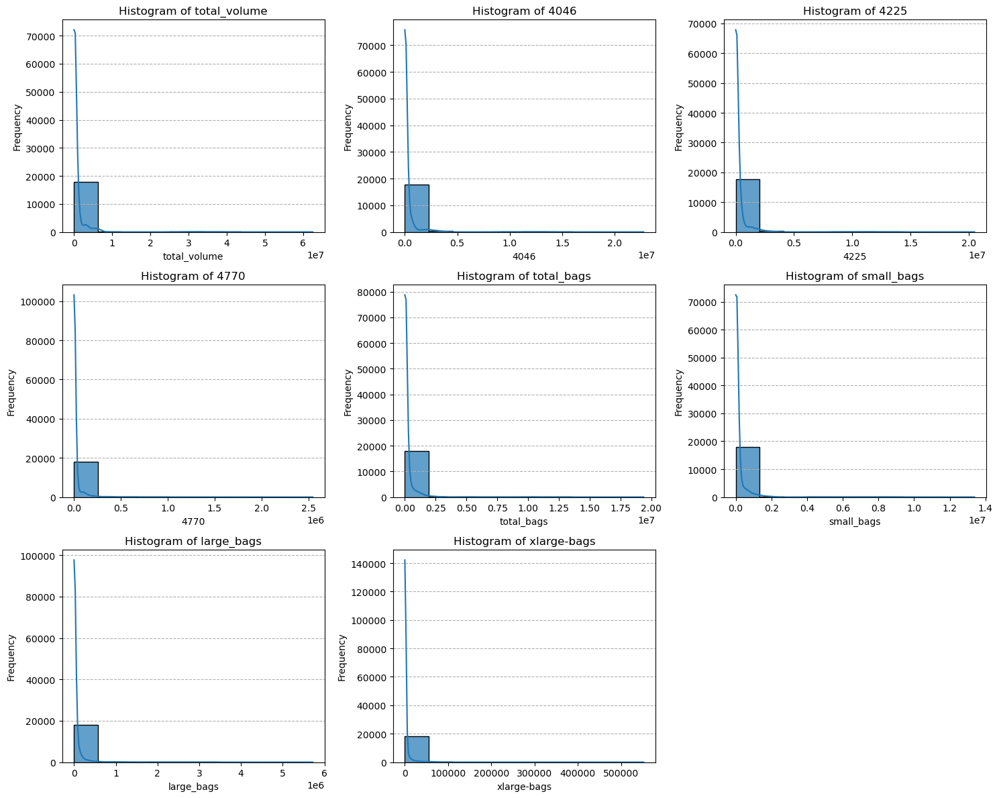

CPU times: user 2.92 s, sys: 11.9 ms, total: 2.93 s
Wall time: 9.88 s


In [40]:
%%time

# create 2X2 grid for subplots
#fig, axes = plt.subplots(2, 2, figsize=(10, 8), sharex=True, sharey=True)
#fig, axes = plt.subplots(2, 2, figsize=(10, 8)) # uncomment above to share same x and y scale

# set df to analyze
df_to_analyze = df_X_features


# set num rows and cols
num_cols = 3
num_rows = int(np.ceil(len(df_to_analyze.columns)/num_cols))

# create grid for subplots
fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 4*num_cols), sharex=False, sharey=False)

# flatten subplot for iteration
axes = axes.flatten()


# plot histogram in each subplot
for i, attr in enumerate(df_to_analyze.columns):
    #axes[i].hist(df_to_analyze[attr], bins=10, edgecolor='black', alpha=0.7) # can specify number of bins
    #axes[i].hist(df_to_analyze[attr], edgecolor='black', alpha=0.7) #df_to_analyze[attr], ax=axes[i], 
    
    sns.histplot(df_to_analyze[attr], bins=10, kde=True, edgecolor='black', alpha=0.7, ax=axes[i])

    
    
    axes[i].set_title(f'Histogram of {attr}')
    axes[i].set_xlabel(attr)
    axes[i].set_ylabel('Frequency')
    axes[i].tick_params(axis='both', which='both', labelsize=10)
    axes[i].grid(True, axis='y', linestyle='--')

# Hide unused subplots if num_cols * num_rows > num features
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])


plt.tight_layout()
plt.show()

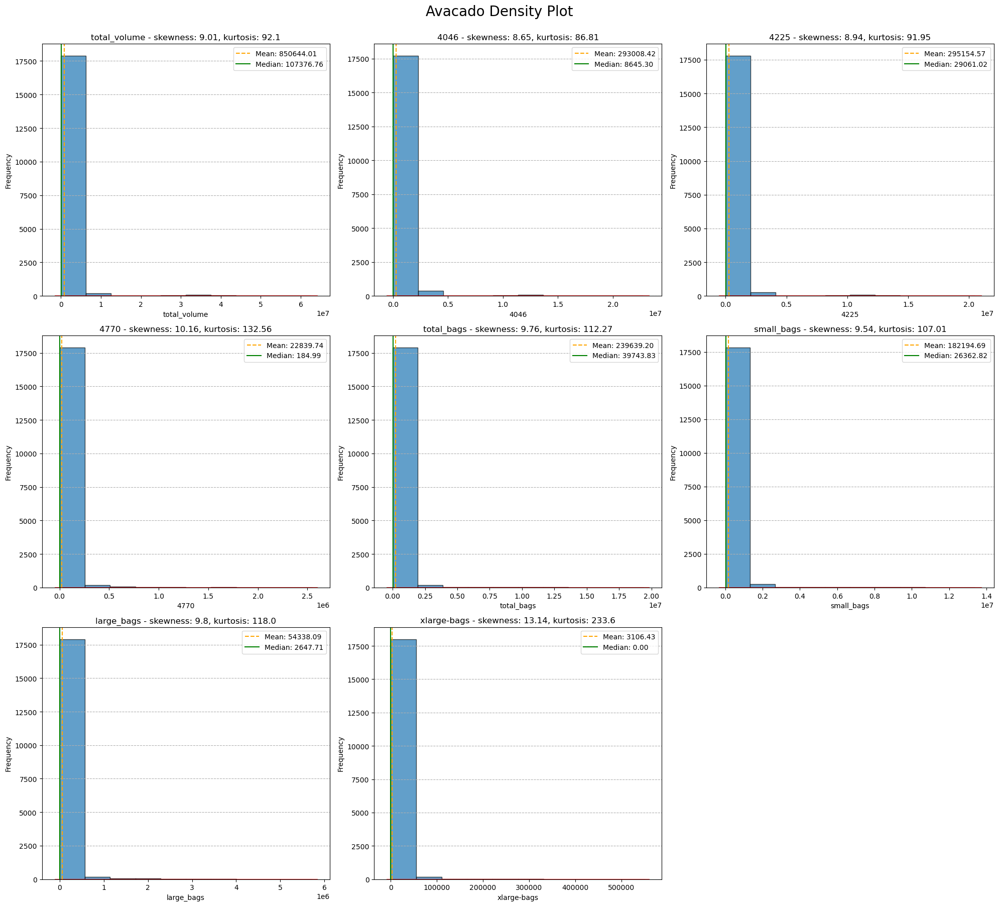

In [41]:
################################################
# call fcn - density
################################################
display_hist_kde_plot(df_X_features, False, 3, "Avacado Density Plot")

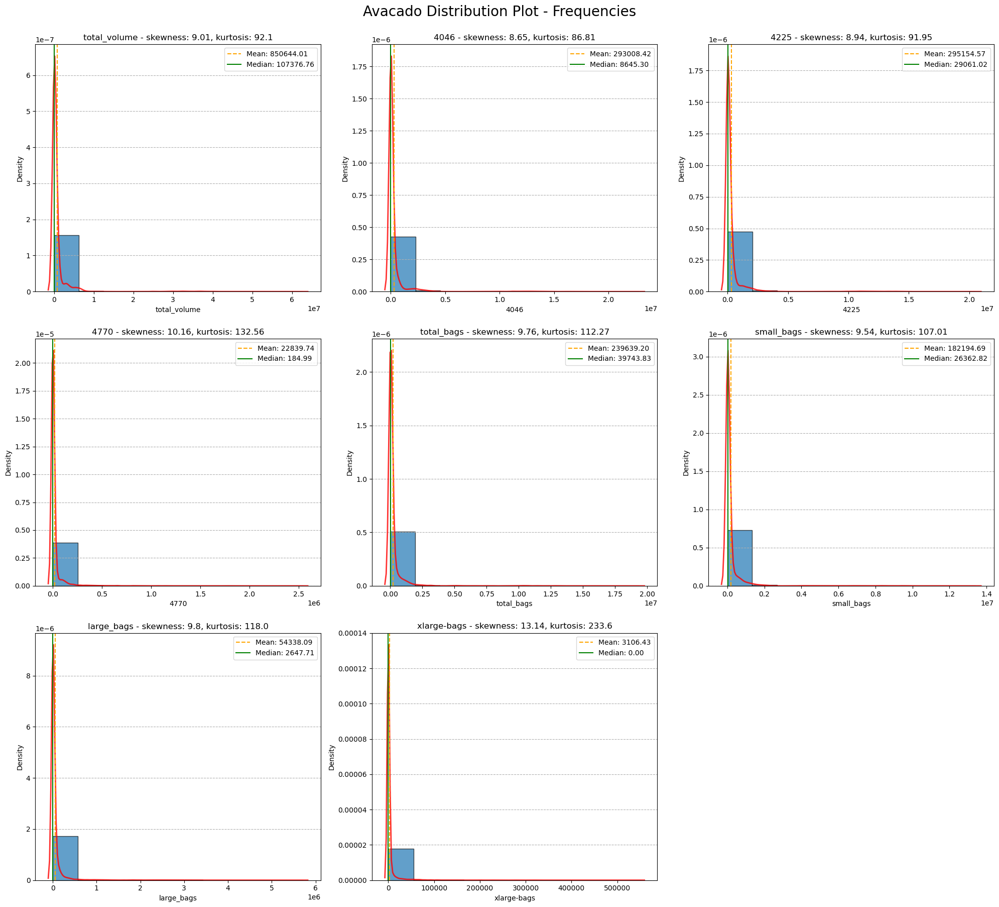

CPU times: user 3.23 s, sys: 10.7 ms, total: 3.24 s
Wall time: 8.95 s


In [42]:
%%time

################################################
# call fcn - frequency
################################################
display_hist_kde_plot(df_X_features, True, 3, "Avacado Distribution Plot - Frequencies")

# Large tails of kde suggest significant outliers that we should deal with later

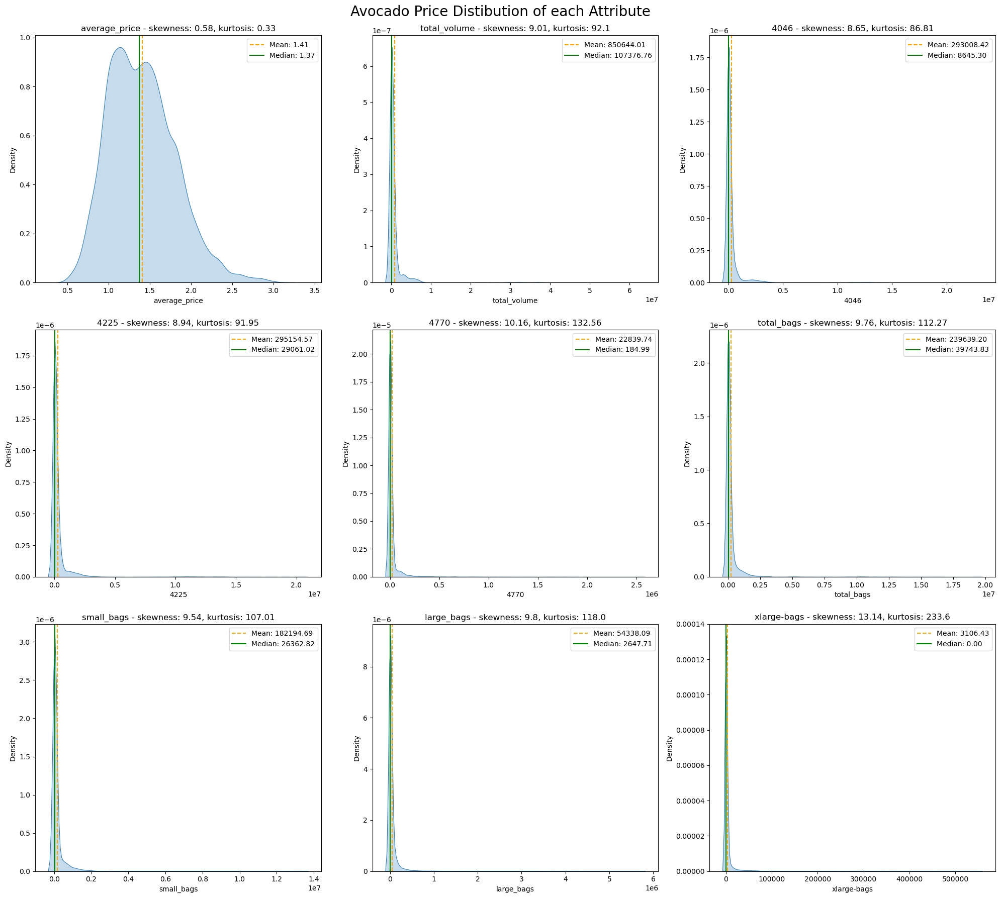

In [43]:
################################################
# call fcn - density
################################################
plot_kde_histplot(df[lst_all_numerical_cols], True, 3, 'Avocado Price Distibution of each Attribute')
plt.tight_layout()

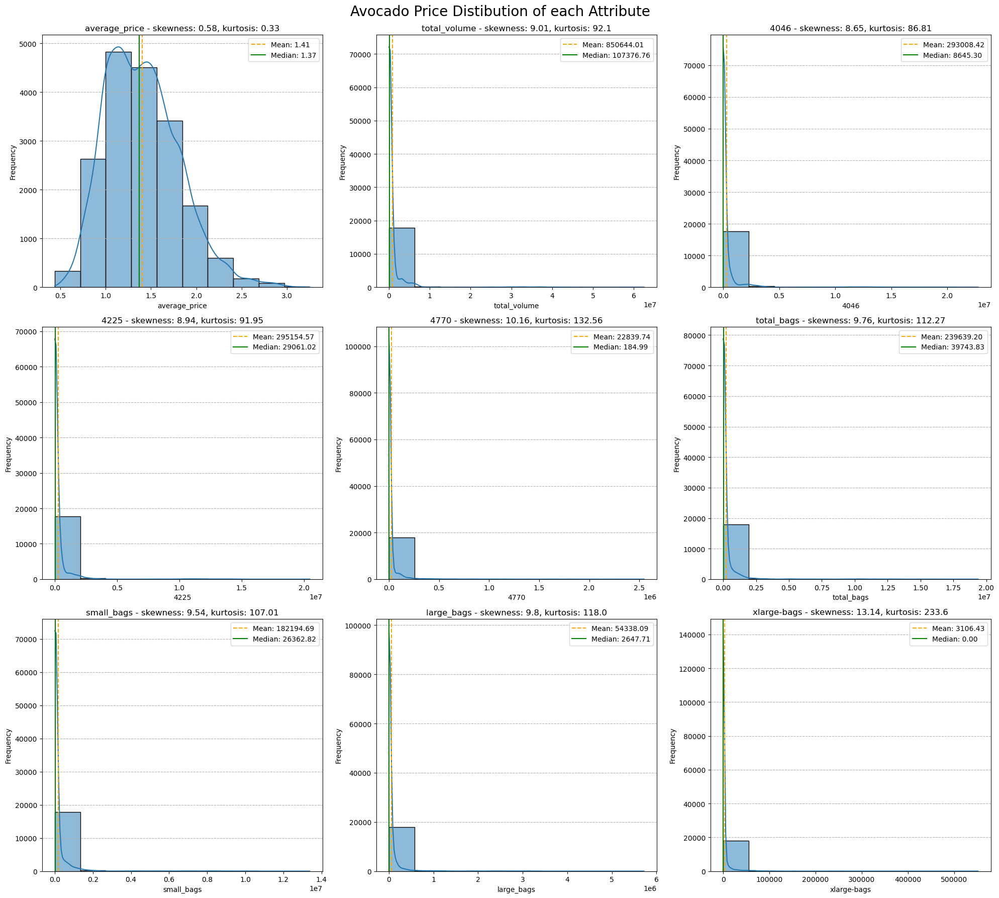

In [44]:
################################################
# call fcn - frequency
################################################
plot_kde_histplot(df[lst_all_numerical_cols], False, 3, 'Avocado Price Distibution of each Attribute')
plt.tight_layout()

# <b>View Boxplot of Features - Understand centrality of our data</b>

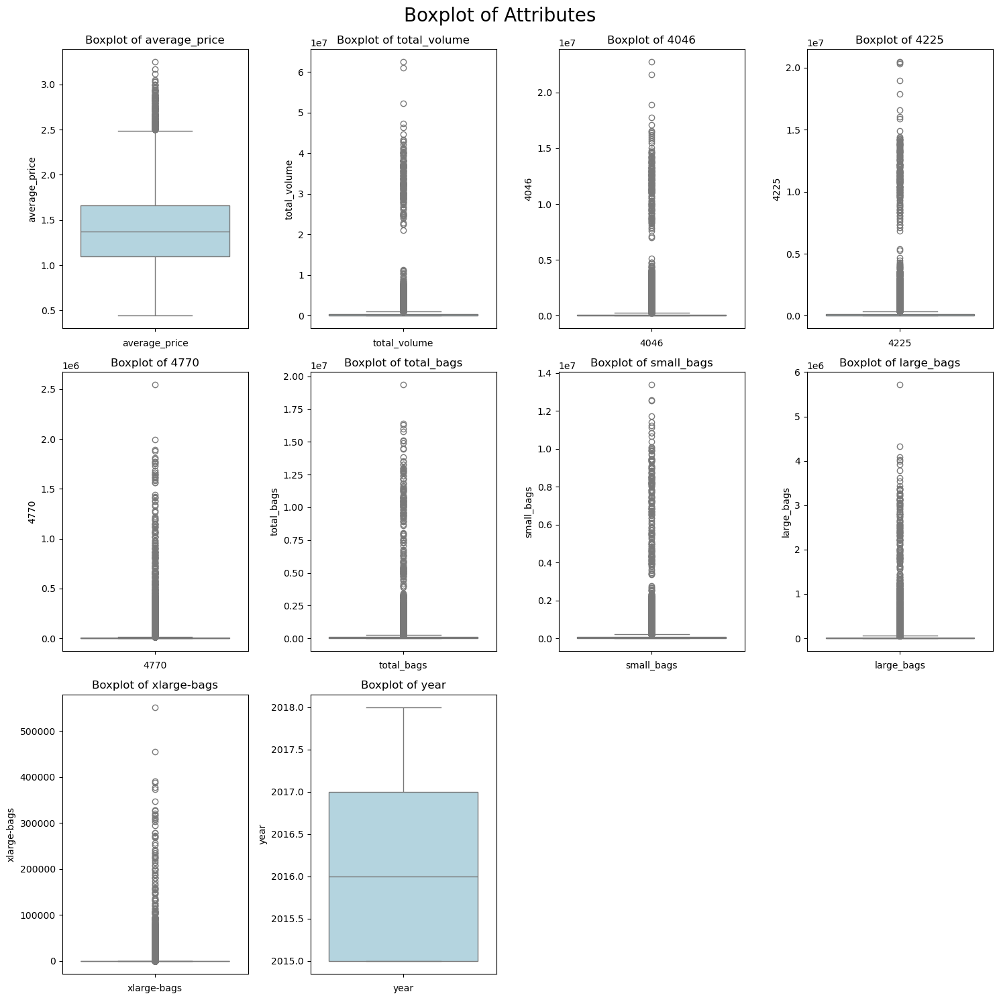

CPU times: user 1.93 s, sys: 24.4 ms, total: 1.95 s
Wall time: 3.17 s


In [45]:
%%time

def plot_boxplot(df_to_analyze, plot_title, include_swarmplot):
    # set num rows
    num_cols = 4
    num_rows = int(np.ceil(len(df_to_analyze.columns)/num_cols))
    
    fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 5 * num_rows))  
    axes = axes.flatten()  # Flatten axes for easy iteration

    fig.suptitle(plot_title,y=0.99, size=20)
    
    for i, attr in enumerate(df_to_analyze.columns):
        sns.boxplot(y=df_to_analyze[attr], ax=axes[i], color='lightblue')

        if include_swarmplot:
            sns.swarmplot(y=attr, data=df_to_analyze)
        
        axes[i].set_title(f'Boxplot of {attr}')    
        axes[i].set_xlabel(attr)
        axes[i].tick_params(axis='both', which='both', labelsize=10)
    
    
    # Hide unused subplots (if any)
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])
    
    plt.tight_layout()
    plt.show()

################################################
# call fcn - sns boxplot
################################################
#df_to_analyze = df[lst_all_numerical_cols]
df_to_analyze = df.select_dtypes(include=[np.number])
plot_boxplot(df_to_analyze, "Boxplot of Attributes", False)

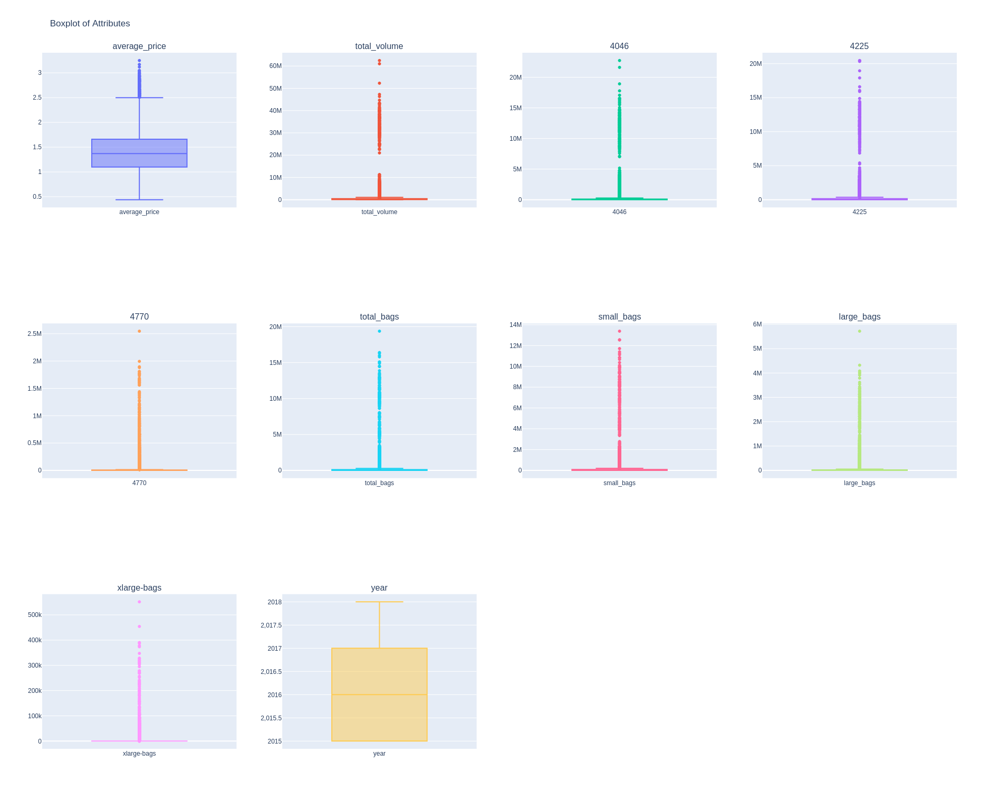

In [46]:
################################################
# call fcn - plotly.go
################################################
df_to_analyze = df.select_dtypes(include=[np.number])
plot_boxplot_plotly(df_to_analyze, "Boxplot of Attributes", None)
#plot_boxplot_plotly(df_to_analyze, "Boxplot of Attributes", 'blue')

# <b><u>Bivariate Analysis </b></u>

# Correlation Analysis

In [47]:
df_to_analyze = df

correlation_matrix = df_to_analyze.corr(numeric_only=True)
correlation_matrix

,average_price,total_volume,4046,4225,4770,total_bags,small_bags,large_bags,xlarge-bags,year
average_price,1.000000,-0.192752,-0.208317,-0.172928,-0.179446,-0.177088,-0.174730,-0.172940,-0.117592,0.093197
total_volume,-0.192752,1.000000,0.977863,0.974181,0.872202,0.963047,0.967238,0.880640,0.747157,0.017193
4046,-0.208317,0.977863,1.000000,0.926110,0.833389,0.920057,0.925280,0.838645,0.699377,0.003353
4225,-0.172928,0.974181,0.926110,1.000000,0.887855,0.905787,0.916031,0.810015,0.688809,-0.009559
4770,-0.179446,0.872202,0.833389,0.887855,1.000000,0.792314,0.802733,0.698471,0.679861,-0.036531
total_bags,-0.177088,0.963047,0.920057,0.905787,0.792314,1.000000,0.994335,0.943009,0.804233,0.071552
small_bags,-0.174730,0.967238,0.925280,0.916031,0.802733,0.994335,1.000000,0.902589,0.806845,0.063915
large_bags,-0.172940,0.880640,0.838645,0.810015,0.698471,0.943009,0.902589,1.000000,0.710858,0.087891
xlarge-bags,-0.117592,0.747157,0.699377,0.688809,0.679861,0.804233,0.806845,0.710858,1.000000,0.081033
year,0.093197,0.017193,0.003353,-0.009559,-0.036531,0.071552,0.063915,0.087891,0.081033,1.000000


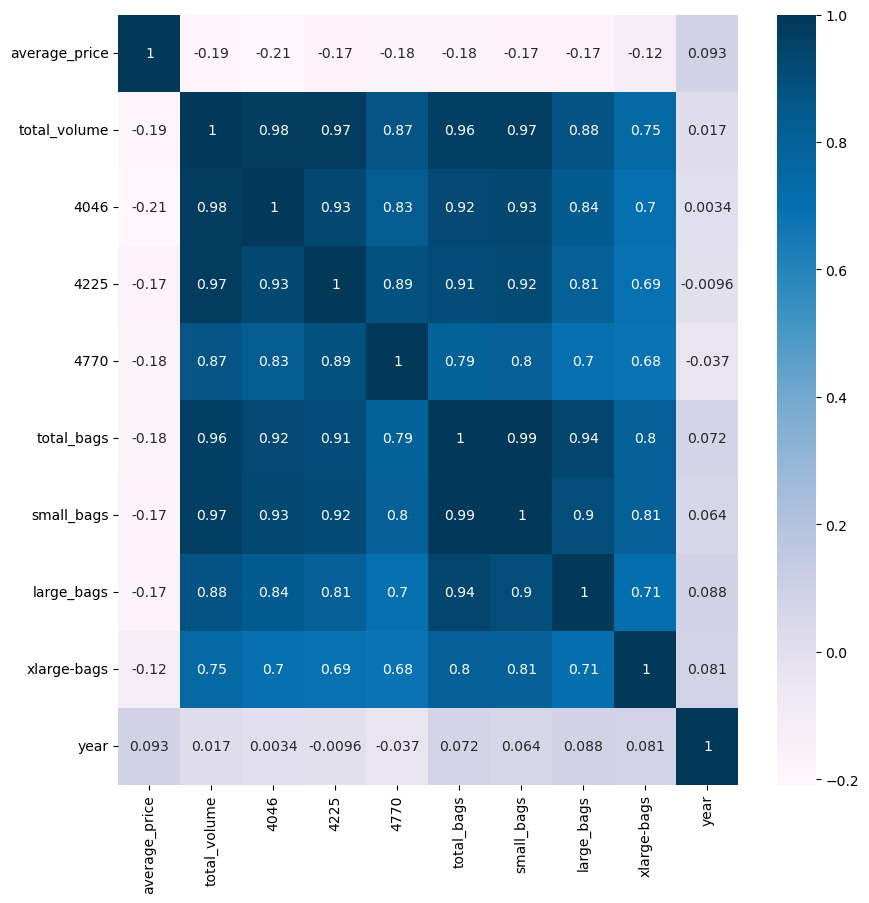

In [48]:
plt.figure(figsize=(10, 10)) 
sns.heatmap(correlation_matrix, annot=True, cmap='PuBu');

# Scatterplot

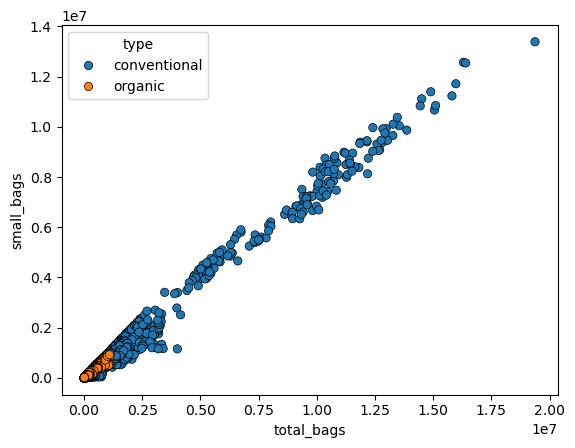

In [49]:
sns.scatterplot(data=df, x='total_bags', y='small_bags', hue='type', edgecolor='black');

# linear model plot --> scatter plot with a regression line

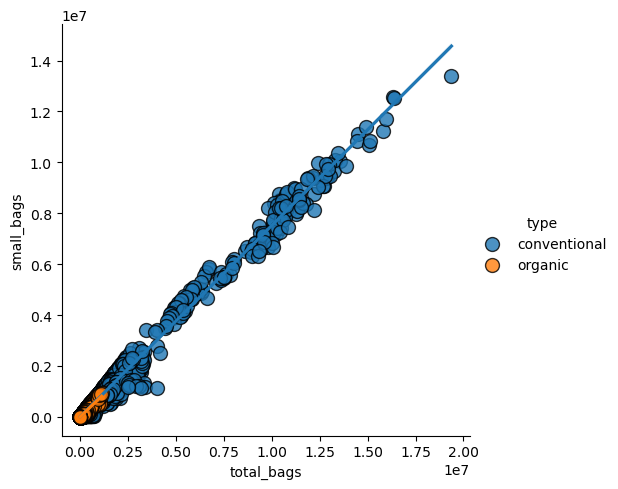

In [50]:
# linear model plot --> scatter plot with a regression line
# shaded region represents the 95% confidence interval (which is directly related to standard error of measurement)
sns.lmplot(data=df, x='total_bags', y='small_bags', hue='type', scatter_kws={'edgecolor': 'k', 's': 100});

# Violinplot

<Axes: xlabel='type', ylabel='average_price'>

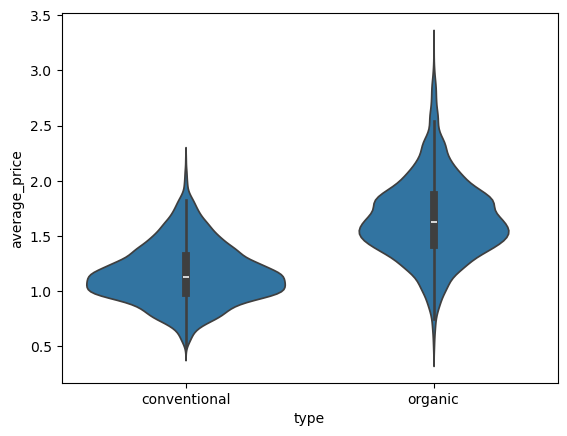

In [51]:
sns.violinplot(x='type', y='average_price',data=df)

# Pairplot

CPU times: user 1min 29s, sys: 127 ms, total: 1min 29s
Wall time: 2min 27s


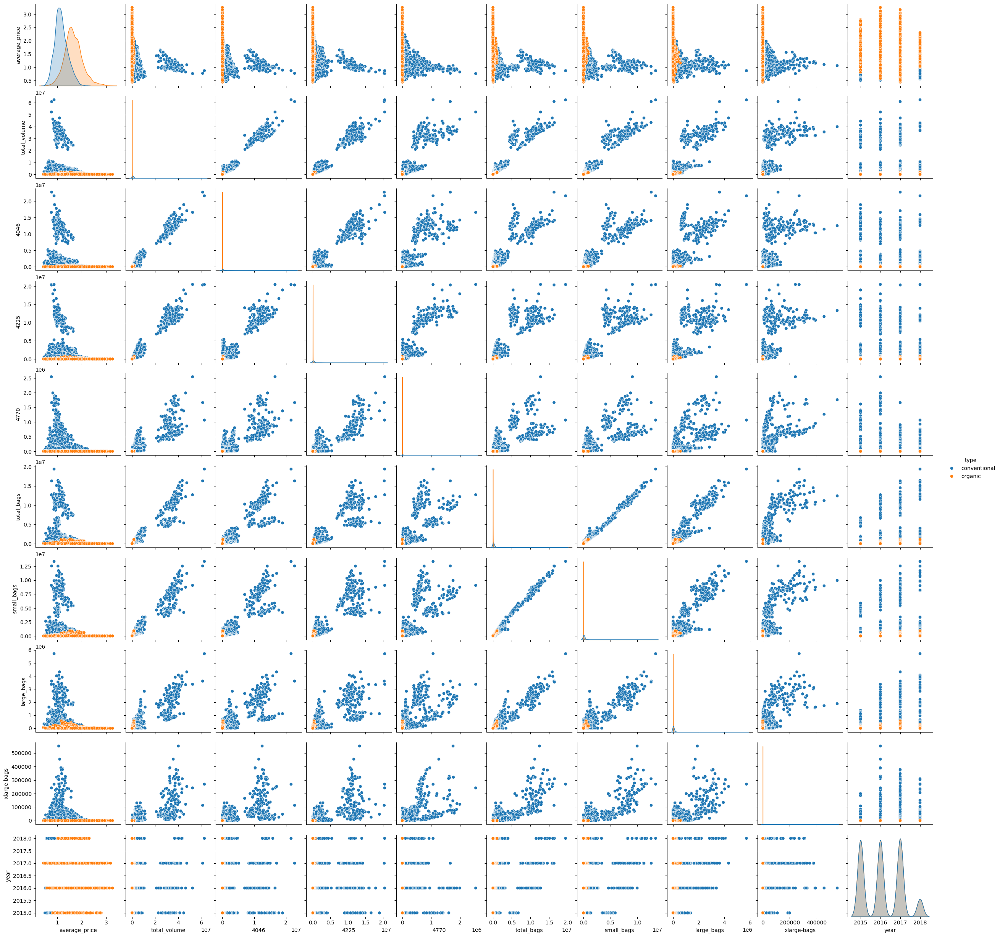

In [52]:
%%time

df_to_analyze = df

sns.pairplot(df_to_analyze, diag_kind='kde', hue="type");

# Plot Error Bar of Distribution of Features

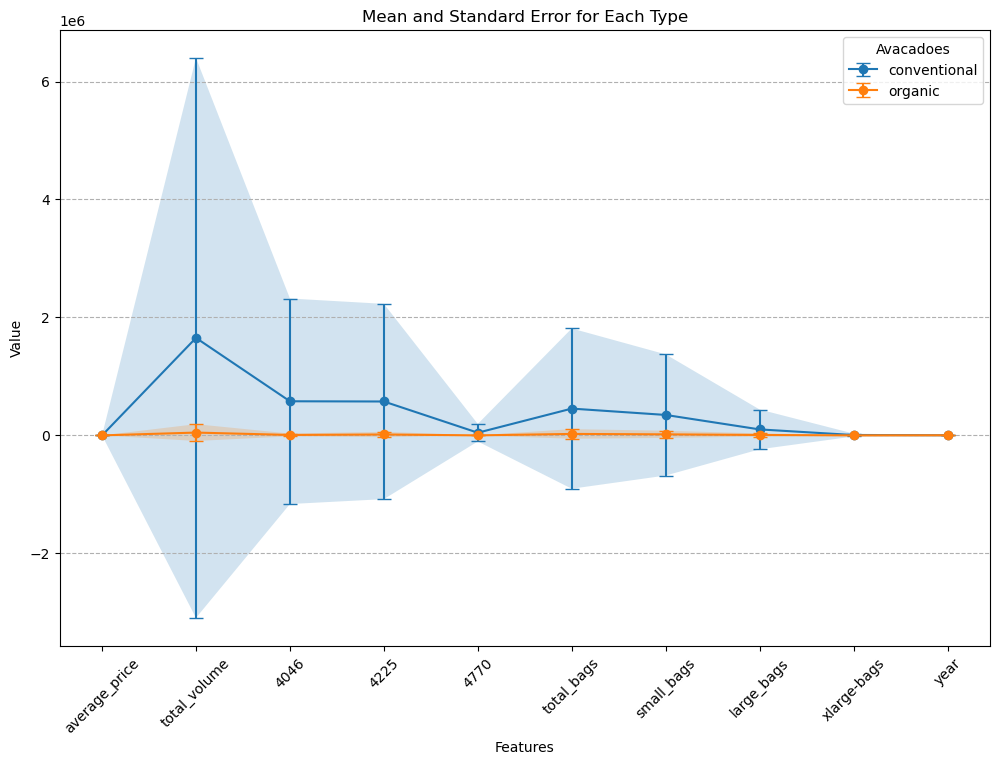

In [53]:
def plot_error_bar(df_to_analyze, show_error_bar, plot_std_error, chart_title):


    # Calculate the mean and standard deviation for each feature grouped by category
    mean_values = df_to_analyze.groupby('type').mean()
    std_values = df_to_analyze.groupby('type').std()
    std_err_values = std_values / np.sqrt(df_to_analyze.groupby('type').count())
    
    # determine which bar to plot
    lst_error_bar = std_values
    
    if plot_std_error:
        lst_error_bar = std_err_values
    
    # Set up the plot
    plt.figure(figsize=(12, 8))
    
    # Plotting the mean and filling the standard deviation area for each category
    for i, category in enumerate(mean_values.index):
        if plot_error_bar:
            plt.errorbar(mean_values.columns, mean_values.iloc[i], yerr=lst_error_bar.iloc[i], 
                     label=f'{category}', marker='o', capsize=5)
        else:
            plt.plot(mean_values.columns, mean_values.iloc[i], marker='o', label=f'{category}')
        
        plt.fill_between(mean_values.columns,
                         mean_values.iloc[i] - lst_error_bar.iloc[i],
                         mean_values.iloc[i] + lst_error_bar.iloc[i],
                         alpha=0.2)  # Alpha controls the transparency of the fill
    
    # Customizing the plot
    plt.xlabel('Features')
    plt.ylabel('Value')
    plt.title(chart_title)
    plt.legend(title='Avacadoes')
    plt.xticks(rotation=45)  # Rotate x-axis labels by 45 degrees
    plt.grid(True, axis='y', linestyle='--')
    plt.show()

################################################
# call fcn - error bar
################################################
df_to_analyze = df.select_dtypes(include=[np.number])
df_to_analyze['type'] = df['type']  # Add back the 'type' column
show_error_bar = True
plot_std_error = False

plot_error_bar(df_to_analyze, show_error_bar, plot_std_error, 'Mean and Standard Error for Each Type')

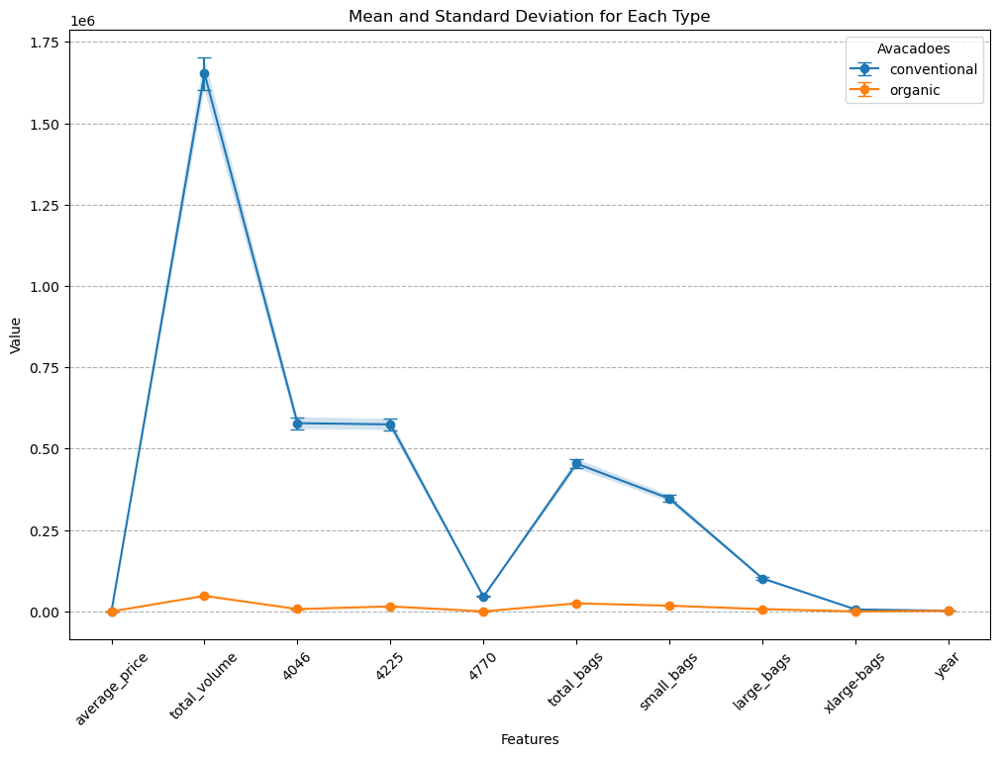

In [54]:
################################################
# call fcn - std dev
################################################
df_to_analyze = df.select_dtypes(include=[np.number])
df_to_analyze['type'] = df['type']  # Add back the 'type' column
show_error_bar = True
plot_std_error = True

plot_error_bar(df_to_analyze, show_error_bar, plot_std_error, 'Mean and Standard Deviation for Each Type')

<hr style="height:30px;color:#000;background-color:#00F;">

# <b>Bifurcate Independent and Dependent Variables</b>

In [55]:
# notify
print('DEPENDENT_VAR_NAME:' + '\n' + ('='*40) + '\n' + DEPENDENT_VAR_NAME)

# assign features
print('\nfeatures\n' + ('='*40))
print(list(lst_features))

# assign y
y = df[DEPENDENT_VAR_NAME]

# notify
print('\nDependent variable y:' + '\n' + ('='*40))
print(f'y is of type {type(y)}    num_rows: {len(y)}')

# assign X
X = df[lst_features]

# notify
print('\nIndependent variables X:' + '\n' + ('='*40))
print(f'X is of type {type(X)}  num_rows: {len(X)}   num_cols: {len(X.columns)}')

DEPENDENT_VAR_NAME:
average_price

features
['total_volume', '4046', '4225', '4770', 'total_bags', 'small_bags', 'large_bags', 'xlarge-bags']

Dependent variable y:
y is of type <class 'pandas.core.series.Series'>    num_rows: 18249

Independent variables X:
X is of type <class 'pandas.core.frame.DataFrame'>  num_rows: 18249   num_cols: 8


# <b>Create Hold-Out (Train and Test Set)</b>

In [56]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=42)

print(f'X_train: {X_train.shape}')
print(f'y_train: {len(y_train)}\n')

print(f'X_test: {X_test.shape}')
print(f'y_test: {len(y_test)}')

X_train: (14599, 8)
y_train: 14599

X_test: (3650, 8)
y_test: 3650


# <b>Standardize the Dataset</b>

In [57]:
SCALE_DATA = True

# assign scaler
scaler = StandardScaler()

# instantiate scaler, fit, and scale X_train
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# store scaler - indicate this is before outlier transformations
dict_standard_scalers['before_transformation'] = scaler

# convert scaled numpy array to pd    
df_X_train = pd.DataFrame(X_train_scaled, columns=X_train.columns)
df_X_test = pd.DataFrame(X_test_scaled, columns=X_test.columns)

# Timestamp

In [58]:
analysis_start_time = datetime.datetime.now()
analysis_start_time_text = get_time()
print(f'ready to train models timestamp: {analysis_start_time_text}')

ready to train models timestamp: 2025-02-24-0714


<hr style="height:30px;color:#000;background-color:#F00;">

# <b> Visualize Standardized Dataset </b>

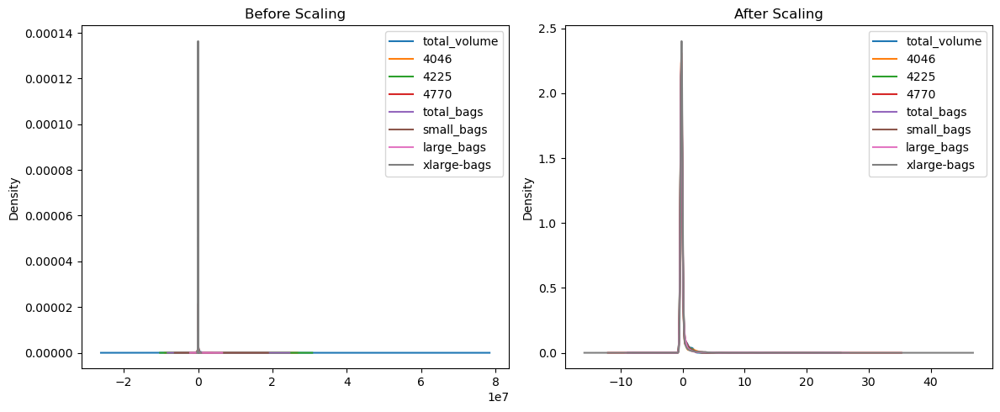

In [59]:
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Before scaling
X_train.plot(kind='kde', ax=axes[0], title="Before Scaling")

# After scaling
df_X_train.plot(kind='kde', ax=axes[1], title="After Scaling")

plt.tight_layout()
plt.show()

# <b>View Boxplot of Standardized Features</b>

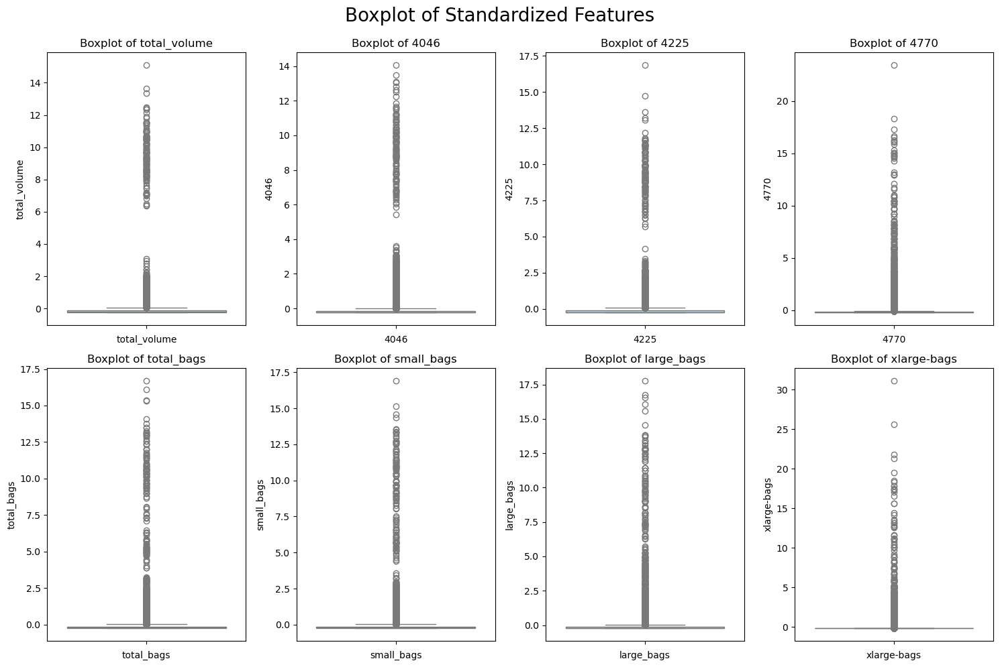

In [60]:
################################################
# call fcn - sns boxplot
################################################
#df_to_analyze = df[lst_all_numerical_cols]
df_to_analyze = df_X_train
plot_boxplot(df_to_analyze, "Boxplot of Standardized Features", False)

# <b>Observations: Our data is still heavily affected by outliers. We will proceed first with modeling the current data to measure performance metrics, then we will adjust outliers and re-model to empirically measure improvements with handling outliers in the dataset</b>

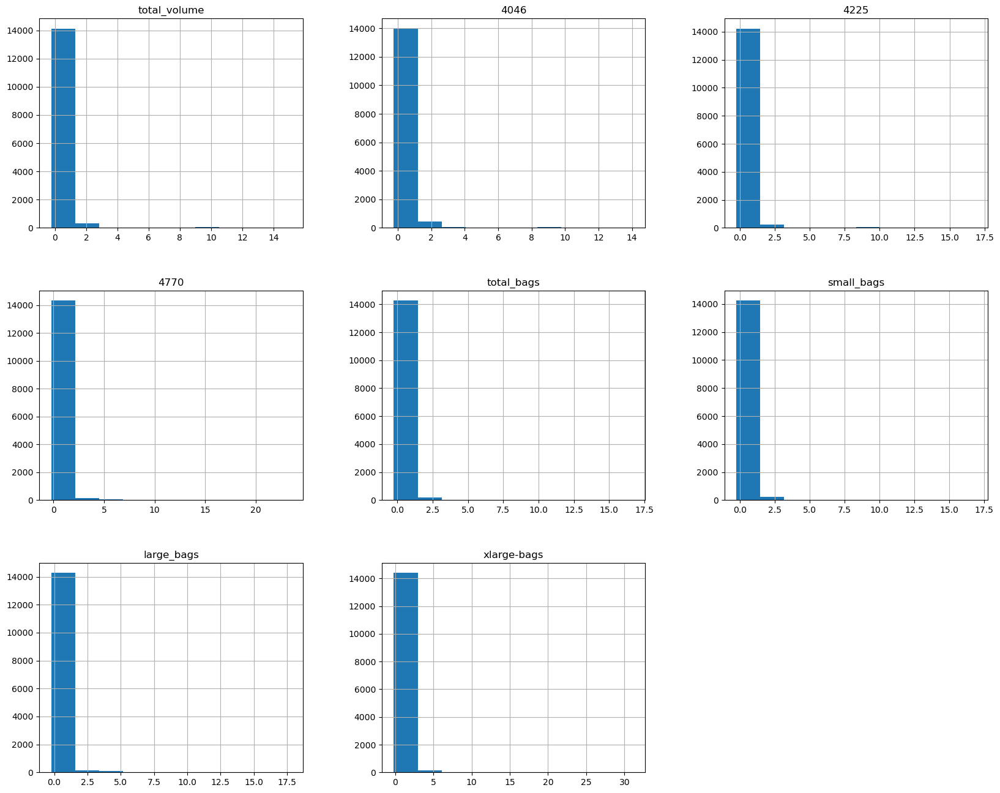

In [61]:
df_to_analyze = df_X_train
df_to_analyze[df_to_analyze.columns].hist(figsize=(20,16));

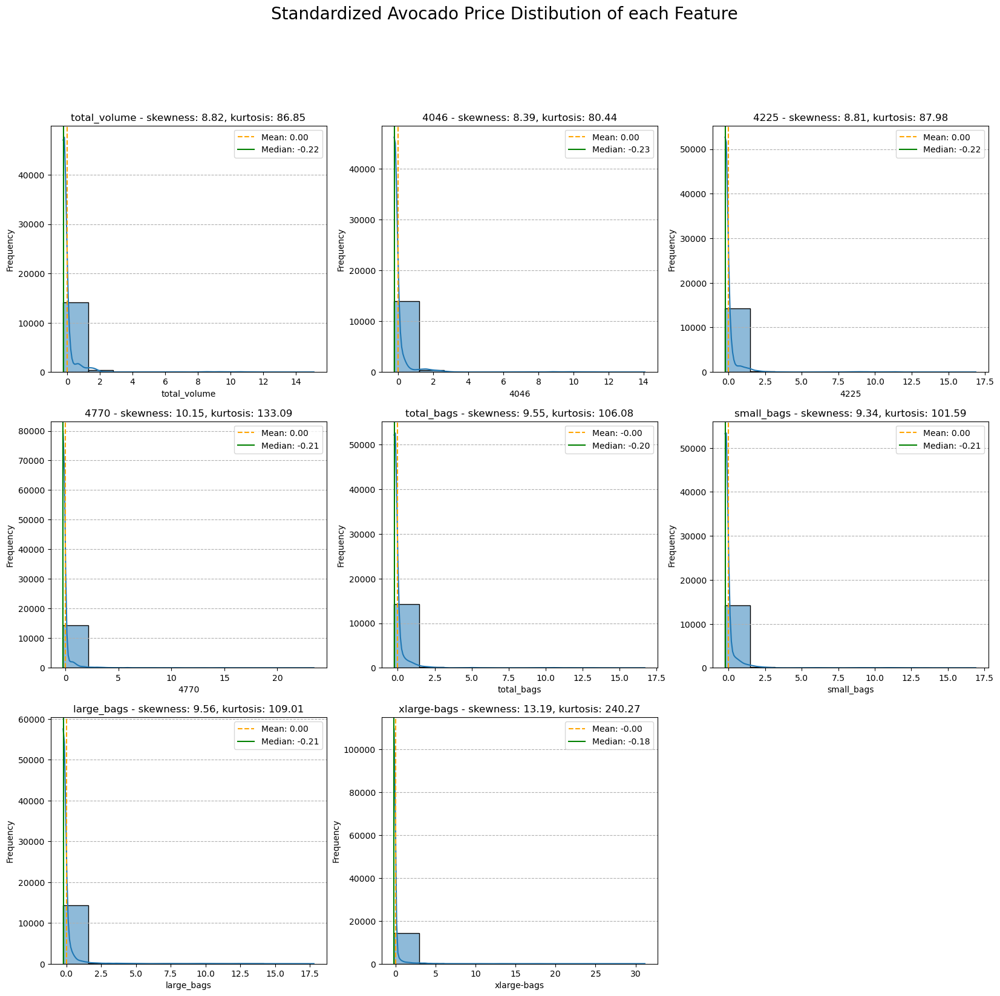

In [62]:
df_to_analyze = df_X_train
plot_kde_histplot(df_to_analyze, False, 3, 'Standardized Avocado Price Distibution of each Feature')

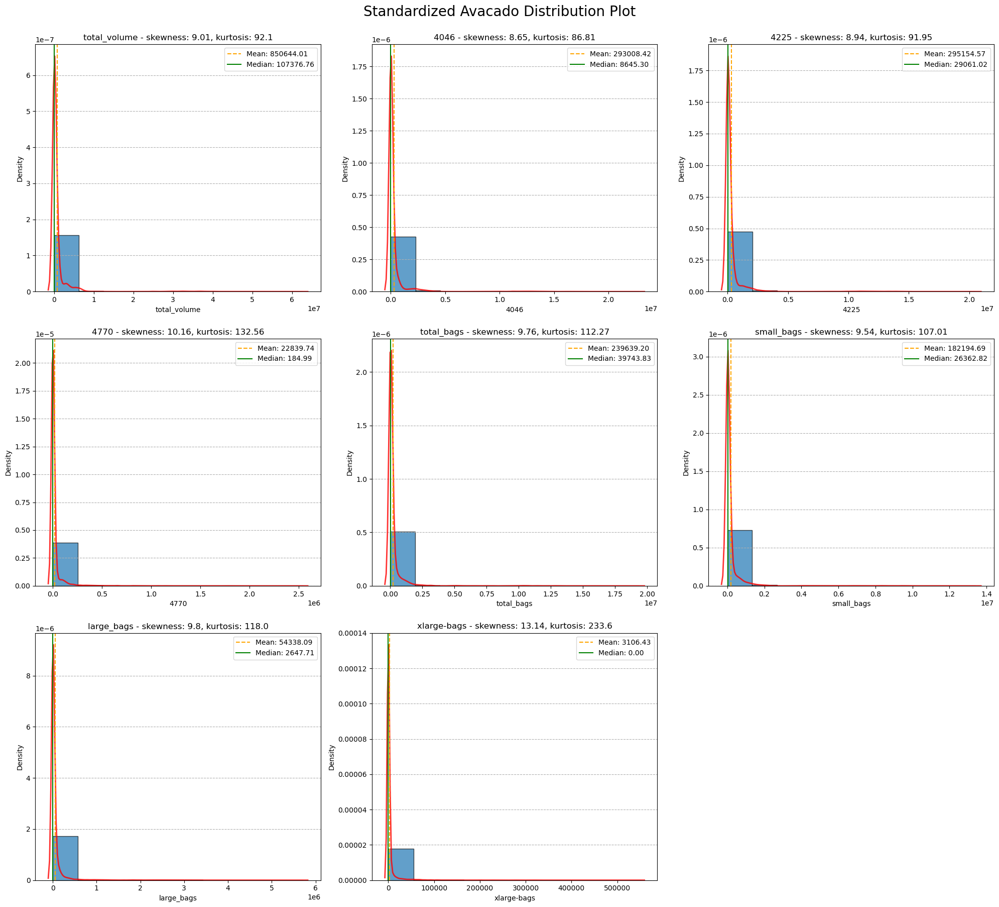

In [63]:
display_hist_kde_plot(df_X_features, True, 3, "Standardized Avacado Distribution Plot")

# <b><span style="color:red;">note: this still looks like there are heavy outliers affecting the datasets. We will proceed with modeling the current data, and then return and repeat after we handle outliers and evaluate if our performance improves</span></b>

<hr style="height:30px;color:#000;background-color:#000;">

# <b><u>Mean Absolute Error (MAE): </b></u>
# <b> $\frac 1n\sum_{i=1}^n|y_i-\hat{y}_i|$ </b>

* $y_i$​ = Actual (ground truth) value
* $\hat{y}_i$​ = Model's predicted value
* n = Number of observations


<b><u>MAE</b></u> is an L1 norm loss function that quantifies the average absolute deviation between the true values and the predicted values. It directly measures the magnitude of prediction errors while ignoring their direction (i.e., whether the error is positive or negative).

Each individual difference between $y_i$​ and $\hat{y}_i$​ is called a residual (error), and taking the absolute value ensures that errors do not cancel out when summed.

The final MAE value represents the mean magnitude of errors across all predictions. 

<b><u>Ideal Score</b></u>
* MAE should be close to 0
* MAE = 0 → Perfect predictions (model predicts every value exactly) - this is rarely achieved in real world scenarios
* Compare to Scale: Always consider the scale of your target variable when interpreting MAE. If your target variable has a large range, a higher MAE might still be acceptable. If your target variable has a small range, even a small MAE might be significant.
* Establish a Baseline: Calculate the MAE of a simple baseline model (e.g., predicting the mean or median). If your model's MAE is significantly lower than the baseline, that's a good indicator.
* Scale Dependence: MAE is in the same units as your target variable. An MAE of 10 might be excellent for predicting house prices (where values are in the hundreds of thousands) but terrible for predicting something like test scores (where values are typically between 0 and 100).

<hr style="height:10px;color:#000;background-color:#00F;">

# <b><u>Mean Squared Error (MSE):</u></b>
# <b> $\frac 1n\sum_{i=1}^n(y_i-\hat{y}_i)^2$ </b>

* $y_i$ = Actual (ground truth) value
* $\hat{y}_i$ = Model's predicted value
* n = Number of observations

<b><u>MSE</b></u> is an L2 norm loss function that measures the mean of the squared difference between the ground truth values and the model's predicted values in the dataset.  Squaring the residual serves two purposes: it ensures a positive sum (so we can compare models) and it penalizes larger errors more heavily than smaller errors. This is often desirable because large errors can be more problematic in practice. However, this squaring operation also means that MSE is in *squared units* of the target variable (e.g., (dollars)^2 if predicting prices), making it sometimes difficult to interpret directly.

These squared residuals are summed and then divided by the cardinality of values in the model's validation set (<b><u><i>n</b></u></i>) to give us this model's MSE.  The square root of MSE gives us the Root Mean Squared Error (RMSE), which is in the same units as the target variable and is often easier to interpret.

MSE is sensitive to outliers.  If your data contains outliers, other metrics like Mean Absolute Error (MAE) might be more appropriate.

MSE is most appropriate when you want to heavily penalize large errors and when the underlying data is assumed to be normally distributed (or at least doesn't have heavy tails/outliers).

<b><u>Ideal Score</u></b>
* MSE should be close to 0
* MSE of 0 indicates that your model's predictions are perfectly accurate, with no difference between the predicted values and the actual (ground truth) values.
* Close to 0 → Excellent model (low error)
* Small (relative to y) → Good model
* Large (relative to y) → Poor model (high prediction error)

<hr style="height:10px;color:#000;background-color:#00F;">

# <b><u>Root Mean Squared Error (RMSE):</u></b>
# <b> $\sqrt{\frac 1n\sum_{i=1}^n(y_i-\hat{y}_i)^2}$ </b>

* $y_i$ = Actual (ground truth) value
* $\hat{y}_i$ = Model's predicted value
* n = Number of observations

<b><u>RMSE</b></u> is the square root of MSE.  It measures the standard deviation of the residuals (the differences between the actual and predicted values) meaning it tells us how much predictions deviate from actual values on average..  A key advantage of RMSE is that it is in the *same units* as the target variable, making it much easier to interpret than MSE.  For example, an RMSE of 10 (if your target variable is in dollars) means that, on average, the model's predictions are about $10 away from the actual values.

RMSE tells us the typical distance between the predicted value made by the regression model and the actual value.  Because it's based on squared errors, RMSE, like MSE, is sensitive to outliers. Since RMSE squares the errors before averaging, large errors have a greater impact than smaller ones, making RMSE more sensitive to outliers compared to MAE.

RMSE is a good general-purpose metric for regression problems, particularly when you want to penalize larger errors more heavily and when the target variable is roughly normally distributed.

<b><u>Ideal Score</u></b>
* RMSE should be as close to 0 as possible → Perfect predictions.
* Lower RMSE indicates better model performance, but the acceptable range depends on the scale of y.

<b><u>RMSE vs. Other Metrics</b></u>:

* RMSE vs. MAE: RMSE penalizes large errors more heavily than MAE, so if minimizing large errors is important, RMSE is preferred.
* RMSE vs. MSE: RMSE is in the same units as yy, making it easier to interpret than MSE.

source: Marcin Rutecki, "Multicollinearity - detection and remedies", https://www.kaggle.com/code/marcinrutecki/multicollinearity-detection-and-remedies, Retrieved 2025-02-18

<hr style="height:10px;color:#000;background-color:#00F;">

# <b><u>R-Squared (R2) (Coefficient of Determination): </b></u>
# <b> $R^2 = 1- \frac {SSR}{SST}$ </b>

* SST (or TSS) == Sum of Squares Total (or Total Sum of Squares): the squared differences between the observed dependent variable and its mean.
* SSR (or RSS) == Sum of Squares Regression (SSR or RSS) is the sum of the differences between the predicted value and the mean of the dependent variable.
* SSE (or ESS) == Sum of Squares Error (SSE or ESS) is the difference between the observed value and the predicted value.

<b><u>R2</b></u> aka the Coefficient of Determination or R-squared represents the proportion of the variance in the dependent variable which is explained by the linear regression model. When R² is high, it represents that the regression can capture much of variation in observed dependent variables. That’s why we can say the regression model performs well when R² is high.

$$R^2 = 1- \frac {SSR}{SST}$$

It is a scale-free score i.e. irrespective of the values being small or large, the value of R square will be less than one. One misconception about regression analysis is that a low R-squared value is always a bad thing. For example, some data sets or fields of study have an inherently greater amount of unexplained variation. In this case, R-squared values are naturally going to be lower. Investigators can make useful conclusions about the data even with a low R-squared value.

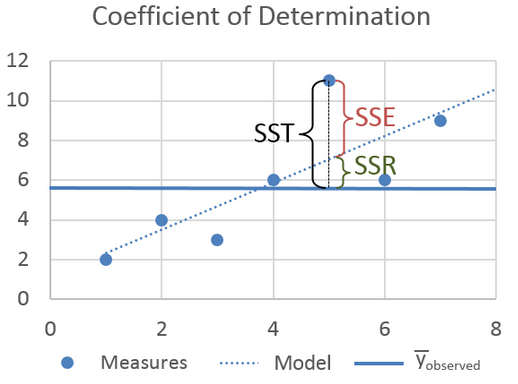

R2 tells us how well the predictor variables can explain the variation in the response variable.

<b><u>Ideal Values and Interpretations:</b></u>
* $R^2$ should be as high as possible, closest to 1
* $R^2=1$ →  All the variation in the y values is accounted for by the x values.
* $R^2=0.83$ →  83% of the variation in the y values is accounted for by the x values.
* $R^2=0$ → None of the variation in the y values is accounted for by the x values.

source: Marcin Rutecki, "Multicollinearity - detection and remedies", https://www.kaggle.com/code/marcinrutecki/multicollinearity-detection-and-remedies, Retrieved 2025-02-18

<hr style="height:10px;color:#000;background-color:#00F;">

# <b><u>Adjusted R-Squared : </b></u>
# <b> $R^2_{adj.} = 1 - (1-R^2)*\frac{n-1}{n-p-1}$ </b>


* n: number of observations (sample size)
* p: the number of predictor variables (independent variables in the model)

Adjusted R squared is a modified version of R square, and it is adjusted for the number of independent variables in the model, and it will always be less than or equal to R².In the formula above, n is the number of observations in the data and k is the number of the independent variables in the data.  

Unlike $R^2$, which always increases when more variables are added, Adjusted $R^2$​ only increases if the new variable improves model performance.

<b><u>Benefits of Adjusted R2:</b></u>
* Accounts for the number of predictors → Unlike regular R2R2, adjusted R2R2 penalizes adding more variables.
* Prevents overfitting → If you add an unnecessary predictor, adjusted R2R2 can decrease.

<b><u>Ideal Score</b></u>
* Just like regular R-squared, the ideal value for adjusted R-squared is 1.  This would indicate a perfect model fit, explaining 100% of the variance, and doing so with the optimal set of predictors (no unnecessary variables).
* $R^2_{adj.}$ =1 → Perfect model (explains all variance).
* $R^2_{adj.}$ =0 → Model does no better than the mean of yy.
* Negative $R^2_{adj.}$​ → Worse than a simple mean model (overfitting or poor feature selection).
* $R^2_{adj.}$ > 0.7 → Strong Model
* $R^2_{adj.}$ 0.5 - 0.7 → Moderate predictive power
* $R^2_{adj.}$ < 0.5 → Weak model; consider feature selection or transformations.





source: Marcin Rutecki, "Multicollinearity - detection and remedies", https://www.kaggle.com/code/marcinrutecki/multicollinearity-detection-and-remedies, Retrieved 2025-02-18

<hr style="height:10px;color:#000;background-color:#00F;">

# <b><u>Cross-Validated R-Squared ($ R^2_{\text{cv}} $)</b></u>:
# <b> $R^2_{\text{cv}} = \frac{1}{K} \sum_{i=1}^{K} R^2_{\text{fold}_i}$ </b>

* $ R^2_{\text{cv}}$ = Mean cross-validated $R^2$ score  
* $ K$ = Number of folds in cross-validation  
* $ R^2_{\text{fold}_i}$ = $R^2$ score from the $i$-th fold  

Cross-validation is a resampling procedure used to evaluate machine learning models on a limited data sample. It involves partitioning the available data into *k* subsets (or folds), training the model *k* times, each time leaving out one of the folds for testing, and then averaging the performance across all *k* folds. Cross-validation ensures that the model's performance is not dependent on a single train-test split.

Cross-validation is a popular method because it is simple to understand and because it generally results in a less biased or less optimistic estimate of the model skill than other methods, such as a simple train/test split.  By using multiple train/test splits, it provides a more robust estimate of how well the model will generalize to unseen data. Typically, K-fold cross-validation (e.g., K=5K=5 or K=10K=10) is used, meaning the dataset is split into KK subsets, and the model is trained and tested KK times, each time using a different subset for testing.

The Cross-Validated R-squared specifically calculates the R-squared score on each of the *k* held-out folds and then averages these scores to give a single overall estimate of the model's R-squared performance.

<b><u>Ideal Score</u></b>
* The ideal score for Cross-Validated R-squared is **1**.  This would indicate perfect performance across all folds, meaning the model generalizes extremely well to unseen data.  However, like regular R-squared and Adjusted R-squared, achieving a perfect score of 1 is very unlikely in practice.
* A higher Cross-Validated R-squared indicates better performance, and it's particularly useful for comparing models trained and evaluated using the same cross-validation strategy.
* It's important to compare the Cross-Validated R-squared to the Cross-Validated R-squared of a simpler baseline model (e.g., a dummy regressor) to assess the improvement your model provides.
* $ R^2_{\text{cv}}$ should be as close to 1 as possible (similar to standard $R^2$
* If $ R^2_{\text{cv}}$ is significantly lower than the training $R^2$, the model may be overfitting.
* $ R^2_{\text{cv}}$ > 0.7 → Strong model
* 0.5 ≤ $ R^2_{\text{cv}}$ < 0.7 → Moderate predictive power
* $ R^2_{\text{cv}}$ < 0.5 → Poor model (consider improving features, tuning hyperparameters, or using a different model)

source: Marcin Rutecki, "Multicollinearity - detection and remedies", https://www.kaggle.com/code/marcinrutecki/multicollinearity-detection-and-remedies, Retrieved 2025-02-18

<hr style="height:10px;color:#000;background-color:#00F;">

# <b><u> Explained Variance Score (EVS): </b></u> 
# <b> $EVS = 1 - \frac{Var(Y_{\text{TEST}} - y_{\text{pred}})}{Var(Y_{\text{TEST}})}$ </b>

* $ EVS $ = Explained Variance Score  
* $ Y_{\text{TEST}} $ = Actual (ground truth) values  
* $ y_{\text{pred}} $ = Model's predicted values  
* $ Var(X) $ = Variance of $X $

Measures the proportion of variance in the dependent variable (Y_TEST) that is explained by the independent variables (your model's predictions, y_pred). In other words, it quantifies how well your model is able to capture the variability in the actual data.

<b><u>Ideal Score</b></u>
* The ideal score for Explained Variance Score is **1.0**.
* A score of 1.0 indicates perfect explanation, meaning your model perfectly predicts all the variance in the target variable.  All the variability in `Y_TEST` is accounted for by your model's predictions.
* Closer to 1 → Model captures variance well.
* Lower scores indicate less explanatory power.
* Closer to 0 → Model explains little variance.
* A score of 0 means that the model does not explain any variance in the target variable.
* Negative scores are possible, which would mean that the model performs worse than simply predicting the mean of the target variable.  However, negative scores are less common.
* **$ EVS = 1.0 $** → Perfect explanation of variance  
* **$ EVS = 0.0 $** → Model does not explain variance beyond the mean  
* **$ EVS < 0 $** → Model performs worse than simply predicting the mean  


<hr style="height:10px;color:#000;background-color:#00F;">

# <b><u>Root Mean Squared Logarithmic Error (RMSLE):</u></b>

# <b> $\sqrt{\frac 1n\sum_{i=1}^n(\log(1 + y_i) - \log(1 + \hat{y}_i))^2}$ </b>

Where:

* $y_i$ = Actual (ground truth) value
* $\hat{y}_i$ = Model's predicted value
* n = Number of observations


The Root Mean Squared Logarithmic Error (RMSLE) is a metric used to evaluate the performance of regression models, especially when the target variable has a wide range of values or when you are concerned about penalizing smaller errors differently than larger errors. It is calculated as the square root of the mean of the squared logarithmic differences between the predicted and actual values.

A key advantage of RMSLE is that it is *less* sensitive to outliers than RMSE. This is because taking the logarithm of the values compresses the range of large errors.  It's important to use `log(1 + y)` rather than just `log(y)` to avoid errors when `y` is 0.

It's also crucial to understand that RMSLE penalizes *under-predictions* more heavily than *over-predictions*.  This is due to the nature of the logarithm.

RMSLE is often used in situations where percentage differences between predictions and actuals are more important than absolute differences.

<b><u>Ideal Score</u></b>
* RMSLE values are non-negative. RMSLE measures the average *logarithmic* difference between the predicted and actual values.
* The ideal score for RMSLE is **0**.  This indicates perfect predictions. **RMSLE = 0** → Perfect model (predictions match actual values)
* **RMSLE closer to 0** → Best performance (model is highly accurate)
* **RMSLE of 0.1** → On average, predicted values are 10% less than the actual values
* **RMSLE of 0.01** → On average, predicted values are 1% less than the actual values

<hr style="height:10px;color:#000;background-color:#00F;">

# <b><u>Mean Squared Logarithmic Error (MSLE):</u></b>

# <b> $\frac 1n\sum_{i=1}^n(\log(1 + y_i) - \log(1 + \hat{y}_i))^2$ </b>

Where:

* $y_i$ = Actual (ground truth) value
* $\hat{y}_i$ = Model's predicted value
* n = Number of observations


The Mean Squared Logarithmic Error (MSLE) is a metric used to evaluate the performance of regression models. It is similar to RMSLE (Root Mean Squared Logarithmic Error) but *without the square root*.  It is calculated as the mean of the squared logarithmic differences between the predicted and actual values.


MSLE is useful when you want to penalize larger errors more heavily than smaller errors, especially when dealing with data that has a wide range of values. It is particularly useful when the target variable has a log-normal distribution or when percentage differences between predictions and actuals are of greater interest than absolute differences.  Like RMSLE, MSLE is also more robust to outliers than MSE due to the logarithmic transformation.

It is particularly useful when the target variable has a log-normal distribution.

It is also more robust to outliers than MSE.

**Important:** `mean_squared_log_error` from `sklearn.metrics` *does not allow negative values* for `y_true` (or `y_pred`). If your target variable contains negative values, you should either transform your data to be non-negative or use a different metric. If you have negative values and you can't transform them, you can use the raw `y_true` and `y_pred` arrays instead of the ones generated from sklearn.

<b><u>Ideal Score</u></b>
* The ideal score for MSLE is **0**. This indicates perfect predictions.
* Lower MSLE values are better.  
* **MSLE closer to 0** is the best score (indicating predictions are very close to the actual values).
* **MSLE of 0.1** means the predicted values are, on average, 10% less than the actual values.
* **MSLE of 0.01** means the predicted values are, on average, 1% less than the actual values.

<hr style="height:10px;color:#000;background-color:#00F;">

# <b><u>Huber Loss: </b></u> 

# $ L(y, ŷ) = \begin{cases} 
      0.5 * (y - ŷ)^2 & \text{if } |y - ŷ| \le \delta \\
      \delta * |y - ŷ| - 0.5 * \delta^2 & \text{if } |y - ŷ| > \delta \\
   \end{cases}
$

Where:

* y = Actual (ground truth) value
* $ŷ$ = Model's predicted value
* $\delta$ = Delta (a hyperparameter) controlling the threshold where the loss switches from quadratic to linear.  Small values of delta make the Huber loss behave more like MSE (more sensitive to outliers), while larger values make it behave more like MAE (less sensitive to outliers).

The Huber loss is a loss function used in regression that is less sensitive to outliers than the mean squared error (MSE) but still differentiable, unlike the mean absolute error (MAE). It combines the desirable properties of both MSE and MAE.

It is *quadratic* for small errors, meaning it behaves like MSE for small deviations between predictions and actual values.  This makes it sensitive to small errors and allows for efficient optimization. For *large* errors (beyond a certain threshold), it becomes *linear*, similar to MAE. This linearity for large errors reduces the influence of outliers, making the Huber loss more robust.

The **delta** hyperparameter controls the threshold where the loss switches from quadratic to linear.

**When to use Huber Loss:**

Huber loss is particularly useful when dealing with datasets that contain outliers.  It provides a good balance between sensitivity to small errors and robustness to large errors.  It is a good choice when you want a loss function that is differentiable (for optimization) but less affected by outliers than MSE.

**<u>Ideal Score</u></b>
* The ideal score for the Huber loss is **0**. This represents perfect predictions.
* **Lower values** indicate better performance, particularly in the presence of outliers.
* Because it's a loss function, it's used during model *training*.  When evaluating a *trained* model, you'd typically look at metrics like MAE or RMSE calculated on the model's predictions, even if the model was trained using Huber loss.  You could also calculate the Huber loss itself on the test set to evaluate how well the model minimizes this loss.


<hr style="height:10px;color:#000;background-color:#00F;">

# <b><u>Mean Bias Deviation (MBD):</u></b>

# <b> $\frac 1n\sum_{i=1}^n(\hat{y}_i - y_i)$ </b>

Where:

* $y_i$ = Actual (ground truth) value
* $\hat{y}_i$ = Model's predicted value
* n = Number of observations


The Mean Bias Deviation (MBD) measures the *systematic bias* in a regression model's predictions. It indicates whether the model tends to overpredict or underpredict the target variable.  It is calculated as the average difference between the predicted values and the actual values.

MBD is useful for understanding the *direction* of the model's errors.  It does *not* measure the *magnitude* of the errors in the same way that metrics like MAE or RMSE do.

<b><u>Ideal Score</u></b>
* The ideal score for MBD is **0**.  This indicates no systematic bias, meaning the model's predictions are, on average, centered around the actual values.
* **Positive MBD:** Indicates that the model, on average, *underestimates* the actual values.  The predictions are generally lower than the true values.
* **Negative MBD:** Indicates that the model, on average, *overestimates* the actual values. The predictions are generally higher than the true values.

**Important Considerations:**

* **Magnitude vs. Direction:**  MBD only tells you about the *direction* of the bias, not its magnitude.  A model could have a small MBD (close to 0) but still have large errors if the over- and under-predictions cancel each other out.  Therefore, it's essential to use MBD in conjunction with other metrics like MAE or RMSE to get a complete picture of model performance.
* **Units:** MBD is in the same units as the target variable, making it relatively easy to interpret.
* **Use with other metrics:**  It's crucial to use MBD in conjunction with other error metrics like MAE or RMSE.  A model could have a small MBD but still make large errors.  MBD tells you *about the bias*, not the *overall accuracy*.

<hr style="height:10px;color:#000;background-color:#00F;">

# <b><u>Coefficient of Variation of RMSE (CVRMSE):</u></b>

# <b> $\frac{RMSE}{\bar{y}} * 100$ </b>

Where:

* RMSE = Root Mean Squared Error
* $\bar{y}$ = Mean of the actual values Y_TEST


The Coefficient of Variation of RMSE (CVRMSE) is a standardized version of the Root Mean Squared Error (RMSE).  It's used to compare model performance across datasets with different scales or when the target variable has a wide range of values.  CVRMSE expresses RMSE as a percentage of the mean of the actual values, making it scale-independent.  This allows for meaningful comparisons of model accuracy even when the target variables have different units or scales.

By expressing RMSE as a percentage of the mean of the actual values, CVRMSE provides a relative measure of error.  A lower CVRMSE indicates better performance.

<b><u>Ideal Score</u></b>
* The ideal score for CVRMSE is **0%**. This represents perfect predictions.
* Lower CVRMSE values indicate better performance.  There's no single "good" CVRMSE value; it depends on the context of the problem and should be compared to the CVRMSE of a baseline model or other models trained on the same data.

**Important Considerations:**

* **Scale Independence:** The primary advantage of CVRMSE is its scale independence.  It allows you to compare models trained on datasets with different scales.
* **Relative Error:** CVRMSE expresses error relative to the mean of the target variable.  This is useful when the target variable has a wide range of values.
* **Sensitivity to Outliers:** Like RMSE, CVRMSE is also sensitive to outliers because it's based on RMSE.  If your data contains extreme outliers, CVRMSE might be inflated.
* **Comparison:** CVRMSE is most useful for comparing models trained on the *same* dataset or when you need to compare across datasets with different scales.  It's crucial to compare CVRMSE values in the context of the specific problem and dataset.  Consider benchmarking against a simple baseline model.
* **When to use CVRMSE:** CVRMSE is particularly useful when comparing models across different datasets or when the target variable has a wide range of values and you want a scale-independent error measure.

<hr style="height:10px;color:#000;background-color:#00F;">

# <b><u>R-squared of Residuals:</u></b>

The R-squared of the residuals measures how well the *residuals* (the errors of your model's predictions) can be predicted by other variables.  Ideally, the residuals should be completely random noise, meaning they cannot be predicted by any other variables.  Therefore, a low R-squared of the residuals is desirable.

To calculate the R-squared of the residuals, you would typically:

1. Calculate the residuals: `residuals = Y_TEST - y_pred`
2. If you suspect some variables influence the residuals (e.g., perhaps some features that were not included in the original model), use those as predictors in a new model where the target variable is `residuals`.
3. Calculate the R-squared of *this new model*.  This is the R-squared of the residuals.

<b><u>Ideal Score</u></b>
* **Close to 0:**  A residual R-squared close to 0 is desirable.  It indicates that the residuals are random noise and cannot be predicted by other variables. This suggests that your original model has captured the important patterns in the data.
* **Close to 1:** A residual R-squared close to 1 is a warning sign.  It means that the residuals are structured and predictable. This suggests that your original model is likely missing some important information or that there are patterns in the data that your model has not captured.  This could be due to missing features, non-linear relationships, or other model misspecifications.

<b>Important Considerations:**

* **Interpretation:** The R-squared of the residuals should be interpreted in the context of your original model. A high R-squared of the residuals doesn't necessarily mean your original model is *bad*  it just means there *might* be something more to explore.  It's a diagnostic tool.
* **What to do if high:** If you find a high R-squared of the residuals, it's worth investigating further.  Consider adding more features, exploring non-linear relationships, or trying different models.
* **Not a primary metric:** The R-squared of residuals is *not* a primary metric for evaluating model performance.  It's a diagnostic tool to help you identify potential problems with your model.  You should still rely on metrics like R-squared, RMSE, MAE, etc., calculated on the actual target variable, to assess the overall performance of your model.
* **Variables to use:** The variables you use to predict the residuals are important.  If you use the *same* independent variables as your original model, it's almost guaranteed you will find a low R-squared because the model was trained to minimize the unexplained variance.  You want to use *other* variables that you suspect might influence the residuals but were not included in the original model.

<hr style="height:10px;color:#000;background-color:#00F;">

# <b><u>Durbin-Watson Statistic (DW):</u></b>

# <b> $DW = \frac{\sum_{t=2}^{n} (e_t - e_{t-1})^2}{\sum_{t=1}^{n} e_t^2}$ </b>

Where:

* $e_t$ = The residual (error) at time *t*
* $n$ = The number of observations


The Durbin-Watson statistic is used to detect *autocorrelation* (also known as serial correlation) in the residuals of a regression model. Autocorrelation means that the errors in the model's predictions are correlated with each other i.e., Durbin-Watson detects whether errors in predictions are correlated. This often occurs in time series data, where consecutive errors tend to be similar. The Durbin-Watson statistic tests for *first-order* autocorrelation, which is the correlation between an error and the error immediately preceding it.


<b><u>Ideal Score</u></b>
* Ideal score for DW is 2.0
* ** 2.0:**  A Durbin-Watson statistic close to 2 indicates *no autocorrelation* (or at least no significant first-order autocorrelation).  This is the ideal scenario.
* **Less than 1.5:**  Values less than 1.5 suggest *positive autocorrelation*.  This means that consecutive errors tend to have the same sign (e.g., if the model overpredicts at time *t*, it's more likely to overpredict at time *t+1*).
* **Greater than 2.5:** Values greater than 2.5 suggest *negative autocorrelation* (errors alternate in sign).  This means that consecutive errors tend to have opposite signs (e.g., if the model overpredicts at time *t*, it's more likely to underpredict at time *t+1*).

**Important Considerations:**

* **Time Series Data:** The Durbin-Watson statistic is most commonly used with time series data because autocorrelation is a frequent issue in such data.
* **First-Order Autocorrelation:** The Durbin-Watson test specifically detects *first-order* autocorrelation. It doesn't directly detect higher-order autocorrelations (e.g., correlation between an error and the error two time periods prior).
* **Rule of Thumb:** The rules of thumb (around 2 for no autocorrelation, less than 1.5 for positive, greater than 2.5 for negative) are just guidelines.  Formal hypothesis tests should be conducted for more rigorous analysis.
* **Interpretation:** Even if the Durbin-Watson statistic suggests autocorrelation, it doesn't tell you *why* it exists.  Further investigation is needed to understand the cause of the autocorrelation and address it (e.g., by including lagged variables in the model).
* **Limitations:** The Durbin-Watson test has limitations.  It's only valid under certain assumptions (e.g., normally distributed errors, no missing data).  It also only detects first-order autocorrelation.  Other tests might be needed for more complex autocorrelation patterns.

<hr style="height:10px;color:#000;background-color:#00F;">

# <b><u>Mean Absolute Percentage Error (MAPE):</u></b>

# <b> $\frac{1}{n} \sum_{i=1}^{n} \left| \frac{y_i - \hat{y}_i}{y_i} \right| \times 100$ </b>

Where:

* $y_i$ = Actual (ground truth) value
* $\hat{y}_i$ = Model's predicted value
* n = Number of observations

The Mean Absolute Percentage Error (MAPE) measures the average percentage difference between the predicted values and the actual values in a regression model. It expresses the error as a percentage, making it easier to understand and compare across different scales.

MAPE is useful when you want to understand the error in terms of percentages, especially when the target variable has a wide range of values.  However, it has some important limitations (see below).

<b><u>Ideal Score</u></b>
* The ideal score for MAPE is **0%**. This represents perfect predictions.
* MAPE close to 0% indicates better performance.

<b>Important Considerations:**

* **Division by Zero:** MAPE is undefined if any of the actual values ($y_i$) are zero.  In such cases, it's common to use a modified version of MAPE or to add a small constant to the denominator to avoid division by zero.  A common approach is to use:

   ```python
   MAPE = np.mean(np.abs((y_true - y_pred) / np.maximum(np.abs(y_true), 1e-8))) * 100  # 1e-8 prevents divide by zero

<hr style="height:10px;color:#000;background-color:#00F;">

# <b><u>Mean Absolute Scaled Error (MASE):</u></b>

# <b> $\frac{\frac{1}{n} \sum_{i=1}^{n} |y_i - \hat{y}_i|}{\frac{1}{n-m} \sum_{i=m+1}^{n} |y_i - y_{i-m}|}$ </b>

Where:

* $y_i$ = Actual (ground truth) value at time *i*
* $\hat{y}_i$ = Model's predicted value at time *i*
* n = Number of observations
* m = The seasonality period (e.g., 12 for monthly data if you're comparing to the same month last year) or 1 if you are working with non-seasonal data and compare with the previous value.


The Mean Absolute Scaled Error (MASE) is a metric used to evaluate the accuracy of time series forecasting models. It scales the mean absolute error (MAE) of the model's predictions by the MAE of a *naive forecast*.  A naive forecast is a simple forecast that uses the last observed value as the prediction for the next period.  This makes MASE a relative measure of accuracy, comparing the model's performance to a simple baseline.

The numerator is the MAE of the model's predictions. The denominator is the MAE of the naive forecast.

MASE is useful because it's scale-independent and allows you to compare forecasts across different time series.  It also provides an intuitive way to understand how much better (or worse) your model is performing compared to a simple naive forecast.

<b><u>Ideal Score</u></b>
* **Lower MASE is better.**  A lower MASE indicates that the model's predictions are more accurate than the naive forecast.
* **MASE close to 0:** The ideal score is close to 0. This means the model significantly outperforms the naive forecast.
* **MASE < 1:** Indicates that the model's predictions are better than the naive forecast.
* **MASE = 1:** Indicates that the model's predictions are as accurate as the naive forecast (not a good sign).
* **MASE > 1:** Indicates that the model's predictions are worse than the naive forecast.


**Important Considerations:**

* **Naive Forecast:**  The choice of the naive forecast is crucial.  The standard naive forecast uses the last observed value.  For seasonal data, a seasonal naive forecast (using the value from the same period in the previous season) is often more appropriate.
* **Outliers:** While MASE is not as directly sensitive to outliers as MSE or RMSE, extremely large errors can still influence it.  It is important to consider if your data contains outliers.
* **Seasonality:**  MASE is particularly useful for time series data with seasonality.  The `m` parameter should be set appropriately to reflect the seasonality period.
* **Interpretation:** MASE is easier to interpret than some other scaled error measures.  It directly compares your model's performance to a simple baseline.
* **Use with other metrics:**  It's always a good idea to use MASE in conjunction with other metrics to get a more complete picture of model performance.

<hr style="height:10px;color:#000;background-color:#00F;">

# <b><u>Symmetric Mean Absolute Percentage Error (SMAPE):</u></b>

# <b> $SMAPE = \frac{100}{n} \sum_{i=1}^{n} \frac{2|y_i - \hat{y}_i|}{|y_i| + |\hat{y}_i|}$ </b>

Where:

* $y_i$ = Actual (ground truth) value
* $\hat{y}_i$ = Model's predicted value
* n = Number of observations


The Symmetric Mean Absolute Percentage Error (SMAPE) is a metric used to evaluate the accuracy of forecasting models. It is a variation of the Mean Absolute Percentage Error (MAPE) that aims to address some of MAPE's shortcomings, particularly its asymmetry.  SMAPE calculates the percentage error relative to the *average* of the actual and predicted values, making it more symmetric.

SMAPE is designed to be symmetric, meaning it penalizes over-predictions and under-predictions equally.  However, it still has some limitations (see below).

<b><u>Ideal Score</u></b>
* The ideal score for SMAPE is **0%**. This represents perfect predictions.  Lower SMAPE values indicate better performance.

**Common Interpretations (use with caution):**

* SMAPE < 10%:  Often considered "highly accurate" forecasting.  However, this threshold is subjective and context-dependent.
* SMAPE < 20%:  Often considered "good" forecasting.  Again, this is a general guideline, not a strict rule.
* SMAPE < 30%:  Often considered "acceptable" forecasting.
* SMAPE > 30%:  Often considered "inaccurate" forecasting.

**Important Considerations:**

* **Division by Zero:**  SMAPE can be undefined if both the actual and predicted values are 0.  It's common to add a small constant to the denominator to avoid this:

   ```python
   SMAPE = 100 * np.mean(2 * np.abs(y_true - y_pred) / np.maximum(np.abs(y_true) + np.abs(y_pred), 1e-8))

<hr style="height:10px;color:#000;background-color:#00F;">

# <b><u>Median Absolute Error (MedAE):</u></b>

The Median Absolute Error (MedAE) measures the median of the absolute differences between the predicted values and the actual values in a regression model.  Unlike the Mean Absolute Error (MAE), MedAE is *not* as sensitive to outliers because it uses the *median* instead of the *mean*.  The median is less affected by extreme values.

There isn't a simple, concise formula like for MAE or MSE because calculating the median involves sorting the errors.

The formula (conceptually) is:

1. Calculate the absolute errors:  `|y_i - y_i|` for all *i*.
2. Find the median of these absolute errors.  This is the MedAE.

MedAE provides a measure of the typical error magnitude, but it is less sensitive to the scale of the target variable compared to MAE and MAPE.

<b><u>Ideal Score</u></b>
* The ideal score for MedAE is **0**.  This represents perfect predictions.
* Lower MedAE values indicate better performance.

**Interpretation:**

* A MedAE score of 1 (if your target variable is in units of, say, dollars) means that the *median* prediction error is 1 dollar.  In other words, half of the predictions are within 1 dollar of the actual values, and half are further away.
* A MedAE score of 5 means the median prediction error is 5 units, and so on.

**Important Considerations:**

* **Robustness to Outliers:** The key advantage of MedAE is its robustness to outliers.  A few very large errors will not significantly affect the MedAE.
* **Scale Sensitivity (Less than MAE/MAPE):** While MedAE is less sensitive to outliers, it's still somewhat related to the scale of the target variable.  Comparing MedAE values across datasets with very different scales might not be entirely appropriate.
* **Less Sensitive to Overall Distribution:** Because it uses the median, MedAE is less sensitive to the overall distribution of errors compared to MAE.  It focuses on the "typical" error, not the average.
* **Use with other metrics:**  It's always a good idea to use MedAE in conjunction with other metrics like MAE or RMSE to get a more complete picture of model performance.  MedAE provides a different perspective, focusing on the median error rather than the mean.

<hr style="height:30px;color:#000;background-color:#000;">

# <b><u> Summary of Evaluation Metrics </b></u>

It is difficult to have a single evaluation metric that works best in all situations because the best choice depends heavily on the specific problem, the characteristics of your data, and what aspects of model performance are most important to you. However, below groups these evaluation metrics and explains their relative strengths and weaknesses:


### **<u>Group 1: General Purpose Regression Metrics (Often the most important):</u>**

1. **RMSE (Root Mean Squared Error):**  A very common and generally good choice.  It's in the same units as the target variable and penalizes larger errors more heavily.  If you care about minimizing large errors and your data isn't heavily skewed by outliers, RMSE is often a strong contender.

2. **MAE (Mean Absolute Error):**  A good alternative to RMSE, especially if your data has outliers.  MAE is less sensitive to outliers than RMSE.  It measures the average absolute error.

3. **R-squared (R²):**  Useful for understanding the proportion of variance explained by the model.  However, it's important to use adjusted R-squared when comparing models with different numbers of predictors.  R-squared is scale-independent, which is helpful.

4. **Adjusted R-squared:**  A better version of R-squared for comparing models with different numbers of predictors.  It penalizes the inclusion of unnecessary variables.

5. **Cross-Validated R-squared:** A robust estimate of how well the model generalizes to unseen data. It calculates the R-squared score on each fold and then averages them.  Less prone to overfitting than regular R-squared.

6. **MSE (Mean Squared Error):** Similar to RMSE but in squared units.  Useful when you want to heavily penalize large errors, but less interpretable than RMSE due to the squared units.  Often used internally for optimization.

7. **Explained Variance Score:**  Measures the proportion of variance in the dependent variable explained by the independent variables.  Similar to R-squared but can handle cases where the model predictions are not necessarily the best linear fit.

### **<u>Group 2: Metrics for Specific Situations:</u>**

8. **RMSLE (Root Mean Squared Logarithmic Error):**  Useful when the target variable has a wide range of values or when you care more about percentage errors than absolute errors, and particularly when under-predictions are more costly than over-predictions.  It is also useful when the target variable is positively skewed.  It is less sensitive to outliers than RMSE.

9. **MSLE (Mean Squared Logarithmic Error):** Similar to RMSLE but without the square root.  Useful in the same situations as RMSLE.

10. **CVRMSE (Coefficient of Variation of RMSE):**  Essential when comparing models across datasets with different scales.  It normalizes RMSE by the mean of the target variable.

11. **MASE (Mean Absolute Scaled Error):** Specifically designed for time series forecasting.  It compares your model's performance to a naive forecast.  Useful for understanding how much better your model is than a simple baseline.

12. **SMAPE (Symmetric Mean Absolute Percentage Error):**  An attempt to address the asymmetry issues of MAPE.  It's often preferred to MAPE, but it still has some limitations.

13. **MAPE (Mean Absolute Percentage Error):**  Can be useful when percentage errors are important, but it has significant drawbacks (division by zero, asymmetry, sensitivity to small values).  Use with caution and consider SMAPE as an alternative.

### **<u>Group 3: Diagnostic Metrics (Helpful for understanding model behavior):</u>**

14. **MBD (Mean Bias Deviation):**  Tells you if your model is systematically over- or under-predicting.  Use it in conjunction with other metrics.

15. **R-squared of Residuals:**  Helps you check if the residuals are random or if there are patterns your model is missing.  A high R-squared of residuals suggests potential problems with the model.

16. **Durbin-Watson Statistic:**  Specifically for checking for autocorrelation in time series data.

### **<u>Group 4: Robust Metrics:</u>**

17. **MedAE (Median Absolute Error):**  Less sensitive to outliers than MAE or RMSE.  Useful when outliers are a major concern.

18. **Huber Loss:**  A loss function that is less sensitive to outliers than MSE. Useful during model *training* when you want to reduce the influence of outliers.  Note:  While you train *with* Huber Loss, you evaluate *with* other metrics like MAE or RMSE.

### <u>**In summary:</u>**

* For general regression tasks where minimizing large errors is important, **RMSE** and **MSE** are often good starting points.
* If outliers are a major concern, **MAE** or **MedAE** are better choices.
* When comparing models across different scales, use **CVRMSE**.
* For time series forecasting, **MASE** is very helpful.
* For understanding bias, use **MBD**.
* For checking for autocorrelation, use **Durbin-Watson**.
* Always consider **R-squared**, **Adjusted R-squared**, and **Cross-validated R-squared** to understand the explained variance and generalization performance.
* Use **RMSLE** or **MSLE** when percentage errors are more important or when the target variable is positively skewed.
* **SMAPE** is often preferred to **MAPE** due to its improved symmetry.
* **Explained Variance Score** gives a more general view of explained variance and can be used when the best fit is not necessarily linear.

The best approach is often to use a combination of metrics to get a well-rounded view of your model's performance.  Don't rely on a single metric alone.  Consider the specific characteristics of your data and the goals of your modeling task when choosing the most appropriate metrics.

Source: Gemini and ChatGPT4.0

<hr style="height:30px;color:#000;background-color:#00F;">

# <b><u>Train and Evaluate our First Model!</b></u>

In [64]:
analysis_start_time_text = "not started"
analysis_end_time_text = "not started"

analysis_start_time = datetime.datetime.now()
analysis_start_time_text = get_time()

#############################################################################################
# instantiate model
#############################################################################################
model_lr = LinearRegression()

#############################################################################################
# train model
#############################################################################################
model_lr.fit(X_train_scaled, y_train)

#############################################################################################
# inference: use trained model to predict our test set
#############################################################################################
y_pred = model_lr.predict(X_test_scaled)

#############################################################################################
# use cross validation for more accurate evaluation
#############################################################################################
cv_lr = cross_val_score(estimator = model_lr, X = X_train_scaled, y = y_train, cv = 10)

#############################################################################################
# evaluate performance of model
#############################################################################################


# Standard regression metrics
r2 = r2_score(y_test, y_pred)  
MSE = mean_squared_error(y_test, y_pred)  
RMSE = np.sqrt(MSE)  
MAE = mean_absolute_error(y_test, y_pred)  
MedAE = median_absolute_error(y_test, y_pred)
MAPE = 100 * np.mean(np.abs((y_test - y_pred) / y_test))
RAND = rand_score(y_test, y_pred)
RMSLE = np.sqrt(mean_squared_error(np.log1p(y_test), np.log1p(y_pred)))

# Adjusted R² - FIX
n = len(y_test)  
p = X_test.shape[1]  
adjusted_r2 = 1 - (1 - r2) * (n - 1) / (n - p - 1)  

# cv r2
cv_r2_lr = cv_lr.mean()

# MASE
m = 1  # seasonal period (change as needed)
naive_forecast = y_test[:-m]  # Shifted actual values
MASE = mean_absolute_error(y_test[m:], y_pred[m:]) / mean_absolute_error(y_test[m:], naive_forecast)

#SMAPE
SMAPE = 100 * np.mean(2 * np.abs(y_test - y_pred) / (np.abs(y_test) + np.abs(y_pred)))  

# execution time
analysis_end_time = datetime.datetime.now()
analysis_end_time_text = get_time()

analysis_duration = analysis_end_time - analysis_start_time
analysis_duration_text = calculate_time_duration(analysis_duration)  

#############################################################################################
# notify
#############################################################################################
print(f"R²: {r2:.4f}")
print(f"Adjusted R²: {adjusted_r2:.4f}")
print(f"CV R²: {cv_r2_lr:.4f}")

print(f"RMSE: {RMSE:.4f}")
print(f"RMSLE: {RMSLE:.4f}")

print(f"MAE: {MAE:.4f}")
print(f"MAPE: {MAPE:.4f}%")

print(f"MSE: {MSE:.4f}")
print(f"MASE: {MASE:.4f}")
print(f"SMAPE: {SMAPE:.4f}%")
print(f"MedAE: {MedAE:.4f}")

print(f"RAND: {RAND:.4f}")



print("Start Time:\t\t" + analysis_start_time_text)
print("End Time:\t\t" + analysis_end_time_text)
print("Analysis Duration:\t" + analysis_duration_text)   


R²: 0.0435
Adjusted R²: 0.0414
CV R²: 0.0517
RMSE: 0.3920
RMSLE: 0.1623
MAE: 0.3147
MAPE: 24.6377%
MSE: 0.1537
MASE: 0.6788
SMAPE: 22.8480%
MedAE: 0.2767
RAND: 0.9927
Start Time:		2025-02-24-0715
End Time:		2025-02-24-0715
Analysis Duration:	0 day(s), 0 hour(s), 0 minute(s), 0 second(s)


# Extract Feature Importance based on this model

coefficients:
total_bags	33248.058758235056
small_bags	24999.24868347553
large_bags	8219.863487202136
xlarge-bags	602.5671941924443
total_volume	543.7725435056285
4046	198.68280392629217
4225	190.85499709288683
4770	17.24034704200814


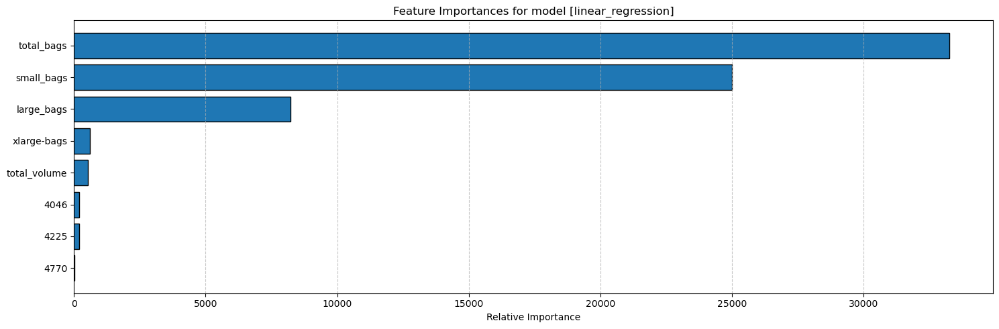

{'total_bags': '33248.058758235056',
 'small_bags': '24999.24868347553',
 'large_bags': '8219.863487202136',
 'xlarge-bags': '602.5671941924443',
 'total_volume': '543.7725435056285',
 '4046': '198.68280392629217',
 '4225': '190.85499709288683',
 '4770': '17.24034704200814'}

In [65]:
mdlName = 'linear_regression'
dict_coefs, plt = display_feature_importance_chart(model_lr, mdlName, list(X_train.columns), 10, 'feature_importance_' + str(mdlName), X_train_scaled, y_test, True)

dict_coefs

<hr style="height:30px;color:#000;background-color:#000;">

# View magnitude of correlations

* Higher Magnitude: Features with a higher correlation magnitude have stronger overall relationships (whether positive or negative) with other features in the dataset. This can indicate that the feature is highly related to multiple other features, either directly or indirectly.
* Lower Magnitude: Features with a lower correlation magnitude have weaker overall relationships with other features. These features may not show significant linear dependence on other features in the dataset.

* Interpreting these magnitudes:
    * Sorted from largest to smallest: After sorting the correlation_magnitude from largest to smallest, the features at the top of the list are those that are more strongly correlated with other features. They may represent features that are highly relevant or redundant (i.e., they may contribute little new information if many features are highly correlated with each other).
    * Features with lower magnitudes might be less correlated with other features, indicating that they provide more independent or unique information.

* Use Cases for Sorted Magnitude:
    * Feature Selection: Features with high correlation magnitudes might be good candidates for feature engineering or selection, but also be cautious about multicollinearity. If several features have high correlation magnitudes, you might want to consider removing or combining them to avoid redundancy.
    * Data Insights: Sorting by correlation magnitude can also reveal which features are most strongly associated with the others, which can help with understanding relationships in the data.

In [66]:
df_to_analyze = df_X_features

# correlation
correlation_matrix = df_to_analyze.corr(numeric_only=True)

# calculate magnitude of correlations
correlation_matrix['correlation_magnitude'] = correlation_matrix.abs().sum(axis=1)

# sort by magnitude
correlation_matrix = correlation_matrix.sort_values(by='correlation_magnitude', ascending=False)

correlation_matrix

,total_volume,4046,4225,4770,total_bags,small_bags,large_bags,xlarge-bags,correlation_magnitude
total_volume,1.000000,0.977863,0.974181,0.872202,0.963047,0.967238,0.880640,0.747157,7.382329
total_bags,0.963047,0.920057,0.905787,0.792314,1.000000,0.994335,0.943009,0.804233,7.322782
small_bags,0.967238,0.925280,0.916031,0.802733,0.994335,1.000000,0.902589,0.806845,7.315050
4046,0.977863,1.000000,0.926110,0.833389,0.920057,0.925280,0.838645,0.699377,7.120721
4225,0.974181,0.926110,1.000000,0.887855,0.905787,0.916031,0.810015,0.688809,7.108788
large_bags,0.880640,0.838645,0.810015,0.698471,0.943009,0.902589,1.000000,0.710858,6.784227
4770,0.872202,0.833389,0.887855,1.000000,0.792314,0.802733,0.698471,0.679861,6.566826
xlarge-bags,0.747157,0.699377,0.688809,0.679861,0.804233,0.806845,0.710858,1.000000,6.137140


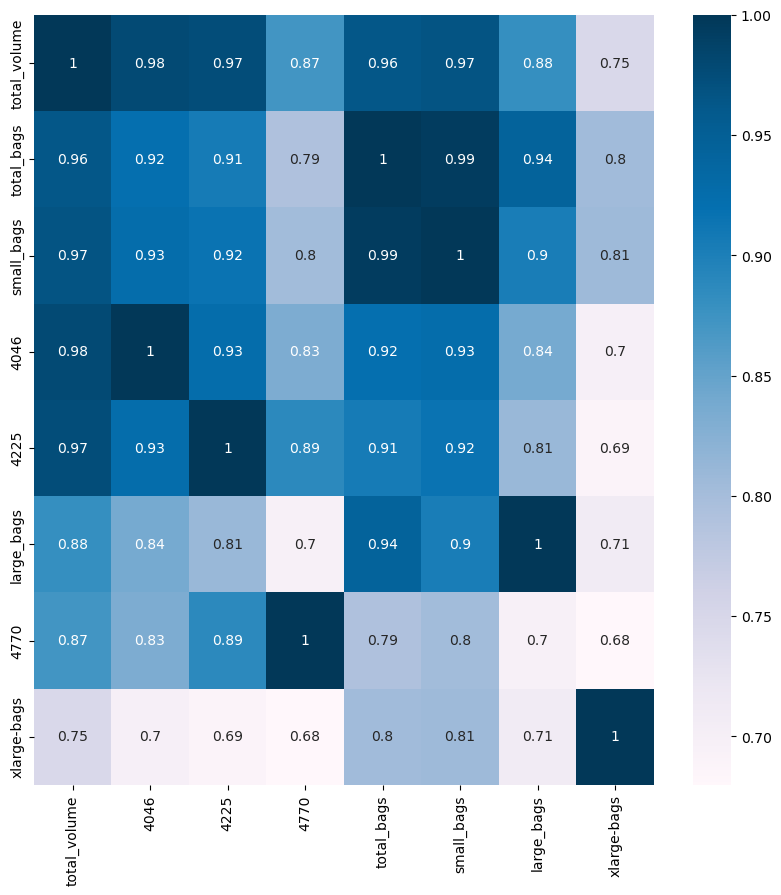

In [67]:
plt.figure(figsize=(10, 10)) 
sns.heatmap(correlation_matrix.drop('correlation_magnitude', axis=1), annot=True, cmap='PuBu');

<hr style="height:30px;color:#000;background-color:#000;">

# Create Function to Pipeline Model Training, Prediction, and Evaluation 

In [68]:
def pipeline_model(model_name, model, X_TRAIN, X_TEST, Y_TRAIN, Y_TEST):
    try:
        dict_evaluation = dict()
        ########################################
        # set time duration params
        ########################################
        analysis_start_time_text = "not started"
        analysis_end_time_text = "not started"
        
        analysis_start_time = datetime.datetime.now()
        analysis_start_time_text = get_time()
        
        ########################################
        # instantiate model
        ########################################
        # model has been instantiated
        print('\n')
        print('#'*70)
        print(f'# training model --> {model_name}')
        print('#'*70)
        
        try:
            print(f'hyperparameters --> {model.get_params()}\n')
        except:
            pass
        
        ########################################
        # train model
        ########################################
        model.fit(X_TRAIN, Y_TRAIN)
        
        ########################################
        # inference: use trained model to predict our test set
        ########################################
        y_pred = model.predict(X_TEST)
        
        ########################################
        # use cross validation for more accurate evaluation
        ########################################
        cv_model = cross_val_score(estimator=model, X=X_TRAIN, y=Y_TRAIN, cv=10)
        
        ########################################
        # evaluate performance of model
        ########################################        
        
        # General Purpose Metrics
        r2 = r2_score(Y_TEST, y_pred)
        MSE = mean_squared_error(Y_TEST, y_pred)
        RMSE = np.sqrt(MSE)
        MAE = mean_absolute_error(Y_TEST, y_pred)
        MedAE = median_absolute_error(Y_TEST, y_pred)
        EVS = explained_variance_score(Y_TEST, y_pred)
    
        # Adjusted R²
        n = len(Y_TEST)
        p = X_TEST.shape[1]
        adjusted_r2 = 1 - (1 - r2) * (n - 1) / (n - p - 1) if n > p + 1 else np.nan
    
        # CV R²
        cv_r2 = cv_model.mean()
    
        # Metrics for Specific Situations
        MAPE = np.mean(np.abs((Y_TEST - y_pred) / np.maximum(np.abs(Y_TEST), 1e-8)))  # Avoid divide-by-zero
    
        # convert to not allow negative vals
        Y_TEST_non_negative = np.maximum(Y_TEST, 0) # Clip negative values to 0
        y_pred_non_negative = np.maximum(y_pred, 0) # Clip negative predictions to 0
    
        RMSLE = np.sqrt(mean_squared_error(np.log1p(Y_TEST_non_negative), np.log1p(y_pred_non_negative)))
        MSLE = mean_squared_log_error(Y_TEST_non_negative, y_pred_non_negative)
    
        m = 1  # Seasonality (m=1 for non-seasonal data)
        naive_forecast = np.roll(Y_TEST, shift=m)
        MASE = mean_absolute_error(Y_TEST[m:], y_pred[m:]) / mean_absolute_error(Y_TEST[m:], naive_forecast[m:])
    
        SMAPE = np.mean(2 * np.abs(Y_TEST - y_pred) / (np.maximum(np.abs(Y_TEST) + np.abs(y_pred), 1e-8)))
    
        CVRMSE = (RMSE / np.mean(Y_TEST)) if np.mean(Y_TEST) != 0 else np.nan #Handle potential 0 division
    
        # Diagnostic Metrics
        MBD = np.mean(y_pred - Y_TEST) #Corrected calculation for MBD
        r2_residuals = r2_score(Y_TEST, Y_TEST - y_pred)  # R² of Residuals

        
        
        DW = durbin_watson(Y_TEST - y_pred)
    
        # Robust Metric
        huber = HuberRegressor(epsilon=1.35)
        huber.fit(X_TRAIN, Y_TRAIN)
        y_pred_huber = huber.predict(X_TEST)
        HUBER_LOSS = np.mean(np.abs(Y_TEST - y_pred_huber))  # MAE for Huber predictions
    
    
        
        # execution time
        analysis_end_time = datetime.datetime.now()
        analysis_end_time_text = get_time()
        
        analysis_duration = analysis_end_time - analysis_start_time
        analysis_duration_text = calculate_time_duration(analysis_duration)  
        
        ########################################
        # store data
        ########################################
        dict_evaluation['model_name'] = model_name
        dict_evaluation['r2'] = f'{r2:.4f}'
        dict_evaluation['adjusted_r2'] = f'{adjusted_r2:.4f}'
        dict_evaluation['cross_validated_r2'] = f'{cv_r2:.4f}'
        dict_evaluation['explained_variance_score'] = f'{EVS:.4f}'
    
        dict_evaluation['rmse'] = f'{RMSE:.4f}'        
        dict_evaluation['rmsle'] = f'{RMSLE:.4f}'
        dict_evaluation['mae'] = f'{MAE:.4f}'
        dict_evaluation['mape'] = f'{MAPE:.4f}'
        dict_evaluation['mse'] = f'{MSE:.4f}'
        dict_evaluation['msle'] = f'{MSLE:.4f}'
        dict_evaluation['mase'] = f'{MASE:.4f}'
        dict_evaluation['smape'] = f'{SMAPE:.4f}'
        dict_evaluation['med_ae'] = f'{MedAE:.4f}'
    
        dict_evaluation['huber_loss'] = HUBER_LOSS
        dict_evaluation['mbd'] = f'{MBD:.4f}'
        dict_evaluation['cv_rmse'] = f'{CVRMSE:.4f}'
        dict_evaluation['r2_residuals'] = f'{r2_residuals:.4f}'
        dict_evaluation['durbin_watson_stat'] = f'{DW:.4f}'
        
        dict_evaluation['start_time'] = analysis_start_time_text
        dict_evaluation['end_time'] = analysis_end_time_text
        dict_evaluation['analysis_duration_text'] = analysis_duration_text
        dict_evaluation['analysis_duration'] = str(analysis_duration)

        ########################################
        # notify
        ########################################
        print(f'training model {model_name} complete! \tR2: {r2:.4f}\tanalysis_duration --> {analysis_duration}\n')
    
        ########################################
        # return 
        ########################################
        return dict_evaluation
        
    except Exception as e:
        print('\n\n* * * EXCEPTION WHILE EXECUTING MODEL', model_name, '\n\n\n')
        print(f"Exception message: {e}")  # Print the exception message
        traceback.print_exc()  # Print the full stack trace
        

In [69]:
model_lr = LinearRegression()
dict_evaluation_lr = pipeline_model('linear_regression', model_lr, X_train_scaled, X_test_scaled, y_train, y_test)

dict_evaluation_lr



######################################################################
# training model --> linear_regression
######################################################################
hyperparameters --> {'copy_X': True, 'fit_intercept': True, 'n_jobs': None, 'positive': False}

training model linear_regression complete! 	R2: 0.0435	analysis_duration --> 0:00:00.285648



{'model_name': 'linear_regression',
 'r2': '0.0435',
 'adjusted_r2': '0.0414',
 'cross_validated_r2': '0.0517',
 'explained_variance_score': '0.0436',
 'rmse': '0.3920',
 'rmsle': '0.1618',
 'mae': '0.3147',
 'mape': '0.2464',
 'mse': '0.1537',
 'msle': '0.0262',
 'mase': '0.6788',
 'smape': '0.2285',
 'med_ae': '0.2767',
 'huber_loss': 0.31392678854682393,
 'mbd': '-0.0053',
 'cv_rmse': '0.2779',
 'r2_residuals': '-11.3516',
 'durbin_watson_stat': '2.0590',
 'start_time': '2025-02-24-0715',
 'end_time': '2025-02-24-0715',
 'analysis_duration_text': '0 day(s), 0 hour(s), 0 minute(s), 0 second(s)',
 'analysis_duration': '0:00:00.285648'}

# View Feature Importance from this Model

coefficients:
total_bags	33248.058758235056
small_bags	24999.24868347553
large_bags	8219.863487202136
xlarge-bags	602.5671941924443
total_volume	543.7725435056285
4046	198.68280392629217
4225	190.85499709288683
4770	17.24034704200814


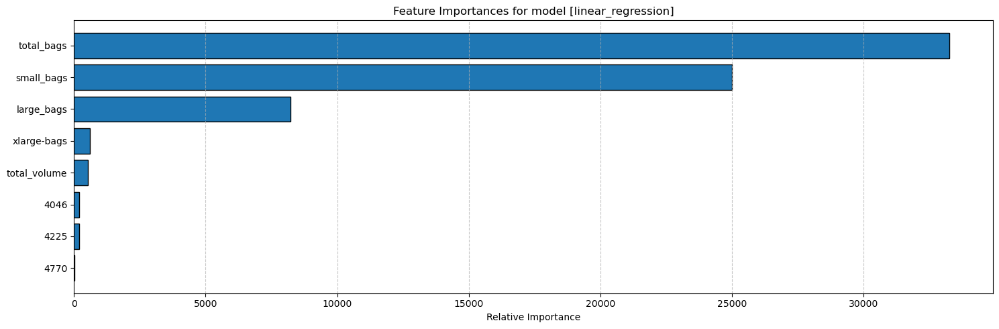

In [70]:
mdlName = 'linear_regression'
dict_coeff_lr, plt = display_feature_importance_chart(model_lr, mdlName, list(X_train.columns), 10, 'feature_importance_' + str(mdlName), X_test_scaled, y_test, True)

<hr style="height:30px;color:#000;background-color:#00F;">

# <b>Configure and Instantite Models for our pipeline</b>

In [71]:
def instantiate_and_model_data(X_train_scaled, X_test_scaled, y_train, y_test):
    try:
        lst_evaluation_metrics = ['model_name', 
                                  'r2', 
                                  'adjusted_r2', 
                                  'cross_validated_r2', 
                                  'explained_variance_score', 'rmse', 
                                  'rmsle', 
                                  'mae', 
                                  'mape', 
                                  'mse', 
                                  'msle', 
                                  'mase', 
                                  'smape', 
                                  'med_ae', 
                                  'huber_loss', 
                                  'mbd', 
                                  'cv_rmse', 
                                  'r2_residuals', 
                                  'durbin_watson_stat', 
                                  'start_time', 
                                  'end_time', 
                                  'analysis_duration_text', 
                                  'analysis_duration'
                                 ]
        
        RANDOM_STATE = 42
        
        # create dataframe to contain evaluation metrics
        df_model_evaluation_metrics = pd.DataFrame(columns=lst_evaluation_metrics)
        
        # notify['model_name', 'r2', 'adjusted_r2', 'cross_validated_r2', 'explained_variance_score', 'rmse', 'rmsle', 'mae', 'mape', 'mse', 'msle', 'mase', 'smape', 'med_ae', 'huber_loss', 'mbd', 'cv_rmse', 'r2_residuals', 'durbin_watson_stat', 'start_time', 'end_time', 'analysis_duration_text', 'analysis_duration']
        print('instantiating models...')
        
        ada_boost_reg = AdaBoostRegressor(random_state=RANDOM_STATE)
        ard_regression = ARDRegression()
        bayesian_ridge = BayesianRidge()
        
        catboost_reg = CatBoostRegressor(random_state=RANDOM_STATE, verbose=0)
        decision_tree_regressor = DecisionTreeRegressor(random_state=RANDOM_STATE)
        decision_tree_regressor_pruned = DecisionTreeRegressor(random_state=RANDOM_STATE, max_depth=5)
        elasticnet_cv = ElasticNetCV(random_state=RANDOM_STATE)
        elasticnet_cv2 = ElasticNetCV(random_state=RANDOM_STATE, alphas=[0.5],cv = 11,n_jobs = -1)
        elasticnet_reg = ElasticNet(random_state=RANDOM_STATE)
        elasticnet_reg2 = ElasticNet(random_state=RANDOM_STATE, alpha=0.1, l1_ratio=0.5)
        extra_trees_reg = ExtraTreesRegressor(random_state=RANDOM_STATE)
        
        gaussian_process_reg = GaussianProcessRegressor(random_state=RANDOM_STATE)
        gbr_reg = GradientBoostingRegressor(random_state=RANDOM_STATE, verbose=False)
        gbr2 = GradientBoostingRegressor(random_state=RANDOM_STATE, n_estimators=300,min_weight_fraction_leaf=0.5,max_depth=2,learning_rate=0.01)
        gbr3 = GradientBoostingRegressor(random_state=RANDOM_STATE, max_depth=10, n_estimators=200, learning_rate=1.0)
        hist_gb_reg = HistGradientBoostingRegressor(random_state=RANDOM_STATE)
        huber_reg = HuberRegressor() 
        
        knn_reg_1 = KNeighborsRegressor()
        knn_reg_2 = KNeighborsRegressor(n_neighbors=5)
        
        lasso_cv = LassoCV(random_state=RANDOM_STATE, alphas=[1],cv = 11,n_jobs = -1) # cv - number of cross validations to be checked, n_jobs = -1 - use all the parallel processing power of the system
        lasso_reg2 = Lasso(random_state=RANDOM_STATE, alpha=0.1) #Parameterized Regressors
        lasso_regressor = Lasso(random_state=RANDOM_STATE)
        
        lgbm_reg = LGBMRegressor(random_state=RANDOM_STATE)
        linear_regressor = LinearRegression()
        
        mlp_reg_1 = MLPRegressor(random_state=RANDOM_STATE, max_iter=100)
        mlp_reg_2 = MLPRegressor(random_state=RANDOM_STATE, hidden_layer_sizes=(200,), max_iter=400)
        
        ransac_reg = RANSACRegressor(random_state=RANDOM_STATE)
        
        rf_reg = RandomForestRegressor(random_state=RANDOM_STATE, verbose=0, n_jobs=-1)
        rf_reg2 = RandomForestRegressor(random_state=RANDOM_STATE, n_estimators=100,min_samples_leaf=5) # n_estimators - The number of trees in the forest, min_samples_leaf - The minimum number of samples required to be at a leaf node.
        
        ridge_cv = RidgeCV(alphas=[2],cv = 11)
        ridge_reg = Ridge(random_state=RANDOM_STATE)
        ridge_reg2 = Ridge(random_state=RANDOM_STATE, alpha=1, solver="cholesky")
        
        svm_poly_reg = SVR(kernel="poly", degree=2, C=100, epsilon=0.1)
        svm_reg = SVR()
        svm_reg_lin = LinearSVR()
        svm_reg_lin2 = LinearSVR(epsilon=1.5)
        svm_reg_poly = SVR(kernel='poly') # non-linear kernel
        svm_reg_rbf = SVR(kernel='rbf') # non-linear kernel
        svm_reg_sigmoid = SVR(kernel='sigmoid') # non-linear kernel
        
        theil_sen_reg = TheilSenRegressor(max_iter=500, max_subpopulation=10000, n_jobs=-1)
        
        xgb_reg = XGBRegressor(random_state=RANDOM_STATE)
        xgb2 = XGBRegressor(random_state=RANDOM_STATE, eval_metric='logloss')
        
        
        param_grid = [   {'n_estimators': [3, 10, 30], 'max_features': [2, 4, 6, 8]},
                         {'bootstrap': [False], 'n_estimators': [3, 10], 'max_features': [2, 3, 4]},
                     ]
        grid_search = GridSearchCV(rf_reg2, param_grid, cv=5, scoring='neg_mean_squared_error',return_train_score=True)
        
        
        
        #Tuple analysis Models
        tpl_models = [
                      ('ada_boost_regressor', ada_boost_reg),              
                      ('ard_regressor', ard_regression), 
                      ('bayesian_ridge_regressor', bayesian_ridge),
                      ('decision_tree_regressor', decision_tree_regressor), 
                      ('decision_tree_pruned_regressor', decision_tree_regressor_pruned),                      
                      ('elasticnet_regressor', elasticnet_reg),
                      ('elasticnet_regressor_2', elasticnet_reg2),
                      ('elasticnet_regressor_cv', elasticnet_cv),
                      ('elastic_regressor_cv_2', elasticnet_cv2),      
                      ('extra_trees_regressor', extra_trees_reg),
                      ('gradient_boosting_regressor_1', gbr_reg),
                      ('gradient_boosting_regressor_2', gbr2),
                      ('hist_gradient_boosting_regressor', hist_gb_reg),                            
                      ('huber_regressor', huber_reg),
                      ('knn_regressor_1', knn_reg_1),   
                      ('knn_regressor_2', knn_reg_2), 
                      ('linear_regressor', linear_regressor),
                      ('lasso_regressor', lasso_regressor),
                      ('lasso_regressor_cv', lasso_cv),
                      ('lasso_regressor_2', lasso_reg2),
                      ('lgbm_regressor', lgbm_reg),
                      ('mlp_regressor_1', mlp_reg_1),
                      ('ransac_regressor', ransac_reg),                                         
                      ('ridge_regressor', ridge_reg),
                      ('ridge_regressor_cv', ridge_cv),
                      ('ridge_regressor_2', ridge_reg2),
                      ('svm_regressor_linear_1', svm_reg_lin),
                      ('svm_regressor_linear_2', svm_reg_lin2),     
                      ('theil_sen_regressor', theil_sen_reg),
                      ('xgb_regressor_1', xgb_reg),  
                      ('xgb_regressor_2', xgb2),
                  
                      
                      # longer running models                                                
                      ('random_forest_regressor', rf_reg),
                      ('random_forest_regressor_2', rf_reg2),   
                      ('mlp_regressor_2', mlp_reg_2),
                      ('catboost_regressor', catboost_reg),     
        
        
                        # NOT TESTED - execution time too long for right now
             #         ('gaussian_process_regressor', gaussian_process_reg),
             #         ('gradient_boosting_regressor_3', gbr3),
             #         ('svm_regressor', svm_reg),              
             #         ('svm_rbf_regressor', svm_reg_rbf),
             #         ('svm_poly_regressor', svm_reg_poly),
             #         ('svm_sigmoid_regressor', svm_reg_sigmoid),
             #         ('grid_search_regressor', grid_search),
            
                     ]
        
        print('model instantiation complete!')
        
        
        lst_error_model = []
        dict_completed_models = dict()
        
        # train the models
        #for model_name, model in tpl_models:
        for model_name, model in tqdm(tpl_models, desc=f"Processing Model", unit="model"):
            try:
                
                # train and evaluate model
                dict_evaluation = pipeline_model(model_name, model, X_train_scaled, X_test_scaled, y_train, y_test)
            
                # store instance
                if dict_evaluation is not None:
                    df_model_evaluation_metrics.loc[len(df_model_evaluation_metrics)] = dict_evaluation
                    dict_completed_models[model_name] = model
                else:
                    lst_error_model.append(model_name)    
                        
            except Exception as e:        
                lst_error_model.append(model_name) 
                print('\n\n* * * EXCEPTION WHILE EXECUTING MODEL', model_name)
                print(f"Exception message: {e}")  # Print the exception message
                traceback.print_exc()  # Print the full stack trace
                
                continue
        
        # notify training complte
        print('\n\n')
        print('*'*90)
        print('* model training COMPLETE!')
        print('*'*90)
          
              
        # notify training error
        if len(lst_error_model) > 0:
            print('\n\n')
            print('*'*90)
            print('* * * ERROR MODELS:')
            print('*'*90)
        
            for model_name in lst_error_model:
                print(f'{model_name}')

        return df_model_evaluation_metrics, dict_completed_models, lst_error_model
        
        print('\n\n')
    except Exception as e:
        print('\n\n* * * EXCEPTION caught in instantiate_and_model_data mtd')
        print(f"Exception message: {e}")  # Print the exception message
        traceback.print_exc()  # Print the full stack trace

    



<hr style="height:30px;color:#000;background-color:#00F;">

# <span style="color: darkblue;"><b> Train models! </b></span>  

In [72]:
%%time 
df_model_evaluation_metrics, dict_completed_models, lst_error_model = instantiate_and_model_data(X_train_scaled, X_test_scaled, y_train, y_test)

instantiating models...
model instantiation complete!


Processing Model:   0%|                                                   | 0/35 [00:00<?, ?model/s]



######################################################################
# training model --> ada_boost_regressor
######################################################################
hyperparameters --> {'estimator': None, 'learning_rate': 1.0, 'loss': 'linear', 'n_estimators': 50, 'random_state': 42}



Processing Model:   3%|█▏                                         | 1/35 [00:08<04:40,  8.26s/model]

training model ada_boost_regressor complete! 	R2: 0.3543	analysis_duration --> 0:00:08.258497



######################################################################
# training model --> ard_regressor
######################################################################
hyperparameters --> {'alpha_1': 1e-06, 'alpha_2': 1e-06, 'compute_score': False, 'copy_X': True, 'fit_intercept': True, 'lambda_1': 1e-06, 'lambda_2': 1e-06, 'max_iter': 300, 'threshold_lambda': 10000.0, 'tol': 0.001, 'verbose': False}



Processing Model:   6%|██▍                                        | 2/35 [00:08<02:01,  3.67s/model]

training model ard_regressor complete! 	R2: 0.0430	analysis_duration --> 0:00:00.456839



######################################################################
# training model --> bayesian_ridge_regressor
######################################################################
hyperparameters --> {'alpha_1': 1e-06, 'alpha_2': 1e-06, 'alpha_init': None, 'compute_score': False, 'copy_X': True, 'fit_intercept': True, 'lambda_1': 1e-06, 'lambda_2': 1e-06, 'lambda_init': None, 'max_iter': 300, 'tol': 0.001, 'verbose': False}



Processing Model:   9%|███▋                                       | 3/35 [00:08<01:07,  2.10s/model]

training model bayesian_ridge_regressor complete! 	R2: 0.0433	analysis_duration --> 0:00:00.210436



######################################################################
# training model --> decision_tree_regressor
######################################################################
hyperparameters --> {'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'random_state': 42, 'splitter': 'best'}



Processing Model:  11%|████▉                                      | 4/35 [00:11<01:07,  2.19s/model]

training model decision_tree_regressor complete! 	R2: 0.5627	analysis_duration --> 0:00:02.322157



######################################################################
# training model --> decision_tree_pruned_regressor
######################################################################
hyperparameters --> {'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': 5, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'random_state': 42, 'splitter': 'best'}



Processing Model:  14%|██████▏                                    | 5/35 [00:12<00:51,  1.73s/model]

training model decision_tree_pruned_regressor complete! 	R2: 0.4742	analysis_duration --> 0:00:00.904499



######################################################################
# training model --> elasticnet_regressor
######################################################################
hyperparameters --> {'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}

training model elasticnet_regressor complete! 	R2: -0.0002	analysis_duration --> 0:00:00.191815



Processing Model:  17%|███████▎                                   | 6/35 [00:12<00:35,  1.21s/model]



######################################################################
# training model --> elasticnet_regressor_2
######################################################################
hyperparameters --> {'alpha': 0.1, 'copy_X': True, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}



Processing Model:  20%|████████▌                                  | 7/35 [00:12<00:25,  1.12model/s]

training model elasticnet_regressor_2 complete! 	R2: 0.0272	analysis_duration --> 0:00:00.235516



######################################################################
# training model --> elasticnet_regressor_cv
######################################################################
hyperparameters --> {'alphas': None, 'copy_X': True, 'cv': None, 'eps': 0.001, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'n_alphas': 100, 'n_jobs': None, 'positive': False, 'precompute': 'auto', 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'verbose': 0}



Processing Model:  23%|█████████▊                                 | 8/35 [00:16<00:53,  1.99s/model]

training model elasticnet_regressor_cv complete! 	R2: 0.0432	analysis_duration --> 0:00:04.318008



######################################################################
# training model --> elastic_regressor_cv_2
######################################################################
hyperparameters --> {'alphas': [0.5], 'copy_X': True, 'cv': 11, 'eps': 0.001, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'n_alphas': 100, 'n_jobs': -1, 'positive': False, 'precompute': 'auto', 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'verbose': 0}



Processing Model:  26%|███████████                                | 9/35 [00:18<00:44,  1.71s/model]

training model elastic_regressor_cv_2 complete! 	R2: -0.0002	analysis_duration --> 0:00:01.085584



######################################################################
# training model --> extra_trees_regressor
######################################################################
hyperparameters --> {'bootstrap': False, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}



Processing Model:  29%|████████████                              | 10/35 [01:01<06:06, 14.67s/model]

training model extra_trees_regressor complete! 	R2: 0.7657	analysis_duration --> 0:00:43.667105



######################################################################
# training model --> gradient_boosting_regressor_1
######################################################################
hyperparameters --> {'alpha': 0.9, 'ccp_alpha': 0.0, 'criterion': 'friedman_mse', 'init': None, 'learning_rate': 0.1, 'loss': 'squared_error', 'max_depth': 3, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 100, 'n_iter_no_change': None, 'random_state': 42, 'subsample': 1.0, 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': False, 'warm_start': False}



Processing Model:  31%|█████████████▏                            | 11/35 [01:39<08:44, 21.87s/model]

training model gradient_boosting_regressor_1 complete! 	R2: 0.5678	analysis_duration --> 0:00:38.181282



######################################################################
# training model --> gradient_boosting_regressor_2
######################################################################
hyperparameters --> {'alpha': 0.9, 'ccp_alpha': 0.0, 'criterion': 'friedman_mse', 'init': None, 'learning_rate': 0.01, 'loss': 'squared_error', 'max_depth': 2, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.5, 'n_estimators': 300, 'n_iter_no_change': None, 'random_state': 42, 'subsample': 1.0, 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False}



Processing Model:  34%|██████████████▍                           | 12/35 [02:22<10:49, 28.22s/model]

training model gradient_boosting_regressor_2 complete! 	R2: -0.0002	analysis_duration --> 0:00:42.733005



######################################################################
# training model --> hist_gradient_boosting_regressor
######################################################################
hyperparameters --> {'categorical_features': 'warn', 'early_stopping': 'auto', 'interaction_cst': None, 'l2_regularization': 0.0, 'learning_rate': 0.1, 'loss': 'squared_error', 'max_bins': 255, 'max_depth': None, 'max_features': 1.0, 'max_iter': 100, 'max_leaf_nodes': 31, 'min_samples_leaf': 20, 'monotonic_cst': None, 'n_iter_no_change': 10, 'quantile': None, 'random_state': 42, 'scoring': 'loss', 'tol': 1e-07, 'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False}



Processing Model:  37%|███████████████▌                          | 13/35 [02:27<07:44, 21.13s/model]

training model hist_gradient_boosting_regressor complete! 	R2: 0.6894	analysis_duration --> 0:00:04.807350



######################################################################
# training model --> huber_regressor
######################################################################
hyperparameters --> {'alpha': 0.0001, 'epsilon': 1.35, 'fit_intercept': True, 'max_iter': 100, 'tol': 1e-05, 'warm_start': False}



Processing Model:  40%|████████████████▊                         | 14/35 [02:28<05:16, 15.07s/model]

training model huber_regressor complete! 	R2: 0.0316	analysis_duration --> 0:00:01.051674



######################################################################
# training model --> knn_regressor_1
######################################################################
hyperparameters --> {'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': None, 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}



Processing Model:  43%|██████████████████                        | 15/35 [02:30<03:39, 10.99s/model]

training model knn_regressor_1 complete! 	R2: 0.6587	analysis_duration --> 0:00:01.519692



######################################################################
# training model --> knn_regressor_2
######################################################################
hyperparameters --> {'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': None, 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}



Processing Model:  46%|███████████████████▏                      | 16/35 [02:31<02:36,  8.25s/model]

training model knn_regressor_2 complete! 	R2: 0.6587	analysis_duration --> 0:00:01.869274



######################################################################
# training model --> linear_regressor
######################################################################
hyperparameters --> {'copy_X': True, 'fit_intercept': True, 'n_jobs': None, 'positive': False}



Processing Model:  51%|█████████████████████▌                    | 18/35 [02:32<01:10,  4.16s/model]

training model linear_regressor complete! 	R2: 0.0435	analysis_duration --> 0:00:00.312107



######################################################################
# training model --> lasso_regressor
######################################################################
hyperparameters --> {'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}

training model lasso_regressor complete! 	R2: -0.0002	analysis_duration --> 0:00:00.175969



######################################################################
# training model --> lasso_regressor_cv
######################################################################
hyperparameters --> {'alphas': [1], 'copy_X': True, 'cv': 11, 'eps': 0.001, 'fit_intercept': True, 'max_iter': 1000, 'n_alphas': 100, 'n_jobs': -1, 'positive': False, 'precompute': 'auto', 'random_state': 42, 'selection': 'cyclic', 'tol': 

Processing Model:  57%|████████████████████████                  | 20/35 [02:33<00:33,  2.25s/model]

training model lasso_regressor_cv complete! 	R2: -0.0002	analysis_duration --> 0:00:00.739154



######################################################################
# training model --> lasso_regressor_2
######################################################################
hyperparameters --> {'alpha': 0.1, 'copy_X': True, 'fit_intercept': True, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}

training model lasso_regressor_2 complete! 	R2: -0.0002	analysis_duration --> 0:00:00.172075



######################################################################
# training model --> lgbm_regressor
######################################################################
hyperparameters --> {'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'split', 'learning_rate': 0.1, 'max_depth': -1, 'min_child_samples': 20, 'min_child_weight': 0.001, 'min_split_gain': 0.0, '

Processing Model:  60%|█████████████████████████▏                | 21/35 [02:35<00:32,  2.33s/model]

training model lgbm_regressor complete! 	R2: 0.6933	analysis_duration --> 0:00:02.503374



######################################################################
# training model --> mlp_regressor_1
######################################################################
hyperparameters --> {'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'early_stopping': False, 'epsilon': 1e-08, 'hidden_layer_sizes': (100,), 'learning_rate': 'constant', 'learning_rate_init': 0.001, 'max_fun': 15000, 'max_iter': 100, 'momentum': 0.9, 'n_iter_no_change': 10, 'nesterovs_momentum': True, 'power_t': 0.5, 'random_state': 42, 'shuffle': True, 'solver': 'adam', 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': False, 'warm_start': False}



Processing Model:  63%|██████████████████████████▍               | 22/35 [03:28<03:47, 17.47s/model]

training model mlp_regressor_1 complete! 	R2: 0.4380	analysis_duration --> 0:00:52.771645



######################################################################
# training model --> ransac_regressor
######################################################################
hyperparameters --> {'estimator': None, 'is_data_valid': None, 'is_model_valid': None, 'loss': 'absolute_error', 'max_skips': inf, 'max_trials': 100, 'min_samples': None, 'random_state': 42, 'residual_threshold': None, 'stop_n_inliers': inf, 'stop_probability': 0.99, 'stop_score': inf}



Processing Model:  66%|███████████████████████████▌              | 23/35 [03:30<02:33, 12.80s/model]

training model ransac_regressor complete! 	R2: -12.7083	analysis_duration --> 0:00:01.882763



######################################################################
# training model --> ridge_regressor
######################################################################
hyperparameters --> {'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'max_iter': None, 'positive': False, 'random_state': 42, 'solver': 'auto', 'tol': 0.0001}



Processing Model:  69%|████████████████████████████▊             | 24/35 [03:30<01:39,  9.07s/model]

training model ridge_regressor complete! 	R2: 0.0431	analysis_duration --> 0:00:00.367521



######################################################################
# training model --> ridge_regressor_cv
######################################################################
hyperparameters --> {'alpha_per_target': False, 'alphas': [2], 'cv': 11, 'fit_intercept': True, 'gcv_mode': None, 'scoring': None, 'store_cv_results': None, 'store_cv_values': 'deprecated'}



Processing Model:  74%|███████████████████████████████▏          | 26/35 [03:31<00:42,  4.67s/model]

training model ridge_regressor_cv complete! 	R2: 0.0431	analysis_duration --> 0:00:00.801960



######################################################################
# training model --> ridge_regressor_2
######################################################################
hyperparameters --> {'alpha': 1, 'copy_X': True, 'fit_intercept': True, 'max_iter': None, 'positive': False, 'random_state': 42, 'solver': 'cholesky', 'tol': 0.0001}

training model ridge_regressor_2 complete! 	R2: 0.0431	analysis_duration --> 0:00:00.175152



######################################################################
# training model --> svm_regressor_linear_1
######################################################################
hyperparameters --> {'C': 1.0, 'dual': 'auto', 'epsilon': 0.0, 'fit_intercept': True, 'intercept_scaling': 1.0, 'loss': 'epsilon_insensitive', 'max_iter': 1000, 'random_state': None, 'tol': 0.0001, 'verbose': 0}



Processing Model:  77%|████████████████████████████████▍         | 27/35 [03:39<00:43,  5.45s/model]

training model svm_regressor_linear_1 complete! 	R2: -0.0093	analysis_duration --> 0:00:07.252729



######################################################################
# training model --> svm_regressor_linear_2
######################################################################
hyperparameters --> {'C': 1.0, 'dual': 'auto', 'epsilon': 1.5, 'fit_intercept': True, 'intercept_scaling': 1.0, 'loss': 'epsilon_insensitive', 'max_iter': 1000, 'random_state': None, 'tol': 0.0001, 'verbose': 0}



Processing Model:  80%|█████████████████████████████████▌        | 28/35 [03:39<00:27,  3.97s/model]

training model svm_regressor_linear_2 complete! 	R2: -0.2121	analysis_duration --> 0:00:00.501946



######################################################################
# training model --> theil_sen_regressor
######################################################################
hyperparameters --> {'copy_X': True, 'fit_intercept': True, 'max_iter': 500, 'max_subpopulation': 10000, 'n_jobs': -1, 'n_subsamples': None, 'random_state': None, 'tol': 0.001, 'verbose': False}



Processing Model:  83%|██████████████████████████████████▊       | 29/35 [04:48<02:19, 23.32s/model]

training model theil_sen_regressor complete! 	R2: -61.3780	analysis_duration --> 0:01:08.474570



######################################################################
# training model --> xgb_regressor_1
######################################################################
hyperparameters --> {'objective': 'reg:squarederror', 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': None, 'device': None, 'early_stopping_rounds': None, 'enable_categorical': False, 'eval_metric': None, 'feature_types': None, 'gamma': None, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': None, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': None, 'max_leaves': None, 'min_child_weight': None, 'missing': nan, 'monotone_constraints': None, 'multi_strategy': None, 'n_estimators': None, 'n_jobs': None, 'num_parallel_tree': None, '

Processing Model:  86%|████████████████████████████████████      | 30/35 [04:51<01:26, 17.22s/model]

training model xgb_regressor_1 complete! 	R2: 0.7201	analysis_duration --> 0:00:02.977416



######################################################################
# training model --> xgb_regressor_2
######################################################################
hyperparameters --> {'objective': 'reg:squarederror', 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': None, 'device': None, 'early_stopping_rounds': None, 'enable_categorical': False, 'eval_metric': 'logloss', 'feature_types': None, 'gamma': None, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': None, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': None, 'max_leaves': None, 'min_child_weight': None, 'missing': nan, 'monotone_constraints': None, 'multi_strategy': None, 'n_estimators': None, 'n_jobs': None, 'num_parallel_tree': None, 'r

Processing Model:  89%|█████████████████████████████████████▏    | 31/35 [04:53<00:51, 12.85s/model]

training model xgb_regressor_2 complete! 	R2: 0.7201	analysis_duration --> 0:00:02.642388



######################################################################
# training model --> random_forest_regressor
######################################################################
hyperparameters --> {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': -1, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}



Processing Model:  91%|██████████████████████████████████████▍   | 32/35 [07:55<03:10, 63.36s/model]

training model random_forest_regressor complete! 	R2: 0.7634	analysis_duration --> 0:03:01.143327



######################################################################
# training model --> random_forest_regressor_2
######################################################################
hyperparameters --> {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 5, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}



Processing Model:  94%|███████████████████████████████████████▌  | 33/35 [10:26<02:59, 89.70s/model]

training model random_forest_regressor_2 complete! 	R2: 0.7441	analysis_duration --> 0:02:31.139493



######################################################################
# training model --> mlp_regressor_2
######################################################################
hyperparameters --> {'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'early_stopping': False, 'epsilon': 1e-08, 'hidden_layer_sizes': (200,), 'learning_rate': 'constant', 'learning_rate_init': 0.001, 'max_fun': 15000, 'max_iter': 400, 'momentum': 0.9, 'n_iter_no_change': 10, 'nesterovs_momentum': True, 'power_t': 0.5, 'random_state': 42, 'shuffle': True, 'solver': 'adam', 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': False, 'warm_start': False}



Processing Model:  97%|████████████████████████████████████████▊ | 34/35 [11:53<01:29, 89.07s/model]

training model mlp_regressor_2 complete! 	R2: 0.4630	analysis_duration --> 0:01:27.593639



######################################################################
# training model --> catboost_regressor
######################################################################
hyperparameters --> {'loss_function': 'RMSE', 'verbose': 0, 'random_state': 42}



Processing Model: 100%|██████████████████████████████████████████| 35/35 [13:20<00:00, 22.87s/model]

training model catboost_regressor complete! 	R2: 0.7264	analysis_duration --> 0:01:26.654634




******************************************************************************************
* model training COMPLETE!
******************************************************************************************
CPU times: user 8min 53s, sys: 8.28 s, total: 9min 1s
Wall time: 13min 20s


<hr style="height:30px;color:#000;background-color:#000;">

# <b> View Model Performance </b>

In [73]:
# sort models by r2
df_model_evaluation_metrics = df_model_evaluation_metrics.sort_values(by='r2', ascending=False, inplace=False)
df_model_evaluation_metrics = df_model_evaluation_metrics.reset_index(drop=True, inplace=False)

#save df
df_model_evaluation_metrics.to_csv('./model_performance_before_outlier_removal.csv', index=False)

# view df
df_model_evaluation_metrics

,model_name,r2,adjusted_r2,cross_validated_r2,explained_variance_score,rmse,rmsle,mae,mape,mse,...,med_ae,huber_loss,mbd,cv_rmse,r2_residuals,durbin_watson_stat,start_time,end_time,analysis_duration_text,analysis_duration
0,extra_trees_regressor,0.7657,0.7652,0.7694,0.7663,0.1940,0.0766,0.1346,0.0986,0.0376,...,0.0911,0.313927,0.0098,0.1376,-12.2819,2.0139,2025-02-24-0715,2025-02-24-0716,"0 day(s), 0 hour(s), 0 minute(s), 43 second(s)",0:00:43.667105
1,random_forest_regressor,0.7634,0.7629,0.7614,0.7637,0.1950,0.0774,0.1380,0.1014,0.0380,...,0.0971,0.313927,0.0076,0.1382,-12.2366,2.0144,2025-02-24-0719,2025-02-24-0722,"0 day(s), 0 hour(s), 3 minute(s), 1 second(s)",0:03:01.143327
2,random_forest_regressor_2,0.7441,0.7435,0.7459,0.7443,0.2028,0.0804,0.1448,0.1065,0.0411,...,0.1048,0.313927,0.0058,0.1438,-12.1796,2.0190,2025-02-24-0722,2025-02-24-0725,"0 day(s), 0 hour(s), 2 minute(s), 31 second(s)",0:02:31.139493
3,catboost_regressor,0.7264,0.7258,0.7345,0.7265,0.2097,0.0834,0.1529,0.1122,0.0440,...,0.1133,0.313927,0.0046,0.1487,-12.1564,2.0289,2025-02-24-0726,2025-02-24-0728,"0 day(s), 0 hour(s), 1 minute(s), 26 second(s)",0:01:26.654634
4,xgb_regressor_2,0.7201,0.7195,0.7268,0.7202,0.2121,0.0842,0.1529,0.1121,0.0450,...,0.1102,0.313927,0.0045,0.1504,-12.2042,2.0315,2025-02-24-0719,2025-02-24-0719,"0 day(s), 0 hour(s), 0 minute(s), 2 second(s)",0:00:02.642388
5,xgb_regressor_1,0.7201,0.7195,0.7268,0.7202,0.2121,0.0842,0.1529,0.1121,0.0450,...,0.1102,0.313927,0.0045,0.1504,-12.2042,2.0315,2025-02-24-0719,2025-02-24-0719,"0 day(s), 0 hour(s), 0 minute(s), 2 second(s)",0:00:02.977416
6,lgbm_regressor,0.6933,0.6926,0.7024,0.6934,0.2220,0.0888,0.1640,0.1213,0.0493,...,0.1249,0.313927,0.0036,0.1574,-12.0810,2.0089,2025-02-24-0717,2025-02-24-0717,"0 day(s), 0 hour(s), 0 minute(s), 2 second(s)",0:00:02.503374
7,hist_gradient_boosting_regressor,0.6894,0.6887,0.7006,0.6895,0.2234,0.0895,0.1652,0.1226,0.0499,...,0.1260,0.313927,0.0037,0.1584,-12.0840,2.0039,2025-02-24-0717,2025-02-24-0717,"0 day(s), 0 hour(s), 0 minute(s), 4 second(s)",0:00:04.807350
8,knn_regressor_2,0.6587,0.6580,0.6722,0.6602,0.2342,0.0924,0.1617,0.1188,0.0548,...,0.1100,0.313927,0.0155,0.1660,-12.4276,2.0051,2025-02-24-0717,2025-02-24-0717,"0 day(s), 0 hour(s), 0 minute(s), 1 second(s)",0:00:01.869274
9,knn_regressor_1,0.6587,0.6580,0.6722,0.6602,0.2342,0.0924,0.1617,0.1188,0.0548,...,0.1100,0.313927,0.0155,0.1660,-12.4276,2.0051,2025-02-24-0717,2025-02-24-0717,"0 day(s), 0 hour(s), 0 minute(s), 1 second(s)",0:00:01.519692


# <b> Sort dataframe for charting </b>

In [74]:
# plot in ascending order
df_model_evaluation_metrics_sorted = df_model_evaluation_metrics.sort_values(by='r2', ascending=True, inplace=False)
df_model_evaluation_metrics_sorted = df_model_evaluation_metrics_sorted.reset_index(drop=True, inplace=False)

# soft dict of models for displaying feature importance below
dict_completed_models_sorted = dict()

lst_sorted_models = list(df_model_evaluation_metrics_sorted['model_name'])[::-1]

# <b> Plot Model Performance by R2 </b>

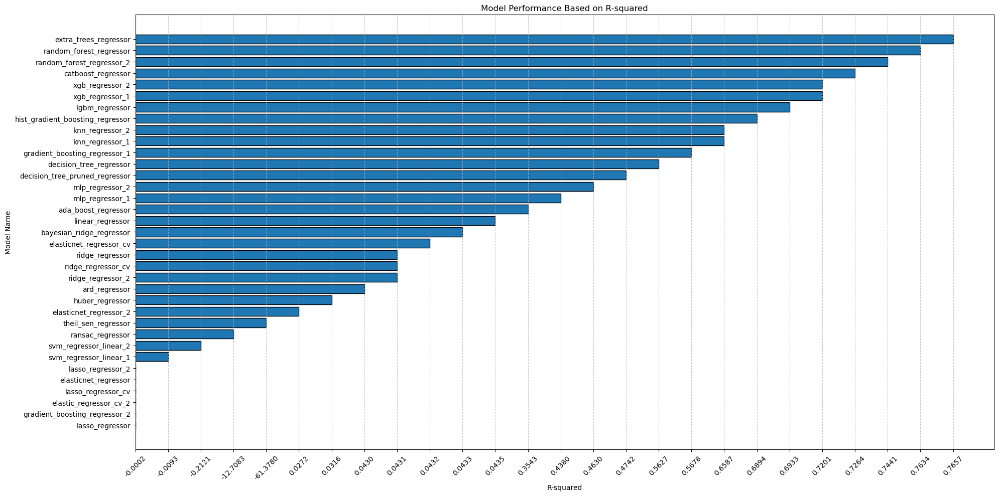

In [75]:
# plot
plt.figure(figsize=(20, 10))  # Adjust figure size if needed (width, height)
plt.barh(df_model_evaluation_metrics_sorted['model_name'], df_model_evaluation_metrics_sorted['r2'], edgecolor='black') # barh for horizontal

plt.xlabel("R-squared")  # Note the x and y labels are switched
plt.ylabel("Model Name")
plt.title("Model Performance Based on R-squared")

plt.xticks(rotation=45)
plt.grid(axis='x', linestyle='--', alpha=0.7)
#plt.xlim(0, None)

plt.tight_layout()
plt.show()


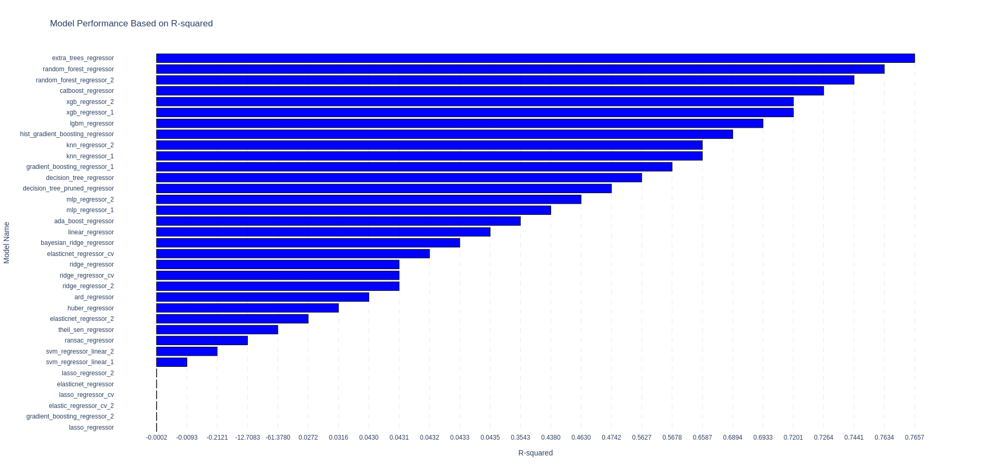

In [76]:

fig = go.Figure()

fig.add_trace(go.Bar(
    y=df_model_evaluation_metrics_sorted['model_name'],  
    x=df_model_evaluation_metrics_sorted['r2'],  
    orientation='h',  # Horizontal bar chart
    marker=dict(color='blue', line=dict(color='black', width=1)),  
))

# Update layout with dashed vertical gridlines
fig.update_layout(
    title="Model Performance Based on R-squared",
    xaxis_title="R-squared",
    yaxis_title="Model Name",
    xaxis=dict(
        showgrid=True, 
        zeroline=True,
        gridcolor='lightgray',  
        gridwidth=0.5,      
        griddash='dash'      
    ),
    yaxis=dict(tickmode='linear'),
    height=900, width=1300,  
    plot_bgcolor="white",  
    paper_bgcolor="white"   
)

# Show plot
fig.show()

# <b>View Feature Importance by Model </b>

Processing Model Feature Importancen:   0%|                               | 0/35 [00:00<?, ?model/s]


model [extra_trees_regressor] R2 --> 0.7657

coefficients:
4046	0.2044756525504432
total_volume	0.1538843229161739
4225	0.14097137924697012
large_bags	0.13452144138631242
total_bags	0.1285978523252027
small_bags	0.11051697662718887
4770	0.09095538353290719
xlarge-bags	0.03607699141480161


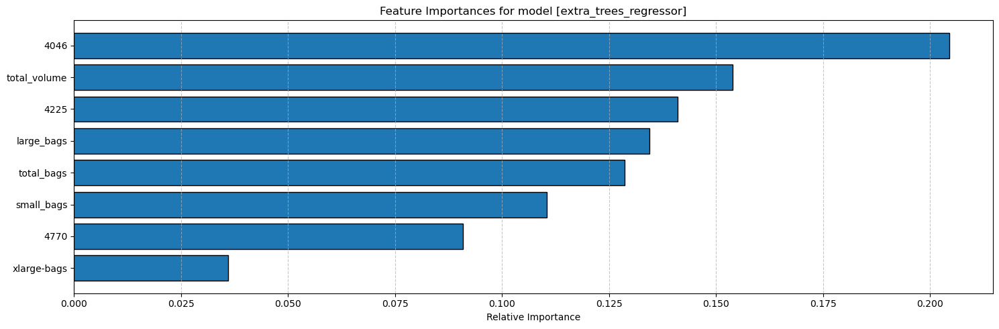

Processing Model Feature Importancen:   3%|▋                      | 1/35 [00:01<00:39,  1.17s/model]


model [random_forest_regressor] R2 --> 0.7634

coefficients:
total_volume	0.3839449501662739
4046	0.16137563461599813
4225	0.12285801829382291
large_bags	0.11081643801894067
small_bags	0.07349521127498083
4770	0.07021993324258416
total_bags	0.049181414573259925
xlarge-bags	0.028108399814139446


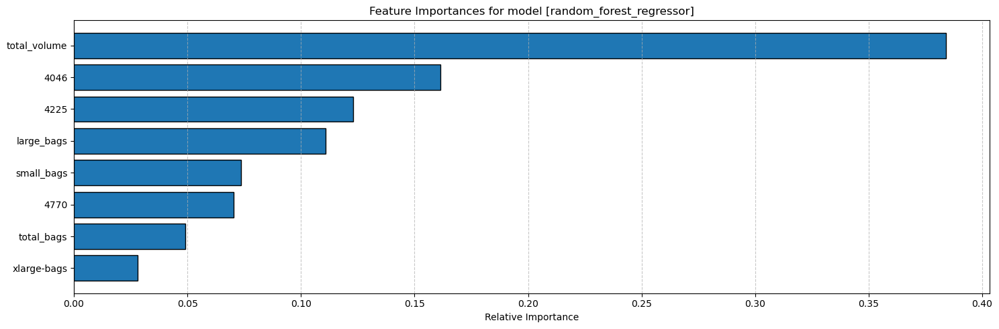

Processing Model Feature Importancen:   6%|█▎                     | 2/35 [00:02<00:37,  1.14s/model]


model [random_forest_regressor_2] R2 --> 0.7441

coefficients:
total_volume	0.41702970228251524
4046	0.15979554757490042
4225	0.115591731171966
large_bags	0.10645224442885194
small_bags	0.06664889503045228
4770	0.06656442954624363
total_bags	0.04129471644664914
xlarge-bags	0.026622733518421274


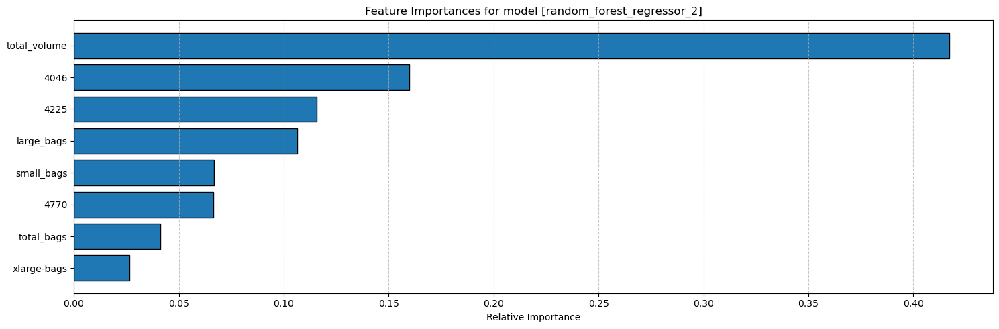

Processing Model Feature Importancen:   9%|█▉                     | 3/35 [00:02<00:30,  1.07model/s]


model [catboost_regressor] R2 --> 0.7264

coefficients:
4046	21.14370965027229
4225	18.91334545807429
large_bags	14.642110949181259
total_volume	12.079962507875798
4770	11.2786945951956
small_bags	11.112353483462769
total_bags	6.241216351876749
xlarge-bags	4.588607004061248


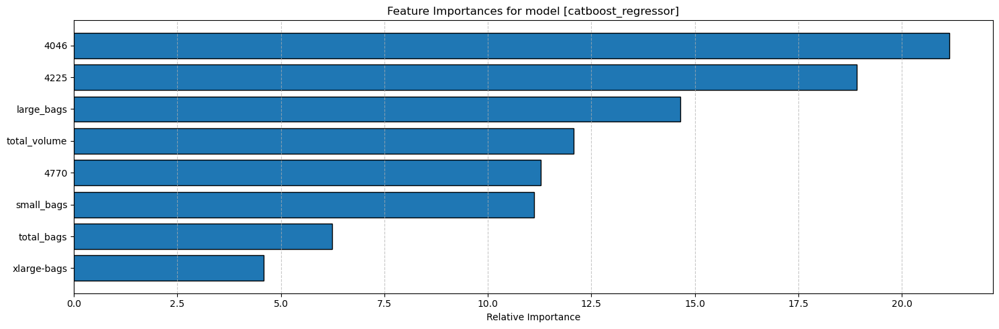

Processing Model Feature Importancen:  11%|██▋                    | 4/35 [00:03<00:26,  1.17model/s]


model [xgb_regressor_2] R2 --> 0.7201

coefficients:
total_volume	0.36144048
4046	0.1252322
large_bags	0.12117669
4225	0.093668796
4770	0.08301563
xlarge-bags	0.07807932
small_bags	0.07747827
total_bags	0.059908584


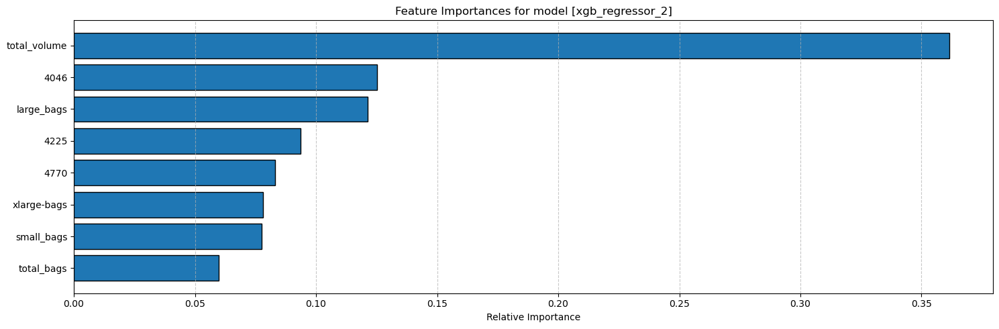

Processing Model Feature Importancen:  14%|███▎                   | 5/35 [00:04<00:24,  1.23model/s]


model [xgb_regressor_1] R2 --> 0.7201

coefficients:
total_volume	0.36144048
4046	0.1252322
large_bags	0.12117669
4225	0.093668796
4770	0.08301563
xlarge-bags	0.07807932
small_bags	0.07747827
total_bags	0.059908584


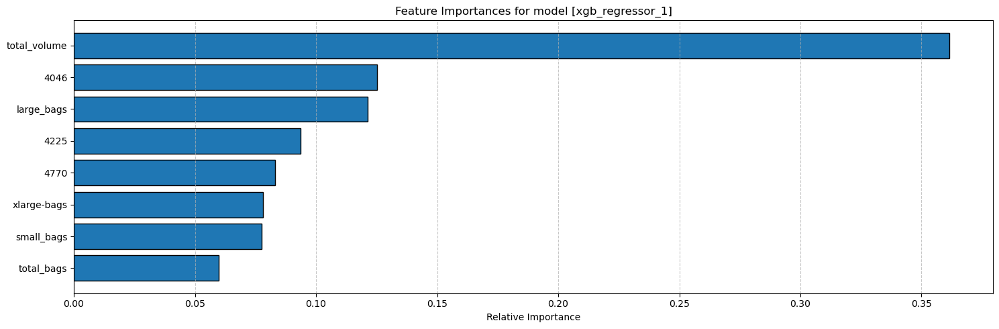

Processing Model Feature Importancen:  17%|███▉                   | 6/35 [00:05<00:23,  1.25model/s]


model [lgbm_regressor] R2 --> 0.6933

coefficients:
4225	605
4046	521
small_bags	424
large_bags	413
4770	362
total_volume	328
total_bags	210
xlarge-bags	137


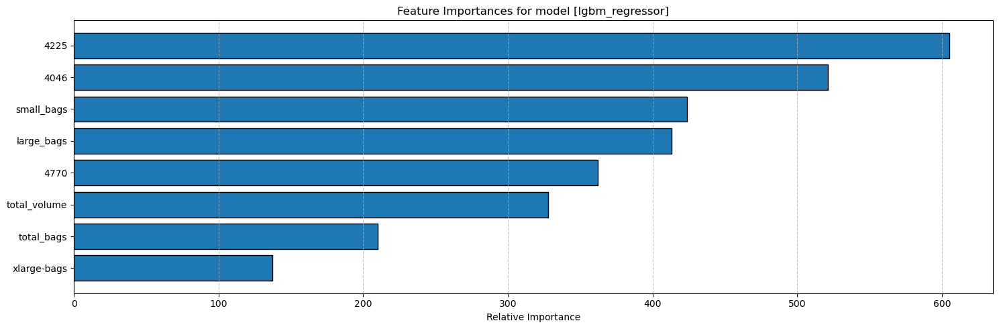

Processing Model Feature Importancen:  20%|████▌                  | 7/35 [00:06<00:25,  1.10model/s]


model [hist_gradient_boosting_regressor] R2 --> 0.6894

coefficients:
total_volume	0.13972555663499184
large_bags	0.056120362235908196
4046	0.049712778218578946
4225	0.03976933261706124
xlarge-bags	0.024680184492543947
small_bags	0.022617805468790268
4770	0.021786722173870676
total_bags	0.01115640723855173


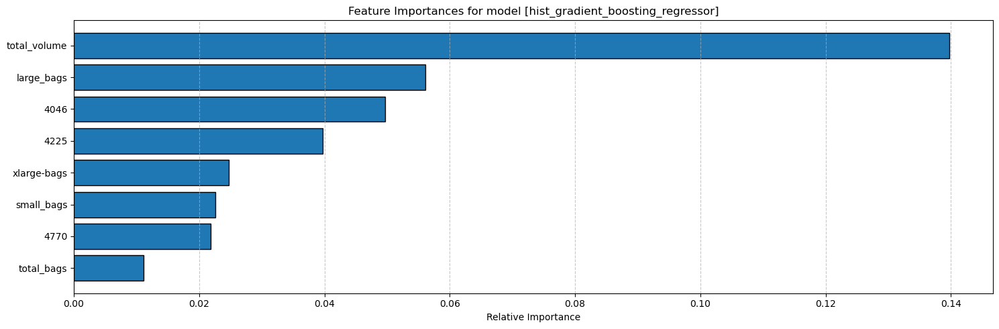

Processing Model Feature Importancen:  23%|█████▎                 | 8/35 [00:09<00:47,  1.75s/model]


model [knn_regressor_2] R2 --> 0.6587

coefficients:
large_bags	0.11747957391780824
4046	0.11562696460273973
4225	0.09820767791780823
total_volume	0.0657413506849315
small_bags	0.06085230695890411
4770	0.056075357260273975
total_bags	0.04599861282191781
xlarge-bags	0.027194132712328768


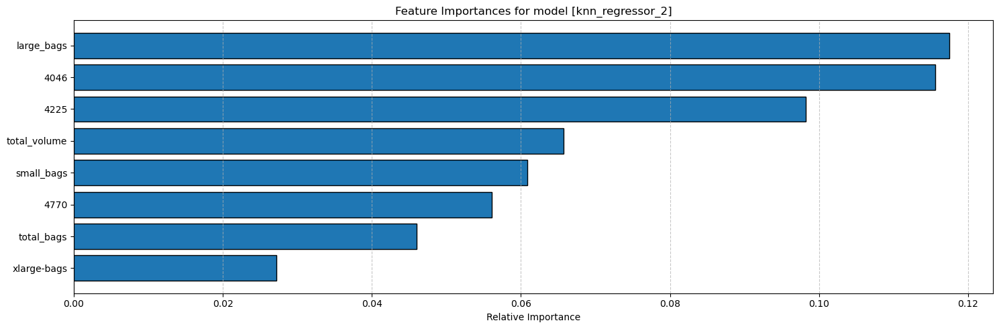

Processing Model Feature Importancen:  26%|█████▉                 | 9/35 [00:39<04:35, 10.58s/model]


model [knn_regressor_1] R2 --> 0.6587

coefficients:
large_bags	0.11747957391780824
4046	0.11562696460273973
4225	0.09820767791780823
total_volume	0.0657413506849315
small_bags	0.06085230695890411
4770	0.056075357260273975
total_bags	0.04599861282191781
xlarge-bags	0.027194132712328768


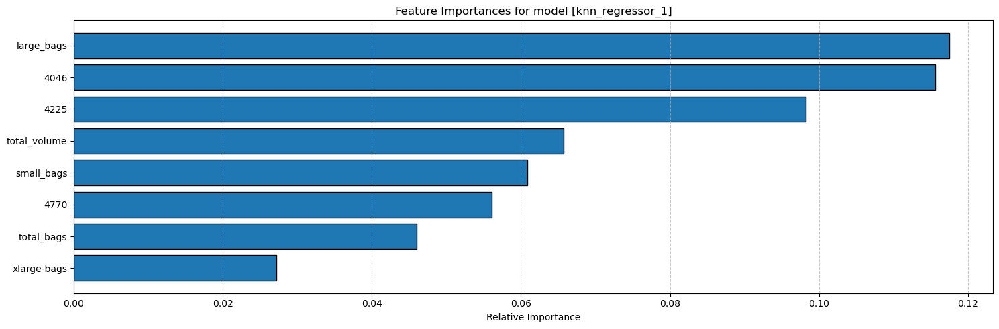

Processing Model Feature Importancen:  29%|██████▎               | 10/35 [01:04<06:08, 14.76s/model]


model [gradient_boosting_regressor_1] R2 --> 0.5678

coefficients:
total_volume	0.46453991298280617
4046	0.17119726756340117
4225	0.09190197088268494
large_bags	0.08536380837594841
total_bags	0.07660337080016334
4770	0.05322748574811591
small_bags	0.03793503256691817
xlarge-bags	0.019231151079962084


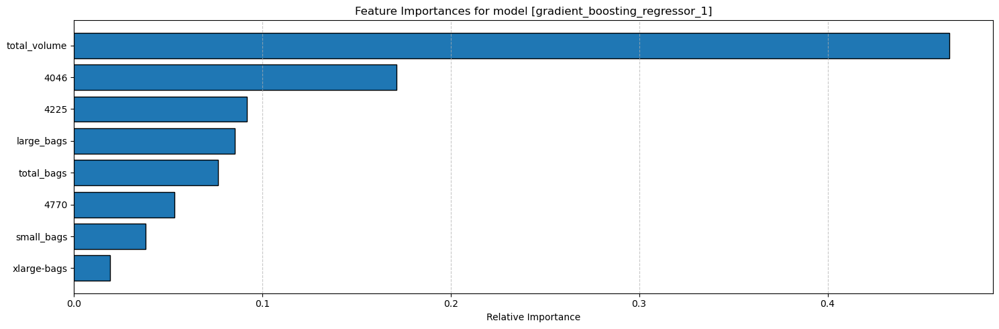

Processing Model Feature Importancen:  31%|██████▉               | 11/35 [01:04<04:10, 10.43s/model]


model [decision_tree_regressor] R2 --> 0.5627

coefficients:
total_volume	0.374344661855095
4046	0.16483973094272866
4225	0.12026053989699578
large_bags	0.11839487875814007
small_bags	0.07257301568494404
4770	0.0697472535453941
total_bags	0.04910183246057383
xlarge-bags	0.0307380868561285


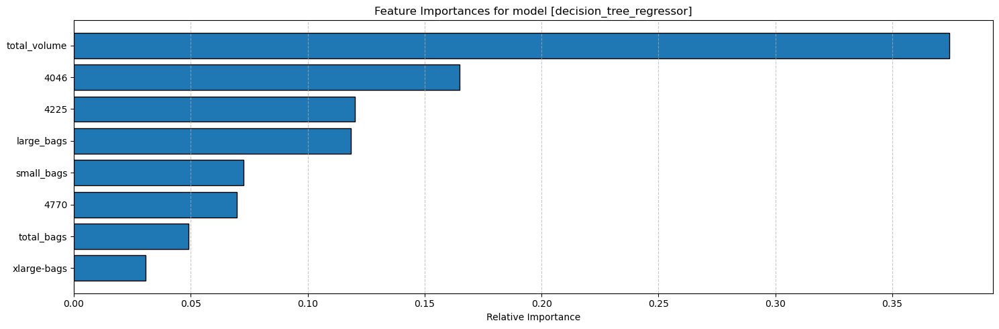

Processing Model Feature Importancen:  34%|███████▌              | 12/35 [01:05<02:51,  7.44s/model]


model [decision_tree_pruned_regressor] R2 --> 0.4742

coefficients:
total_volume	0.6250225337262577
4046	0.14267026580890937
large_bags	0.11543962658051356
4225	0.05003275316614993
4770	0.030506771193532574
small_bags	0.025660741479052493
xlarge-bags	0.010667308045584236
total_bags	0.0


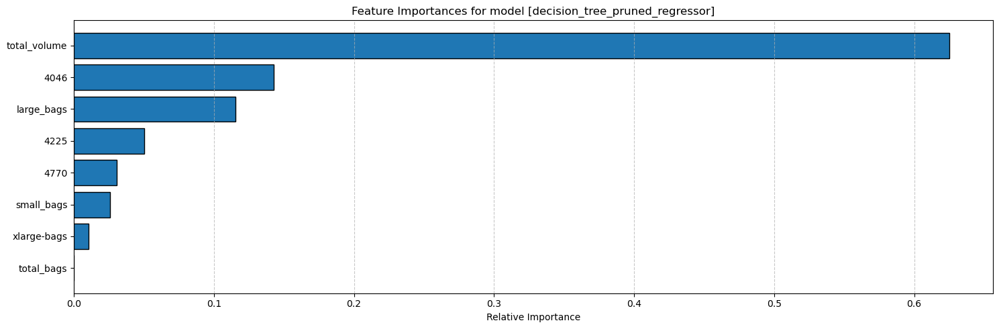

Processing Model Feature Importancen:  37%|████████▏             | 13/35 [01:05<01:58,  5.38s/model]


model [mlp_regressor_2] R2 --> 0.4630

coefficients:
4225	0.37470637684576436
large_bags	0.2880092810725178
small_bags	0.2378258674572508
4046	0.13886929442759433
total_volume	0.06485624169011359
total_bags	0.06418122670971128
4770	0.06226768392299509
xlarge-bags	0.05394253089565465


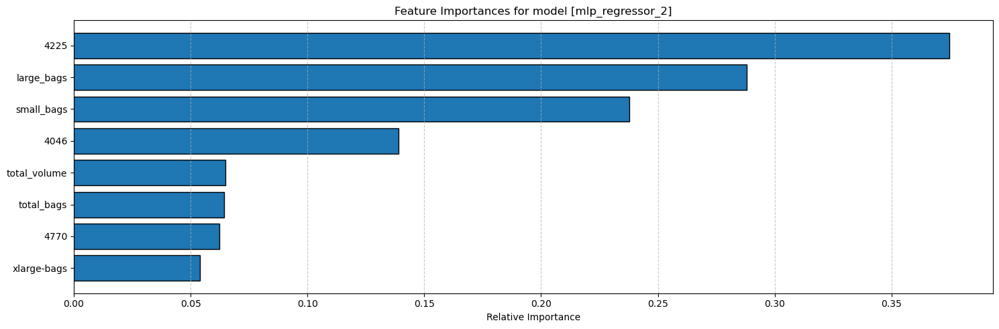

Processing Model Feature Importancen:  40%|████████▊             | 14/35 [01:06<01:24,  4.02s/model]


model [mlp_regressor_1] R2 --> 0.4380

coefficients:
4225	0.3608498132884048
total_volume	0.29195021393034093
4770	0.139114018113157
small_bags	0.11771233975793227
4046	0.08376114819642357
xlarge-bags	0.07535123279509368
large_bags	0.07466773003621292
total_bags	0.03681345328485682


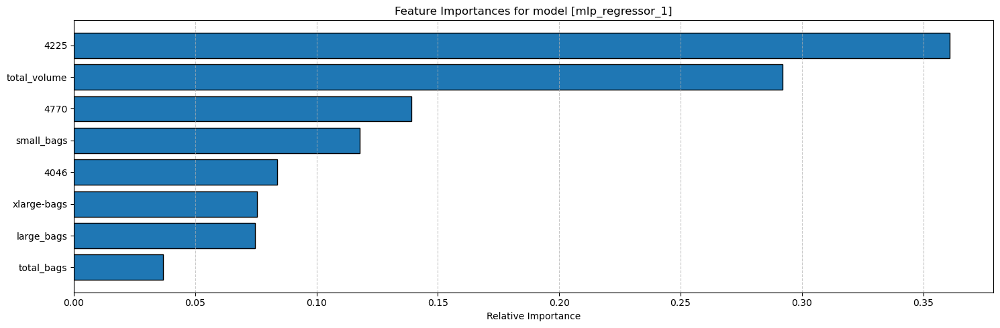

Processing Model Feature Importancen:  43%|█████████▍            | 15/35 [01:07<01:01,  3.05s/model]


model [ada_boost_regressor] R2 --> 0.3543

coefficients:
total_volume	0.04245196198763493
4046	0.014080697534017797
4225	0.012191561831906225
xlarge-bags	0.004964255863663139
large_bags	0.004732568846680232
4770	0.0034098803109994013
total_bags	0.002650503667890207
small_bags	0.002389648694327115


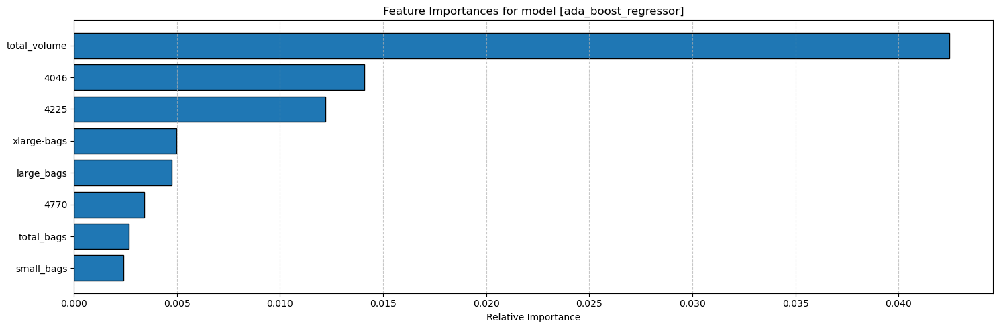

Processing Model Feature Importancen:  46%|██████████            | 16/35 [01:09<00:50,  2.66s/model]


model [linear_regressor] R2 --> 0.0435

coefficients:
total_bags	33248.058758235056
small_bags	24999.24868347553
large_bags	8219.863487202136
xlarge-bags	602.5671941924443
total_volume	543.7725435056285
4046	198.68280392629217
4225	190.85499709288683
4770	17.24034704200814


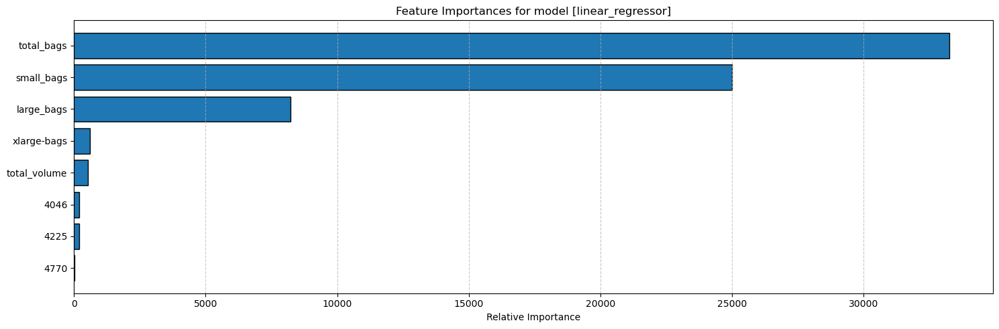

Processing Model Feature Importancen:  49%|██████████▋           | 17/35 [01:10<00:37,  2.09s/model]


model [bayesian_ridge_regressor] R2 --> 0.0433

coefficients:
4046	0.13411103812529543
4225	0.09218962555244699
4770	0.049634885483943014
xlarge-bags	0.024585249764047114
large_bags	0.02382690141073288
small_bags	0.01750124922195048
total_volume	0.015896904217526833
total_bags	0.007749969298733797


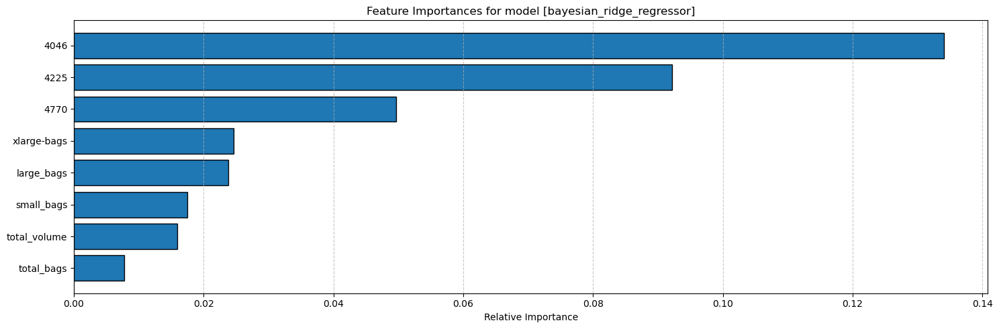

Processing Model Feature Importancen:  51%|███████████▎          | 18/35 [01:11<00:30,  1.81s/model]


model [elasticnet_regressor_cv] R2 --> 0.0432

coefficients:
4046	0.14164896667933705
4225	0.08877819243726198
4770	0.05051398582910774
xlarge-bags	0.024796669494192715
large_bags	0.022352294161557967
small_bags	0.01907790003861959
total_bags	0.0
total_volume	0.0


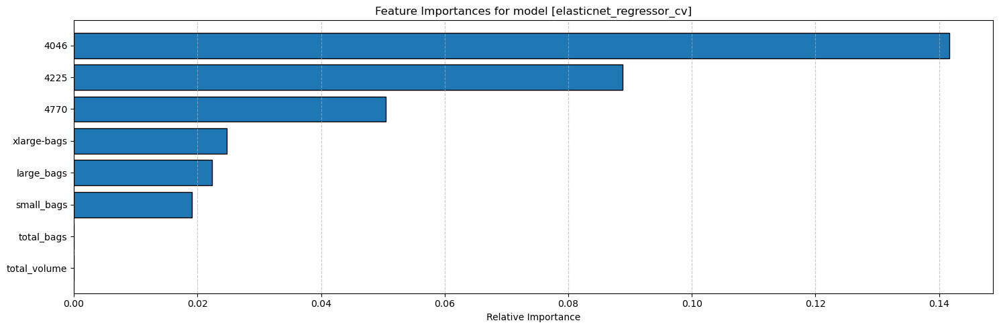

Processing Model Feature Importancen:  54%|███████████▉          | 19/35 [01:11<00:23,  1.45s/model]


model [ridge_regressor] R2 --> 0.0431

coefficients:
4046	0.13774926959555722
4225	0.09513687545846496
4770	0.050778639401117806
xlarge-bags	0.024826206381002632
large_bags	0.024090569239152086
small_bags	0.017639803030220884
total_volume	0.014371846929240876
total_bags	0.007791376154313385


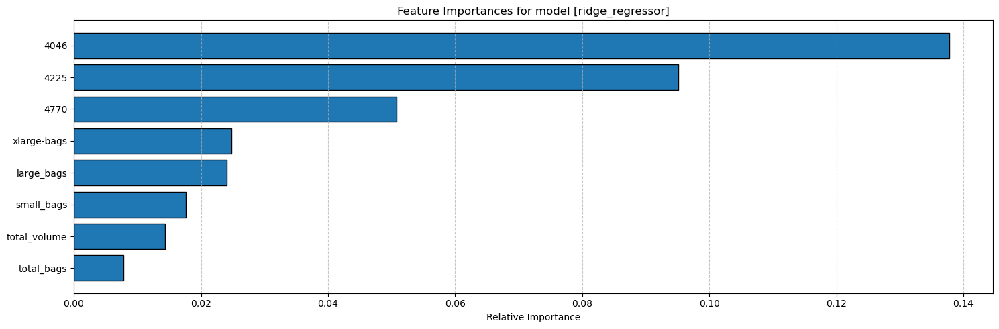

Processing Model Feature Importancen:  57%|████████████▌         | 20/35 [01:12<00:17,  1.14s/model]


model [ridge_regressor_cv] R2 --> 0.0431

coefficients:
4046	0.1373672494232721
4225	0.09527209263389247
4770	0.05071553926027073
xlarge-bags	0.024819624315933868
large_bags	0.02405182887092804
small_bags	0.017725410954886438
total_volume	0.01511522087093721
total_bags	0.007866662813658836


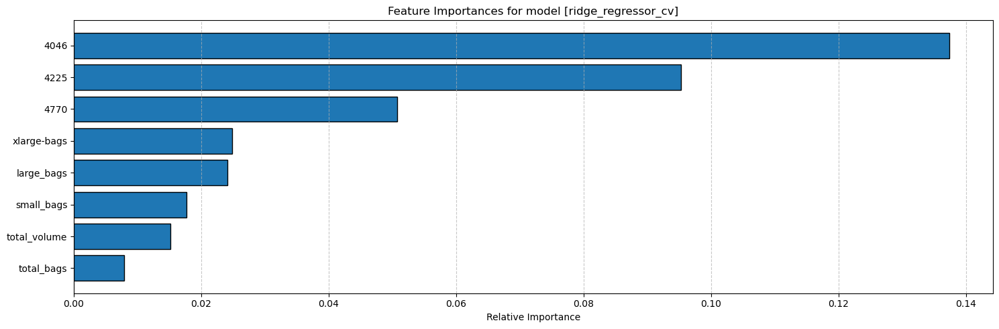

Processing Model Feature Importancen:  60%|█████████████▏        | 21/35 [01:12<00:13,  1.06model/s]


model [ridge_regressor_2] R2 --> 0.0431

coefficients:
4046	0.13774926959555722
4225	0.09513687545846496
4770	0.050778639401117806
xlarge-bags	0.024826206381002632
large_bags	0.024090569239152086
small_bags	0.017639803030220884
total_volume	0.014371846929240876
total_bags	0.007791376154313385


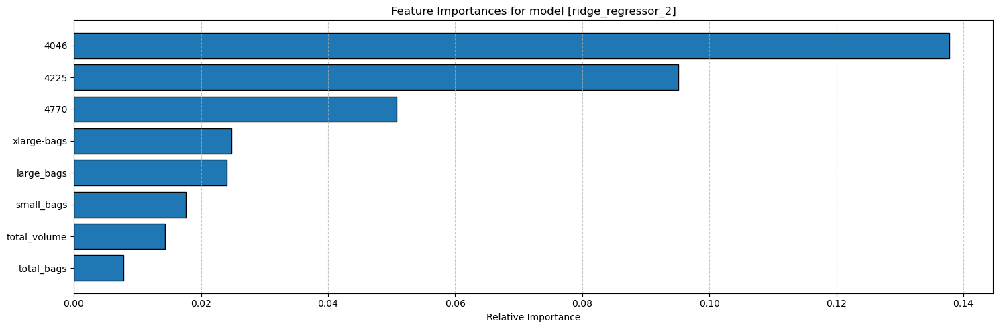

Processing Model Feature Importancen:  63%|█████████████▊        | 22/35 [01:13<00:10,  1.26model/s]


model [ard_regressor] R2 --> 0.0430

coefficients:
4046	0.14066868848099184
4225	0.0905664886306679
4770	0.05029311263046667
xlarge-bags	0.025544311224118377
large_bags	0.01775348066791513
small_bags	0.010097970986030278
total_volume	0.0011107274941198567
total_bags	0.0


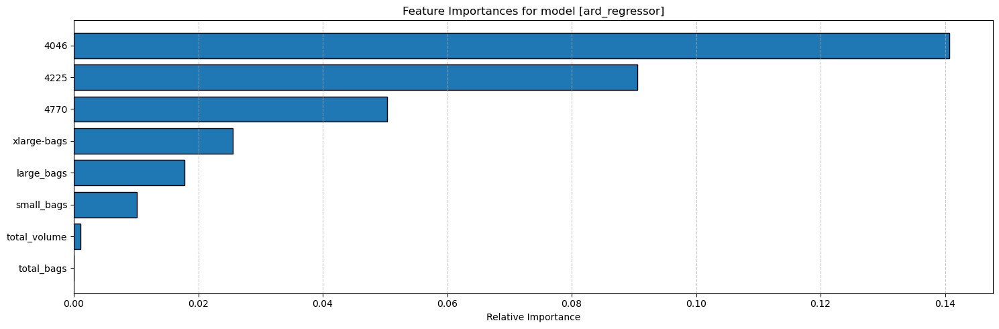

Processing Model Feature Importancen:  66%|██████████████▍       | 23/35 [01:13<00:08,  1.44model/s]


model [huber_regressor] R2 --> 0.0316

coefficients:
4046	0.14874314462768207
4225	0.09541342643183533
4770	0.060870907884908496
xlarge-bags	0.0316744400064819
small_bags	0.02089649773217256
total_volume	0.019122862338105926
large_bags	0.014992584999798633
total_bags	0.012638201656917467


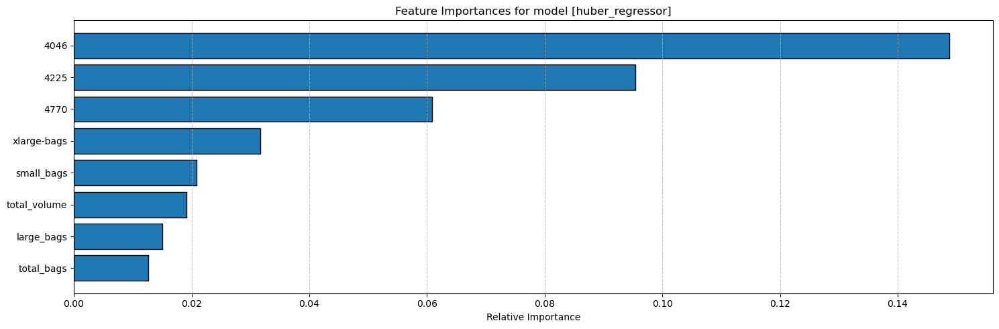

Processing Model Feature Importancen:  69%|███████████████       | 24/35 [01:14<00:06,  1.61model/s]


model [elasticnet_regressor_2] R2 --> 0.0272

coefficients:
4046	0.03376540705009615
xlarge-bags	0.0
large_bags	0.0
small_bags	0.0
total_bags	0.0
4770	0.0
4225	0.0
total_volume	0.0


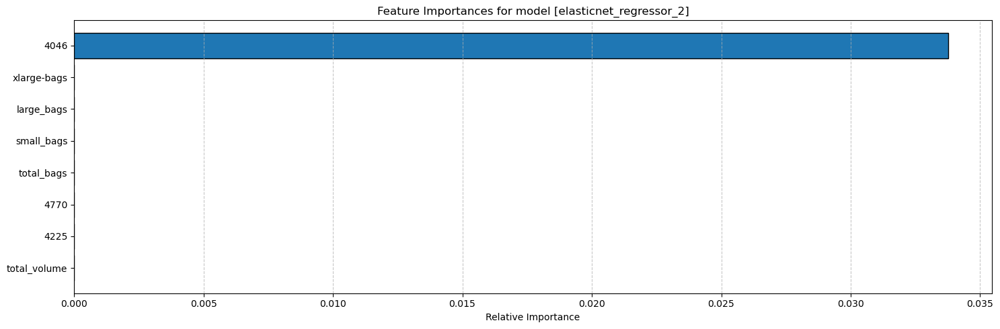

Processing Model Feature Importancen:  71%|███████████████▋      | 25/35 [01:14<00:05,  1.69model/s]


model [theil_sen_regressor] R2 --> -61.3780

coefficients:
4225	5.69206965876056
large_bags	4.3309129227958065
4046	3.912292545090581
total_bags	3.6403807514868776
small_bags	3.43646629249494
xlarge-bags	2.9088371007951364
4770	1.5016265836138045
total_volume	1.367781128173688


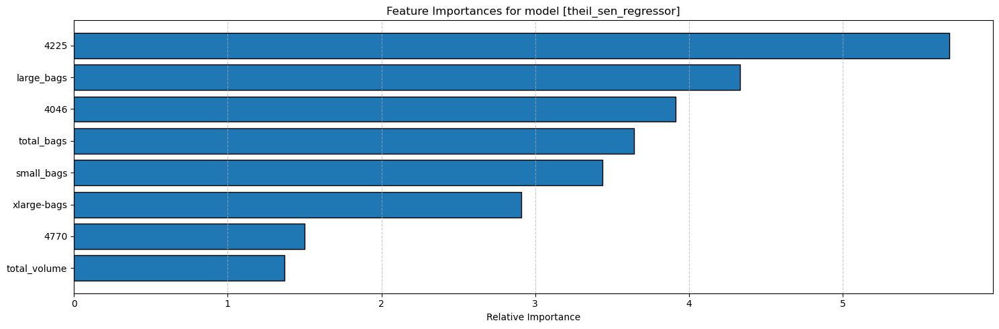

Processing Model Feature Importancen:  74%|████████████████▎     | 26/35 [01:15<00:05,  1.77model/s]


model [ransac_regressor] R2 --> -12.7083

coefficients:
total_bags	1511826099.698011
small_bags	876318467.1297572
large_bags	90003224.03126365
xlarge-bags	437782.8557316867
total_volume	12608.362579344
4046	1660.30751982146
4225	1475.6096464608909
4770	14.83140788830048


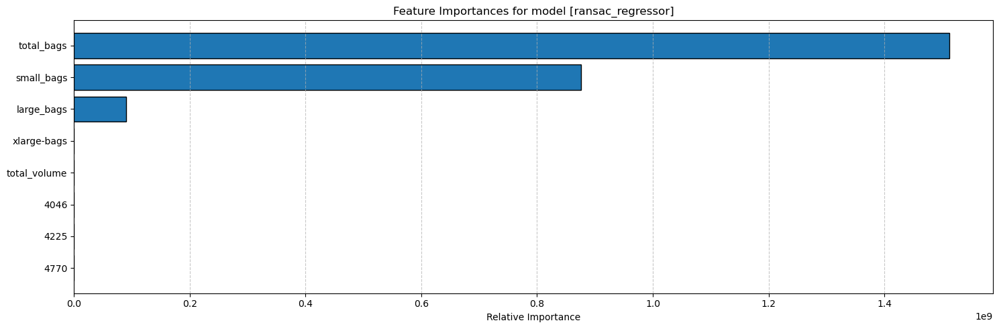

Processing Model Feature Importancen:  77%|████████████████▉     | 27/35 [01:15<00:04,  1.81model/s]


model [svm_regressor_linear_2] R2 --> -0.2121

coefficients:
4225	0.05382415085086436
small_bags	0.05124307877094131
total_volume	0.04111572623102732
4046	0.03596765824440706
xlarge-bags	0.03497517868955717
total_bags	0.03130002333995017
large_bags	0.02726714536818246
4770	0.006064996574526507


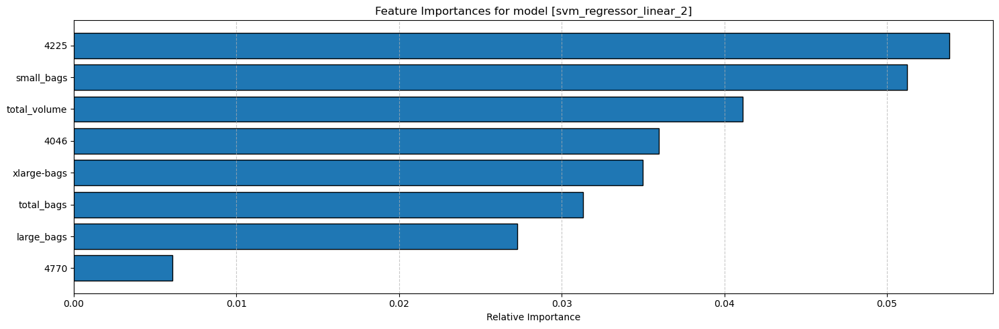

Processing Model Feature Importancen:  80%|█████████████████▌    | 28/35 [01:16<00:03,  1.95model/s]


model [svm_regressor_linear_1] R2 --> -0.0093

coefficients:
4046	0.1770278588986727
4770	0.07009163933229921
4225	0.06967315799570054
xlarge-bags	0.05292568221350375
total_volume	0.03130499383332708
total_bags	0.01045747109261539
small_bags	0.009533615809011265
large_bags	0.009215435925287237


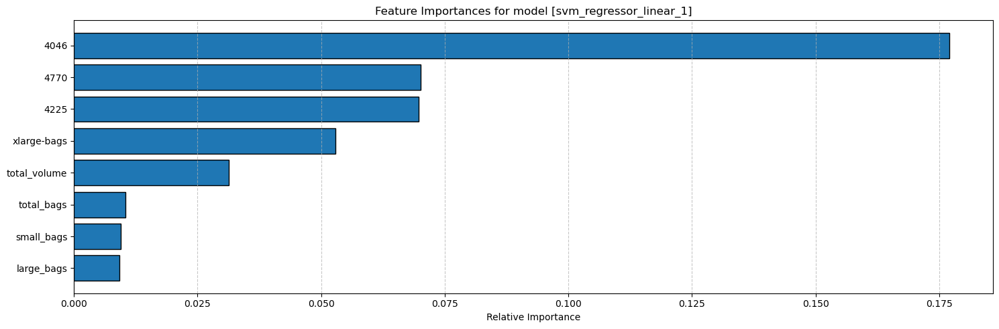

Processing Model Feature Importancen:  83%|██████████████████▏   | 29/35 [01:16<00:02,  2.06model/s]


model [lasso_regressor_2] R2 --> -0.0002

coefficients:
xlarge-bags	0.0
large_bags	0.0
small_bags	0.0
total_bags	0.0
4770	0.0
4225	0.0
4046	0.0
total_volume	0.0


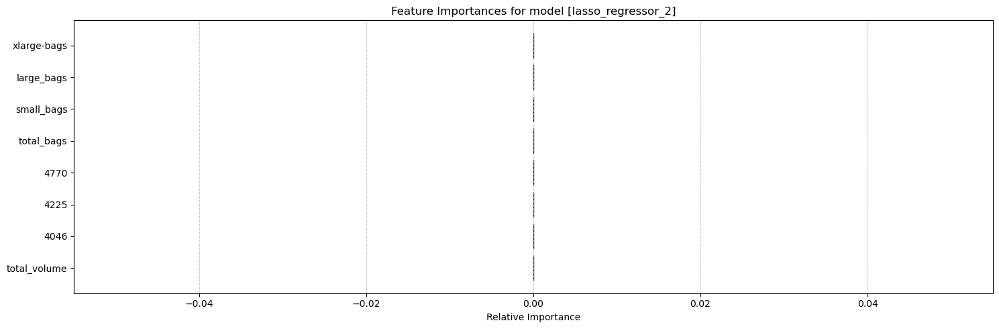

Processing Model Feature Importancen:  86%|██████████████████▊   | 30/35 [01:16<00:02,  2.12model/s]


model [elasticnet_regressor] R2 --> -0.0002

coefficients:
xlarge-bags	0.0
large_bags	0.0
small_bags	0.0
total_bags	0.0
4770	0.0
4225	0.0
4046	0.0
total_volume	0.0


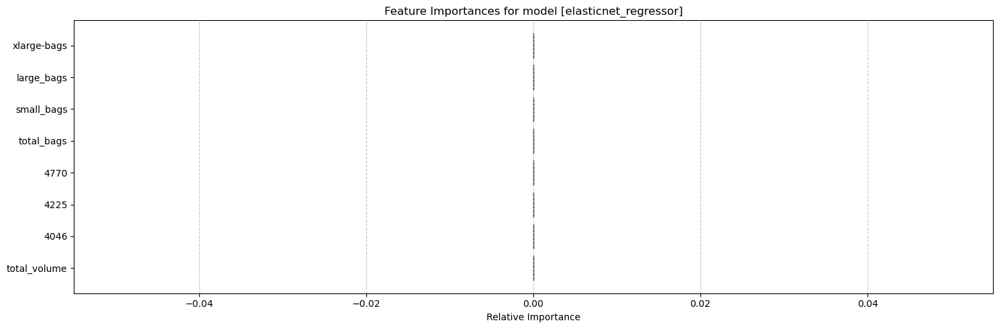

Processing Model Feature Importancen:  89%|███████████████████▍  | 31/35 [01:17<00:01,  2.23model/s]


model [lasso_regressor_cv] R2 --> -0.0002

coefficients:
xlarge-bags	0.0
large_bags	0.0
small_bags	0.0
total_bags	0.0
4770	0.0
4225	0.0
4046	0.0
total_volume	0.0


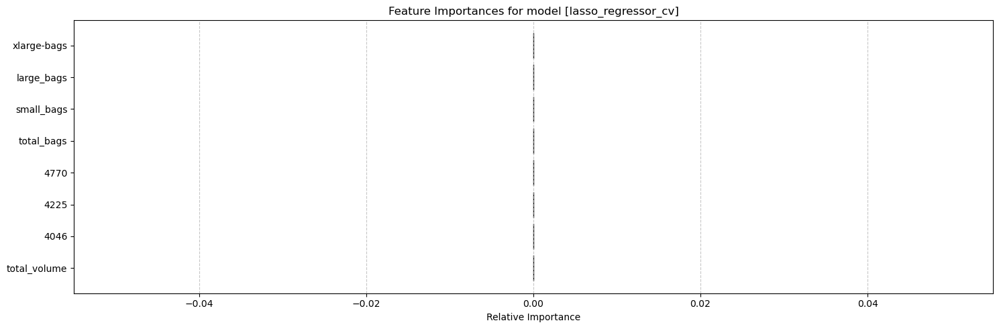

Processing Model Feature Importancen:  91%|████████████████████  | 32/35 [01:17<00:01,  2.24model/s]


model [elastic_regressor_cv_2] R2 --> -0.0002

coefficients:
xlarge-bags	0.0
large_bags	0.0
small_bags	0.0
total_bags	0.0
4770	0.0
4225	0.0
4046	0.0
total_volume	0.0


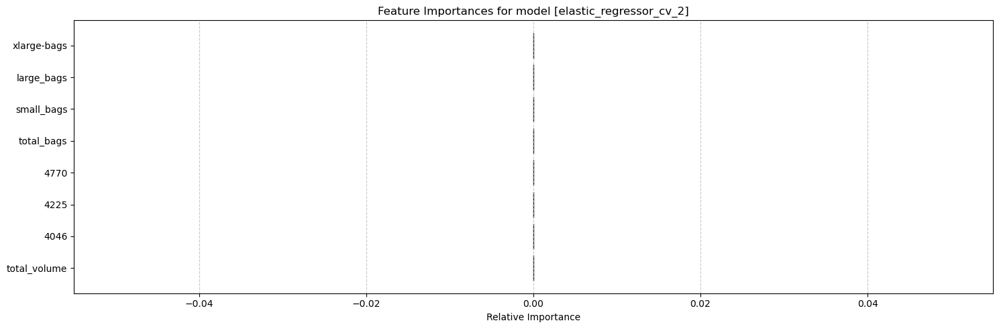

Processing Model Feature Importancen:  94%|████████████████████▋ | 33/35 [01:18<00:00,  2.26model/s]


model [gradient_boosting_regressor_2] R2 --> -0.0002

coefficients:
xlarge-bags	0.0
large_bags	0.0
small_bags	0.0
total_bags	0.0
4770	0.0
4225	0.0
4046	0.0
total_volume	0.0


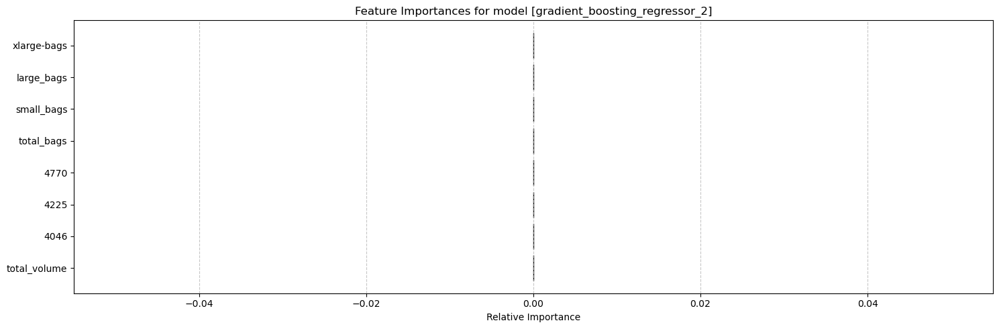

Processing Model Feature Importancen:  97%|█████████████████████▎| 34/35 [01:18<00:00,  2.27model/s]


model [lasso_regressor] R2 --> -0.0002

coefficients:
xlarge-bags	0.0
large_bags	0.0
small_bags	0.0
total_bags	0.0
4770	0.0
4225	0.0
4046	0.0
total_volume	0.0


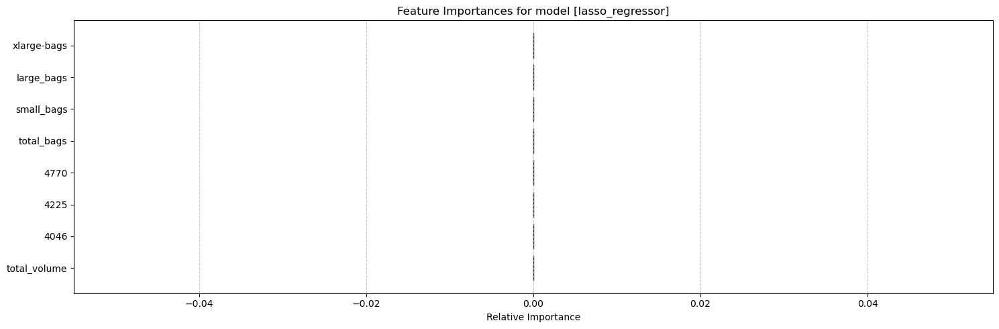

Processing Model Feature Importancen: 100%|██████████████████████| 35/35 [01:19<00:00,  2.26s/model]




CPU times: user 57.3 s, sys: 234 ms, total: 57.5 s
Wall time: 1min 19s


In [77]:
%%time

for model_name in tqdm(lst_sorted_models, desc=f"Processing Model Feature Importancen", unit="model"):
    try:
        model = dict_completed_models[model_name]

        r2 = df_model_evaluation_metrics[df_model_evaluation_metrics['model_name'] == model_name].r2.iloc[0]
        
        try:
            
            print(f'\nmodel [{model_name}] R2 --> {r2}')
            print('='*70, '\n')
        except:
            print(f"Exception message: {e}")  # Print the exception message
            traceback.print_exc()  # Print the full stack trace
        
        # get feature importance
        lst_coefficients, plt = display_feature_importance_chart(model, model_name, list(X_train.columns), 10, 'feature_importance_' + str(model_name), X_test_scaled, y_test, True)
    except Exception as e:
        print('Exception caught while processing model:', model_name)
        print(f"Exception message: {e}")  # Print the exception message
        traceback.print_exc()  # Print the full stack trace
        continue

print('\n\n')

<hr style="height:30px;color:#000;background-color:#F00;">

# <b> Process Outliers </b>

As we'll see, this data is heavily populated with outliers. We will proceed below with several outlier transformations and then we will model the transformed dataset and compare metrics to the dataset that does not undergo outlier transformations. We hope to select the model 9or ensemble) that performs best

source: "Outlier detection methods!", Marcin Rutecki, https://www.kaggle.com/code/marcinrutecki/outlier-detection-methods, Retrieved: 2025-02-07

# First, re-visualize boxplots

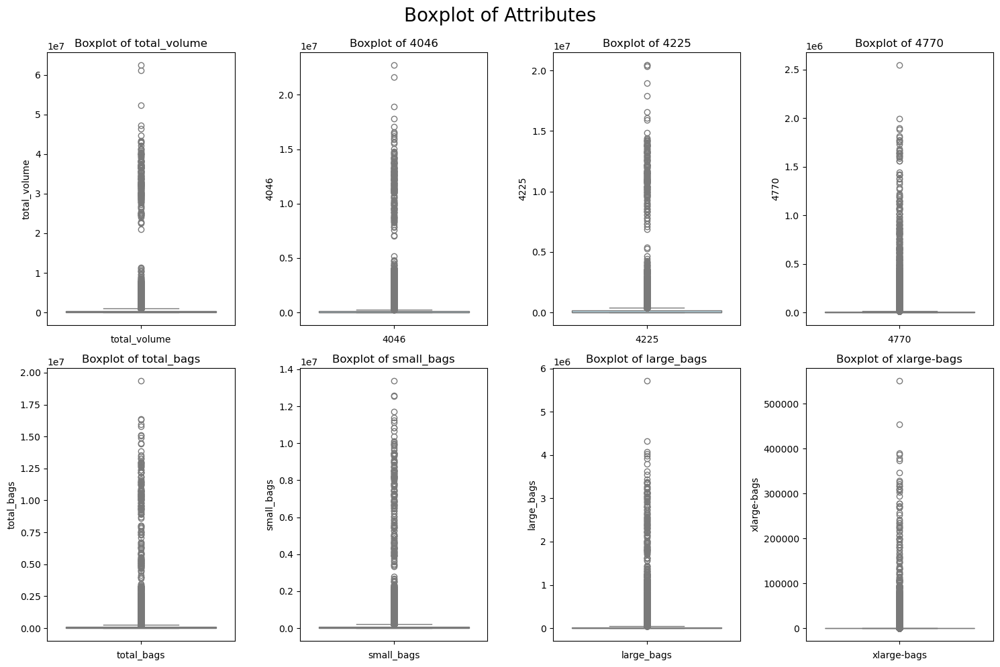

In [78]:
################################################
# call fcn - sns boxplot
################################################
#df_to_analyze = df[lst_all_numerical_cols]
#df_to_analyze = df.select_dtypes(include=[np.number])
df_X_features = df[lst_features]
plot_boxplot(df_to_analyze, "Boxplot of Attributes", False)

# Describe Dataframe

In [79]:
# create df_X_features
df_X_features = df[lst_features]
print(f'dataframe of X features is named --> df_X_features:')
#print_df(df_X_features.head(5))
df_X_features

dataframe of X features is named --> df_X_features:


,total_volume,4046,4225,4770,total_bags,small_bags,large_bags,xlarge-bags
0,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0
1,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0
2,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0
3,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0
4,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0
...,...,...,...,...,...,...,...,...
18244,17074.83,2046.96,1529.20,0.00,13498.67,13066.82,431.85,0.0
18245,13888.04,1191.70,3431.50,0.00,9264.84,8940.04,324.80,0.0
18246,13766.76,1191.92,2452.79,727.94,9394.11,9351.80,42.31,0.0
18247,16205.22,1527.63,2981.04,727.01,10969.54,10919.54,50.00,0.0


In [80]:
df_describe = df_X_features.describe().T
df_describe['skew'] = df_X_features.skew()
df_describe['kurtosis'] = df_X_features.kurt()

df_describe

,count,mean,std,min,25%,50%,75%,max,skew,kurtosis
total_volume,18249.0,850644.013009,3.453545e+06,84.56,10838.58,107376.76,432962.29,62505646.52,9.007687,92.104458
4046,18249.0,293008.424531,1.264989e+06,0.00,854.07,8645.30,111020.20,22743616.17,8.648220,86.809113
4225,18249.0,295154.568356,1.204120e+06,0.00,3008.78,29061.02,150206.86,20470572.61,8.942466,91.949022
4770,18249.0,22839.735993,1.074641e+05,0.00,0.00,184.99,6243.42,2546439.11,10.159396,132.563441
total_bags,18249.0,239639.202060,9.862424e+05,0.00,5088.64,39743.83,110783.37,19373134.37,9.756072,112.272156
small_bags,18249.0,182194.686696,7.461785e+05,0.00,2849.42,26362.82,83337.67,13384586.80,9.540660,107.012885
large_bags,18249.0,54338.088145,2.439660e+05,0.00,127.47,2647.71,22029.25,5719096.61,9.796455,117.999481
xlarge-bags,18249.0,3106.426507,1.769289e+04,0.00,0.00,0.00,132.50,551693.65,13.139751,233.602612


# View KDE of data before and after Standardization

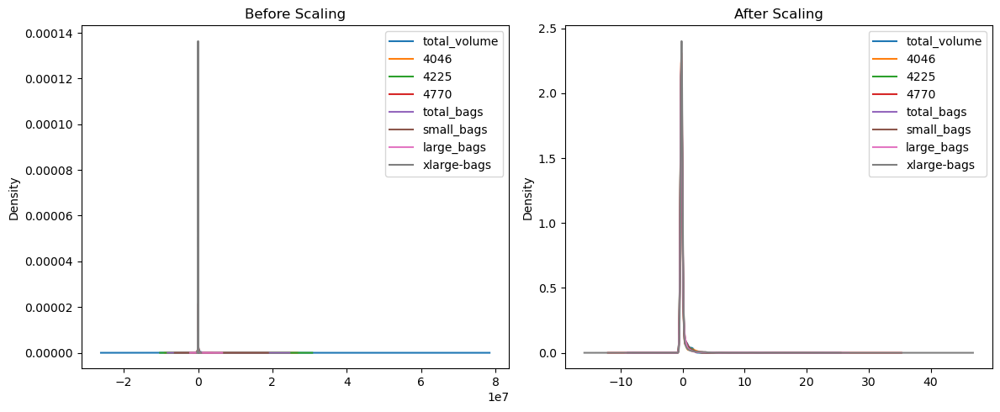



CPU times: user 8.97 s, sys: 432 μs, total: 8.97 s
Wall time: 11.2 s


In [81]:
%%time

fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Before scaling
X_train.plot(kind='kde', ax=axes[0], title="Before Scaling")

# After scaling
df_X_train.plot(kind='kde', ax=axes[1], title="After Scaling")

plt.tight_layout()
plt.show()

print('\n')

# Re-visualize Histplots of data distribution

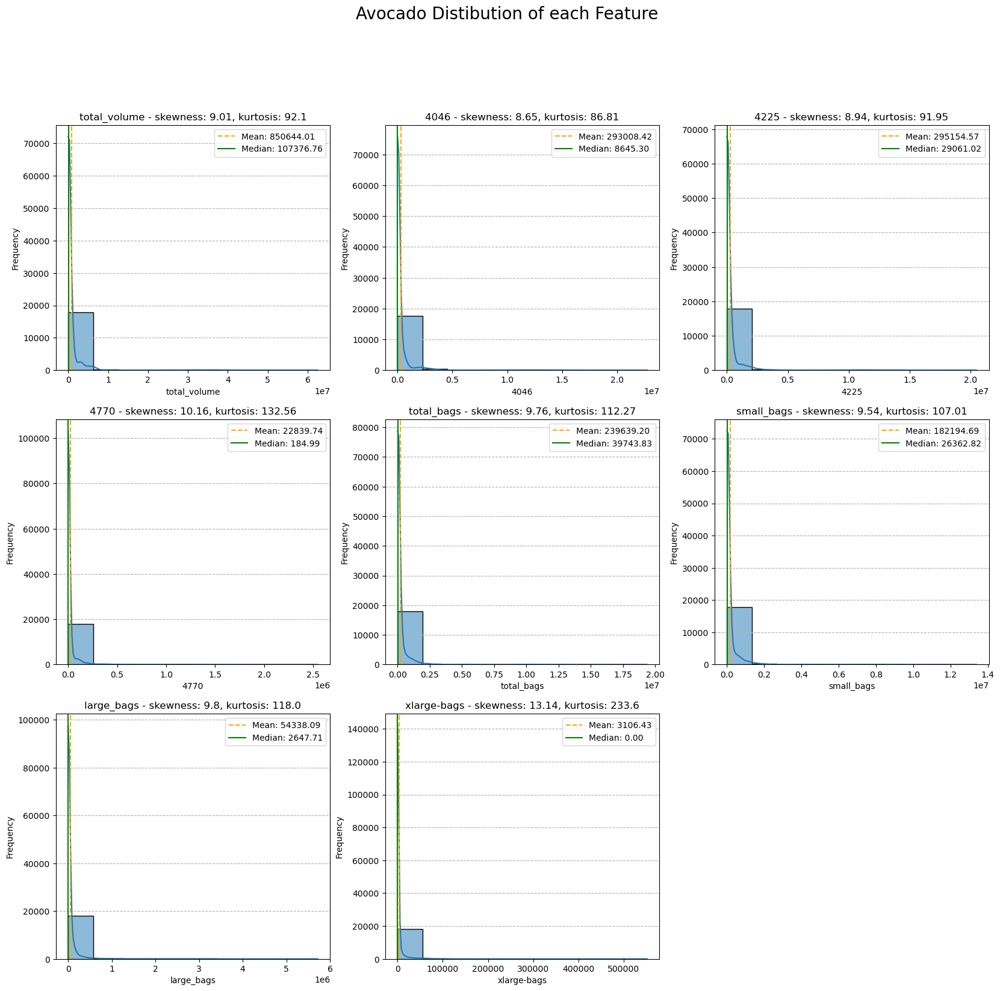

In [82]:
df_to_analyze = df_X_features
plot_kde_histplot(df_to_analyze, False, 3, 'Avocado Distibution of each Feature')

<hr style="height:30px;color:#000;background-color:#000;">

# Tukey's IQR Method

Tukey’s  (1977)  technique  is  used  to  detect  outliers  in  **skewed or non bell-shaped data** since it makes no distributional assumptions. However, Tukey’s method may not be appropriate for a small sample size. The general rule is that anything not in the range of (Q1 - 1.5 IQR) and (Q3 + 1.5 IQR) is an outlier, and can be removed.

Inter Quartile Range (IQR) is one of the most extensively used procedure for outlier detection and removal.

Procedure:
1. Find the first quartile, Q1.
2. Find the third quartile, Q3.
3. Calculate the IQR. IQR = Q3-Q1.
4. Define the normal data range with lower limit as Q1–1.5 IQR and upper limit as Q3+1.5 IQR.

Any data point outside this range is considered as outlier and should be removed for further analysis.

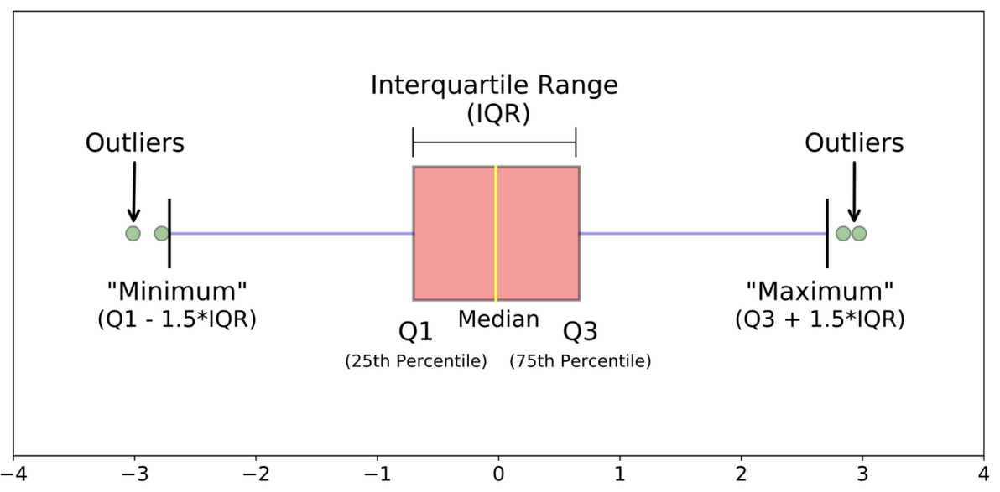

source: "Outlier detection methods!", Marcin Rutecki, https://www.kaggle.com/code/marcinrutecki/outlier-detection-methods, Retrieved: 2025-02-07

In [83]:
def detect_and_remove_outliers_iqr(df_to_analyze, lst_features):
    """
    Detects and removes outliers from specified columns in a DataFrame using the IQR method.

    Args:
        df_to_analyze (pd.DataFrame): The input DataFrame.
        lst_features (list): A list of column names to analyze for outliers.

    Returns:
        pd.DataFrame: The DataFrame with outliers removed from all specified columns.
        dict: A dictionary where keys are column names and values are lists of outlier indices for each column.
    """

    all_outlier_indices = {feature: [] for feature in lst_features}  # Initialize all_outlier_indices
    df_cleaned = df_to_analyze.copy()

    count_total_outliers_removed = 0

    for feature_name in lst_features:
        try:
            df_cleaned[feature_name] = pd.to_numeric(df_cleaned[feature_name], errors='coerce')
            df_cleaned.dropna(subset=[feature_name], inplace=True)

            data = df_cleaned[feature_name].values

            if len(data) < 3:
                continue #Skip to the next feature

            q1 = np.percentile(data, 25)
            q3 = np.percentile(data, 75)
            iqr = q3 - q1

            lower_bound = q1 - 1.5 * iqr
            upper_bound = q3 + 1.5 * iqr

            outlier_mask = (data < lower_bound) | (data > upper_bound) #Create a boolean mask
            
            # accumulate list of outlier indicies for this feature
            all_outlier_indices[feature_name] = df_cleaned.index[outlier_mask].tolist() #Use the mask with the original index

            count_outliers_removed_within_this_feature = len(all_outlier_indices[feature_name])
            print(f'Count outliers to remove from feature: [{feature_name}] --> {count_outliers_removed_within_this_feature}')

            

        except Exception as e:
            print(f"Error processing column '{feature_name}': {e}")
            continue  # Continue to the next feature

    #Remove all outlier rows at once, using the collected indices.
    rows_to_remove = []
    
    # accumulate all indicies for all features first
    for indices in all_outlier_indices.values():
        rows_to_remove.extend(indices)

    # Remove duplicates and sort
    rows_to_remove = sorted(list(set(rows_to_remove))) 

    count_total_outliers_removed = len(rows_to_remove)

    df_cleaned = df_to_analyze.drop(rows_to_remove, errors='ignore') #Drop from original dataframe using the original indices

    return df_cleaned, all_outlier_indices, count_total_outliers_removed

# NOTE: AI assisted code from Gemini

In [84]:
# detecting outliers
df_cleaned, outlier_indices_dict, count_total_outliers_removed = detect_and_remove_outliers_iqr(df, lst_features)
y_cleaned = df_cleaned[DEPENDENT_VAR_NAME]
print(f'\ntotal number of outlier instances removed: --> {count_total_outliers_removed}')

# set cleaned df
df_cleaned_features_IQR = df_cleaned[lst_features]

Count outliers to remove from feature: [total_volume] --> 2297
Count outliers to remove from feature: [4046] --> 2518
Count outliers to remove from feature: [4225] --> 2519
Count outliers to remove from feature: [4770] --> 2918
Count outliers to remove from feature: [total_bags] --> 2533
Count outliers to remove from feature: [small_bags] --> 2407
Count outliers to remove from feature: [large_bags] --> 2707
Count outliers to remove from feature: [xlarge-bags] --> 4014

total number of outlier instances removed: --> 6502


# View updated distributions with some outliers removed

ORIGINAL    sum_shape_metric: 977.3584239619304 
TRANSFORMED sum_shape_metric: 104.91148475412267


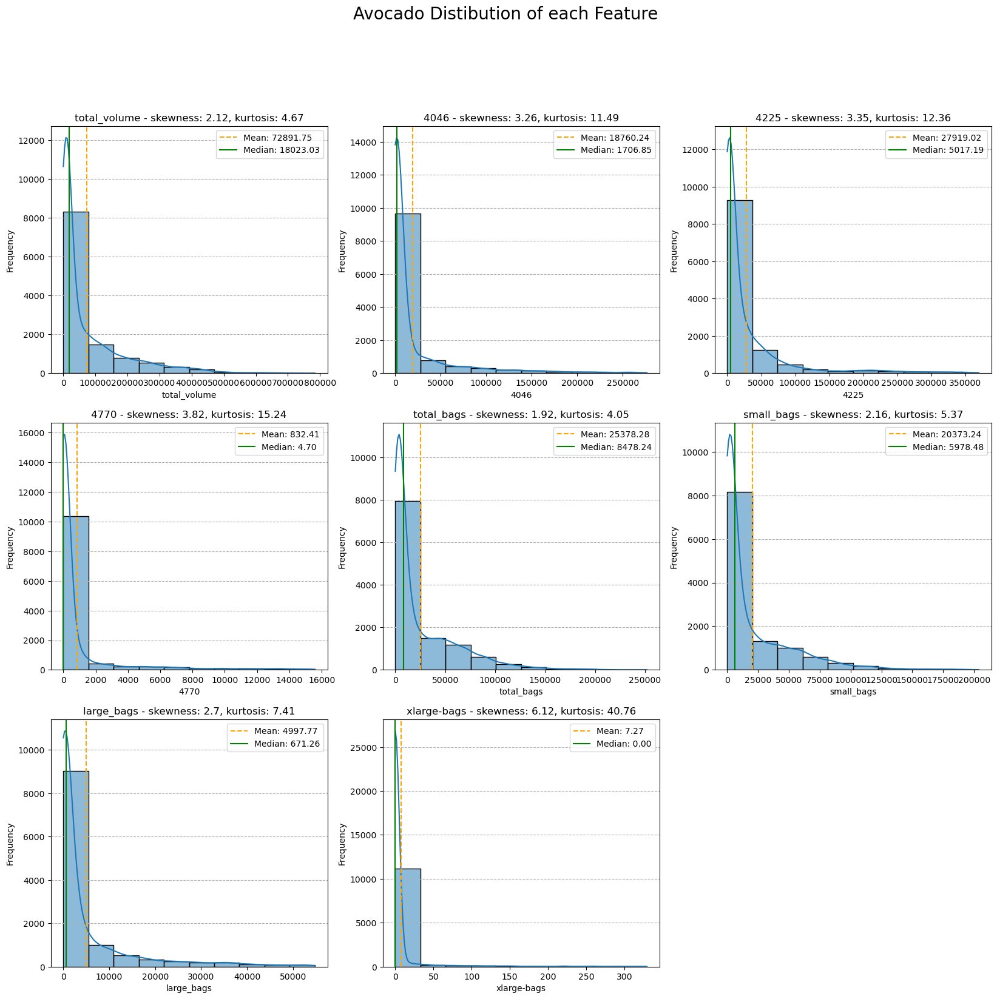

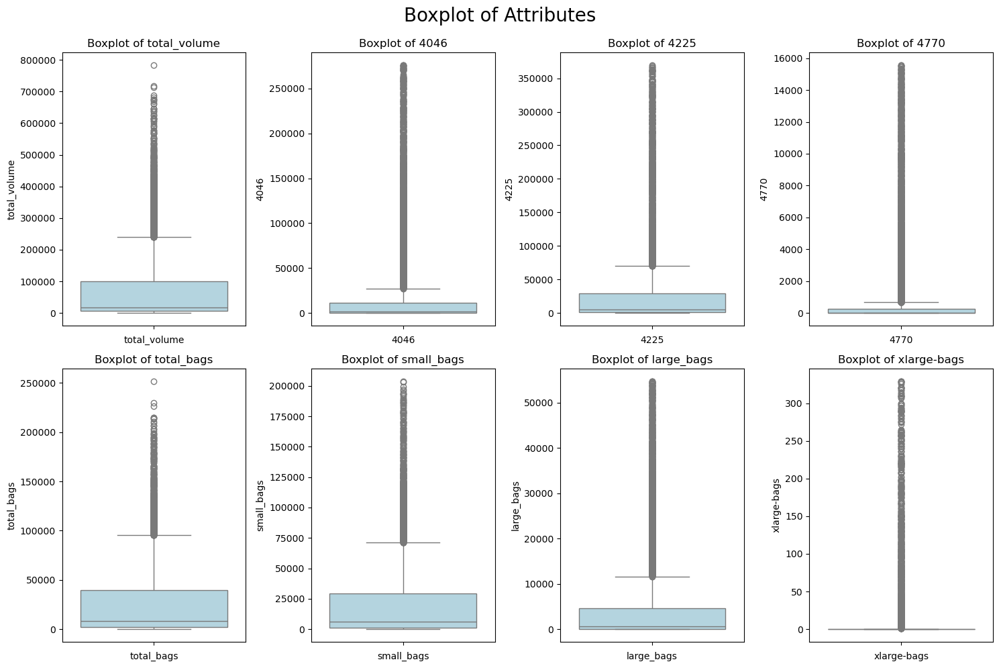

In [85]:
###############################################
# print original skewness and kurtosis
###############################################
SKEWNESS = skew(df_X_features)
KURTOSIS = kurtosis(df_X_features)
shape_metric = list(np.sqrt(np.power(SKEWNESS, 2) + np.power(KURTOSIS, 2)))
sum_shape_metric = np.sum(shape_metric)

#print(f'ORIGINAL    sum_shape_metric: {sum_shape_metric} \t shape_metric: {shape_metric}')
print(f'ORIGINAL    sum_shape_metric: {sum_shape_metric} ')

###############################################
# print transformed skewness and kurtosis
###############################################
SKEWNESS_TRANSFORMED = skew(df_cleaned_features_IQR)
KURTOSIS_TRANSFORMED = kurtosis(df_cleaned_features_IQR)
shape_metric_TRANSFORMED = list(np.sqrt(np.power(SKEWNESS_TRANSFORMED, 2) + np.power(KURTOSIS_TRANSFORMED, 2)))
sum_shape_metric_TRANSFORMED = np.sum(shape_metric_TRANSFORMED)

#print(f'TRANSFORMED sum_shape_metric: {sum_shape_metric_TRANSFORMED} \t shape_metric: {shape_metric_TRANSFORMED}')
print(f'TRANSFORMED sum_shape_metric: {sum_shape_metric_TRANSFORMED}')

################################################
# call fcn - sns hist plots
################################################
df_to_analyze = df_cleaned_features_IQR
plot_kde_histplot(df_to_analyze, False, 3, 'Avocado Distibution of each Feature')

################################################
# call fcn - sns boxplot
################################################
#df_to_analyze = df.select_dtypes(include=[np.number])
df_to_analyze = df_cleaned_features_IQR
plot_boxplot(df_to_analyze, "Boxplot of Attributes", False)

<hr style="height:10px;color:#000;background-color:#F0F;">

# <span style="color: blue;"> <b><u> Create Holdout, Standardize Dataframe, Model Data, Evaluate Performance </b></u></span>  


creating hold-out set and standardizing dataset...
X_train: (9397, 8)
y_train: 9397

X_test: (2350, 8)
y_test: 2350

Done! Visualizing dataset before and after standardization and outlier transformation...


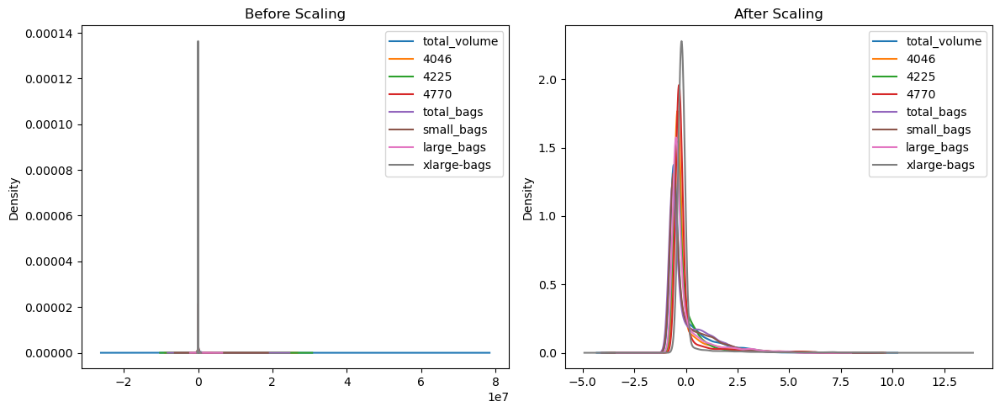


Done! Initiating data modeling!
instantiating models...
model instantiation complete!


Processing Model:   0%|                                                   | 0/35 [00:00<?, ?model/s]



######################################################################
# training model --> ada_boost_regressor
######################################################################
hyperparameters --> {'estimator': None, 'learning_rate': 1.0, 'loss': 'linear', 'n_estimators': 50, 'random_state': 42}



Processing Model:   3%|█▏                                         | 1/35 [00:07<04:11,  7.39s/model]

training model ada_boost_regressor complete! 	R2: 0.1822	analysis_duration --> 0:00:07.384942



######################################################################
# training model --> ard_regressor
######################################################################
hyperparameters --> {'alpha_1': 1e-06, 'alpha_2': 1e-06, 'compute_score': False, 'copy_X': True, 'fit_intercept': True, 'lambda_1': 1e-06, 'lambda_2': 1e-06, 'max_iter': 300, 'threshold_lambda': 10000.0, 'tol': 0.001, 'verbose': False}



Processing Model:   9%|███▋                                       | 3/35 [00:07<00:58,  1.82s/model]

training model ard_regressor complete! 	R2: 0.1853	analysis_duration --> 0:00:00.263121



######################################################################
# training model --> bayesian_ridge_regressor
######################################################################
hyperparameters --> {'alpha_1': 1e-06, 'alpha_2': 1e-06, 'alpha_init': None, 'compute_score': False, 'copy_X': True, 'fit_intercept': True, 'lambda_1': 1e-06, 'lambda_2': 1e-06, 'lambda_init': None, 'max_iter': 300, 'tol': 0.001, 'verbose': False}

training model bayesian_ridge_regressor complete! 	R2: 0.1853	analysis_duration --> 0:00:00.167477



######################################################################
# training model --> decision_tree_regressor
######################################################################
hyperparameters --> {'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf':

Processing Model:  11%|████▉                                      | 4/35 [00:09<00:55,  1.78s/model]

training model decision_tree_regressor complete! 	R2: 0.3486	analysis_duration --> 0:00:01.705608



######################################################################
# training model --> decision_tree_pruned_regressor
######################################################################
hyperparameters --> {'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': 5, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'random_state': 42, 'splitter': 'best'}



Processing Model:  14%|██████▏                                    | 5/35 [00:10<00:41,  1.40s/model]

training model decision_tree_pruned_regressor complete! 	R2: 0.3957	analysis_duration --> 0:00:00.704397



######################################################################
# training model --> elasticnet_regressor
######################################################################
hyperparameters --> {'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}

training model elasticnet_regressor complete! 	R2: -0.0011	analysis_duration --> 0:00:00.185335



Processing Model:  17%|███████▎                                   | 6/35 [00:10<00:28,  1.01model/s]



######################################################################
# training model --> elasticnet_regressor_2
######################################################################
hyperparameters --> {'alpha': 0.1, 'copy_X': True, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}



Processing Model:  20%|████████▌                                  | 7/35 [00:10<00:21,  1.31model/s]

training model elasticnet_regressor_2 complete! 	R2: 0.1579	analysis_duration --> 0:00:00.288644



######################################################################
# training model --> elasticnet_regressor_cv
######################################################################
hyperparameters --> {'alphas': None, 'copy_X': True, 'cv': None, 'eps': 0.001, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'n_alphas': 100, 'n_jobs': None, 'positive': False, 'precompute': 'auto', 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'verbose': 0}



Processing Model:  23%|█████████▊                                 | 8/35 [00:13<00:41,  1.52s/model]

training model elasticnet_regressor_cv complete! 	R2: 0.1854	analysis_duration --> 0:00:03.135980



######################################################################
# training model --> elastic_regressor_cv_2
######################################################################
hyperparameters --> {'alphas': [0.5], 'copy_X': True, 'cv': 11, 'eps': 0.001, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'n_alphas': 100, 'n_jobs': -1, 'positive': False, 'precompute': 'auto', 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'verbose': 0}



Processing Model:  26%|███████████                                | 9/35 [00:14<00:35,  1.36s/model]

training model elastic_regressor_cv_2 complete! 	R2: -0.0011	analysis_duration --> 0:00:01.007732



######################################################################
# training model --> extra_trees_regressor
######################################################################
hyperparameters --> {'bootstrap': False, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}



Processing Model:  29%|████████████                              | 10/35 [00:56<05:44, 13.80s/model]

training model extra_trees_regressor complete! 	R2: 0.6825	analysis_duration --> 0:00:41.630663



######################################################################
# training model --> gradient_boosting_regressor_1
######################################################################
hyperparameters --> {'alpha': 0.9, 'ccp_alpha': 0.0, 'criterion': 'friedman_mse', 'init': None, 'learning_rate': 0.1, 'loss': 'squared_error', 'max_depth': 3, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 100, 'n_iter_no_change': None, 'random_state': 42, 'subsample': 1.0, 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': False, 'warm_start': False}



Processing Model:  31%|█████████████▏                            | 11/35 [01:23<07:04, 17.68s/model]

training model gradient_boosting_regressor_1 complete! 	R2: 0.4942	analysis_duration --> 0:00:26.472502



######################################################################
# training model --> gradient_boosting_regressor_2
######################################################################
hyperparameters --> {'alpha': 0.9, 'ccp_alpha': 0.0, 'criterion': 'friedman_mse', 'init': None, 'learning_rate': 0.01, 'loss': 'squared_error', 'max_depth': 2, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.5, 'n_estimators': 300, 'n_iter_no_change': None, 'random_state': 42, 'subsample': 1.0, 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False}



Processing Model:  34%|██████████████▍                           | 12/35 [01:54<08:21, 21.79s/model]

training model gradient_boosting_regressor_2 complete! 	R2: -0.0011	analysis_duration --> 0:00:31.178545



######################################################################
# training model --> hist_gradient_boosting_regressor
######################################################################
hyperparameters --> {'categorical_features': 'warn', 'early_stopping': 'auto', 'interaction_cst': None, 'l2_regularization': 0.0, 'learning_rate': 0.1, 'loss': 'squared_error', 'max_bins': 255, 'max_depth': None, 'max_features': 1.0, 'max_iter': 100, 'max_leaf_nodes': 31, 'min_samples_leaf': 20, 'monotonic_cst': None, 'n_iter_no_change': 10, 'quantile': None, 'random_state': 42, 'scoring': 'loss', 'tol': 1e-07, 'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False}



Processing Model:  37%|███████████████▌                          | 13/35 [01:58<06:05, 16.60s/model]

training model hist_gradient_boosting_regressor complete! 	R2: 0.6350	analysis_duration --> 0:00:04.659597



######################################################################
# training model --> huber_regressor
######################################################################
hyperparameters --> {'alpha': 0.0001, 'epsilon': 1.35, 'fit_intercept': True, 'max_iter': 100, 'tol': 1e-05, 'warm_start': False}



Processing Model:  40%|████████████████▊                         | 14/35 [01:59<04:07, 11.77s/model]

training model huber_regressor complete! 	R2: 0.1860	analysis_duration --> 0:00:00.604161



######################################################################
# training model --> knn_regressor_1
######################################################################
hyperparameters --> {'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': None, 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}



Processing Model:  43%|██████████████████                        | 15/35 [02:00<02:51,  8.56s/model]

training model knn_regressor_1 complete! 	R2: 0.5755	analysis_duration --> 0:00:01.113118



######################################################################
# training model --> knn_regressor_2
######################################################################
hyperparameters --> {'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': None, 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}



Processing Model:  49%|████████████████████▍                     | 17/35 [02:01<01:20,  4.47s/model]

training model knn_regressor_2 complete! 	R2: 0.5755	analysis_duration --> 0:00:01.132037



######################################################################
# training model --> linear_regressor
######################################################################
hyperparameters --> {'copy_X': True, 'fit_intercept': True, 'n_jobs': None, 'positive': False}

training model linear_regressor complete! 	R2: 0.1857	analysis_duration --> 0:00:00.148288



######################################################################
# training model --> lasso_regressor
######################################################################
hyperparameters --> {'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}



Processing Model:  51%|█████████████████████▌                    | 18/35 [02:02<00:54,  3.19s/model]

training model lasso_regressor complete! 	R2: -0.0011	analysis_duration --> 0:00:00.180616



######################################################################
# training model --> lasso_regressor_cv
######################################################################
hyperparameters --> {'alphas': [1], 'copy_X': True, 'cv': 11, 'eps': 0.001, 'fit_intercept': True, 'max_iter': 1000, 'n_alphas': 100, 'n_jobs': -1, 'positive': False, 'precompute': 'auto', 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'verbose': False}



Processing Model:  57%|████████████████████████                  | 20/35 [02:02<00:26,  1.74s/model]

training model lasso_regressor_cv complete! 	R2: -0.0011	analysis_duration --> 0:00:00.636627



######################################################################
# training model --> lasso_regressor_2
######################################################################
hyperparameters --> {'alpha': 0.1, 'copy_X': True, 'fit_intercept': True, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}

training model lasso_regressor_2 complete! 	R2: 0.0945	analysis_duration --> 0:00:00.152300



######################################################################
# training model --> lgbm_regressor
######################################################################
hyperparameters --> {'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'split', 'learning_rate': 0.1, 'max_depth': -1, 'min_child_samples': 20, 'min_child_weight': 0.001, 'min_split_gain': 0.0, 'n

Processing Model:  60%|█████████████████████████▏                | 21/35 [02:05<00:26,  1.87s/model]

training model lgbm_regressor complete! 	R2: 0.6336	analysis_duration --> 0:00:02.162337



######################################################################
# training model --> mlp_regressor_1
######################################################################
hyperparameters --> {'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'early_stopping': False, 'epsilon': 1e-08, 'hidden_layer_sizes': (100,), 'learning_rate': 'constant', 'learning_rate_init': 0.001, 'max_fun': 15000, 'max_iter': 100, 'momentum': 0.9, 'n_iter_no_change': 10, 'nesterovs_momentum': True, 'power_t': 0.5, 'random_state': 42, 'shuffle': True, 'solver': 'adam', 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': False, 'warm_start': False}



Processing Model:  63%|██████████████████████████▍               | 22/35 [02:35<02:16, 10.49s/model]

training model mlp_regressor_1 complete! 	R2: 0.4144	analysis_duration --> 0:00:30.582822



######################################################################
# training model --> ransac_regressor
######################################################################
hyperparameters --> {'estimator': None, 'is_data_valid': None, 'is_model_valid': None, 'loss': 'absolute_error', 'max_skips': inf, 'max_trials': 100, 'min_samples': None, 'random_state': 42, 'residual_threshold': None, 'stop_n_inliers': inf, 'stop_probability': 0.99, 'stop_score': inf}



Processing Model:  66%|███████████████████████████▌              | 23/35 [02:37<01:35,  7.93s/model]

training model ransac_regressor complete! 	R2: -0.1602	analysis_duration --> 0:00:01.932832



######################################################################
# training model --> ridge_regressor
######################################################################
hyperparameters --> {'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'max_iter': None, 'positive': False, 'random_state': 42, 'solver': 'auto', 'tol': 0.0001}



Processing Model:  69%|████████████████████████████▊             | 24/35 [02:37<01:01,  5.63s/model]

training model ridge_regressor complete! 	R2: 0.1853	analysis_duration --> 0:00:00.250136



######################################################################
# training model --> ridge_regressor_cv
######################################################################
hyperparameters --> {'alpha_per_target': False, 'alphas': [2], 'cv': 11, 'fit_intercept': True, 'gcv_mode': None, 'scoring': None, 'store_cv_results': None, 'store_cv_values': 'deprecated'}



Processing Model:  74%|███████████████████████████████▏          | 26/35 [02:38<00:26,  2.99s/model]

training model ridge_regressor_cv complete! 	R2: 0.1853	analysis_duration --> 0:00:00.895669



######################################################################
# training model --> ridge_regressor_2
######################################################################
hyperparameters --> {'alpha': 1, 'copy_X': True, 'fit_intercept': True, 'max_iter': None, 'positive': False, 'random_state': 42, 'solver': 'cholesky', 'tol': 0.0001}

training model ridge_regressor_2 complete! 	R2: 0.1853	analysis_duration --> 0:00:00.143200



######################################################################
# training model --> svm_regressor_linear_1
######################################################################
hyperparameters --> {'C': 1.0, 'dual': 'auto', 'epsilon': 0.0, 'fit_intercept': True, 'intercept_scaling': 1.0, 'loss': 'epsilon_insensitive', 'max_iter': 1000, 'random_state': None, 'tol': 0.0001, 'verbose': 0}



Processing Model:  77%|████████████████████████████████▍         | 27/35 [02:42<00:24,  3.06s/model]

training model svm_regressor_linear_1 complete! 	R2: 0.1843	analysis_duration --> 0:00:03.198836



######################################################################
# training model --> svm_regressor_linear_2
######################################################################
hyperparameters --> {'C': 1.0, 'dual': 'auto', 'epsilon': 1.5, 'fit_intercept': True, 'intercept_scaling': 1.0, 'loss': 'epsilon_insensitive', 'max_iter': 1000, 'random_state': None, 'tol': 0.0001, 'verbose': 0}



Processing Model:  80%|█████████████████████████████████▌        | 28/35 [02:42<00:15,  2.26s/model]

training model svm_regressor_linear_2 complete! 	R2: -0.0601	analysis_duration --> 0:00:00.380196



######################################################################
# training model --> theil_sen_regressor
######################################################################
hyperparameters --> {'copy_X': True, 'fit_intercept': True, 'max_iter': 500, 'max_subpopulation': 10000, 'n_jobs': -1, 'n_subsamples': None, 'random_state': None, 'tol': 0.001, 'verbose': False}



Processing Model:  83%|██████████████████████████████████▊       | 29/35 [03:39<01:51, 18.65s/model]

training model theil_sen_regressor complete! 	R2: -0.9062	analysis_duration --> 0:00:56.871327



######################################################################
# training model --> xgb_regressor_1
######################################################################
hyperparameters --> {'objective': 'reg:squarederror', 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': None, 'device': None, 'early_stopping_rounds': None, 'enable_categorical': False, 'eval_metric': None, 'feature_types': None, 'gamma': None, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': None, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': None, 'max_leaves': None, 'min_child_weight': None, 'missing': nan, 'monotone_constraints': None, 'multi_strategy': None, 'n_estimators': None, 'n_jobs': None, 'num_parallel_tree': None, 'r

Processing Model:  86%|████████████████████████████████████      | 30/35 [03:42<01:09, 14.00s/model]

training model xgb_regressor_1 complete! 	R2: 0.6489	analysis_duration --> 0:00:03.147151



######################################################################
# training model --> xgb_regressor_2
######################################################################
hyperparameters --> {'objective': 'reg:squarederror', 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': None, 'device': None, 'early_stopping_rounds': None, 'enable_categorical': False, 'eval_metric': 'logloss', 'feature_types': None, 'gamma': None, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': None, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': None, 'max_leaves': None, 'min_child_weight': None, 'missing': nan, 'monotone_constraints': None, 'multi_strategy': None, 'n_estimators': None, 'n_jobs': None, 'num_parallel_tree': None, 'r

Processing Model:  89%|█████████████████████████████████████▏    | 31/35 [03:46<00:43, 10.88s/model]

training model xgb_regressor_2 complete! 	R2: 0.6489	analysis_duration --> 0:00:03.597624



######################################################################
# training model --> random_forest_regressor
######################################################################
hyperparameters --> {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': -1, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}



Processing Model:  91%|██████████████████████████████████████▍   | 32/35 [05:10<01:38, 32.82s/model]

training model random_forest_regressor complete! 	R2: 0.6804	analysis_duration --> 0:01:24.015809



######################################################################
# training model --> random_forest_regressor_2
######################################################################
hyperparameters --> {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 5, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}



Processing Model:  94%|███████████████████████████████████████▌  | 33/35 [06:18<01:26, 43.41s/model]

training model random_forest_regressor_2 complete! 	R2: 0.6675	analysis_duration --> 0:01:08.108573



######################################################################
# training model --> mlp_regressor_2
######################################################################
hyperparameters --> {'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'early_stopping': False, 'epsilon': 1e-08, 'hidden_layer_sizes': (200,), 'learning_rate': 'constant', 'learning_rate_init': 0.001, 'max_fun': 15000, 'max_iter': 400, 'momentum': 0.9, 'n_iter_no_change': 10, 'nesterovs_momentum': True, 'power_t': 0.5, 'random_state': 42, 'shuffle': True, 'solver': 'adam', 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': False, 'warm_start': False}



Processing Model:  97%|████████████████████████████████████████▊ | 34/35 [07:46<00:56, 56.69s/model]

training model mlp_regressor_2 complete! 	R2: 0.4346	analysis_duration --> 0:01:27.660473



######################################################################
# training model --> catboost_regressor
######################################################################
hyperparameters --> {'loss_function': 'RMSE', 'verbose': 0, 'random_state': 42}



Processing Model: 100%|██████████████████████████████████████████| 35/35 [08:57<00:00, 15.35s/model]

training model catboost_regressor complete! 	R2: 0.6565	analysis_duration --> 0:01:11.091304




******************************************************************************************
* model training COMPLETE!
******************************************************************************************

Done! Sorting and saving data...


,model_name,r2,adjusted_r2,cross_validated_r2,explained_variance_score,rmse,rmsle,mae,mape,mse,msle,mase,smape,med_ae,huber_loss,mbd,cv_rmse,r2_residuals,durbin_watson_stat,start_time,end_time,analysis_duration_text,analysis_duration
0,extra_trees_regressor,0.6825,0.6814,0.6787,0.6842,0.2174,0.0828,0.1526,0.1031,0.0473,0.0068,0.3540,0.0991,0.1086,0.270,0.0158,0.1411,-15.9005,2.0047,2025-02-24-0730,2025-02-24-0731,"0 day(s), 0 hour(s), 0 minute(s), 41 second(s)",0:00:41.630663
1,random_forest_regressor,0.6804,0.6793,0.6695,0.6816,0.2182,0.0828,0.1544,0.1038,0.0476,0.0069,0.3582,0.1002,0.1096,0.270,0.0135,0.1416,-15.8445,1.9985,2025-02-24-0734,2025-02-24-0735,"0 day(s), 0 hour(s), 1 minute(s), 24 second(s)",0:01:24.015809
2,random_forest_regressor_2,0.6675,0.6663,0.6545,0.6684,0.2225,0.0845,0.1589,0.1069,0.0495,0.0071,0.3687,0.1032,0.1146,0.270,0.0118,0.1444,-15.7788,2.0012,2025-02-24-0735,2025-02-24-0736,"0 day(s), 0 hour(s), 1 minute(s), 8 second(s)",0:01:08.108573
3,catboost_regressor,0.6565,0.6553,0.6506,0.6570,0.2262,0.0861,0.1657,0.1114,0.0512,0.0074,0.3846,0.1078,0.1251,0.270,0.0087,0.1468,-15.7192,2.0403,2025-02-24-0738,2025-02-24-0739,"0 day(s), 0 hour(s), 1 minute(s), 11 second(s)",0:01:11.091304
4,xgb_regressor_1,0.6489,0.6477,0.6335,0.6493,0.2287,0.0872,0.1672,0.1122,0.0523,0.0076,0.3880,0.1089,0.1251,0.270,0.0080,0.1484,-15.7627,2.0179,2025-02-24-0733,2025-02-24-0733,"0 day(s), 0 hour(s), 0 minute(s), 3 second(s)",0:00:03.147151
5,xgb_regressor_2,0.6489,0.6477,0.6335,0.6493,0.2287,0.0872,0.1672,0.1122,0.0523,0.0076,0.3880,0.1089,0.1251,0.270,0.0080,0.1484,-15.7627,2.0179,2025-02-24-0733,2025-02-24-0734,"0 day(s), 0 hour(s), 0 minute(s), 3 second(s)",0:00:03.597624
6,hist_gradient_boosting_regressor,0.6350,0.6337,0.6289,0.6355,0.2331,0.0886,0.1716,0.1153,0.0544,0.0079,0.3982,0.1116,0.1279,0.270,0.0089,0.1513,-15.6890,2.0315,2025-02-24-0732,2025-02-24-0732,"0 day(s), 0 hour(s), 0 minute(s), 4 second(s)",0:00:04.659597
7,lgbm_regressor,0.6336,0.6323,0.6292,0.6342,0.2336,0.0889,0.1727,0.1162,0.0546,0.0079,0.4009,0.1123,0.1288,0.270,0.0095,0.1516,-15.7009,2.0200,2025-02-24-0732,2025-02-24-0732,"0 day(s), 0 hour(s), 0 minute(s), 2 second(s)",0:00:02.162337
8,knn_regressor_2,0.5755,0.5740,0.5485,0.5782,0.2514,0.0971,0.1786,0.1224,0.0632,0.0094,0.4143,0.1161,0.1280,0.270,0.0204,0.1632,-16.0213,2.0139,2025-02-24-0732,2025-02-24-0732,"0 day(s), 0 hour(s), 0 minute(s), 1 second(s)",0:00:01.132037
9,knn_regressor_1,0.5755,0.5740,0.5485,0.5782,0.2514,0.0971,0.1786,0.1224,0.0632,0.0094,0.4143,0.1161,0.1280,0.270,0.0204,0.1632,-16.0213,2.0139,2025-02-24-0732,2025-02-24-0732,"0 day(s), 0 hour(s), 0 minute(s), 1 second(s)",0:00:01.113118



Done! Plotting performance metrics...


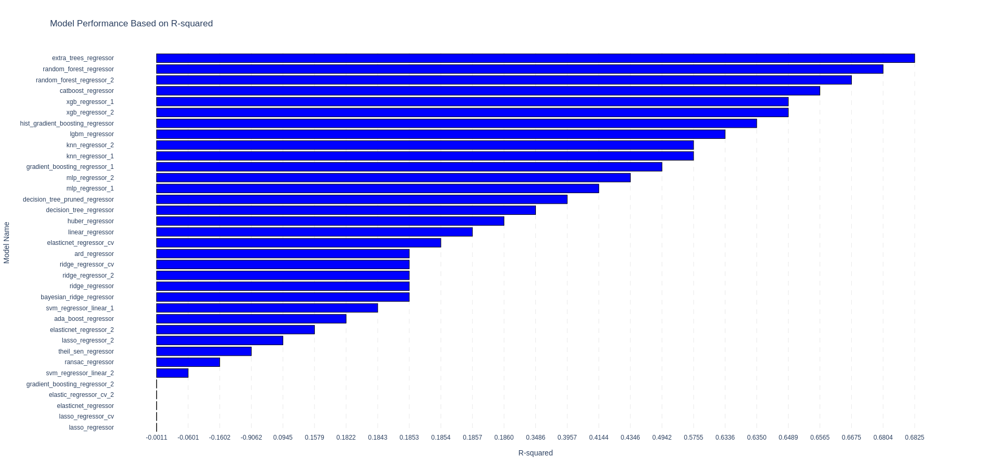



ALL ACTIONS COMPLETE!!!


CPU times: user 5min 59s, sys: 4.87 s, total: 6min 4s
Wall time: 9min 6s


In [86]:
%%time

#################################################################################
# set X
#################################################################################
df_X_to_standardize = df_cleaned_features_IQR

#################################################################################
# Create holdout set and standardize data
#################################################################################
# create hold out set and standardize the data
print('\ncreating hold-out set and standardizing dataset...')
X_train_scaled, X_test_scaled, y_train, y_test = standardize_dataset(df_X_to_standardize, y_cleaned, 0.20, 42, dict_standard_scalers, 'iqr')

#################################################################################
# Visualize the new data
#################################################################################
print('\nDone! Visualizing dataset before and after standardization and outlier transformation...')
try:
    fig, axes = plt.subplots(1, 2, figsize=(12, 5))
    
    # Before scaling
    X_train.plot(kind='kde', ax=axes[0], title="Before Scaling")
    
    # After scaling
    X_train_scaled.plot(kind='kde', ax=axes[1], title="After Scaling")
    
    plt.tight_layout()
    plt.show()
    
    
except:
    pass

#################################################################################
# train the models!
#################################################################################
print('\nDone! Initiating data modeling!')
df_model_evaluation_metrics_iqr, dict_completed_models_iqr, lst_error_model_iqr = instantiate_and_model_data(X_train_scaled, X_test_scaled, y_train, y_test)

#################################################################################
# View Model Performance
#################################################################################
print('\nDone! Sorting and saving data...')
# sort models by r2
df_model_evaluation_metrics_iqr = df_model_evaluation_metrics_iqr.sort_values(by='r2', ascending=False, inplace=False)
df_model_evaluation_metrics_iqr = df_model_evaluation_metrics_iqr.reset_index(drop=True, inplace=False)


#save df
df_model_evaluation_metrics_iqr.to_csv('./model_performance_after_outlier_transformation_iqr.csv', index=False)

# view df
#df_model_evaluation_metrics_iqr.style.format(precision=3, thousands=",", decimal=".").format_index(str.upper, axis=1)
#df_model_evaluation_metrics_iqr.style.format(precision=3, thousands=",", decimal=".").format_index(str.lower, axis=1)
styled_df = df_model_evaluation_metrics_iqr.style.format(precision=3, thousands=",", decimal=".").format_index(str.lower, axis=1)
display(HTML(styled_df.to_html()))


#################################################################################
# Sort model data for charting
#################################################################################
print('\nDone! Plotting performance metrics...')
# plot in ascending order
df_model_evaluation_metrics_sorted_iqr = df_model_evaluation_metrics_iqr.sort_values(by='r2', ascending=True, inplace=False)
df_model_evaluation_metrics_sorted_iqr = df_model_evaluation_metrics_sorted_iqr.reset_index(drop=True, inplace=False)

# soft dict of models for displaying feature importance below
dict_completed_models_sorted_iqr = dict()

lst_sorted_models_iqr = list(df_model_evaluation_metrics_sorted_iqr['model_name'])[::-1]


#################################################################################
# Plot Model Performance
#################################################################################
fig = go.Figure()

fig.add_trace(go.Bar(
    y=df_model_evaluation_metrics_sorted_iqr['model_name'],  
    x=df_model_evaluation_metrics_sorted_iqr['r2'],  
    orientation='h',  # Horizontal bar chart
    marker=dict(color='blue', line=dict(color='black', width=1)),  
))

# Update layout with dashed vertical gridlines
fig.update_layout(
    title="Model Performance Based on R-squared",
    xaxis_title="R-squared",
    yaxis_title="Model Name",
    xaxis=dict(
        showgrid=True, 
        zeroline=True,
        gridcolor='lightgray',  
        gridwidth=0.5,      
        griddash='dash'      
    ),
    yaxis=dict(tickmode='linear'),
    height=900, width=1300,  
    plot_bgcolor="white",  
    paper_bgcolor="white"   
)

# Show plot
fig.show()



#################################################################################
# notify
#################################################################################
print('\n\nALL ACTIONS COMPLETE!!!\n\n')


<hr style="height:30px;color:#000;background-color:#000;">

# <b> Z-Score Method </b>

While calculating the Z-score we re-scale and center the data and look for data points which are too far from zero. Z-score is used to convert the data into another dataset with mean = 0.

Z-score describes the position of a raw score in terms of its distance from the mean, when measured in standard deviation units.

This technique assumes a Gaussian distribution of the data. The outliers are the data points that are in the tails of the distribution.

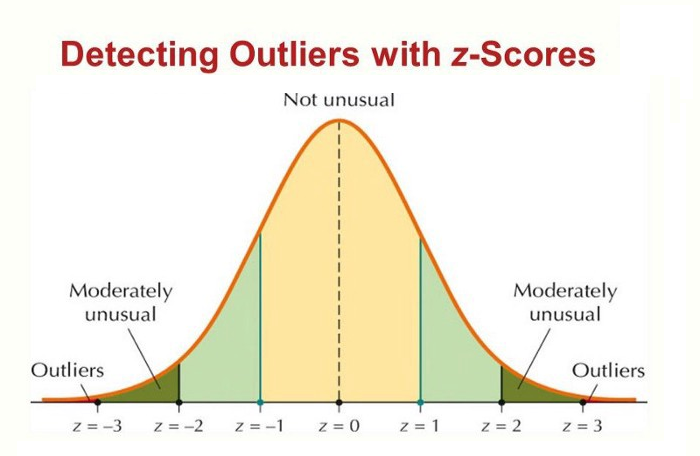

source: "Outlier detection methods!", Marcin Rutecki, https://www.kaggle.com/code/marcinrutecki/outlier-detection-methods, Retrieved: 2025-02-07

In [87]:
def detect_and_remove_outliers_zscore(df_to_analyze, lst_features, threshold=3):  # Added threshold parameter
    """
    Detects and removes outliers from specified columns in a DataFrame using the Z-score method.

    Args:
        df_to_analyze (pd.DataFrame): The input DataFrame.
        lst_features (list): A list of column names to analyze for outliers.
        threshold (float): The Z-score threshold beyond which a data point is considered an outlier. Default is 3.

    Returns:
        pd.DataFrame: The DataFrame with outliers removed from all specified columns.
        dict: A dictionary where keys are column names and values are lists of outlier indices for each column.
        int: The total number of outlier instances removed.
    """

    all_outlier_indices = {feature: [] for feature in lst_features}
    df_cleaned = df_to_analyze.copy()
    count_total_outliers_removed = 0

    for feature_name in lst_features:
        try:
            df_cleaned[feature_name] = pd.to_numeric(df_cleaned[feature_name], errors='coerce')
            df_cleaned.dropna(subset=[feature_name], inplace=True)

            data = df_cleaned[feature_name].values

            if len(data) < 3:  # Need at least 3 data points for Z-score calculation
                continue

            z_scores = np.abs(zscore(data))  # Calculate absolute Z-scores

            outlier_mask = z_scores > threshold  # Identify outliers based on threshold
            all_outlier_indices[feature_name] = df_cleaned.index[outlier_mask].tolist()

            count_outliers_removed_within_this_feature = len(all_outlier_indices[feature_name])
            print(f'Count outliers to remove from feature: [{feature_name}] --> {count_outliers_removed_within_this_feature}')

        except (TypeError, ValueError) as e:  # Handle potential errors with non-numeric data
            print(f"Error processing column '{feature_name}': {e}")
            continue

    rows_to_remove = []
    for indices in all_outlier_indices.values():
        rows_to_remove.extend(indices)

    rows_to_remove = sorted(list(set(rows_to_remove)))  # Remove duplicates and sort

    count_total_outliers_removed = len(rows_to_remove)

    df_cleaned = df_to_analyze.drop(rows_to_remove, errors='ignore')

    return df_cleaned, all_outlier_indices, count_total_outliers_removed

# NOTE: AI Assisted Code from Gemini

# Call ZScore Outlier function

In [88]:
df_cleaned, outlier_indices_dict, count_total_outliers_removed = detect_and_remove_outliers_zscore(df, lst_features, threshold=3)  # You can adjust the threshold
y_cleaned = df_cleaned[DEPENDENT_VAR_NAME]

print(f'\ntotal number of outlier instances removed: --> {count_total_outliers_removed}')

df_cleaned_features_zscore = df_cleaned[lst_features]

Count outliers to remove from feature: [total_volume] --> 171
Count outliers to remove from feature: [4046] --> 181
Count outliers to remove from feature: [4225] --> 180
Count outliers to remove from feature: [4770] --> 259
Count outliers to remove from feature: [total_bags] --> 187
Count outliers to remove from feature: [small_bags] --> 179
Count outliers to remove from feature: [large_bags] --> 251
Count outliers to remove from feature: [xlarge-bags] --> 234

total number of outlier instances removed: --> 467


# Visualize updated df

In [89]:
df_cleaned_features_zscore

,total_volume,4046,4225,4770,total_bags,small_bags,large_bags,xlarge-bags
0,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0
1,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0
2,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0
3,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0
4,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0
...,...,...,...,...,...,...,...,...
18244,17074.83,2046.96,1529.20,0.00,13498.67,13066.82,431.85,0.0
18245,13888.04,1191.70,3431.50,0.00,9264.84,8940.04,324.80,0.0
18246,13766.76,1191.92,2452.79,727.94,9394.11,9351.80,42.31,0.0
18247,16205.22,1527.63,2981.04,727.01,10969.54,10919.54,50.00,0.0


ORIGINAL    sum_shape_metric: 977.3584239619304 
TRANSFORMED sum_shape_metric: 219.25749368112037


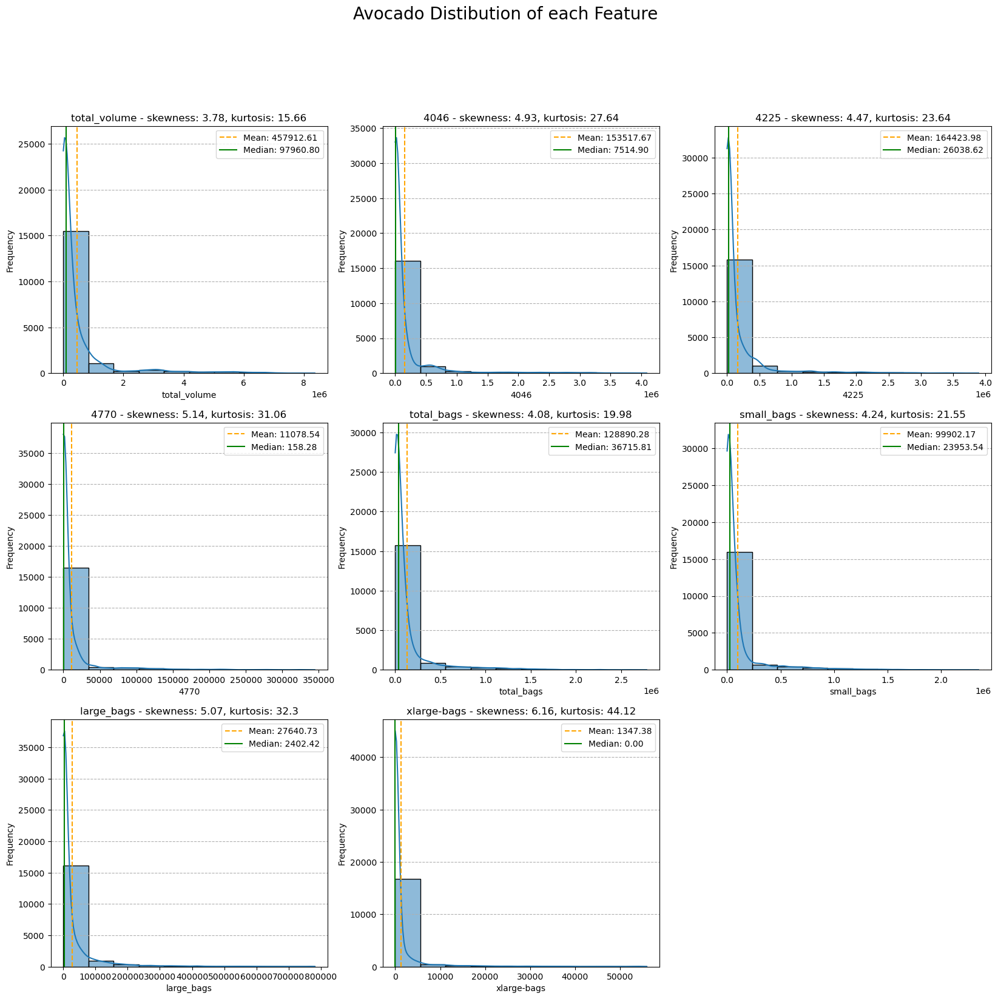

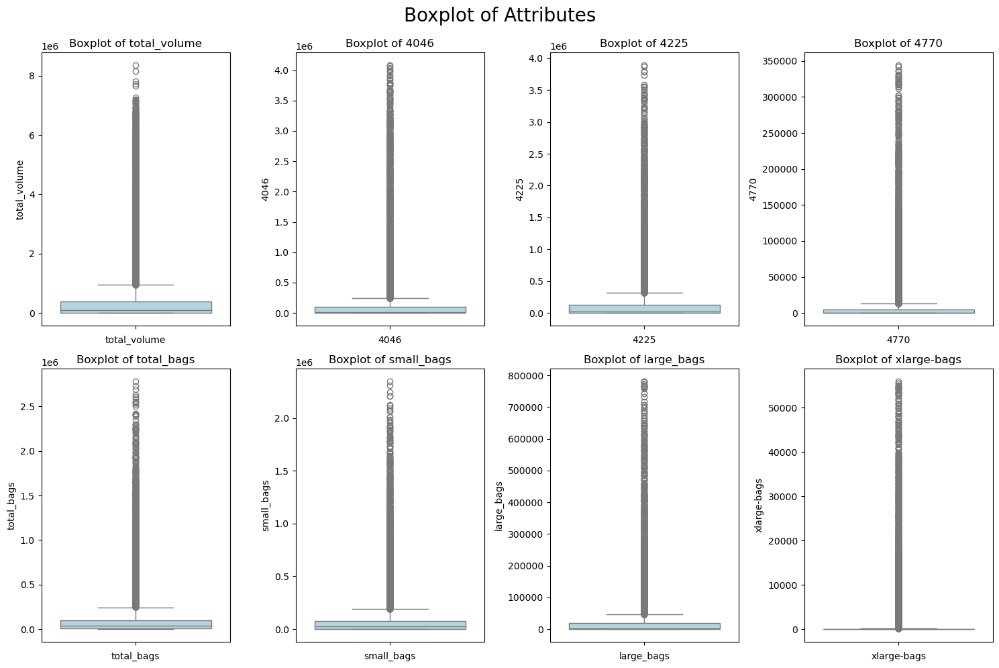

In [90]:
###############################################
# print original skewness and kurtosis
###############################################
SKEWNESS = skew(df_X_features)
KURTOSIS = kurtosis(df_X_features)
shape_metric = list(np.sqrt(np.power(SKEWNESS, 2) + np.power(KURTOSIS, 2)))
sum_shape_metric = np.sum(shape_metric)

#print(f'ORIGINAL    sum_shape_metric: {sum_shape_metric} \t shape_metric: {shape_metric}')
print(f'ORIGINAL    sum_shape_metric: {sum_shape_metric} ')

###############################################
# print transformed skewness and kurtosis
###############################################
SKEWNESS_TRANSFORMED = skew(df_cleaned_features_zscore)
KURTOSIS_TRANSFORMED = kurtosis(df_cleaned_features_zscore)
shape_metric_TRANSFORMED = list(np.sqrt(np.power(SKEWNESS_TRANSFORMED, 2) + np.power(KURTOSIS_TRANSFORMED, 2)))
sum_shape_metric_TRANSFORMED = np.sum(shape_metric_TRANSFORMED)

#print(f'TRANSFORMED sum_shape_metric: {sum_shape_metric_TRANSFORMED} \t shape_metric: {shape_metric_TRANSFORMED}')
print(f'TRANSFORMED sum_shape_metric: {sum_shape_metric_TRANSFORMED}')

################################################
# call fcn - sns kde histplot
################################################
df_to_analyze = df_cleaned_features_zscore
plot_kde_histplot(df_to_analyze, False, 3, 'Avocado Distibution of each Feature')

################################################
# call fcn - sns boxplot
################################################
#df_to_analyze = df.select_dtypes(include=[np.number])
df_to_analyze = df_cleaned_features_zscore
plot_boxplot(df_to_analyze, "Boxplot of Attributes", False)

<hr style="height:10px;color:#000;background-color:#F0F;">

# <span style="color: blue;"> <b><u> Create Holdout, Standardize Dataframe, Model Data, Evaluate Performance </b></u></span>  


creating hold-out set and standardizing dataset...
X_train: (14225, 8)
y_train: 14225

X_test: (3557, 8)
y_test: 3557

Done! Visualizing dataset before and after standardization and outlier transformation...


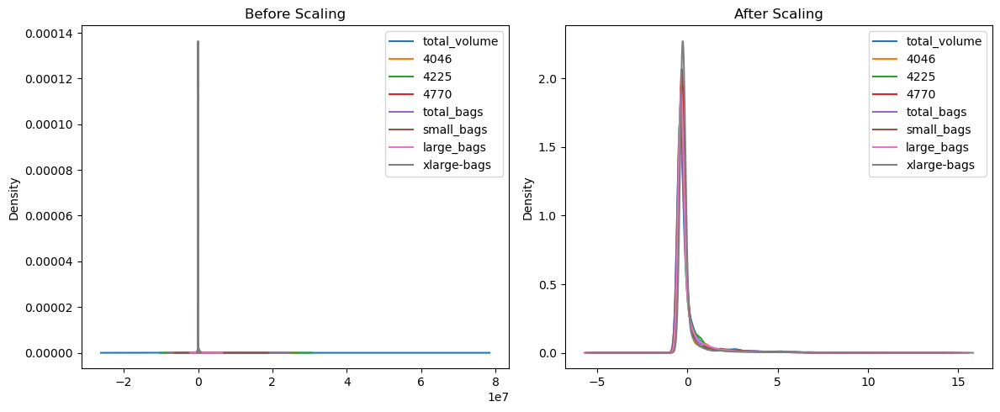


Done! Initiating data modeling!
instantiating models...
model instantiation complete!


Processing Model:   0%|                                                   | 0/35 [00:00<?, ?model/s]



######################################################################
# training model --> ada_boost_regressor
######################################################################
hyperparameters --> {'estimator': None, 'learning_rate': 1.0, 'loss': 'linear', 'n_estimators': 50, 'random_state': 42}



Processing Model:   3%|█▏                                         | 1/35 [00:14<08:22, 14.77s/model]

training model ada_boost_regressor complete! 	R2: 0.3267	analysis_duration --> 0:00:14.767303



######################################################################
# training model --> ard_regressor
######################################################################
hyperparameters --> {'alpha_1': 1e-06, 'alpha_2': 1e-06, 'compute_score': False, 'copy_X': True, 'fit_intercept': True, 'lambda_1': 1e-06, 'lambda_2': 1e-06, 'max_iter': 300, 'threshold_lambda': 10000.0, 'tol': 0.001, 'verbose': False}



Processing Model:   6%|██▍                                        | 2/35 [00:14<03:24,  6.21s/model]

training model ard_regressor complete! 	R2: 0.1236	analysis_duration --> 0:00:00.206992



######################################################################
# training model --> bayesian_ridge_regressor
######################################################################
hyperparameters --> {'alpha_1': 1e-06, 'alpha_2': 1e-06, 'alpha_init': None, 'compute_score': False, 'copy_X': True, 'fit_intercept': True, 'lambda_1': 1e-06, 'lambda_2': 1e-06, 'lambda_init': None, 'max_iter': 300, 'tol': 0.001, 'verbose': False}



Processing Model:   9%|███▋                                       | 3/35 [00:15<01:55,  3.62s/model]

training model bayesian_ridge_regressor complete! 	R2: 0.1242	analysis_duration --> 0:00:00.537284



######################################################################
# training model --> decision_tree_regressor
######################################################################
hyperparameters --> {'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'random_state': 42, 'splitter': 'best'}



Processing Model:  11%|████▉                                      | 4/35 [00:18<01:38,  3.18s/model]

training model decision_tree_regressor complete! 	R2: 0.4894	analysis_duration --> 0:00:02.475351



######################################################################
# training model --> decision_tree_pruned_regressor
######################################################################
hyperparameters --> {'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': 5, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'random_state': 42, 'splitter': 'best'}



Processing Model:  14%|██████▏                                    | 5/35 [00:18<01:10,  2.36s/model]

training model decision_tree_pruned_regressor complete! 	R2: 0.4832	analysis_duration --> 0:00:00.897245



######################################################################
# training model --> elasticnet_regressor
######################################################################
hyperparameters --> {'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}



Processing Model:  20%|████████▌                                  | 7/35 [00:19<00:33,  1.19s/model]

training model elasticnet_regressor complete! 	R2: -0.0019	analysis_duration --> 0:00:00.315093



######################################################################
# training model --> elasticnet_regressor_2
######################################################################
hyperparameters --> {'alpha': 0.1, 'copy_X': True, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}

training model elasticnet_regressor_2 complete! 	R2: 0.0982	analysis_duration --> 0:00:00.169178



######################################################################
# training model --> elasticnet_regressor_cv
######################################################################
hyperparameters --> {'alphas': None, 'copy_X': True, 'cv': None, 'eps': 0.001, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'n_alphas': 100, 'n_jobs': None, 'positive': False, 'precomput

Processing Model:  23%|█████████▊                                 | 8/35 [00:23<00:54,  2.03s/model]

training model elasticnet_regressor_cv complete! 	R2: 0.1241	analysis_duration --> 0:00:03.837246



######################################################################
# training model --> elastic_regressor_cv_2
######################################################################
hyperparameters --> {'alphas': [0.5], 'copy_X': True, 'cv': 11, 'eps': 0.001, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'n_alphas': 100, 'n_jobs': -1, 'positive': False, 'precompute': 'auto', 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'verbose': 0}



Processing Model:  26%|███████████                                | 9/35 [00:23<00:41,  1.61s/model]

training model elastic_regressor_cv_2 complete! 	R2: -0.0019	analysis_duration --> 0:00:00.672039



######################################################################
# training model --> extra_trees_regressor
######################################################################
hyperparameters --> {'bootstrap': False, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}



Processing Model:  29%|████████████                              | 10/35 [01:24<08:17, 19.90s/model]

training model extra_trees_regressor complete! 	R2: 0.7732	analysis_duration --> 0:01:00.843443



######################################################################
# training model --> gradient_boosting_regressor_1
######################################################################
hyperparameters --> {'alpha': 0.9, 'ccp_alpha': 0.0, 'criterion': 'friedman_mse', 'init': None, 'learning_rate': 0.1, 'loss': 'squared_error', 'max_depth': 3, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 100, 'n_iter_no_change': None, 'random_state': 42, 'subsample': 1.0, 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': False, 'warm_start': False}



Processing Model:  31%|█████████████▏                            | 11/35 [02:07<10:47, 27.00s/model]

training model gradient_boosting_regressor_1 complete! 	R2: 0.5784	analysis_duration --> 0:00:43.085310



######################################################################
# training model --> gradient_boosting_regressor_2
######################################################################
hyperparameters --> {'alpha': 0.9, 'ccp_alpha': 0.0, 'criterion': 'friedman_mse', 'init': None, 'learning_rate': 0.01, 'loss': 'squared_error', 'max_depth': 2, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.5, 'n_estimators': 300, 'n_iter_no_change': None, 'random_state': 42, 'subsample': 1.0, 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False}



Processing Model:  34%|██████████████▍                           | 12/35 [03:10<14:28, 37.77s/model]

training model gradient_boosting_regressor_2 complete! 	R2: -0.0019	analysis_duration --> 0:01:02.399685



######################################################################
# training model --> hist_gradient_boosting_regressor
######################################################################
hyperparameters --> {'categorical_features': 'warn', 'early_stopping': 'auto', 'interaction_cst': None, 'l2_regularization': 0.0, 'learning_rate': 0.1, 'loss': 'squared_error', 'max_bins': 255, 'max_depth': None, 'max_features': 1.0, 'max_iter': 100, 'max_leaf_nodes': 31, 'min_samples_leaf': 20, 'monotonic_cst': None, 'n_iter_no_change': 10, 'quantile': None, 'random_state': 42, 'scoring': 'loss', 'tol': 1e-07, 'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False}



Processing Model:  37%|███████████████▌                          | 13/35 [03:16<10:17, 28.08s/model]

training model hist_gradient_boosting_regressor complete! 	R2: 0.6945	analysis_duration --> 0:00:05.758350



######################################################################
# training model --> huber_regressor
######################################################################
hyperparameters --> {'alpha': 0.0001, 'epsilon': 1.35, 'fit_intercept': True, 'max_iter': 100, 'tol': 1e-05, 'warm_start': False}



Processing Model:  40%|████████████████▊                         | 14/35 [03:16<06:56, 19.81s/model]

training model huber_regressor complete! 	R2: 0.1251	analysis_duration --> 0:00:00.707036



######################################################################
# training model --> knn_regressor_1
######################################################################
hyperparameters --> {'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': None, 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}



Processing Model:  43%|██████████████████                        | 15/35 [03:18<04:45, 14.29s/model]

training model knn_regressor_1 complete! 	R2: 0.6638	analysis_duration --> 0:00:01.466490



######################################################################
# training model --> knn_regressor_2
######################################################################
hyperparameters --> {'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': None, 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}



Processing Model:  46%|███████████████████▏                      | 16/35 [03:19<03:19, 10.49s/model]

training model knn_regressor_2 complete! 	R2: 0.6638	analysis_duration --> 0:00:01.660658



######################################################################
# training model --> linear_regressor
######################################################################
hyperparameters --> {'copy_X': True, 'fit_intercept': True, 'n_jobs': None, 'positive': False}



Processing Model:  49%|████████████████████▍                     | 17/35 [03:20<02:14,  7.48s/model]

training model linear_regressor complete! 	R2: 0.1248	analysis_duration --> 0:00:00.462134



######################################################################
# training model --> lasso_regressor
######################################################################
hyperparameters --> {'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}



Processing Model:  51%|█████████████████████▌                    | 18/35 [03:20<01:30,  5.33s/model]

training model lasso_regressor complete! 	R2: -0.0019	analysis_duration --> 0:00:00.292210



######################################################################
# training model --> lasso_regressor_cv
######################################################################
hyperparameters --> {'alphas': [1], 'copy_X': True, 'cv': 11, 'eps': 0.001, 'fit_intercept': True, 'max_iter': 1000, 'n_alphas': 100, 'n_jobs': -1, 'positive': False, 'precompute': 'auto', 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'verbose': False}



Processing Model:  54%|██████████████████████▊                   | 19/35 [03:21<01:04,  4.03s/model]

training model lasso_regressor_cv complete! 	R2: -0.0019	analysis_duration --> 0:00:00.988236



######################################################################
# training model --> lasso_regressor_2
######################################################################
hyperparameters --> {'alpha': 0.1, 'copy_X': True, 'fit_intercept': True, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}

training model lasso_regressor_2 complete! 	R2: 0.0482	analysis_duration --> 0:00:00.188611



Processing Model:  57%|████████████████████████                  | 20/35 [03:21<00:43,  2.88s/model]



######################################################################
# training model --> lgbm_regressor
######################################################################
hyperparameters --> {'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'split', 'learning_rate': 0.1, 'max_depth': -1, 'min_child_samples': 20, 'min_child_weight': 0.001, 'min_split_gain': 0.0, 'n_estimators': 100, 'n_jobs': None, 'num_leaves': 31, 'objective': None, 'random_state': 42, 'reg_alpha': 0.0, 'reg_lambda': 0.0, 'subsample': 1.0, 'subsample_for_bin': 200000, 'subsample_freq': 0}

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.024066 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 14225, number of used features: 8
[LightGBM] [Info] Start training from score 1.418963
[LightGBM] [Info] Auto-choosing col-wise mul

Processing Model:  60%|█████████████████████████▏                | 21/35 [03:24<00:39,  2.80s/model]

training model lgbm_regressor complete! 	R2: 0.6989	analysis_duration --> 0:00:02.603814



######################################################################
# training model --> mlp_regressor_1
######################################################################
hyperparameters --> {'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'early_stopping': False, 'epsilon': 1e-08, 'hidden_layer_sizes': (100,), 'learning_rate': 'constant', 'learning_rate_init': 0.001, 'max_fun': 15000, 'max_iter': 100, 'momentum': 0.9, 'n_iter_no_change': 10, 'nesterovs_momentum': True, 'power_t': 0.5, 'random_state': 42, 'shuffle': True, 'solver': 'adam', 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': False, 'warm_start': False}



Processing Model:  63%|██████████████████████████▍               | 22/35 [04:23<04:16, 19.74s/model]

training model mlp_regressor_1 complete! 	R2: 0.4720	analysis_duration --> 0:00:59.210894



######################################################################
# training model --> ransac_regressor
######################################################################
hyperparameters --> {'estimator': None, 'is_data_valid': None, 'is_model_valid': None, 'loss': 'absolute_error', 'max_skips': inf, 'max_trials': 100, 'min_samples': None, 'random_state': 42, 'residual_threshold': None, 'stop_n_inliers': inf, 'stop_probability': 0.99, 'stop_score': inf}



Processing Model:  66%|███████████████████████████▌              | 23/35 [04:25<02:52, 14.41s/model]

training model ransac_regressor complete! 	R2: -2.4463	analysis_duration --> 0:00:01.976502



######################################################################
# training model --> ridge_regressor
######################################################################
hyperparameters --> {'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'max_iter': None, 'positive': False, 'random_state': 42, 'solver': 'auto', 'tol': 0.0001}



Processing Model:  69%|████████████████████████████▊             | 24/35 [04:26<01:52, 10.19s/model]

training model ridge_regressor complete! 	R2: 0.1243	analysis_duration --> 0:00:00.336141



######################################################################
# training model --> ridge_regressor_cv
######################################################################
hyperparameters --> {'alpha_per_target': False, 'alphas': [2], 'cv': 11, 'fit_intercept': True, 'gcv_mode': None, 'scoring': None, 'store_cv_results': None, 'store_cv_values': 'deprecated'}



Processing Model:  74%|███████████████████████████████▏          | 26/35 [04:27<00:46,  5.21s/model]

training model ridge_regressor_cv complete! 	R2: 0.1243	analysis_duration --> 0:00:00.847924



######################################################################
# training model --> ridge_regressor_2
######################################################################
hyperparameters --> {'alpha': 1, 'copy_X': True, 'fit_intercept': True, 'max_iter': None, 'positive': False, 'random_state': 42, 'solver': 'cholesky', 'tol': 0.0001}

training model ridge_regressor_2 complete! 	R2: 0.1243	analysis_duration --> 0:00:00.111903



######################################################################
# training model --> svm_regressor_linear_1
######################################################################
hyperparameters --> {'C': 1.0, 'dual': 'auto', 'epsilon': 0.0, 'fit_intercept': True, 'intercept_scaling': 1.0, 'loss': 'epsilon_insensitive', 'max_iter': 1000, 'random_state': None, 'tol': 0.0001, 'verbose': 0}



Processing Model:  80%|█████████████████████████████████▌        | 28/35 [04:33<00:27,  3.95s/model]

training model svm_regressor_linear_1 complete! 	R2: 0.1176	analysis_duration --> 0:00:06.372905



######################################################################
# training model --> svm_regressor_linear_2
######################################################################
hyperparameters --> {'C': 1.0, 'dual': 'auto', 'epsilon': 1.5, 'fit_intercept': True, 'intercept_scaling': 1.0, 'loss': 'epsilon_insensitive', 'max_iter': 1000, 'random_state': None, 'tol': 0.0001, 'verbose': 0}

training model svm_regressor_linear_2 complete! 	R2: -0.2002	analysis_duration --> 0:00:00.183159



######################################################################
# training model --> theil_sen_regressor
######################################################################
hyperparameters --> {'copy_X': True, 'fit_intercept': True, 'max_iter': 500, 'max_subpopulation': 10000, 'n_jobs': -1, 'n_subsamples': None, 'random_state': None, 'tol': 0.001, 'verbose': False}



Processing Model:  83%|██████████████████████████████████▊       | 29/35 [05:31<02:00, 20.15s/model]

training model theil_sen_regressor complete! 	R2: -5.1155	analysis_duration --> 0:00:57.934997



######################################################################
# training model --> xgb_regressor_1
######################################################################
hyperparameters --> {'objective': 'reg:squarederror', 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': None, 'device': None, 'early_stopping_rounds': None, 'enable_categorical': False, 'eval_metric': None, 'feature_types': None, 'gamma': None, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': None, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': None, 'max_leaves': None, 'min_child_weight': None, 'missing': nan, 'monotone_constraints': None, 'multi_strategy': None, 'n_estimators': None, 'n_jobs': None, 'num_parallel_tree': None, 'r

Processing Model:  86%|████████████████████████████████████      | 30/35 [05:34<01:14, 14.92s/model]

training model xgb_regressor_1 complete! 	R2: 0.7296	analysis_duration --> 0:00:02.722361



######################################################################
# training model --> xgb_regressor_2
######################################################################
hyperparameters --> {'objective': 'reg:squarederror', 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': None, 'device': None, 'early_stopping_rounds': None, 'enable_categorical': False, 'eval_metric': 'logloss', 'feature_types': None, 'gamma': None, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': None, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': None, 'max_leaves': None, 'min_child_weight': None, 'missing': nan, 'monotone_constraints': None, 'multi_strategy': None, 'n_estimators': None, 'n_jobs': None, 'num_parallel_tree': None, 'r

Processing Model:  89%|█████████████████████████████████████▏    | 31/35 [05:37<00:45, 11.39s/model]

training model xgb_regressor_2 complete! 	R2: 0.7296	analysis_duration --> 0:00:03.138823



######################################################################
# training model --> random_forest_regressor
######################################################################
hyperparameters --> {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': -1, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}



Processing Model:  91%|██████████████████████████████████████▍   | 32/35 [07:37<02:11, 43.96s/model]

training model random_forest_regressor complete! 	R2: 0.7641	analysis_duration --> 0:01:59.930896



######################################################################
# training model --> random_forest_regressor_2
######################################################################
hyperparameters --> {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 5, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}



Processing Model:  94%|███████████████████████████████████████▌  | 33/35 [09:00<01:51, 55.70s/model]

training model random_forest_regressor_2 complete! 	R2: 0.7503	analysis_duration --> 0:01:23.106899



######################################################################
# training model --> mlp_regressor_2
######################################################################
hyperparameters --> {'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'early_stopping': False, 'epsilon': 1e-08, 'hidden_layer_sizes': (200,), 'learning_rate': 'constant', 'learning_rate_init': 0.001, 'max_fun': 15000, 'max_iter': 400, 'momentum': 0.9, 'n_iter_no_change': 10, 'nesterovs_momentum': True, 'power_t': 0.5, 'random_state': 42, 'shuffle': True, 'solver': 'adam', 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': False, 'warm_start': False}



Processing Model:  97%|████████████████████████████████████████▊ | 34/35 [10:05<00:58, 58.59s/model]

training model mlp_regressor_2 complete! 	R2: 0.4890	analysis_duration --> 0:01:05.315619



######################################################################
# training model --> catboost_regressor
######################################################################
hyperparameters --> {'loss_function': 'RMSE', 'verbose': 0, 'random_state': 42}



Processing Model: 100%|██████████████████████████████████████████| 35/35 [11:06<00:00, 19.05s/model]

training model catboost_regressor complete! 	R2: 0.7300	analysis_duration --> 0:01:00.830499




******************************************************************************************
* model training COMPLETE!
******************************************************************************************

Done! Sorting and saving data...


,model_name,r2,adjusted_r2,cross_validated_r2,explained_variance_score,rmse,rmsle,mae,mape,mse,msle,mase,smape,med_ae,huber_loss,mbd,cv_rmse,r2_residuals,durbin_watson_stat,start_time,end_time,analysis_duration_text,analysis_duration
0,extra_trees_regressor,0.7732,0.7727,0.7618,0.7735,0.1878,0.0751,0.1306,0.0969,0.0353,0.0056,0.2956,0.0933,0.0882,0.296,0.0065,0.1340,-12.4620,2.0112,2025-02-24-0739,2025-02-24-0740,"0 day(s), 0 hour(s), 1 minute(s), 0 second(s)",0:01:00.843443
1,random_forest_regressor,0.7641,0.7636,0.7536,0.7643,0.1915,0.0765,0.1349,0.1002,0.0367,0.0059,0.3053,0.0966,0.0944,0.296,0.0055,0.1366,-12.4319,1.9909,2025-02-24-0745,2025-02-24-0747,"0 day(s), 0 hour(s), 1 minute(s), 59 second(s)",0:01:59.930896
2,random_forest_regressor_2,0.7503,0.7498,0.7400,0.7504,0.1971,0.0789,0.1408,0.1049,0.0388,0.0062,0.3186,0.1010,0.1001,0.296,0.0039,0.1406,-12.3764,1.9870,2025-02-24-0747,2025-02-24-0748,"0 day(s), 0 hour(s), 1 minute(s), 23 second(s)",0:01:23.106899
3,catboost_regressor,0.7300,0.7293,0.7278,0.7300,0.2049,0.0823,0.1500,0.1117,0.0420,0.0068,0.3395,0.1079,0.1107,0.296,0.0032,0.1462,-12.3789,1.9847,2025-02-24-0749,2025-02-24-0750,"0 day(s), 0 hour(s), 1 minute(s), 0 second(s)",0:01:00.830499
4,xgb_regressor_2,0.7296,0.7290,0.7188,0.7296,0.2051,0.0823,0.1484,0.1098,0.0421,0.0068,0.3359,0.1066,0.1071,0.296,-0.0010,0.1463,-12.3410,1.9808,2025-02-24-0745,2025-02-24-0745,"0 day(s), 0 hour(s), 0 minute(s), 3 second(s)",0:00:03.138823
5,xgb_regressor_1,0.7296,0.7290,0.7188,0.7296,0.2051,0.0823,0.1484,0.1098,0.0421,0.0068,0.3359,0.1066,0.1071,0.296,-0.0010,0.1463,-12.3410,1.9808,2025-02-24-0745,2025-02-24-0745,"0 day(s), 0 hour(s), 0 minute(s), 2 second(s)",0:00:02.722361
6,lgbm_regressor,0.6989,0.6982,0.6957,0.6990,0.2164,0.0875,0.1610,0.1209,0.0468,0.0076,0.3643,0.1164,0.1244,0.296,0.0025,0.1544,-12.3047,1.9968,2025-02-24-0742,2025-02-24-0742,"0 day(s), 0 hour(s), 0 minute(s), 2 second(s)",0:00:02.603814
7,hist_gradient_boosting_regressor,0.6945,0.6938,0.6936,0.6946,0.2180,0.0880,0.1622,0.1216,0.0475,0.0077,0.3672,0.1170,0.1247,0.296,0.0036,0.1555,-12.3231,1.9951,2025-02-24-0742,2025-02-24-0742,"0 day(s), 0 hour(s), 0 minute(s), 5 second(s)",0:00:05.758350
8,knn_regressor_2,0.6638,0.6631,0.6533,0.6646,0.2287,0.0926,0.1612,0.1212,0.0523,0.0086,0.3648,0.1149,0.1080,0.296,0.0112,0.1631,-12.5589,2.0104,2025-02-24-0742,2025-02-24-0742,"0 day(s), 0 hour(s), 0 minute(s), 1 second(s)",0:00:01.660658
9,knn_regressor_1,0.6638,0.6631,0.6533,0.6646,0.2287,0.0926,0.1612,0.1212,0.0523,0.0086,0.3648,0.1149,0.1080,0.296,0.0112,0.1631,-12.5589,2.0104,2025-02-24-0742,2025-02-24-0742,"0 day(s), 0 hour(s), 0 minute(s), 1 second(s)",0:00:01.466490



Done! Plotting performance metrics...




ALL ACTIONS COMPLETE!!!


CPU times: user 8min 50s, sys: 7.46 s, total: 8min 58s
Wall time: 11min 18s


In [91]:
%%time

#################################################################################
# set X
#################################################################################
df_X_to_standardize = df_cleaned_features_zscore

#################################################################################
# Create holdout set and standardize data
#################################################################################
# create hold out set and standardize the data
print('\ncreating hold-out set and standardizing dataset...')
X_train_scaled, X_test_scaled, y_train, y_test = standardize_dataset(df_X_to_standardize, y_cleaned, 0.20, 42, dict_standard_scalers, 'zscore')

#################################################################################
# Visualize the new data
#################################################################################
print('\nDone! Visualizing dataset before and after standardization and outlier transformation...')
try:
    fig, axes = plt.subplots(1, 2, figsize=(12, 5))
    
    # Before scaling
    X_train.plot(kind='kde', ax=axes[0], title="Before Scaling")
    
    # After scaling
    X_train_scaled.plot(kind='kde', ax=axes[1], title="After Scaling")
    
    plt.tight_layout()
    plt.show()
    
    
except:
    pass

#################################################################################
# train the models!
#################################################################################
print('\nDone! Initiating data modeling!')
df_model_evaluation_metrics_zscore, dict_completed_models_zscore, lst_error_model_zscore = instantiate_and_model_data(X_train_scaled, X_test_scaled, y_train, y_test)

#################################################################################
# View Model Performance
#################################################################################
print('\nDone! Sorting and saving data...')
# sort models by r2
df_model_evaluation_metrics_zscore = df_model_evaluation_metrics_zscore.sort_values(by='r2', ascending=False, inplace=False)
df_model_evaluation_metrics_zscore = df_model_evaluation_metrics_zscore.reset_index(drop=True, inplace=False)


#save df
df_model_evaluation_metrics_zscore.to_csv('./model_performance_after_outlier_transformation_zscore.csv', index=False)

# view df
#df_model_evaluation_metrics_zscore.style.format(precision=3, thousands=",", decimal=".").format_index(str.upper, axis=1)
#df_model_evaluation_metrics_zscore.style.format(precision=3, thousands=",", decimal=".").format_index(str.lower, axis=1)
styled_df = df_model_evaluation_metrics_zscore.style.format(precision=3, thousands=",", decimal=".").format_index(str.lower, axis=1)
display(HTML(styled_df.to_html()))


#################################################################################
# Sort model data for charting
#################################################################################
print('\nDone! Plotting performance metrics...')
# plot in ascending order
df_model_evaluation_metrics_sorted_zscore = df_model_evaluation_metrics_zscore.sort_values(by='r2', ascending=True, inplace=False)
df_model_evaluation_metrics_sorted_zscore = df_model_evaluation_metrics_sorted_zscore.reset_index(drop=True, inplace=False)

# soft dict of models for displaying feature importance below
dict_completed_models_sorted_zscore = dict()

lst_sorted_models_zscore = list(df_model_evaluation_metrics_sorted_zscore['model_name'])[::-1]


#################################################################################
# Plot Model Performance
#################################################################################
fig = go.Figure()

fig.add_trace(go.Bar(
    y=df_model_evaluation_metrics_sorted_zscore['model_name'],  
    x=df_model_evaluation_metrics_sorted_zscore['r2'],  
    orientation='h',  # Horizontal bar chart
    marker=dict(color='blue', line=dict(color='black', width=1)),  
))

# Update layout with dashed vertical gridlines
fig.update_layout(
    title="Model Performance Based on R-squared",
    xaxis_title="R-squared",
    yaxis_title="Model Name",
    xaxis=dict(
        showgrid=True, 
        zeroline=True,
        gridcolor='lightgray',  
        gridwidth=0.5,      
        griddash='dash'      
    ),
    yaxis=dict(tickmode='linear'),
    height=900, width=1300,  
    plot_bgcolor="white",  
    paper_bgcolor="white"   
)

# Show plot
fig.show()



#################################################################################
# notify
#################################################################################
print('\n\nALL ACTIONS COMPLETE!!!\n\n')

<hr style="height:30px;color:#000;background-color:#000;">

# <b> Modified Z-Score using Median Absolute Deviation (MAD)</b>

Z-scores can be affected by unusually large or small data values. If there is one extreme value, the z-score corresponding to that point will also be extreme which is why a more robust way to detect outliers is to use a modified z-score. 

It has the potential to significantly move the mean away from its actual value. Modified z-score is calculated as:

Modified z-score = 0.6745(xi – x̃) / MAD

where:

* xi: A single data value
* x̃: The median of the dataset
* MAD: The median absolute deviation of the dataset

The median absolute deviation (MAD) is a robust statistic of variability that measures the spread of a dataset. It’s less affected by outliers than other measures of dispersion like standard deviation and variance. If your data is normal, the standard deviation is usually the best choice for assessing spread. However, if your data isn’t normal, the MAD is one statistic you can use instead.

MAD = median(|xi – xm|)

where:
* xi: The ith value in the dataset
* xm: The median value in the dataset

### Important note 

To calculate MAD you can use:
* scipy.stats
* statsmodels
https://docs.scipy.org/doc/scipy/reference/generated/scipy.stats.median_abs_deviation.html
https://www.statsmodels.org/dev/generated/statsmodels.robust.scale.mad.html

The formula from scipy.stats doesn't need any change in parameters.

The the formula from statsmodels (statsmodels.robust.scale.mad) howeaver computes a robust estimate of the standard deviation assuming a normal distribution by scaling the result by a factor of roughly 0.67.

To avoid using this scaling factor we have to set c = 1 as follows: robust.mad(data, c=1)

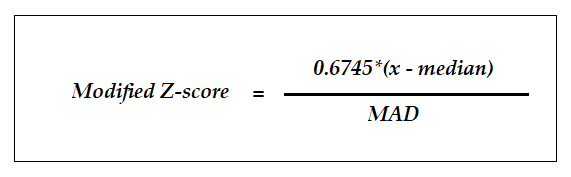

source: "Outlier detection methods!", Marcin Rutecki, https://www.kaggle.com/code/marcinrutecki/outlier-detection-methods, Retrieved: 2025-02-07

In [92]:
def detect_and_remove_outliers_modified_zscore(df_to_analyze, lst_features, threshold=3.5, verbose=True):
    """
    Detects and removes outliers using the Modified Z-score method.
    """

    all_outlier_indices = {feature: [] for feature in lst_features}
    df_cleaned = df_to_analyze.copy()
    count_total_outliers_removed = 0

    for feature_name in lst_features:
        try:
            df_cleaned[feature_name] = pd.to_numeric(df_cleaned[feature_name], errors='coerce')
            data = df_cleaned[feature_name].dropna().values  # Skip NaNs in calculations

            if len(data) < 3:
                continue

            median_val = np.median(data)
            mad = median_abs_deviation(data)

            if mad == 0:
                mad = 1e-9  # Prevent division by zero

            modified_z_scores = 0.6745 * np.abs(data - median_val) / mad
            outlier_mask = modified_z_scores > threshold

            #CRITICAL FIX: Use the original df index with the mask after dropping NAs.
            original_index_with_no_nans = df_cleaned[feature_name].dropna().index
            outlier_indices = original_index_with_no_nans[outlier_mask].tolist()

            all_outlier_indices[feature_name] = outlier_indices

            if verbose:
                print(f'Feature [{feature_name}] - Outliers detected: {len(outlier_indices)}')

        except (TypeError, ValueError) as e:
            print(f"Error processing column '{feature_name}': {e}")
            continue

    # Collect unique outlier row indices
    rows_to_remove = list(set(idx for indices in all_outlier_indices.values() for idx in indices))
    count_total_outliers_removed = len(rows_to_remove)

    # Drop rows from the original DataFrame
    df_cleaned = df_to_analyze.drop(index=rows_to_remove, errors='ignore')

    return df_cleaned, all_outlier_indices, count_total_outliers_removed

#NOTE: AI Assisted Code from Gemini

In [93]:
# Example usage:
df_cleaned, outlier_indices_dict, count_total_outliers_removed = detect_and_remove_outliers_modified_zscore(df, lst_features, threshold=3.5, verbose=True)
y_cleaned = df_cleaned[DEPENDENT_VAR_NAME]

print(f'\nTotal outliers removed: {count_total_outliers_removed}')
df_cleaned_features_modified_zscore_mad = df_cleaned[lst_features]

Feature [total_volume] - Outliers detected: 3503
Feature [4046] - Outliers detected: 6322
Feature [4225] - Outliers detected: 4225
Feature [4770] - Outliers detected: 6825
Feature [total_bags] - Outliers detected: 2715
Feature [small_bags] - Outliers detected: 2755
Feature [large_bags] - Outliers detected: 5192
Feature [xlarge-bags] - Outliers detected: 6201

Total outliers removed: 9744


In [94]:
df_cleaned_features_modified_zscore_mad

,total_volume,4046,4225,4770,total_bags,small_bags,large_bags,xlarge-bags
0,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0
1,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0
2,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0
3,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0
4,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0
...,...,...,...,...,...,...,...,...
18244,17074.83,2046.96,1529.20,0.00,13498.67,13066.82,431.85,0.0
18245,13888.04,1191.70,3431.50,0.00,9264.84,8940.04,324.80,0.0
18246,13766.76,1191.92,2452.79,727.94,9394.11,9351.80,42.31,0.0
18247,16205.22,1527.63,2981.04,727.01,10969.54,10919.54,50.00,0.0


ORIGINAL    sum_shape_metric: 977.3584239619304 
TRANSFORMED sum_shape_metric: nan


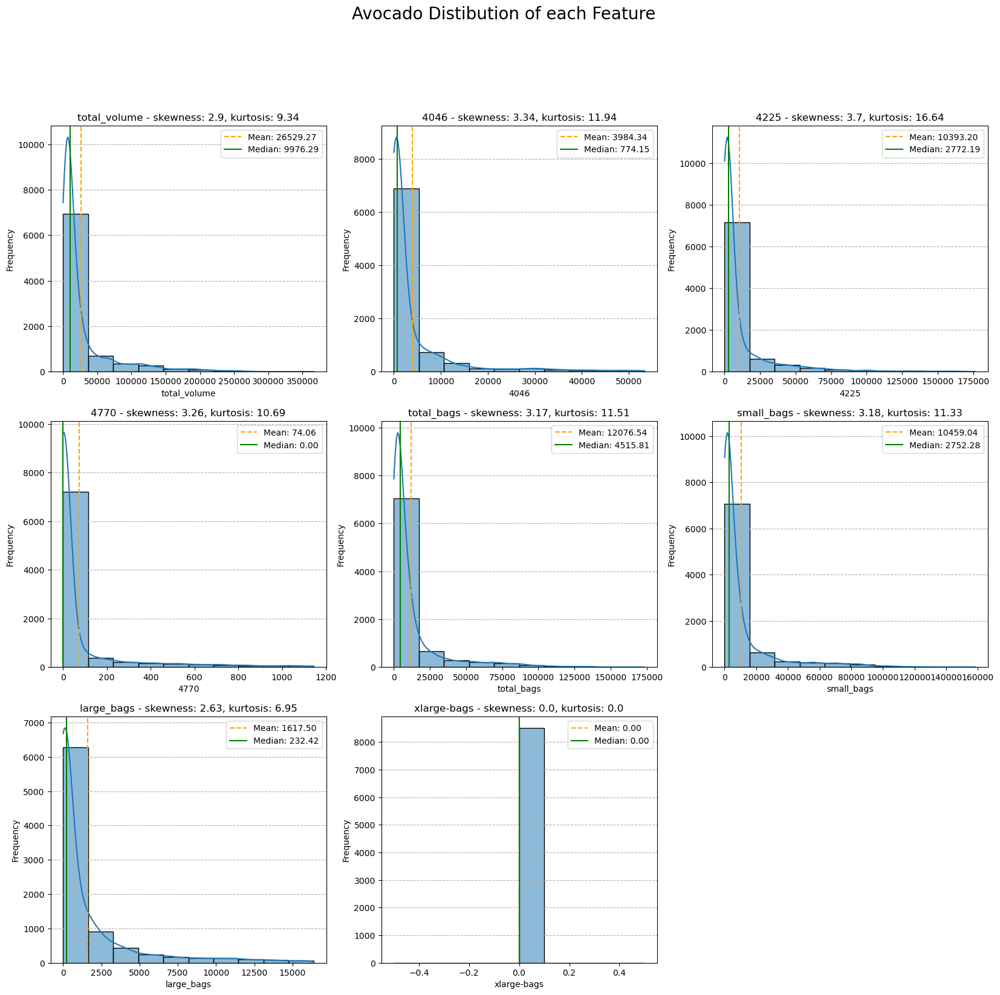

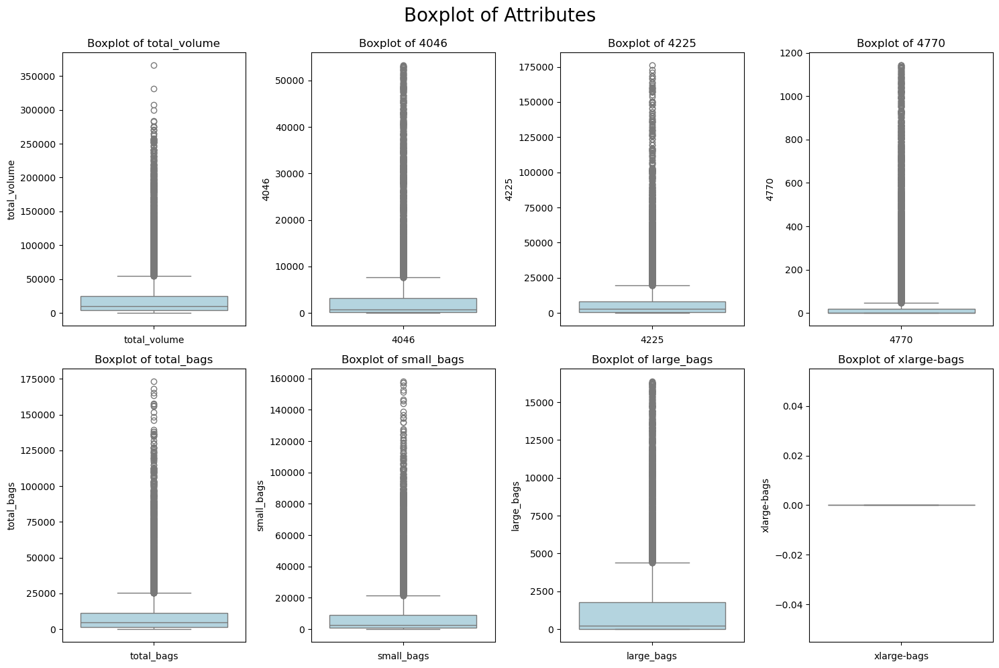

In [95]:
###############################################
# print original skewness and kurtosis
###############################################
SKEWNESS = skew(df_X_features)
KURTOSIS = kurtosis(df_X_features)
shape_metric = list(np.sqrt(np.power(SKEWNESS, 2) + np.power(KURTOSIS, 2)))
sum_shape_metric = np.sum(shape_metric)

#print(f'ORIGINAL    sum_shape_metric: {sum_shape_metric} \t shape_metric: {shape_metric}')
print(f'ORIGINAL    sum_shape_metric: {sum_shape_metric} ')

###############################################
# print transformed skewness and kurtosis
###############################################
SKEWNESS_TRANSFORMED = skew(df_cleaned_features_modified_zscore_mad)
KURTOSIS_TRANSFORMED = kurtosis(df_cleaned_features_modified_zscore_mad)
shape_metric_TRANSFORMED = list(np.sqrt(np.power(SKEWNESS_TRANSFORMED, 2) + np.power(KURTOSIS_TRANSFORMED, 2)))
sum_shape_metric_TRANSFORMED = np.sum(shape_metric_TRANSFORMED)

#print(f'TRANSFORMED sum_shape_metric: {sum_shape_metric_TRANSFORMED} \t shape_metric: {shape_metric_TRANSFORMED}')
print(f'TRANSFORMED sum_shape_metric: {sum_shape_metric_TRANSFORMED}')

################################################
# call fcn - sns kde histplot
################################################
df_to_analyze = df_cleaned_features_modified_zscore_mad
plot_kde_histplot(df_to_analyze, False, 3, 'Avocado Distibution of each Feature')

################################################
# call fcn - sns boxplot
################################################
#df_to_analyze = df.select_dtypes(include=[np.number])
df_to_analyze = df_cleaned_features_modified_zscore_mad
plot_boxplot(df_to_analyze, "Boxplot of Attributes", False)

<hr style="height:10px;color:#000;background-color:#F0F;">

# <span style="color: blue;"> <b><u> Create Holdout, Standardize Dataframe, Model Data, Evaluate Performance </b></u></span>  


creating hold-out set and standardizing dataset...
X_train: (6804, 8)
y_train: 6804

X_test: (1701, 8)
y_test: 1701

Done! Visualizing dataset before and after standardization and outlier transformation...

Done! Initiating data modeling!
instantiating models...
model instantiation complete!


Processing Model:   0%|                                                   | 0/35 [00:00<?, ?model/s]



######################################################################
# training model --> ada_boost_regressor
######################################################################
hyperparameters --> {'estimator': None, 'learning_rate': 1.0, 'loss': 'linear', 'n_estimators': 50, 'random_state': 42}



Processing Model:   3%|█▏                                         | 1/35 [00:04<02:27,  4.33s/model]

training model ada_boost_regressor complete! 	R2: 0.1550	analysis_duration --> 0:00:04.324284



######################################################################
# training model --> ard_regressor
######################################################################
hyperparameters --> {'alpha_1': 1e-06, 'alpha_2': 1e-06, 'compute_score': False, 'copy_X': True, 'fit_intercept': True, 'lambda_1': 1e-06, 'lambda_2': 1e-06, 'max_iter': 300, 'threshold_lambda': 10000.0, 'tol': 0.001, 'verbose': False}



Processing Model:   6%|██▍                                        | 2/35 [00:04<01:04,  1.97s/model]

training model ard_regressor complete! 	R2: 0.0933	analysis_duration --> 0:00:00.306224



######################################################################
# training model --> bayesian_ridge_regressor
######################################################################
hyperparameters --> {'alpha_1': 1e-06, 'alpha_2': 1e-06, 'alpha_init': None, 'compute_score': False, 'copy_X': True, 'fit_intercept': True, 'lambda_1': 1e-06, 'lambda_2': 1e-06, 'lambda_init': None, 'max_iter': 300, 'tol': 0.001, 'verbose': False}



Processing Model:   9%|███▋                                       | 3/35 [00:04<00:37,  1.17s/model]

training model bayesian_ridge_regressor complete! 	R2: 0.0927	analysis_duration --> 0:00:00.195386



######################################################################
# training model --> decision_tree_regressor
######################################################################
hyperparameters --> {'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'random_state': 42, 'splitter': 'best'}



Processing Model:  11%|████▉                                      | 4/35 [00:05<00:33,  1.08s/model]

training model decision_tree_regressor complete! 	R2: 0.1964	analysis_duration --> 0:00:00.946191



######################################################################
# training model --> decision_tree_pruned_regressor
######################################################################
hyperparameters --> {'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': 5, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'random_state': 42, 'splitter': 'best'}



Processing Model:  17%|███████▎                                   | 6/35 [00:06<00:17,  1.65model/s]

training model decision_tree_pruned_regressor complete! 	R2: 0.2525	analysis_duration --> 0:00:00.402070



######################################################################
# training model --> elasticnet_regressor
######################################################################
hyperparameters --> {'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}

training model elasticnet_regressor complete! 	R2: -0.0003	analysis_duration --> 0:00:00.136933



######################################################################
# training model --> elasticnet_regressor_2
######################################################################
hyperparameters --> {'alpha': 0.1, 'copy_X': True, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 't

Processing Model:  20%|████████▌                                  | 7/35 [00:06<00:13,  2.05model/s]

training model elasticnet_regressor_2 complete! 	R2: 0.0587	analysis_duration --> 0:00:00.231186



######################################################################
# training model --> elasticnet_regressor_cv
######################################################################
hyperparameters --> {'alphas': None, 'copy_X': True, 'cv': None, 'eps': 0.001, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'n_alphas': 100, 'n_jobs': None, 'positive': False, 'precompute': 'auto', 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'verbose': 0}



Processing Model:  23%|█████████▊                                 | 8/35 [00:08<00:27,  1.03s/model]

training model elasticnet_regressor_cv complete! 	R2: 0.0927	analysis_duration --> 0:00:02.176405



######################################################################
# training model --> elastic_regressor_cv_2
######################################################################
hyperparameters --> {'alphas': [0.5], 'copy_X': True, 'cv': 11, 'eps': 0.001, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'n_alphas': 100, 'n_jobs': -1, 'positive': False, 'precompute': 'auto', 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'verbose': 0}



Processing Model:  26%|███████████                                | 9/35 [00:09<00:24,  1.07model/s]

training model elastic_regressor_cv_2 complete! 	R2: -0.0003	analysis_duration --> 0:00:00.704121



######################################################################
# training model --> extra_trees_regressor
######################################################################
hyperparameters --> {'bootstrap': False, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}



Processing Model:  29%|████████████                              | 10/35 [00:28<02:44,  6.60s/model]

training model extra_trees_regressor complete! 	R2: 0.5823	analysis_duration --> 0:00:19.275262



######################################################################
# training model --> gradient_boosting_regressor_1
######################################################################
hyperparameters --> {'alpha': 0.9, 'ccp_alpha': 0.0, 'criterion': 'friedman_mse', 'init': None, 'learning_rate': 0.1, 'loss': 'squared_error', 'max_depth': 3, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 100, 'n_iter_no_change': None, 'random_state': 42, 'subsample': 1.0, 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': False, 'warm_start': False}



Processing Model:  31%|█████████████▏                            | 11/35 [00:44<03:46,  9.44s/model]

training model gradient_boosting_regressor_1 complete! 	R2: 0.4001	analysis_duration --> 0:00:15.879554



######################################################################
# training model --> gradient_boosting_regressor_2
######################################################################
hyperparameters --> {'alpha': 0.9, 'ccp_alpha': 0.0, 'criterion': 'friedman_mse', 'init': None, 'learning_rate': 0.01, 'loss': 'squared_error', 'max_depth': 2, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.5, 'n_estimators': 300, 'n_iter_no_change': None, 'random_state': 42, 'subsample': 1.0, 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False}



Processing Model:  34%|██████████████▍                           | 12/35 [01:02<04:34, 11.95s/model]

training model gradient_boosting_regressor_2 complete! 	R2: 0.1156	analysis_duration --> 0:00:17.681063



######################################################################
# training model --> hist_gradient_boosting_regressor
######################################################################
hyperparameters --> {'categorical_features': 'warn', 'early_stopping': 'auto', 'interaction_cst': None, 'l2_regularization': 0.0, 'learning_rate': 0.1, 'loss': 'squared_error', 'max_bins': 255, 'max_depth': None, 'max_features': 1.0, 'max_iter': 100, 'max_leaf_nodes': 31, 'min_samples_leaf': 20, 'monotonic_cst': None, 'n_iter_no_change': 10, 'quantile': None, 'random_state': 42, 'scoring': 'loss', 'tol': 1e-07, 'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False}



Processing Model:  37%|███████████████▌                          | 13/35 [01:06<03:30,  9.56s/model]

training model hist_gradient_boosting_regressor complete! 	R2: 0.5527	analysis_duration --> 0:00:04.035836



######################################################################
# training model --> huber_regressor
######################################################################
hyperparameters --> {'alpha': 0.0001, 'epsilon': 1.35, 'fit_intercept': True, 'max_iter': 100, 'tol': 1e-05, 'warm_start': False}



Processing Model:  40%|████████████████▊                         | 14/35 [01:07<02:23,  6.85s/model]

training model huber_regressor complete! 	R2: 0.0831	analysis_duration --> 0:00:00.576220



######################################################################
# training model --> knn_regressor_1
######################################################################
hyperparameters --> {'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': None, 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}



Processing Model:  43%|██████████████████                        | 15/35 [01:07<01:39,  4.97s/model]

training model knn_regressor_1 complete! 	R2: 0.4798	analysis_duration --> 0:00:00.611409



######################################################################
# training model --> knn_regressor_2
######################################################################
hyperparameters --> {'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': None, 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}



Processing Model:  49%|████████████████████▍                     | 17/35 [01:08<00:46,  2.60s/model]

training model knn_regressor_2 complete! 	R2: 0.4798	analysis_duration --> 0:00:00.615439



######################################################################
# training model --> linear_regressor
######################################################################
hyperparameters --> {'copy_X': True, 'fit_intercept': True, 'n_jobs': None, 'positive': False}

training model linear_regressor complete! 	R2: 0.0924	analysis_duration --> 0:00:00.134725



######################################################################
# training model --> lasso_regressor
######################################################################
hyperparameters --> {'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}



Processing Model:  51%|█████████████████████▌                    | 18/35 [01:08<00:32,  1.89s/model]

training model lasso_regressor complete! 	R2: -0.0003	analysis_duration --> 0:00:00.206755



######################################################################
# training model --> lasso_regressor_cv
######################################################################
hyperparameters --> {'alphas': [1], 'copy_X': True, 'cv': 11, 'eps': 0.001, 'fit_intercept': True, 'max_iter': 1000, 'n_alphas': 100, 'n_jobs': -1, 'positive': False, 'precompute': 'auto', 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'verbose': False}



Processing Model:  57%|████████████████████████                  | 20/35 [01:09<00:16,  1.10s/model]

training model lasso_regressor_cv complete! 	R2: -0.0003	analysis_duration --> 0:00:00.599016



######################################################################
# training model --> lasso_regressor_2
######################################################################
hyperparameters --> {'alpha': 0.1, 'copy_X': True, 'fit_intercept': True, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}

training model lasso_regressor_2 complete! 	R2: -0.0003	analysis_duration --> 0:00:00.134786



######################################################################
# training model --> lgbm_regressor
######################################################################
hyperparameters --> {'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'split', 'learning_rate': 0.1, 'max_depth': -1, 'min_child_samples': 20, 'min_child_weight': 0.001, 'min_split_gain': 0.0, '

Processing Model:  60%|█████████████████████████▏                | 21/35 [01:11<00:18,  1.32s/model]

training model lgbm_regressor complete! 	R2: 0.5489	analysis_duration --> 0:00:01.839212



######################################################################
# training model --> mlp_regressor_1
######################################################################
hyperparameters --> {'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'early_stopping': False, 'epsilon': 1e-08, 'hidden_layer_sizes': (100,), 'learning_rate': 'constant', 'learning_rate_init': 0.001, 'max_fun': 15000, 'max_iter': 100, 'momentum': 0.9, 'n_iter_no_change': 10, 'nesterovs_momentum': True, 'power_t': 0.5, 'random_state': 42, 'shuffle': True, 'solver': 'adam', 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': False, 'warm_start': False}



Processing Model:  63%|██████████████████████████▍               | 22/35 [01:33<01:37,  7.47s/model]

training model mlp_regressor_1 complete! 	R2: 0.3298	analysis_duration --> 0:00:21.797133



######################################################################
# training model --> ransac_regressor
######################################################################
hyperparameters --> {'estimator': None, 'is_data_valid': None, 'is_model_valid': None, 'loss': 'absolute_error', 'max_skips': inf, 'max_trials': 100, 'min_samples': None, 'random_state': 42, 'residual_threshold': None, 'stop_n_inliers': inf, 'stop_probability': 0.99, 'stop_score': inf}



Processing Model:  66%|███████████████████████████▌              | 23/35 [01:34<01:09,  5.77s/model]

training model ransac_regressor complete! 	R2: -0.9637	analysis_duration --> 0:00:01.780732



######################################################################
# training model --> ridge_regressor
######################################################################
hyperparameters --> {'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'max_iter': None, 'positive': False, 'random_state': 42, 'solver': 'auto', 'tol': 0.0001}



Processing Model:  69%|████████████████████████████▊             | 24/35 [01:35<00:45,  4.11s/model]

training model ridge_regressor complete! 	R2: 0.0927	analysis_duration --> 0:00:00.225601



######################################################################
# training model --> ridge_regressor_cv
######################################################################
hyperparameters --> {'alpha_per_target': False, 'alphas': [2], 'cv': 11, 'fit_intercept': True, 'gcv_mode': None, 'scoring': None, 'store_cv_results': None, 'store_cv_values': 'deprecated'}



Processing Model:  74%|███████████████████████████████▏          | 26/35 [01:36<00:20,  2.25s/model]

training model ridge_regressor_cv complete! 	R2: 0.0927	analysis_duration --> 0:00:00.892843



######################################################################
# training model --> ridge_regressor_2
######################################################################
hyperparameters --> {'alpha': 1, 'copy_X': True, 'fit_intercept': True, 'max_iter': None, 'positive': False, 'random_state': 42, 'solver': 'cholesky', 'tol': 0.0001}

training model ridge_regressor_2 complete! 	R2: 0.0927	analysis_duration --> 0:00:00.134319



######################################################################
# training model --> svm_regressor_linear_1
######################################################################
hyperparameters --> {'C': 1.0, 'dual': 'auto', 'epsilon': 0.0, 'fit_intercept': True, 'intercept_scaling': 1.0, 'loss': 'epsilon_insensitive', 'max_iter': 1000, 'random_state': None, 'tol': 0.0001, 'verbose': 0}



Processing Model:  77%|████████████████████████████████▍         | 27/35 [01:38<00:18,  2.30s/model]

training model svm_regressor_linear_1 complete! 	R2: 0.0786	analysis_duration --> 0:00:02.413535



######################################################################
# training model --> svm_regressor_linear_2
######################################################################
hyperparameters --> {'C': 1.0, 'dual': 'auto', 'epsilon': 1.5, 'fit_intercept': True, 'intercept_scaling': 1.0, 'loss': 'epsilon_insensitive', 'max_iter': 1000, 'random_state': None, 'tol': 0.0001, 'verbose': 0}



Processing Model:  80%|█████████████████████████████████▌        | 28/35 [01:38<00:12,  1.72s/model]

training model svm_regressor_linear_2 complete! 	R2: -0.1521	analysis_duration --> 0:00:00.336700



######################################################################
# training model --> theil_sen_regressor
######################################################################
hyperparameters --> {'copy_X': True, 'fit_intercept': True, 'max_iter': 500, 'max_subpopulation': 10000, 'n_jobs': -1, 'n_subsamples': None, 'random_state': None, 'tol': 0.001, 'verbose': False}



Processing Model:  83%|██████████████████████████████████▊       | 29/35 [02:26<01:33, 15.54s/model]

training model theil_sen_regressor complete! 	R2: -0.1934	analysis_duration --> 0:00:47.795201



######################################################################
# training model --> xgb_regressor_1
######################################################################
hyperparameters --> {'objective': 'reg:squarederror', 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': None, 'device': None, 'early_stopping_rounds': None, 'enable_categorical': False, 'eval_metric': None, 'feature_types': None, 'gamma': None, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': None, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': None, 'max_leaves': None, 'min_child_weight': None, 'missing': nan, 'monotone_constraints': None, 'multi_strategy': None, 'n_estimators': None, 'n_jobs': None, 'num_parallel_tree': None, 'r

Processing Model:  86%|████████████████████████████████████      | 30/35 [02:29<00:58, 11.62s/model]

training model xgb_regressor_1 complete! 	R2: 0.5412	analysis_duration --> 0:00:02.443644



######################################################################
# training model --> xgb_regressor_2
######################################################################
hyperparameters --> {'objective': 'reg:squarederror', 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': None, 'device': None, 'early_stopping_rounds': None, 'enable_categorical': False, 'eval_metric': 'logloss', 'feature_types': None, 'gamma': None, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': None, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': None, 'max_leaves': None, 'min_child_weight': None, 'missing': nan, 'monotone_constraints': None, 'multi_strategy': None, 'n_estimators': None, 'n_jobs': None, 'num_parallel_tree': None, 'r

Processing Model:  89%|█████████████████████████████████████▏    | 31/35 [02:31<00:35,  8.93s/model]

training model xgb_regressor_2 complete! 	R2: 0.5412	analysis_duration --> 0:00:02.648352



######################################################################
# training model --> random_forest_regressor
######################################################################
hyperparameters --> {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': -1, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}



Processing Model:  91%|██████████████████████████████████████▍   | 32/35 [03:29<01:10, 23.46s/model]

training model random_forest_regressor complete! 	R2: 0.5751	analysis_duration --> 0:00:57.334004



######################################################################
# training model --> random_forest_regressor_2
######################################################################
hyperparameters --> {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 5, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}



Processing Model:  94%|███████████████████████████████████████▌  | 33/35 [04:10<00:57, 28.73s/model]

training model random_forest_regressor_2 complete! 	R2: 0.5638	analysis_duration --> 0:00:41.016791



######################################################################
# training model --> mlp_regressor_2
######################################################################
hyperparameters --> {'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'early_stopping': False, 'epsilon': 1e-08, 'hidden_layer_sizes': (200,), 'learning_rate': 'constant', 'learning_rate_init': 0.001, 'max_fun': 15000, 'max_iter': 400, 'momentum': 0.9, 'n_iter_no_change': 10, 'nesterovs_momentum': True, 'power_t': 0.5, 'random_state': 42, 'shuffle': True, 'solver': 'adam', 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': False, 'warm_start': False}



Processing Model:  97%|████████████████████████████████████████▊ | 34/35 [05:00<00:35, 35.07s/model]

training model mlp_regressor_2 complete! 	R2: 0.3231	analysis_duration --> 0:00:49.857986



######################################################################
# training model --> catboost_regressor
######################################################################
hyperparameters --> {'loss_function': 'RMSE', 'verbose': 0, 'random_state': 42}



Processing Model: 100%|██████████████████████████████████████████| 35/35 [06:03<00:00, 10.39s/model]

training model catboost_regressor complete! 	R2: 0.5739	analysis_duration --> 0:01:03.659437




******************************************************************************************
* model training COMPLETE!
******************************************************************************************

Done! Sorting and saving data...


,model_name,r2,adjusted_r2,cross_validated_r2,explained_variance_score,rmse,rmsle,mae,mape,mse,msle,mase,smape,med_ae,huber_loss,mbd,cv_rmse,r2_residuals,durbin_watson_stat,start_time,end_time,analysis_duration_text,analysis_duration
0,extra_trees_regressor,0.5823,0.5804,0.5754,0.5825,0.2402,0.0880,0.1677,0.1037,0.0577,0.0078,0.4083,0.1020,0.1125,0.275,-0.0054,0.1454,-19.1720,1.9675,2025-02-24-0751,2025-02-24-0751,"0 day(s), 0 hour(s), 0 minute(s), 19 second(s)",0:00:19.275262
1,random_forest_regressor,0.5751,0.5731,0.5710,0.5754,0.2423,0.0888,0.1695,0.1047,0.0587,0.0079,0.4125,0.1029,0.1213,0.275,-0.0063,0.1466,-19.1300,1.9602,2025-02-24-0753,2025-02-24-0754,"0 day(s), 0 hour(s), 0 minute(s), 57 second(s)",0:00:57.334004
2,catboost_regressor,0.5739,0.5718,0.5612,0.5745,0.2426,0.0887,0.1738,0.1071,0.0589,0.0079,0.4231,0.1054,0.1281,0.275,-0.0091,0.1468,-19.0499,1.9977,2025-02-24-0755,2025-02-24-0756,"0 day(s), 0 hour(s), 1 minute(s), 3 second(s)",0:01:03.659437
3,random_forest_regressor_2,0.5638,0.5618,0.5556,0.5641,0.2455,0.0900,0.1751,0.1086,0.0603,0.0081,0.4263,0.1066,0.1271,0.275,-0.0057,0.1486,-19.1101,1.9620,2025-02-24-0754,2025-02-24-0755,"0 day(s), 0 hour(s), 0 minute(s), 41 second(s)",0:00:41.016791
4,hist_gradient_boosting_regressor,0.5527,0.5506,0.5394,0.5532,0.2486,0.0912,0.1819,0.1128,0.0618,0.0083,0.4429,0.1108,0.1371,0.275,-0.0083,0.1504,-19.0324,1.9721,2025-02-24-0751,2025-02-24-0752,"0 day(s), 0 hour(s), 0 minute(s), 4 second(s)",0:00:04.035836
5,lgbm_regressor,0.5489,0.5468,0.5408,0.5498,0.2496,0.0917,0.1821,0.1129,0.0623,0.0084,0.4433,0.1110,0.1387,0.275,-0.0107,0.1511,-18.9804,1.9885,2025-02-24-0752,2025-02-24-0752,"0 day(s), 0 hour(s), 0 minute(s), 1 second(s)",0:00:01.839212
6,xgb_regressor_2,0.5412,0.5391,0.5324,0.5419,0.2518,0.0923,0.1798,0.1109,0.0634,0.0085,0.4377,0.1092,0.1339,0.275,-0.0096,0.1524,-19.1077,1.9635,2025-02-24-0753,2025-02-24-0753,"0 day(s), 0 hour(s), 0 minute(s), 2 second(s)",0:00:02.648352
7,xgb_regressor_1,0.5412,0.5391,0.5324,0.5419,0.2518,0.0923,0.1798,0.1109,0.0634,0.0085,0.4377,0.1092,0.1339,0.275,-0.0096,0.1524,-19.1077,1.9635,2025-02-24-0753,2025-02-24-0753,"0 day(s), 0 hour(s), 0 minute(s), 2 second(s)",0:00:02.443644
8,knn_regressor_2,0.4798,0.4773,0.4693,0.4804,0.2681,0.0987,0.1866,0.1156,0.0719,0.0098,0.4544,0.1133,0.1300,0.275,-0.0087,0.1622,-19.1653,1.9726,2025-02-24-0752,2025-02-24-0752,"0 day(s), 0 hour(s), 0 minute(s), 0 second(s)",0:00:00.615439
9,knn_regressor_1,0.4798,0.4773,0.4693,0.4804,0.2681,0.0987,0.1866,0.1156,0.0719,0.0098,0.4544,0.1133,0.1300,0.275,-0.0087,0.1622,-19.1653,1.9726,2025-02-24-0752,2025-02-24-0752,"0 day(s), 0 hour(s), 0 minute(s), 0 second(s)",0:00:00.611409



Done! Plotting performance metrics...


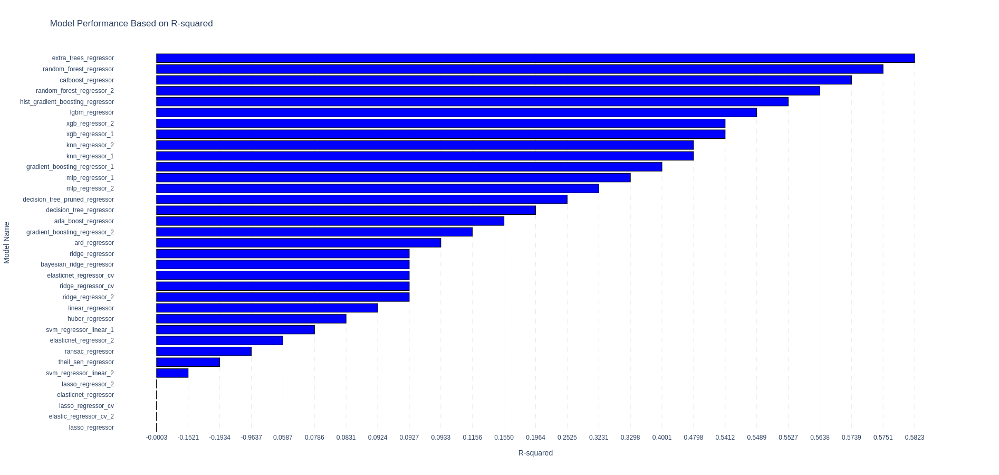



ALL ACTIONS COMPLETE!!!


CPU times: user 4min 20s, sys: 3.73 s, total: 4min 24s
Wall time: 6min 10s


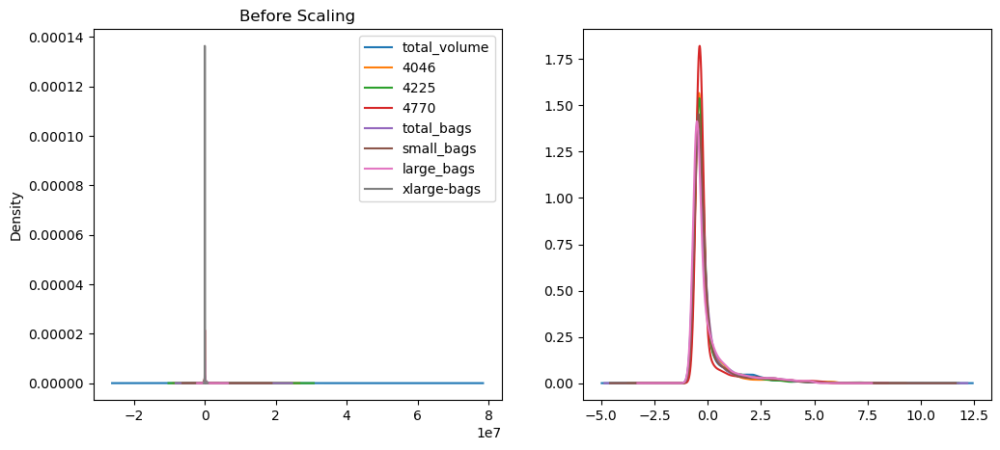

In [96]:
%%time

#################################################################################
# set X
#################################################################################
df_X_to_standardize = df_cleaned_features_modified_zscore_mad

#################################################################################
# Create holdout set and standardize data
#################################################################################
# create hold out set and standardize the data
print('\ncreating hold-out set and standardizing dataset...')
X_train_scaled, X_test_scaled, y_train, y_test = standardize_dataset(df_X_to_standardize, y_cleaned, 0.20, 42, dict_standard_scalers, 'modified_zscore_mad')

#################################################################################
# Visualize the new data
#################################################################################
print('\nDone! Visualizing dataset before and after standardization and outlier transformation...')
try:
    fig, axes = plt.subplots(1, 2, figsize=(12, 5))
    
    # Before scaling
    X_train.plot(kind='kde', ax=axes[0], title="Before Scaling")
    
    # After scaling
    X_train_scaled.plot(kind='kde', ax=axes[1], title="After Scaling")
    
    plt.tight_layout()
    plt.show()
    
    
except:
    pass

#################################################################################
# train the models!
#################################################################################
print('\nDone! Initiating data modeling!')
df_model_evaluation_metrics_modified_zscore_mad, dict_completed_models_modified_zscore_mad, lst_error_model_modified_zscore_mad = instantiate_and_model_data(X_train_scaled, X_test_scaled, y_train, y_test)

#################################################################################
# View Model Performance
#################################################################################
print('\nDone! Sorting and saving data...')
# sort models by r2
df_model_evaluation_metrics_modified_zscore_mad = df_model_evaluation_metrics_modified_zscore_mad.sort_values(by='r2', ascending=False, inplace=False)
df_model_evaluation_metrics_modified_zscore_mad = df_model_evaluation_metrics_modified_zscore_mad.reset_index(drop=True, inplace=False)


#save df
df_model_evaluation_metrics_modified_zscore_mad.to_csv('./model_performance_after_outlier_transformation_modified_zscore_mad.csv', index=False)

# view df
#df_model_evaluation_metrics_modified_zscore_mad.style.format(precision=3, thousands=",", decimal=".").format_index(str.upper, axis=1)
#df_model_evaluation_metrics_modified_zscore_mad.style.format(precision=3, thousands=",", decimal=".").format_index(str.lower, axis=1)
styled_df = df_model_evaluation_metrics_modified_zscore_mad.style.format(precision=3, thousands=",", decimal=".").format_index(str.lower, axis=1)
display(HTML(styled_df.to_html()))


#################################################################################
# Sort model data for charting
#################################################################################
print('\nDone! Plotting performance metrics...')
# plot in ascending order
df_model_evaluation_metrics_sorted_modified_zscore_mad = df_model_evaluation_metrics_modified_zscore_mad.sort_values(by='r2', ascending=True, inplace=False)
df_model_evaluation_metrics_sorted_modified_zscore_mad = df_model_evaluation_metrics_sorted_modified_zscore_mad.reset_index(drop=True, inplace=False)

# soft dict of models for displaying feature importance below
dict_completed_models_sorted_modified_zscore_mad = dict()

lst_sorted_models_modified_zscore_mad = list(df_model_evaluation_metrics_sorted_modified_zscore_mad['model_name'])[::-1]


#################################################################################
# Plot Model Performance
#################################################################################
fig = go.Figure()

fig.add_trace(go.Bar(
    y=df_model_evaluation_metrics_sorted_modified_zscore_mad['model_name'],  
    x=df_model_evaluation_metrics_sorted_modified_zscore_mad['r2'],  
    orientation='h',  # Horizontal bar chart
    marker=dict(color='blue', line=dict(color='black', width=1)),  
))

# Update layout with dashed vertical gridlines
fig.update_layout(
    title="Model Performance Based on R-squared",
    xaxis_title="R-squared",
    yaxis_title="Model Name",
    xaxis=dict(
        showgrid=True, 
        zeroline=True,
        gridcolor='lightgray',  
        gridwidth=0.5,      
        griddash='dash'      
    ),
    yaxis=dict(tickmode='linear'),
    height=900, width=1300,  
    plot_bgcolor="white",  
    paper_bgcolor="white"   
)

# Show plot
fig.show()



#################################################################################
# notify
#################################################################################
print('\n\nALL ACTIONS COMPLETE!!!\n\n')

<hr style="height:30px;color:#000;background-color:#000;">

# <b> DBSCAN - Density-Based Spatial Clustering of Applications with Noise </b>

DBSCAN is a powerful density-based data clustering algorithm. Clustering is an unsupervised learning technique where we try to group the data points based on specific characteristics. DBSCAN was proposed by Martin Ester et al. in 1996. It works on the assumption that clusters are dense regions in space separated by regions of lower density.

To cluster data points DBSCAN algorithm separates the high-density regions of the data from the low-density areas. It uses distance and a minimum number of points per cluster to classify a point as an outlier. This approch is similar to the K-mean clustering.

PARAMETERS:

**Epsilon** is the radius of the circle to be created around each data point to check the density.

**minPoints** is the minimum number of data points required inside that circle for that data point to be classified as a Core point. This includes the point itself.

In higher dimensions the circle becomes hypersphere, epsilon becomes the radius of that hypersphere, and minPoints is the minimum number of data points required inside that hypersphere.

**DBSCAN algorithm doesn't make assumptions about how data are distributed.**

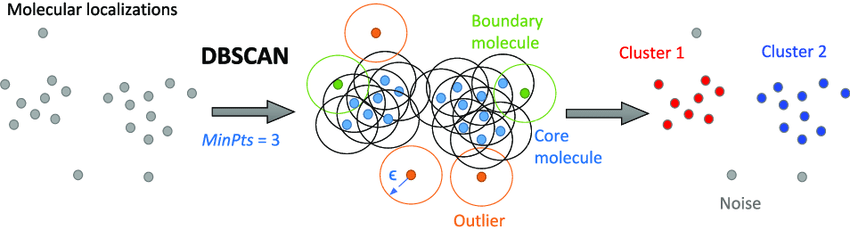

https://scikit-learn.org/stable/modules/generated/sklearn.cluster.DBSCAN.html

source: "Outlier detection methods!", Marcin Rutecki, https://www.kaggle.com/code/marcinrutecki/outlier-detection-methods, Retrieved: 2025-02-07

In [97]:
def detect_and_remove_outliers_dbscan(df_to_analyze, lst_features, epsilon=0.5, min_samples=5, verbose=True, override_feature_to_remove_outliers='xlarge-bags'):
    """Detects and removes outliers using DBSCAN (without scaling)."""

    all_outlier_indices = {feature: [] for feature in lst_features}
    df_cleaned = df_to_analyze.copy()
    count_total_outliers_removed = 0

    for feature_name in lst_features:
        try:
            df_cleaned[feature_name] = pd.to_numeric(df_cleaned[feature_name], errors='coerce')

            # 1. Handle NaNs: Create a mask of NON-NaN values
            nan_mask = df_cleaned[feature_name].notna()

            # 2. Extract data *and* indices for DBSCAN based on the nan_mask
            data = df_cleaned.loc[nan_mask, feature_name].values.reshape(-1, 1)
            original_indices = df_cleaned.loc[nan_mask].index

            if len(data) < min_samples + 1:
                if verbose:
                    print(f"Feature [{feature_name}] skipped due to insufficient data points (< {min_samples + 1}).")
                continue

            # 3. Perform DBSCAN
            dbscan = DBSCAN(eps=epsilon, min_samples=min_samples)
            clusters = dbscan.fit_predict(data)

            # 4. Identify outliers
            outlier_mask = clusters == -1

            # 5. Get ORIGINAL indices of outliers
            outlier_indices_current_feature = original_indices[outlier_mask].tolist()

            if override_feature_to_remove_outliers is not None and feature_name == override_feature_to_remove_outliers:
                all_outlier_indices[feature_name] = outlier_indices_current_feature

            if verbose:
                print(f'Feature [{feature_name}] - Outliers detected: {len(outlier_indices_current_feature)}')

        except (TypeError, ValueError) as e:
            print(f"Error processing column '{feature_name}': {e}")
            continue

    # 6. Collect and remove duplicate outlier indices
    rows_to_remove = list(set(idx for indices in all_outlier_indices.values() for idx in indices))
    count_total_outliers_removed = len(rows_to_remove)

    if count_total_outliers_removed == 0 and verbose:
        print("\nNo outliers detected. No rows removed.")

    df_cleaned = df_to_analyze.drop(index=rows_to_remove, errors='ignore')  # Remove from ORIGINAL DataFrame

    return df_cleaned, all_outlier_indices, count_total_outliers_removed

In [98]:
# Example usage:
df_cleaned, outlier_indices_dict, count_total_outliers_removed = detect_and_remove_outliers_dbscan(df, lst_features, epsilon=0.5, min_samples=5, verbose=True, override_feature_to_remove_outliers='xlarge-bags')
y_cleaned = df_cleaned[DEPENDENT_VAR_NAME]

print(f'\nTotal outliers removed: {count_total_outliers_removed}')
df_cleaned_features_dbscan = df_cleaned[lst_features]

Feature [total_volume] - Outliers detected: 18223
Feature [4046] - Outliers detected: 14257
Feature [4225] - Outliers detected: 16562
Feature [4770] - Outliers detected: 7919
Feature [total_bags] - Outliers detected: 17939
Feature [small_bags] - Outliers detected: 16715
Feature [large_bags] - Outliers detected: 12141
Feature [xlarge-bags] - Outliers detected: 4206

Total outliers removed: 4206


In [99]:
df_cleaned_features_dbscan

,total_volume,4046,4225,4770,total_bags,small_bags,large_bags,xlarge-bags
0,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0
1,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0
2,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0
3,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0
4,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0
...,...,...,...,...,...,...,...,...
18244,17074.83,2046.96,1529.20,0.00,13498.67,13066.82,431.85,0.0
18245,13888.04,1191.70,3431.50,0.00,9264.84,8940.04,324.80,0.0
18246,13766.76,1191.92,2452.79,727.94,9394.11,9351.80,42.31,0.0
18247,16205.22,1527.63,2981.04,727.01,10969.54,10919.54,50.00,0.0


ORIGINAL    sum_shape_metric: 977.3584239619304 
TRANSFORMED sum_shape_metric: 645.0474951320733


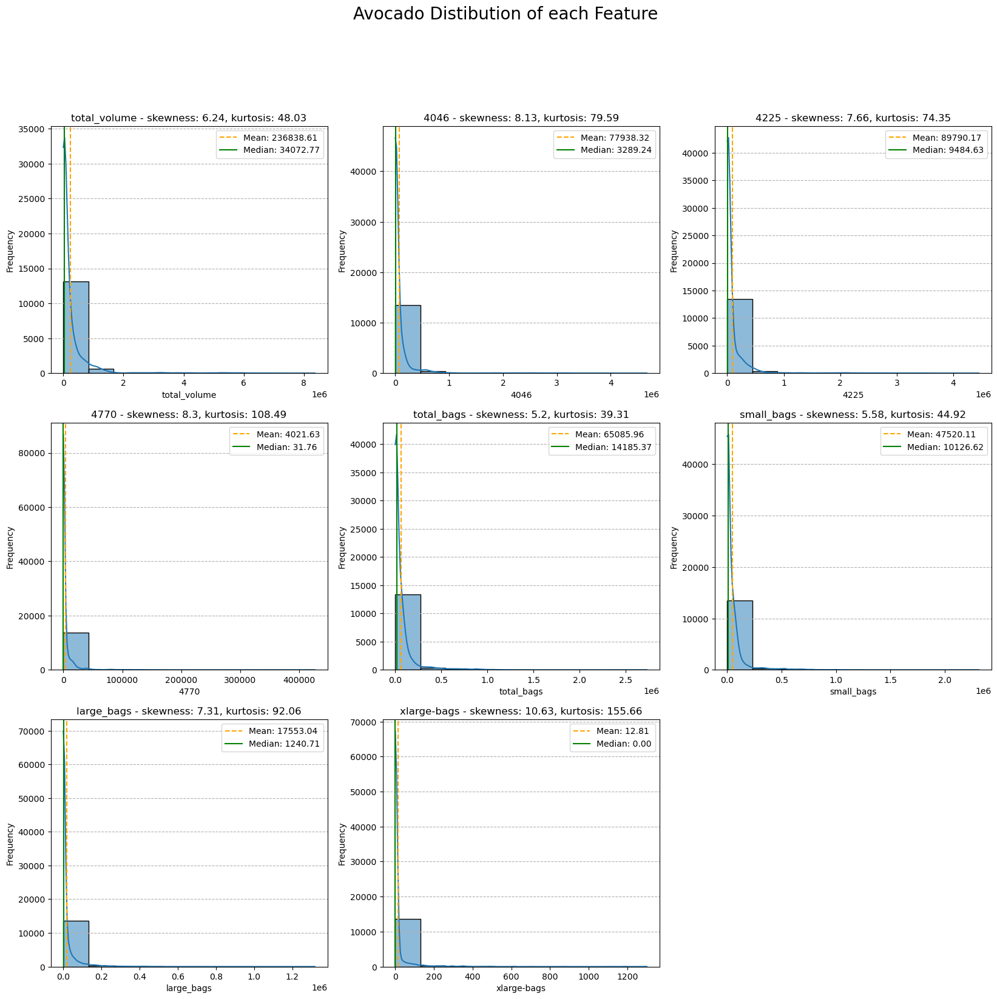

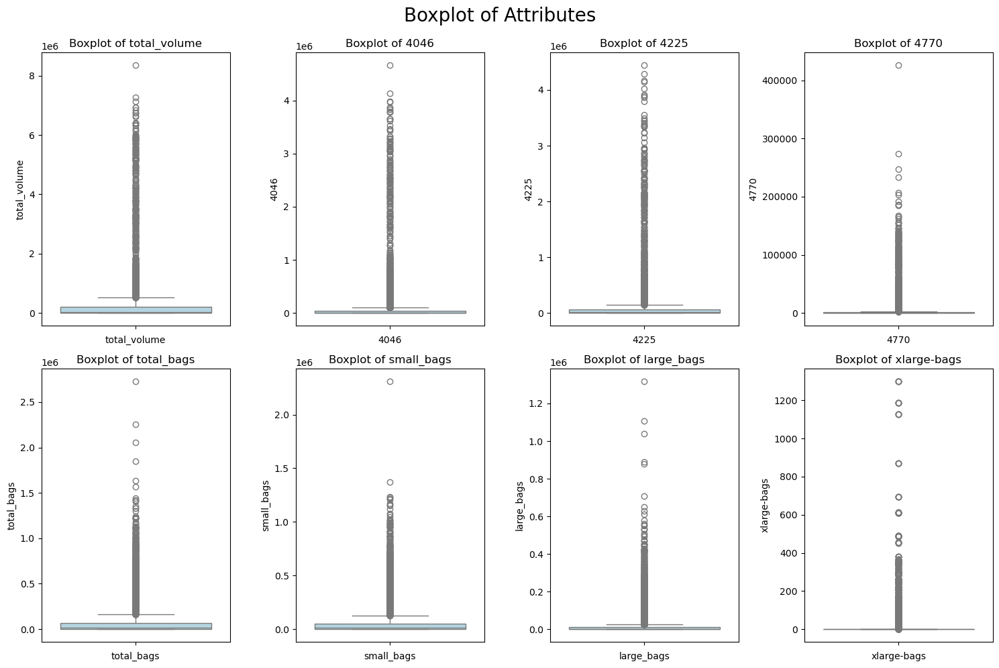

In [100]:
###############################################
# print original skewness and kurtosis
###############################################
SKEWNESS = skew(df_X_features)
KURTOSIS = kurtosis(df_X_features)
shape_metric = list(np.sqrt(np.power(SKEWNESS, 2) + np.power(KURTOSIS, 2)))
sum_shape_metric = np.sum(shape_metric)

#print(f'ORIGINAL    sum_shape_metric: {sum_shape_metric} \t shape_metric: {shape_metric}')
print(f'ORIGINAL    sum_shape_metric: {sum_shape_metric} ')

###############################################
# print transformed skewness and kurtosis
###############################################
SKEWNESS_TRANSFORMED = skew(df_cleaned_features_dbscan)
KURTOSIS_TRANSFORMED = kurtosis(df_cleaned_features_dbscan)
shape_metric_TRANSFORMED = list(np.sqrt(np.power(SKEWNESS_TRANSFORMED, 2) + np.power(KURTOSIS_TRANSFORMED, 2)))
sum_shape_metric_TRANSFORMED = np.sum(shape_metric_TRANSFORMED)

#print(f'TRANSFORMED sum_shape_metric: {sum_shape_metric_TRANSFORMED} \t shape_metric: {shape_metric_TRANSFORMED}')
print(f'TRANSFORMED sum_shape_metric: {sum_shape_metric_TRANSFORMED}')

################################################
# call fcn - sns kde histplot
################################################
df_to_analyze = df_cleaned_features_dbscan
plot_kde_histplot(df_to_analyze, False, 3, 'Avocado Distibution of each Feature')

################################################
# call fcn - sns boxplot
################################################
#df_to_analyze = df.select_dtypes(include=[np.number])
df_to_analyze = df_cleaned_features_dbscan
plot_boxplot(df_to_analyze, "Boxplot of Attributes", False)

<hr style="height:10px;color:#000;background-color:#F0F;">

# <span style="color: blue;"> <b><u> Create Holdout, Standardize Dataframe, Model Data, Evaluate Performance </b></u></span>  


creating hold-out set and standardizing dataset...
X_train: (11234, 8)
y_train: 11234

X_test: (2809, 8)
y_test: 2809

Done! Visualizing dataset before and after standardization and outlier transformation...


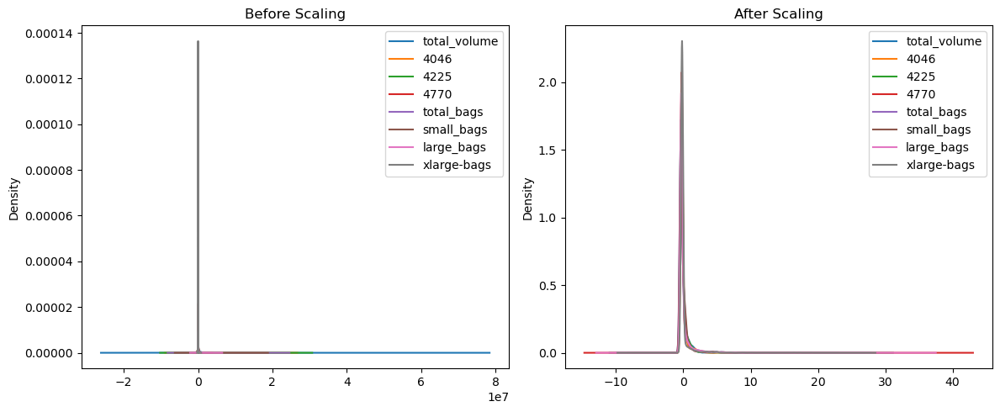


Done! Initiating data modeling!
instantiating models...
model instantiation complete!


Processing Model:   0%|                                                   | 0/35 [00:00<?, ?model/s]



######################################################################
# training model --> ada_boost_regressor
######################################################################
hyperparameters --> {'estimator': None, 'learning_rate': 1.0, 'loss': 'linear', 'n_estimators': 50, 'random_state': 42}



Processing Model:   3%|█▏                                         | 1/35 [00:06<03:29,  6.15s/model]

training model ada_boost_regressor complete! 	R2: 0.4012	analysis_duration --> 0:00:06.150319



######################################################################
# training model --> ard_regressor
######################################################################
hyperparameters --> {'alpha_1': 1e-06, 'alpha_2': 1e-06, 'compute_score': False, 'copy_X': True, 'fit_intercept': True, 'lambda_1': 1e-06, 'lambda_2': 1e-06, 'max_iter': 300, 'threshold_lambda': 10000.0, 'tol': 0.001, 'verbose': False}



Processing Model:   6%|██▍                                        | 2/35 [00:06<01:30,  2.73s/model]

training model ard_regressor complete! 	R2: 0.1465	analysis_duration --> 0:00:00.326876



######################################################################
# training model --> bayesian_ridge_regressor
######################################################################
hyperparameters --> {'alpha_1': 1e-06, 'alpha_2': 1e-06, 'alpha_init': None, 'compute_score': False, 'copy_X': True, 'fit_intercept': True, 'lambda_1': 1e-06, 'lambda_2': 1e-06, 'lambda_init': None, 'max_iter': 300, 'tol': 0.001, 'verbose': False}



Processing Model:   9%|███▋                                       | 3/35 [00:06<00:50,  1.59s/model]

training model bayesian_ridge_regressor complete! 	R2: 0.1466	analysis_duration --> 0:00:00.211515



######################################################################
# training model --> decision_tree_regressor
######################################################################
hyperparameters --> {'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'random_state': 42, 'splitter': 'best'}



Processing Model:  11%|████▉                                      | 4/35 [00:08<00:54,  1.76s/model]

training model decision_tree_regressor complete! 	R2: 0.4444	analysis_duration --> 0:00:02.022047



######################################################################
# training model --> decision_tree_pruned_regressor
######################################################################
hyperparameters --> {'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': 5, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'random_state': 42, 'splitter': 'best'}



Processing Model:  14%|██████▏                                    | 5/35 [00:09<00:42,  1.41s/model]

training model decision_tree_pruned_regressor complete! 	R2: 0.4950	analysis_duration --> 0:00:00.783536



######################################################################
# training model --> elasticnet_regressor
######################################################################
hyperparameters --> {'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}

training model elasticnet_regressor complete! 	R2: -0.0001	analysis_duration --> 0:00:00.187823



Processing Model:  20%|████████▌                                  | 7/35 [00:09<00:20,  1.36model/s]



######################################################################
# training model --> elasticnet_regressor_2
######################################################################
hyperparameters --> {'alpha': 0.1, 'copy_X': True, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}

training model elasticnet_regressor_2 complete! 	R2: 0.1095	analysis_duration --> 0:00:00.184988



######################################################################
# training model --> elasticnet_regressor_cv
######################################################################
hyperparameters --> {'alphas': None, 'copy_X': True, 'cv': None, 'eps': 0.001, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'n_alphas': 100, 'n_jobs': None, 'positive': False, 'precompute': 'auto', 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'verbose': 0}



Processing Model:  23%|█████████▊                                 | 8/35 [00:12<00:38,  1.44s/model]

training model elasticnet_regressor_cv complete! 	R2: 0.1462	analysis_duration --> 0:00:02.923927



######################################################################
# training model --> elastic_regressor_cv_2
######################################################################
hyperparameters --> {'alphas': [0.5], 'copy_X': True, 'cv': 11, 'eps': 0.001, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'n_alphas': 100, 'n_jobs': -1, 'positive': False, 'precompute': 'auto', 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'verbose': 0}



Processing Model:  26%|███████████                                | 9/35 [00:13<00:32,  1.27s/model]

training model elastic_regressor_cv_2 complete! 	R2: -0.0001	analysis_duration --> 0:00:00.882527



######################################################################
# training model --> extra_trees_regressor
######################################################################
hyperparameters --> {'bootstrap': False, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}



Processing Model:  29%|████████████                              | 10/35 [00:59<06:13, 14.95s/model]

training model extra_trees_regressor complete! 	R2: 0.7288	analysis_duration --> 0:00:45.592145



######################################################################
# training model --> gradient_boosting_regressor_1
######################################################################
hyperparameters --> {'alpha': 0.9, 'ccp_alpha': 0.0, 'criterion': 'friedman_mse', 'init': None, 'learning_rate': 0.1, 'loss': 'squared_error', 'max_depth': 3, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 100, 'n_iter_no_change': None, 'random_state': 42, 'subsample': 1.0, 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': False, 'warm_start': False}



Processing Model:  31%|█████████████▏                            | 11/35 [01:35<08:35, 21.47s/model]

training model gradient_boosting_regressor_1 complete! 	R2: 0.5765	analysis_duration --> 0:00:36.228211



######################################################################
# training model --> gradient_boosting_regressor_2
######################################################################
hyperparameters --> {'alpha': 0.9, 'ccp_alpha': 0.0, 'criterion': 'friedman_mse', 'init': None, 'learning_rate': 0.01, 'loss': 'squared_error', 'max_depth': 2, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.5, 'n_estimators': 300, 'n_iter_no_change': None, 'random_state': 42, 'subsample': 1.0, 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False}



Processing Model:  34%|██████████████▍                           | 12/35 [02:25<11:30, 30.04s/model]

training model gradient_boosting_regressor_2 complete! 	R2: 0.3113	analysis_duration --> 0:00:49.643947



######################################################################
# training model --> hist_gradient_boosting_regressor
######################################################################
hyperparameters --> {'categorical_features': 'warn', 'early_stopping': 'auto', 'interaction_cst': None, 'l2_regularization': 0.0, 'learning_rate': 0.1, 'loss': 'squared_error', 'max_bins': 255, 'max_depth': None, 'max_features': 1.0, 'max_iter': 100, 'max_leaf_nodes': 31, 'min_samples_leaf': 20, 'monotonic_cst': None, 'n_iter_no_change': 10, 'quantile': None, 'random_state': 42, 'scoring': 'loss', 'tol': 1e-07, 'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False}



Processing Model:  37%|███████████████▌                          | 13/35 [02:30<08:15, 22.51s/model]

training model hist_gradient_boosting_regressor complete! 	R2: 0.6728	analysis_duration --> 0:00:05.182555



######################################################################
# training model --> huber_regressor
######################################################################
hyperparameters --> {'alpha': 0.0001, 'epsilon': 1.35, 'fit_intercept': True, 'max_iter': 100, 'tol': 1e-05, 'warm_start': False}



Processing Model:  40%|████████████████▊                         | 14/35 [02:31<05:33, 15.90s/model]

training model huber_regressor complete! 	R2: 0.1015	analysis_duration --> 0:00:00.614732



######################################################################
# training model --> knn_regressor_1
######################################################################
hyperparameters --> {'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': None, 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}



Processing Model:  43%|██████████████████                        | 15/35 [02:34<04:00, 12.00s/model]

training model knn_regressor_1 complete! 	R2: 0.6327	analysis_duration --> 0:00:02.933448



######################################################################
# training model --> knn_regressor_2
######################################################################
hyperparameters --> {'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': None, 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}



Processing Model:  49%|████████████████████▍                     | 17/35 [02:35<01:51,  6.20s/model]

training model knn_regressor_2 complete! 	R2: 0.6327	analysis_duration --> 0:00:01.412212



######################################################################
# training model --> linear_regressor
######################################################################
hyperparameters --> {'copy_X': True, 'fit_intercept': True, 'n_jobs': None, 'positive': False}

training model linear_regressor complete! 	R2: 0.1482	analysis_duration --> 0:00:00.118839



######################################################################
# training model --> lasso_regressor
######################################################################
hyperparameters --> {'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}



Processing Model:  51%|█████████████████████▌                    | 18/35 [02:35<01:14,  4.40s/model]

training model lasso_regressor complete! 	R2: -0.0001	analysis_duration --> 0:00:00.191016



######################################################################
# training model --> lasso_regressor_cv
######################################################################
hyperparameters --> {'alphas': [1], 'copy_X': True, 'cv': 11, 'eps': 0.001, 'fit_intercept': True, 'max_iter': 1000, 'n_alphas': 100, 'n_jobs': -1, 'positive': False, 'precompute': 'auto', 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'verbose': False}



Processing Model:  57%|████████████████████████                  | 20/35 [02:37<00:38,  2.54s/model]

training model lasso_regressor_cv complete! 	R2: -0.0001	analysis_duration --> 0:00:01.558145



######################################################################
# training model --> lasso_regressor_2
######################################################################
hyperparameters --> {'alpha': 0.1, 'copy_X': True, 'fit_intercept': True, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}

training model lasso_regressor_2 complete! 	R2: 0.0484	analysis_duration --> 0:00:00.159460



######################################################################
# training model --> lgbm_regressor
######################################################################
hyperparameters --> {'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'split', 'learning_rate': 0.1, 'max_depth': -1, 'min_child_samples': 20, 'min_child_weight': 0.001, 'min_split_gain': 0.0, 'n

Processing Model:  60%|█████████████████████████▏                | 21/35 [02:41<00:41,  2.93s/model]

training model lgbm_regressor complete! 	R2: 0.6758	analysis_duration --> 0:00:03.842404



######################################################################
# training model --> mlp_regressor_1
######################################################################
hyperparameters --> {'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'early_stopping': False, 'epsilon': 1e-08, 'hidden_layer_sizes': (100,), 'learning_rate': 'constant', 'learning_rate_init': 0.001, 'max_fun': 15000, 'max_iter': 100, 'momentum': 0.9, 'n_iter_no_change': 10, 'nesterovs_momentum': True, 'power_t': 0.5, 'random_state': 42, 'shuffle': True, 'solver': 'adam', 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': False, 'warm_start': False}



Processing Model:  63%|██████████████████████████▍               | 22/35 [03:29<03:33, 16.42s/model]

training model mlp_regressor_1 complete! 	R2: 0.4795	analysis_duration --> 0:00:47.852844



######################################################################
# training model --> ransac_regressor
######################################################################
hyperparameters --> {'estimator': None, 'is_data_valid': None, 'is_model_valid': None, 'loss': 'absolute_error', 'max_skips': inf, 'max_trials': 100, 'min_samples': None, 'random_state': 42, 'residual_threshold': None, 'stop_n_inliers': inf, 'stop_probability': 0.99, 'stop_score': inf}



Processing Model:  66%|███████████████████████████▌              | 23/35 [03:31<02:24, 12.04s/model]

training model ransac_regressor complete! 	R2: -7.8132	analysis_duration --> 0:00:01.807614



######################################################################
# training model --> ridge_regressor
######################################################################
hyperparameters --> {'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'max_iter': None, 'positive': False, 'random_state': 42, 'solver': 'auto', 'tol': 0.0001}



Processing Model:  69%|████████████████████████████▊             | 24/35 [03:31<01:33,  8.51s/model]

training model ridge_regressor complete! 	R2: 0.1466	analysis_duration --> 0:00:00.270296



######################################################################
# training model --> ridge_regressor_cv
######################################################################
hyperparameters --> {'alpha_per_target': False, 'alphas': [2], 'cv': 11, 'fit_intercept': True, 'gcv_mode': None, 'scoring': None, 'store_cv_results': None, 'store_cv_values': 'deprecated'}



Processing Model:  74%|███████████████████████████████▏          | 26/35 [03:32<00:39,  4.42s/model]

training model ridge_regressor_cv complete! 	R2: 0.1466	analysis_duration --> 0:00:00.926338



######################################################################
# training model --> ridge_regressor_2
######################################################################
hyperparameters --> {'alpha': 1, 'copy_X': True, 'fit_intercept': True, 'max_iter': None, 'positive': False, 'random_state': 42, 'solver': 'cholesky', 'tol': 0.0001}

training model ridge_regressor_2 complete! 	R2: 0.1466	analysis_duration --> 0:00:00.160086



######################################################################
# training model --> svm_regressor_linear_1
######################################################################
hyperparameters --> {'C': 1.0, 'dual': 'auto', 'epsilon': 0.0, 'fit_intercept': True, 'intercept_scaling': 1.0, 'loss': 'epsilon_insensitive', 'max_iter': 1000, 'random_state': None, 'tol': 0.0001, 'verbose': 0}



Processing Model:  77%|████████████████████████████████▍         | 27/35 [03:37<00:36,  4.60s/model]

training model svm_regressor_linear_1 complete! 	R2: -0.0516	analysis_duration --> 0:00:05.020779



######################################################################
# training model --> svm_regressor_linear_2
######################################################################
hyperparameters --> {'C': 1.0, 'dual': 'auto', 'epsilon': 1.5, 'fit_intercept': True, 'intercept_scaling': 1.0, 'loss': 'epsilon_insensitive', 'max_iter': 1000, 'random_state': None, 'tol': 0.0001, 'verbose': 0}



Processing Model:  80%|█████████████████████████████████▌        | 28/35 [03:37<00:23,  3.37s/model]

training model svm_regressor_linear_2 complete! 	R2: 0.0326	analysis_duration --> 0:00:00.470434



######################################################################
# training model --> theil_sen_regressor
######################################################################
hyperparameters --> {'copy_X': True, 'fit_intercept': True, 'max_iter': 500, 'max_subpopulation': 10000, 'n_jobs': -1, 'n_subsamples': None, 'random_state': None, 'tol': 0.001, 'verbose': False}



Processing Model:  83%|██████████████████████████████████▊       | 29/35 [04:26<01:41, 16.96s/model]

training model theil_sen_regressor complete! 	R2: -4.1146	analysis_duration --> 0:00:48.660698



######################################################################
# training model --> xgb_regressor_1
######################################################################
hyperparameters --> {'objective': 'reg:squarederror', 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': None, 'device': None, 'early_stopping_rounds': None, 'enable_categorical': False, 'eval_metric': None, 'feature_types': None, 'gamma': None, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': None, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': None, 'max_leaves': None, 'min_child_weight': None, 'missing': nan, 'monotone_constraints': None, 'multi_strategy': None, 'n_estimators': None, 'n_jobs': None, 'num_parallel_tree': None, 'r

Processing Model:  86%|████████████████████████████████████      | 30/35 [04:29<01:03, 12.70s/model]

training model xgb_regressor_1 complete! 	R2: 0.6817	analysis_duration --> 0:00:02.759707



######################################################################
# training model --> xgb_regressor_2
######################################################################
hyperparameters --> {'objective': 'reg:squarederror', 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': None, 'device': None, 'early_stopping_rounds': None, 'enable_categorical': False, 'eval_metric': 'logloss', 'feature_types': None, 'gamma': None, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': None, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': None, 'max_leaves': None, 'min_child_weight': None, 'missing': nan, 'monotone_constraints': None, 'multi_strategy': None, 'n_estimators': None, 'n_jobs': None, 'num_parallel_tree': None, 'r

Processing Model:  89%|█████████████████████████████████████▏    | 31/35 [04:31<00:38,  9.66s/model]

training model xgb_regressor_2 complete! 	R2: 0.6817	analysis_duration --> 0:00:02.546742



######################################################################
# training model --> random_forest_regressor
######################################################################
hyperparameters --> {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': -1, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}



Processing Model:  91%|██████████████████████████████████████▍   | 32/35 [06:00<01:40, 33.41s/model]

training model random_forest_regressor complete! 	R2: 0.7191	analysis_duration --> 0:01:28.817383



######################################################################
# training model --> random_forest_regressor_2
######################################################################
hyperparameters --> {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 5, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}



Processing Model:  94%|███████████████████████████████████████▌  | 33/35 [07:01<01:23, 41.71s/model]

training model random_forest_regressor_2 complete! 	R2: 0.7083	analysis_duration --> 0:01:01.072849



######################################################################
# training model --> mlp_regressor_2
######################################################################
hyperparameters --> {'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'early_stopping': False, 'epsilon': 1e-08, 'hidden_layer_sizes': (200,), 'learning_rate': 'constant', 'learning_rate_init': 0.001, 'max_fun': 15000, 'max_iter': 400, 'momentum': 0.9, 'n_iter_no_change': 10, 'nesterovs_momentum': True, 'power_t': 0.5, 'random_state': 42, 'shuffle': True, 'solver': 'adam', 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': False, 'warm_start': False}



Processing Model:  97%|████████████████████████████████████████▊ | 34/35 [07:59<00:46, 46.59s/model]

training model mlp_regressor_2 complete! 	R2: 0.4411	analysis_duration --> 0:00:57.970660



######################################################################
# training model --> catboost_regressor
######################################################################
hyperparameters --> {'loss_function': 'RMSE', 'verbose': 0, 'random_state': 42}



Processing Model: 100%|██████████████████████████████████████████| 35/35 [08:56<00:00, 15.32s/model]

training model catboost_regressor complete! 	R2: 0.6928	analysis_duration --> 0:00:56.314686




******************************************************************************************
* model training COMPLETE!
******************************************************************************************

Done! Sorting and saving data...


,model_name,r2,adjusted_r2,cross_validated_r2,explained_variance_score,rmse,rmsle,mae,mape,mse,msle,mase,smape,med_ae,huber_loss,mbd,cv_rmse,r2_residuals,durbin_watson_stat,start_time,end_time,analysis_duration_text,analysis_duration
0,extra_trees_regressor,0.7288,0.7280,0.7383,0.7288,0.2138,0.0820,0.1463,0.1015,0.0457,0.0067,0.3242,0.0986,0.0980,0.300,0.0015,0.1445,-12.7016,2.0774,2025-02-24-0757,2025-02-24-0758,"0 day(s), 0 hour(s), 0 minute(s), 45 second(s)",0:00:45.592145
1,random_forest_regressor,0.7191,0.7183,0.7302,0.7191,0.2175,0.0840,0.1494,0.1041,0.0473,0.0071,0.3311,0.1014,0.1025,0.300,-0.0005,0.1470,-12.6674,2.0763,2025-02-24-0802,2025-02-24-0803,"0 day(s), 0 hour(s), 1 minute(s), 28 second(s)",0:01:28.817383
2,random_forest_regressor_2,0.7083,0.7075,0.7156,0.7084,0.2217,0.0856,0.1545,0.1078,0.0491,0.0073,0.3425,0.1050,0.1087,0.300,-0.0026,0.1498,-12.5971,2.0642,2025-02-24-0803,2025-02-24-0804,"0 day(s), 0 hour(s), 1 minute(s), 1 second(s)",0:01:01.072849
3,catboost_regressor,0.6928,0.6919,0.7102,0.6929,0.2275,0.0876,0.1631,0.1132,0.0518,0.0077,0.3614,0.1105,0.1202,0.300,-0.0044,0.1538,-12.5755,2.0329,2025-02-24-0805,2025-02-24-0806,"0 day(s), 0 hour(s), 0 minute(s), 56 second(s)",0:00:56.314686
4,xgb_regressor_2,0.6817,0.6807,0.6983,0.6817,0.2316,0.0897,0.1660,0.1153,0.0536,0.0081,0.3679,0.1126,0.1213,0.300,-0.0029,0.1565,-12.6503,2.0182,2025-02-24-0801,2025-02-24-0802,"0 day(s), 0 hour(s), 0 minute(s), 2 second(s)",0:00:02.546742
5,xgb_regressor_1,0.6817,0.6807,0.6983,0.6817,0.2316,0.0897,0.1660,0.1153,0.0536,0.0081,0.3679,0.1126,0.1213,0.300,-0.0029,0.1565,-12.6503,2.0182,2025-02-24-0801,2025-02-24-0801,"0 day(s), 0 hour(s), 0 minute(s), 2 second(s)",0:00:02.759707
6,lgbm_regressor,0.6758,0.6748,0.6833,0.6760,0.2337,0.0904,0.1697,0.1188,0.0546,0.0082,0.3761,0.1156,0.1278,0.300,-0.0060,0.1580,-12.5035,2.0329,2025-02-24-0800,2025-02-24-0800,"0 day(s), 0 hour(s), 0 minute(s), 3 second(s)",0:00:03.842404
7,hist_gradient_boosting_regressor,0.6728,0.6718,0.6807,0.6729,0.2348,0.0909,0.1707,0.1195,0.0551,0.0083,0.3782,0.1164,0.1301,0.300,-0.0042,0.1587,-12.5293,2.0338,2025-02-24-0759,2025-02-24-0759,"0 day(s), 0 hour(s), 0 minute(s), 5 second(s)",0:00:05.182555
8,knn_regressor_2,0.6327,0.6317,0.6166,0.6327,0.2487,0.0964,0.1738,0.1209,0.0619,0.0093,0.3853,0.1170,0.1160,0.300,0.0011,0.1681,-12.7167,2.1140,2025-02-24-0800,2025-02-24-0800,"0 day(s), 0 hour(s), 0 minute(s), 1 second(s)",0:00:01.412212
9,knn_regressor_1,0.6327,0.6317,0.6166,0.6327,0.2487,0.0964,0.1738,0.1209,0.0619,0.0093,0.3853,0.1170,0.1160,0.300,0.0011,0.1681,-12.7167,2.1140,2025-02-24-0759,2025-02-24-0800,"0 day(s), 0 hour(s), 0 minute(s), 2 second(s)",0:00:02.933448



Done! Plotting performance metrics...




ALL ACTIONS COMPLETE!!!


CPU times: user 7min 2s, sys: 5.04 s, total: 7min 7s
Wall time: 9min 8s


In [101]:
%%time

#################################################################################
# set X
#################################################################################
df_X_to_standardize = df_cleaned_features_dbscan

#################################################################################
# Create holdout set and standardize data
#################################################################################
# create hold out set and standardize the data
print('\ncreating hold-out set and standardizing dataset...')
X_train_scaled, X_test_scaled, y_train, y_test = standardize_dataset(df_X_to_standardize, y_cleaned, 0.20, 42, dict_standard_scalers, 'dbscan')

#################################################################################
# Visualize the new data
#################################################################################
print('\nDone! Visualizing dataset before and after standardization and outlier transformation...')
try:
    fig, axes = plt.subplots(1, 2, figsize=(12, 5))
    
    # Before scaling
    X_train.plot(kind='kde', ax=axes[0], title="Before Scaling")
    
    # After scaling
    X_train_scaled.plot(kind='kde', ax=axes[1], title="After Scaling")
    
    plt.tight_layout()
    plt.show()
    
    
except:
    pass

#################################################################################
# train the models!
#################################################################################
print('\nDone! Initiating data modeling!')
df_model_evaluation_metrics_dbscan, dict_completed_models_dbscan, lst_error_model_dbscan = instantiate_and_model_data(X_train_scaled, X_test_scaled, y_train, y_test)

#################################################################################
# View Model Performance
#################################################################################
print('\nDone! Sorting and saving data...')
# sort models by r2
df_model_evaluation_metrics_dbscan = df_model_evaluation_metrics_dbscan.sort_values(by='r2', ascending=False, inplace=False)
df_model_evaluation_metrics_dbscan = df_model_evaluation_metrics_dbscan.reset_index(drop=True, inplace=False)


#save df
df_model_evaluation_metrics_dbscan.to_csv('./model_performance_after_outlier_transformation_dbscan.csv', index=False)

# view df
#df_model_evaluation_metrics_dbscan.style.format(precision=3, thousands=",", decimal=".").format_index(str.upper, axis=1)
#df_model_evaluation_metrics_dbscan.style.format(precision=3, thousands=",", decimal=".").format_index(str.lower, axis=1)
styled_df = df_model_evaluation_metrics_dbscan.style.format(precision=3, thousands=",", decimal=".").format_index(str.lower, axis=1)
display(HTML(styled_df.to_html()))


#################################################################################
# Sort model data for charting
#################################################################################
print('\nDone! Plotting performance metrics...')
# plot in ascending order
df_model_evaluation_metrics_sorted_dbscan = df_model_evaluation_metrics_dbscan.sort_values(by='r2', ascending=True, inplace=False)
df_model_evaluation_metrics_sorted_dbscan = df_model_evaluation_metrics_sorted_dbscan.reset_index(drop=True, inplace=False)

# soft dict of models for displaying feature importance below
dict_completed_models_sorted_dbscan = dict()

lst_sorted_models_dbscan = list(df_model_evaluation_metrics_sorted_dbscan['model_name'])[::-1]


#################################################################################
# Plot Model Performance
#################################################################################
fig = go.Figure()

fig.add_trace(go.Bar(
    y=df_model_evaluation_metrics_sorted_dbscan['model_name'],  
    x=df_model_evaluation_metrics_sorted_dbscan['r2'],  
    orientation='h',  # Horizontal bar chart
    marker=dict(color='blue', line=dict(color='black', width=1)),  
))

# Update layout with dashed vertical gridlines
fig.update_layout(
    title="Model Performance Based on R-squared",
    xaxis_title="R-squared",
    yaxis_title="Model Name",
    xaxis=dict(
        showgrid=True, 
        zeroline=True,
        gridcolor='lightgray',  
        gridwidth=0.5,      
        griddash='dash'      
    ),
    yaxis=dict(tickmode='linear'),
    height=900, width=1300,  
    plot_bgcolor="white",  
    paper_bgcolor="white"   
)

# Show plot
fig.show()



#################################################################################
# notify
#################################################################################
print('\n\nALL ACTIONS COMPLETE!!!\n\n')

<hr style="height:30px;color:#000;background-color:#000;">

# <b> Create new method to clip outliers to 1.5*IQR Value </b>

We will proceed to set any value beyone 1.5*IQR to be 1.5*IQR. This will remove all extreme outliers

Considerations:

# Handling Outliers: Clipping vs. Other Methods

Clipping outliers to the IQR bounds (or any other predefined limit) is a useful method for handling outliers in certain situations, but it's not a universal solution and has its own trade-offs. Here's a breakdown to help you decide if it's appropriate for your data:

## When Clipping Can Be Useful:

*   Preserving Data: Unlike outlier *removal*, clipping *keeps all data points*. This is crucial when you can't afford to lose data, for example, if you have a small dataset or if every data point represents a real observation that you don't want to discard.
*   Reducing Influence of Extreme Values: Clipping reduces the influence of extreme values on statistical calculations (like means and standard deviations) and machine learning models. It prevents these extreme values from disproportionately affecting the results.
*   Feature Scaling: Clipping can sometimes be a helpful step *before* feature scaling (like standardization or min-max scaling). By reducing the extreme values, you can prevent the scaling process from being overly influenced by outliers, which can lead to poor scaling for the majority of the data.
*   Domain-Specific Knowledge: If you know that extreme values are possible but represent errors or anomalies that should not have undue influence, clipping might be a reasonable way to handle them.

## When Clipping Might Not Be Appropriate:

*   Genuine Extreme Values: If the extreme values are *genuine* and represent real, important information about your data (e.g., rare events, extreme conditions), clipping them could distort your analysis and lead to incorrect conclusions. Clipping assumes that extreme values are errors or anomalies, which is not always the case.
*   Distorted Distributions: Clipping can distort the *true* distribution of your data, especially if you have many outliers. It can create artificial "walls" at the clipping boundaries, which might affect some statistical analyses.
*   Bias in Machine Learning: In some machine learning algorithms, clipping can introduce bias. For example, if you're trying to predict extreme events, clipping the extreme values in your training data could prevent your model from learning to predict them.

## Alternatives to Clipping:

1.  Outlier Removal: If you're confident that the extreme values are errors or anomalies and you have enough data, removing them might be the best option.
2.  Transformation: Transforming the data (e.g., using a log transformation for positively skewed data) can sometimes reduce the influence of outliers without completely removing or clipping them.
3.  Robust Statistical Methods: Use statistical methods that are less sensitive to outliers (e.g., using the median instead of the mean, or using robust regression techniques).
4.  Winsorizing: Similar to clipping, but instead of replacing outliers with the boundary value, they are replaced with a less extreme value (e.g., the 5th and 95th percentiles).

## How to Decide:

1.  Understand your data: What do the extreme values represent? Are they errors, anomalies, or genuine extreme events?
2.  Consider your goals: What are you trying to achieve by handling outliers? Are you trying to improve the performance of a machine learning model, or are you trying to get a better understanding of the true distribution of your data?
3.  Visualize: Use histograms, box plots, and other visualization techniques to examine the distribution of your data, both before and after clipping.
4.  Experiment: Try different outlier handling methods (clipping, removal, transformation) and evaluate their impact on your analysis.

**In summary:** Clipping is a tool in your outlier-handling toolbox. It's useful in specific situations, particularly when preserving data is crucial and you're reasonably sure that extreme values are problematic. However, it's essential to understand its limitations and consider alternative approaches before making a decision. There is no universal "best" method, and the choice depends on the specifics of your data and your goals.

# AI Assisted Data from Gemini

In [102]:
def clip_outliers_iqr(df_to_analyze, lst_features):
    """
    Clips outliers to the IQR bounds instead of removing them.

    Args:
        df_to_analyze (pd.DataFrame): The input DataFrame.
        lst_features (list): A list of column names to analyze for outliers.

    Returns:
        pd.DataFrame: The DataFrame with outliers clipped to the IQR bounds.
        dict: A dictionary where keys are column names and values are lists of outlier indices for each column.
    """

    all_outlier_indices = {feature: [] for feature in lst_features}
    df_clipped = df_to_analyze.copy()  # Work on a copy

    for feature_name in lst_features:
        try:
            df_clipped[feature_name] = pd.to_numeric(df_clipped[feature_name], errors='coerce')  # Convert to numeric
            df_clipped.dropna(subset=[feature_name], inplace=True) # Drop rows with NaN in the column

            data = df_clipped[feature_name].values

            if len(data) < 3:
                continue

            q1 = np.percentile(data, 25)
            q3 = np.percentile(data, 75)
            iqr = q3 - q1

            lower_bound = q1 - 1.5 * iqr
            upper_bound = q3 + 1.5 * iqr

            # Clip values:
            df_clipped[feature_name] = np.clip(df_clipped[feature_name], lower_bound, upper_bound)

            # Identify outliers (for informational purposes) - this does not affect the clipping
            outlier_mask = (data < lower_bound) | (data > upper_bound)
            all_outlier_indices[feature_name] = df_clipped.index[outlier_mask].tolist()

            count_outliers_identified = len(all_outlier_indices[feature_name])
            print(f'Outliers identified in feature [{feature_name}]: {count_outliers_identified}')


        except (TypeError, ValueError) as e:
            print(f"Error processing column '{feature_name}': {e}")
            continue

    return df_clipped, all_outlier_indices

In [103]:
# Example usage:
df_cleaned, outlier_indices_dict = clip_outliers_iqr(df, lst_features)
y_cleaned = df_cleaned[DEPENDENT_VAR_NAME]


print(f'\nTotal outliers clipped: {count_total_outliers_removed}')
df_cleaned_features_clipped_iqr = df_cleaned[lst_features]

Outliers identified in feature [total_volume]: 2297
Outliers identified in feature [4046]: 2518
Outliers identified in feature [4225]: 2519
Outliers identified in feature [4770]: 2918
Outliers identified in feature [total_bags]: 2533
Outliers identified in feature [small_bags]: 2407
Outliers identified in feature [large_bags]: 2707
Outliers identified in feature [xlarge-bags]: 4014

Total outliers clipped: 4206


In [104]:
df_cleaned_features_clipped_iqr

,total_volume,4046,4225,4770,total_bags,small_bags,large_bags,xlarge-bags
0,64236.62,1036.74,54454.85,48.16,8696.87,8603.62,93.25,0.0
1,54876.98,674.28,44638.81,58.33,9505.56,9408.07,97.49,0.0
2,118220.22,794.70,109149.67,130.50,8145.35,8042.21,103.14,0.0
3,78992.15,1132.00,71976.41,72.58,5811.16,5677.40,133.76,0.0
4,51039.60,941.48,43838.39,75.78,6183.95,5986.26,197.69,0.0
...,...,...,...,...,...,...,...,...
18244,17074.83,2046.96,1529.20,0.00,13498.67,13066.82,431.85,0.0
18245,13888.04,1191.70,3431.50,0.00,9264.84,8940.04,324.80,0.0
18246,13766.76,1191.92,2452.79,727.94,9394.11,9351.80,42.31,0.0
18247,16205.22,1527.63,2981.04,727.01,10969.54,10919.54,50.00,0.0


ORIGINAL    sum_shape_metric: 977.3584239619304 
TRANSFORMED sum_shape_metric: 9.802148593703722


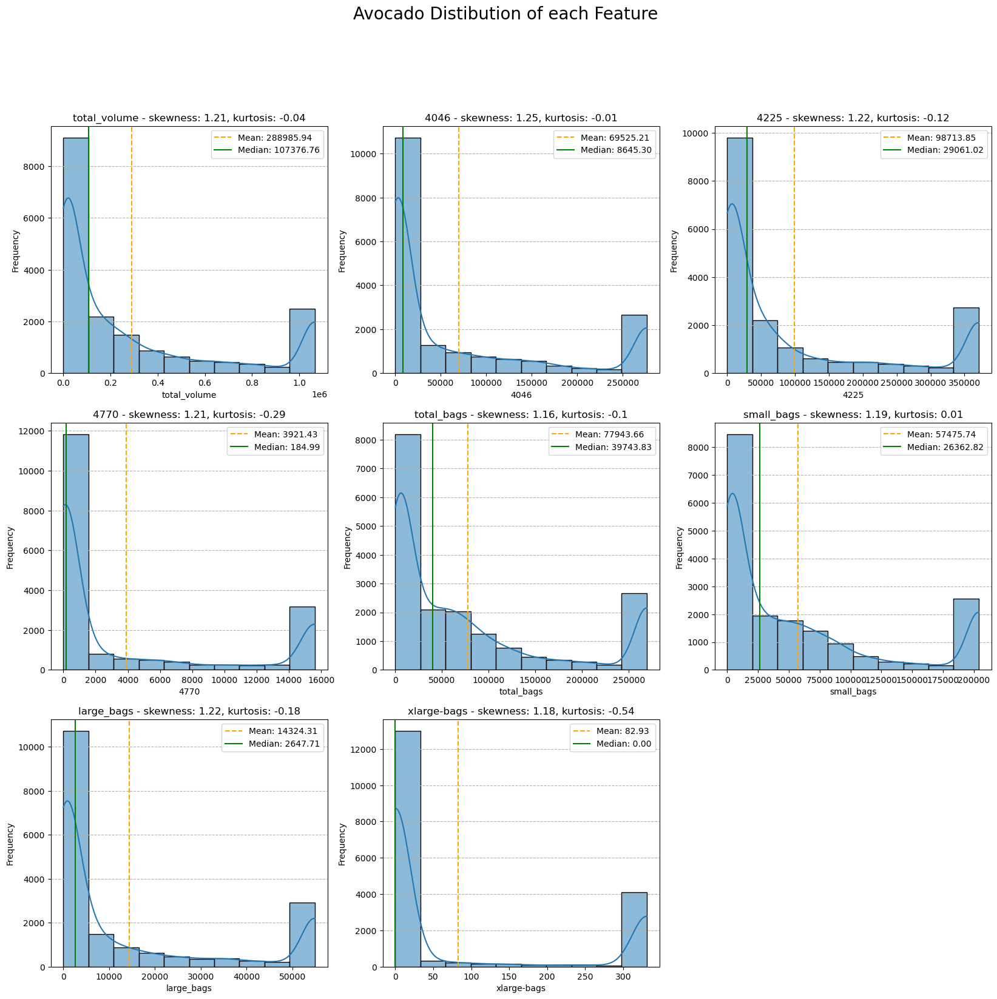

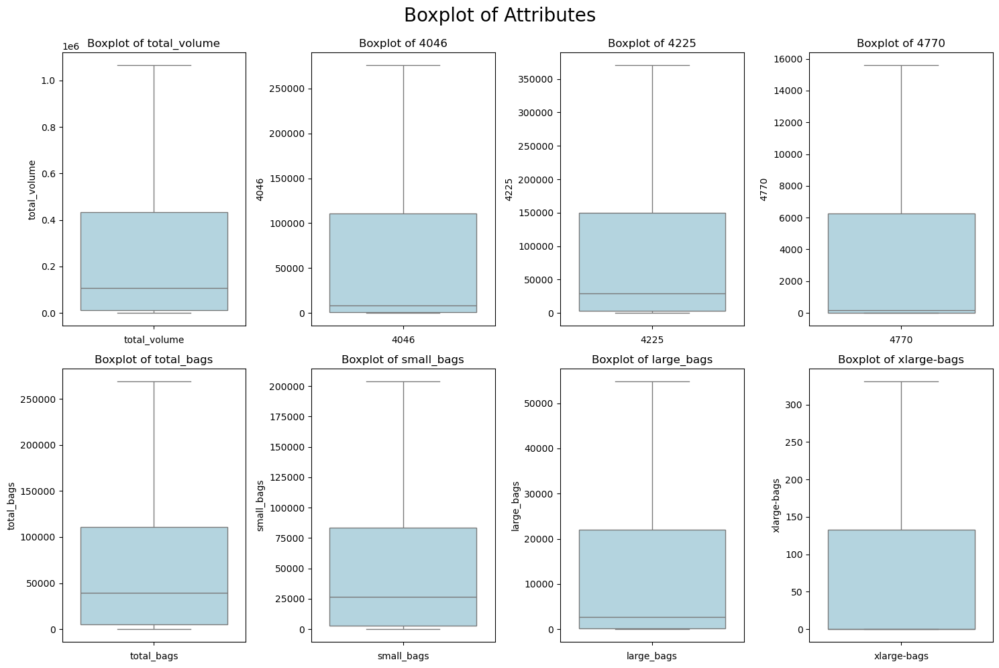

In [105]:
###############################################
# print original skewness and kurtosis
###############################################
SKEWNESS = skew(df_X_features)
KURTOSIS = kurtosis(df_X_features)
shape_metric = list(np.sqrt(np.power(SKEWNESS, 2) + np.power(KURTOSIS, 2)))
sum_shape_metric = np.sum(shape_metric)

#print(f'ORIGINAL    sum_shape_metric: {sum_shape_metric} \t shape_metric: {shape_metric}')
print(f'ORIGINAL    sum_shape_metric: {sum_shape_metric} ')

###############################################
# print transformed skewness and kurtosis
###############################################
SKEWNESS_TRANSFORMED = skew(df_cleaned_features_clipped_iqr)
KURTOSIS_TRANSFORMED = kurtosis(df_cleaned_features_clipped_iqr)
shape_metric_TRANSFORMED = list(np.sqrt(np.power(SKEWNESS_TRANSFORMED, 2) + np.power(KURTOSIS_TRANSFORMED, 2)))
sum_shape_metric_TRANSFORMED = np.sum(shape_metric_TRANSFORMED)

#print(f'TRANSFORMED sum_shape_metric: {sum_shape_metric_TRANSFORMED} \t shape_metric: {shape_metric_TRANSFORMED}')
print(f'TRANSFORMED sum_shape_metric: {sum_shape_metric_TRANSFORMED}')

################################################
# call fcn - sns kde histplot
################################################
df_to_analyze = df_cleaned_features_clipped_iqr
plot_kde_histplot(df_to_analyze, False, 3, 'Avocado Distibution of each Feature')

################################################
# call fcn - sns boxplot
################################################
#df_to_analyze = df.select_dtypes(include=[np.number])
df_to_analyze = df_cleaned_features_clipped_iqr
plot_boxplot(df_to_analyze, "Boxplot of Attributes", False)

<hr style="height:10px;color:#000;background-color:#F0F;">

# <span style="color: blue;"> <b><u> Create Holdout, Standardize Dataframe, Model Data, Evaluate Performance </b></u></span>  


creating hold-out set and standardizing dataset...
X_train: (14599, 8)
y_train: 14599

X_test: (3650, 8)
y_test: 3650

Done! Visualizing dataset before and after standardization and outlier transformation...


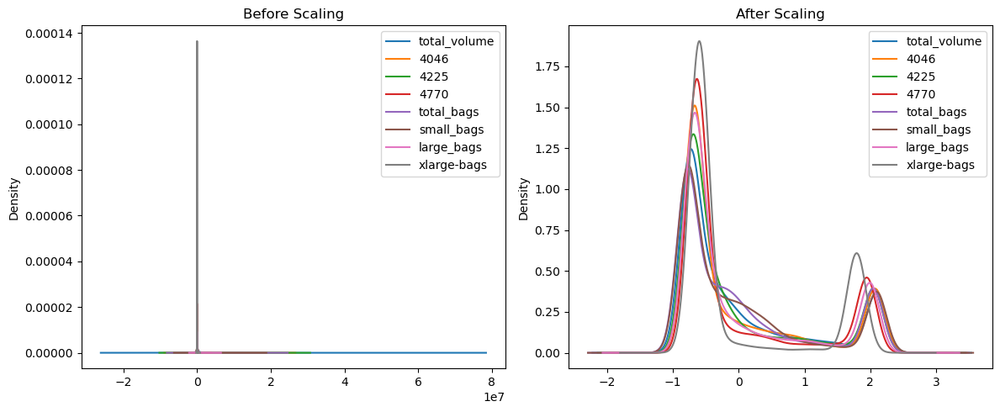


Done! Initiating data modeling!
instantiating models...
model instantiation complete!


Processing Model:   0%|                                                   | 0/35 [00:00<?, ?model/s]



######################################################################
# training model --> ada_boost_regressor
######################################################################
hyperparameters --> {'estimator': None, 'learning_rate': 1.0, 'loss': 'linear', 'n_estimators': 50, 'random_state': 42}



Processing Model:   3%|█▏                                         | 1/35 [00:08<04:38,  8.19s/model]

training model ada_boost_regressor complete! 	R2: 0.3454	analysis_duration --> 0:00:08.184067



######################################################################
# training model --> ard_regressor
######################################################################
hyperparameters --> {'alpha_1': 1e-06, 'alpha_2': 1e-06, 'compute_score': False, 'copy_X': True, 'fit_intercept': True, 'lambda_1': 1e-06, 'lambda_2': 1e-06, 'max_iter': 300, 'threshold_lambda': 10000.0, 'tol': 0.001, 'verbose': False}



Processing Model:   6%|██▍                                        | 2/35 [00:08<02:00,  3.65s/model]

training model ard_regressor complete! 	R2: 0.2969	analysis_duration --> 0:00:00.468076



######################################################################
# training model --> bayesian_ridge_regressor
######################################################################
hyperparameters --> {'alpha_1': 1e-06, 'alpha_2': 1e-06, 'alpha_init': None, 'compute_score': False, 'copy_X': True, 'fit_intercept': True, 'lambda_1': 1e-06, 'lambda_2': 1e-06, 'lambda_init': None, 'max_iter': 300, 'tol': 0.001, 'verbose': False}



Processing Model:   9%|███▋                                       | 3/35 [00:08<01:07,  2.12s/model]

training model bayesian_ridge_regressor complete! 	R2: 0.2967	analysis_duration --> 0:00:00.275674



######################################################################
# training model --> decision_tree_regressor
######################################################################
hyperparameters --> {'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'random_state': 42, 'splitter': 'best'}



Processing Model:  11%|████▉                                      | 4/35 [00:11<01:05,  2.13s/model]

training model decision_tree_regressor complete! 	R2: 0.5162	analysis_duration --> 0:00:02.130242



######################################################################
# training model --> decision_tree_pruned_regressor
######################################################################
hyperparameters --> {'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': 5, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'random_state': 42, 'splitter': 'best'}



Processing Model:  14%|██████▏                                    | 5/35 [00:12<00:50,  1.70s/model]

training model decision_tree_pruned_regressor complete! 	R2: 0.4763	analysis_duration --> 0:00:00.929447



######################################################################
# training model --> elasticnet_regressor
######################################################################
hyperparameters --> {'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}



Processing Model:  17%|███████▎                                   | 6/35 [00:12<00:35,  1.22s/model]

training model elasticnet_regressor complete! 	R2: -0.0002	analysis_duration --> 0:00:00.291471



######################################################################
# training model --> elasticnet_regressor_2
######################################################################
hyperparameters --> {'alpha': 0.1, 'copy_X': True, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}



Processing Model:  20%|████████▌                                  | 7/35 [00:12<00:26,  1.06model/s]

training model elasticnet_regressor_2 complete! 	R2: 0.2731	analysis_duration --> 0:00:00.341761



######################################################################
# training model --> elasticnet_regressor_cv
######################################################################
hyperparameters --> {'alphas': None, 'copy_X': True, 'cv': None, 'eps': 0.001, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'n_alphas': 100, 'n_jobs': None, 'positive': False, 'precompute': 'auto', 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'verbose': 0}



Processing Model:  23%|█████████▊                                 | 8/35 [00:16<00:50,  1.87s/model]

training model elasticnet_regressor_cv complete! 	R2: 0.2968	analysis_duration --> 0:00:03.851112



######################################################################
# training model --> elastic_regressor_cv_2
######################################################################
hyperparameters --> {'alphas': [0.5], 'copy_X': True, 'cv': 11, 'eps': 0.001, 'fit_intercept': True, 'l1_ratio': 0.5, 'max_iter': 1000, 'n_alphas': 100, 'n_jobs': -1, 'positive': False, 'precompute': 'auto', 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'verbose': 0}



Processing Model:  26%|███████████                                | 9/35 [00:18<00:47,  1.82s/model]

training model elastic_regressor_cv_2 complete! 	R2: -0.0002	analysis_duration --> 0:00:01.680076



######################################################################
# training model --> extra_trees_regressor
######################################################################
hyperparameters --> {'bootstrap': False, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}



Processing Model:  29%|████████████                              | 10/35 [01:02<06:11, 14.87s/model]

training model extra_trees_regressor complete! 	R2: 0.7349	analysis_duration --> 0:00:44.096760



######################################################################
# training model --> gradient_boosting_regressor_1
######################################################################
hyperparameters --> {'alpha': 0.9, 'ccp_alpha': 0.0, 'criterion': 'friedman_mse', 'init': None, 'learning_rate': 0.1, 'loss': 'squared_error', 'max_depth': 3, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'n_estimators': 100, 'n_iter_no_change': None, 'random_state': 42, 'subsample': 1.0, 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': False, 'warm_start': False}



Processing Model:  31%|█████████████▏                            | 11/35 [01:39<08:39, 21.65s/model]

training model gradient_boosting_regressor_1 complete! 	R2: 0.5646	analysis_duration --> 0:00:37.007226



######################################################################
# training model --> gradient_boosting_regressor_2
######################################################################
hyperparameters --> {'alpha': 0.9, 'ccp_alpha': 0.0, 'criterion': 'friedman_mse', 'init': None, 'learning_rate': 0.01, 'loss': 'squared_error', 'max_depth': 2, 'max_features': None, 'max_leaf_nodes': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.5, 'n_estimators': 300, 'n_iter_no_change': None, 'random_state': 42, 'subsample': 1.0, 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False}



Processing Model:  34%|██████████████▍                           | 12/35 [02:14<09:51, 25.74s/model]

training model gradient_boosting_regressor_2 complete! 	R2: -0.0002	analysis_duration --> 0:00:35.071838



######################################################################
# training model --> hist_gradient_boosting_regressor
######################################################################
hyperparameters --> {'categorical_features': 'warn', 'early_stopping': 'auto', 'interaction_cst': None, 'l2_regularization': 0.0, 'learning_rate': 0.1, 'loss': 'squared_error', 'max_bins': 255, 'max_depth': None, 'max_features': 1.0, 'max_iter': 100, 'max_leaf_nodes': 31, 'min_samples_leaf': 20, 'monotonic_cst': None, 'n_iter_no_change': 10, 'quantile': None, 'random_state': 42, 'scoring': 'loss', 'tol': 1e-07, 'validation_fraction': 0.1, 'verbose': 0, 'warm_start': False}



Processing Model:  37%|███████████████▌                          | 13/35 [02:19<07:07, 19.41s/model]

training model hist_gradient_boosting_regressor complete! 	R2: 0.6729	analysis_duration --> 0:00:04.848748



######################################################################
# training model --> huber_regressor
######################################################################
hyperparameters --> {'alpha': 0.0001, 'epsilon': 1.35, 'fit_intercept': True, 'max_iter': 100, 'tol': 1e-05, 'warm_start': False}



Processing Model:  40%|████████████████▊                         | 14/35 [02:20<04:51, 13.89s/model]

training model huber_regressor complete! 	R2: 0.2926	analysis_duration --> 0:00:01.131763



######################################################################
# training model --> knn_regressor_1
######################################################################
hyperparameters --> {'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': None, 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}



Processing Model:  43%|██████████████████                        | 15/35 [02:21<03:23, 10.16s/model]

training model knn_regressor_1 complete! 	R2: 0.6479	analysis_duration --> 0:00:01.506664



######################################################################
# training model --> knn_regressor_2
######################################################################
hyperparameters --> {'algorithm': 'auto', 'leaf_size': 30, 'metric': 'minkowski', 'metric_params': None, 'n_jobs': None, 'n_neighbors': 5, 'p': 2, 'weights': 'uniform'}



Processing Model:  46%|███████████████████▏                      | 16/35 [02:23<02:25,  7.64s/model]

training model knn_regressor_2 complete! 	R2: 0.6479	analysis_duration --> 0:00:01.773485



######################################################################
# training model --> linear_regressor
######################################################################
hyperparameters --> {'copy_X': True, 'fit_intercept': True, 'n_jobs': None, 'positive': False}



Processing Model:  49%|████████████████████▍                     | 17/35 [02:24<01:38,  5.47s/model]

training model linear_regressor complete! 	R2: 0.2967	analysis_duration --> 0:00:00.411814



######################################################################
# training model --> lasso_regressor
######################################################################
hyperparameters --> {'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}



Processing Model:  51%|█████████████████████▌                    | 18/35 [02:24<01:06,  3.90s/model]

training model lasso_regressor complete! 	R2: -0.0002	analysis_duration --> 0:00:00.239740



######################################################################
# training model --> lasso_regressor_cv
######################################################################
hyperparameters --> {'alphas': [1], 'copy_X': True, 'cv': 11, 'eps': 0.001, 'fit_intercept': True, 'max_iter': 1000, 'n_alphas': 100, 'n_jobs': -1, 'positive': False, 'precompute': 'auto', 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'verbose': False}



Processing Model:  54%|██████████████████████▊                   | 19/35 [02:25<00:47,  2.99s/model]

training model lasso_regressor_cv complete! 	R2: -0.0002	analysis_duration --> 0:00:00.829974



######################################################################
# training model --> lasso_regressor_2
######################################################################
hyperparameters --> {'alpha': 0.1, 'copy_X': True, 'fit_intercept': True, 'max_iter': 1000, 'positive': False, 'precompute': False, 'random_state': 42, 'selection': 'cyclic', 'tol': 0.0001, 'warm_start': False}



Processing Model:  57%|████████████████████████                  | 20/35 [02:25<00:32,  2.17s/model]

training model lasso_regressor_2 complete! 	R2: 0.2207	analysis_duration --> 0:00:00.268478



######################################################################
# training model --> lgbm_regressor
######################################################################
hyperparameters --> {'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 1.0, 'importance_type': 'split', 'learning_rate': 0.1, 'max_depth': -1, 'min_child_samples': 20, 'min_child_weight': 0.001, 'min_split_gain': 0.0, 'n_estimators': 100, 'n_jobs': None, 'num_leaves': 31, 'objective': None, 'random_state': 42, 'reg_alpha': 0.0, 'reg_lambda': 0.0, 'subsample': 1.0, 'subsample_for_bin': 200000, 'subsample_freq': 0}

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.020216 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2040
[LightGBM] [Info] Number of data points in the train set: 14599, number of used features: 8
[Lig

Processing Model:  60%|█████████████████████████▏                | 21/35 [02:28<00:32,  2.31s/model]

training model lgbm_regressor complete! 	R2: 0.6758	analysis_duration --> 0:00:02.622421



######################################################################
# training model --> mlp_regressor_1
######################################################################
hyperparameters --> {'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'early_stopping': False, 'epsilon': 1e-08, 'hidden_layer_sizes': (100,), 'learning_rate': 'constant', 'learning_rate_init': 0.001, 'max_fun': 15000, 'max_iter': 100, 'momentum': 0.9, 'n_iter_no_change': 10, 'nesterovs_momentum': True, 'power_t': 0.5, 'random_state': 42, 'shuffle': True, 'solver': 'adam', 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': False, 'warm_start': False}



Processing Model:  63%|██████████████████████████▍               | 22/35 [03:14<03:21, 15.50s/model]

training model mlp_regressor_1 complete! 	R2: 0.5135	analysis_duration --> 0:00:46.254962



######################################################################
# training model --> ransac_regressor
######################################################################
hyperparameters --> {'estimator': None, 'is_data_valid': None, 'is_model_valid': None, 'loss': 'absolute_error', 'max_skips': inf, 'max_trials': 100, 'min_samples': None, 'random_state': 42, 'residual_threshold': None, 'stop_n_inliers': inf, 'stop_probability': 0.99, 'stop_score': inf}



Processing Model:  66%|███████████████████████████▌              | 23/35 [03:16<02:16, 11.41s/model]

training model ransac_regressor complete! 	R2: -14.2797	analysis_duration --> 0:00:01.844620



######################################################################
# training model --> ridge_regressor
######################################################################
hyperparameters --> {'alpha': 1.0, 'copy_X': True, 'fit_intercept': True, 'max_iter': None, 'positive': False, 'random_state': 42, 'solver': 'auto', 'tol': 0.0001}



Processing Model:  69%|████████████████████████████▊             | 24/35 [03:16<01:29,  8.12s/model]

training model ridge_regressor complete! 	R2: 0.2967	analysis_duration --> 0:00:00.424298



######################################################################
# training model --> ridge_regressor_cv
######################################################################
hyperparameters --> {'alpha_per_target': False, 'alphas': [2], 'cv': 11, 'fit_intercept': True, 'gcv_mode': None, 'scoring': None, 'store_cv_results': None, 'store_cv_values': 'deprecated'}



Processing Model:  71%|██████████████████████████████            | 25/35 [03:17<00:59,  5.90s/model]

training model ridge_regressor_cv complete! 	R2: 0.2967	analysis_duration --> 0:00:00.724564



######################################################################
# training model --> ridge_regressor_2
######################################################################
hyperparameters --> {'alpha': 1, 'copy_X': True, 'fit_intercept': True, 'max_iter': None, 'positive': False, 'random_state': 42, 'solver': 'cholesky', 'tol': 0.0001}



Processing Model:  74%|███████████████████████████████▏          | 26/35 [03:17<00:37,  4.20s/model]

training model ridge_regressor_2 complete! 	R2: 0.2967	analysis_duration --> 0:00:00.220097



######################################################################
# training model --> svm_regressor_linear_1
######################################################################
hyperparameters --> {'C': 1.0, 'dual': 'auto', 'epsilon': 0.0, 'fit_intercept': True, 'intercept_scaling': 1.0, 'loss': 'epsilon_insensitive', 'max_iter': 1000, 'random_state': None, 'tol': 0.0001, 'verbose': 0}



Processing Model:  77%|████████████████████████████████▍         | 27/35 [03:20<00:30,  3.78s/model]

training model svm_regressor_linear_1 complete! 	R2: 0.2856	analysis_duration --> 0:00:02.808430



######################################################################
# training model --> svm_regressor_linear_2
######################################################################
hyperparameters --> {'C': 1.0, 'dual': 'auto', 'epsilon': 1.5, 'fit_intercept': True, 'intercept_scaling': 1.0, 'loss': 'epsilon_insensitive', 'max_iter': 1000, 'random_state': None, 'tol': 0.0001, 'verbose': 0}



Processing Model:  80%|█████████████████████████████████▌        | 28/35 [03:20<00:19,  2.72s/model]

training model svm_regressor_linear_2 complete! 	R2: -0.1470	analysis_duration --> 0:00:00.234122



######################################################################
# training model --> theil_sen_regressor
######################################################################
hyperparameters --> {'copy_X': True, 'fit_intercept': True, 'max_iter': 500, 'max_subpopulation': 10000, 'n_jobs': -1, 'n_subsamples': None, 'random_state': None, 'tol': 0.001, 'verbose': False}



Processing Model:  83%|██████████████████████████████████▊       | 29/35 [04:14<01:48, 18.13s/model]

training model theil_sen_regressor complete! 	R2: -0.4904	analysis_duration --> 0:00:54.066371



######################################################################
# training model --> xgb_regressor_1
######################################################################
hyperparameters --> {'objective': 'reg:squarederror', 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': None, 'device': None, 'early_stopping_rounds': None, 'enable_categorical': False, 'eval_metric': None, 'feature_types': None, 'gamma': None, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': None, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': None, 'max_leaves': None, 'min_child_weight': None, 'missing': nan, 'monotone_constraints': None, 'multi_strategy': None, 'n_estimators': None, 'n_jobs': None, 'num_parallel_tree': None, 'r

Processing Model:  86%|████████████████████████████████████      | 30/35 [04:17<01:08, 13.60s/model]

training model xgb_regressor_1 complete! 	R2: 0.6937	analysis_duration --> 0:00:03.035324



######################################################################
# training model --> xgb_regressor_2
######################################################################
hyperparameters --> {'objective': 'reg:squarederror', 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': None, 'device': None, 'early_stopping_rounds': None, 'enable_categorical': False, 'eval_metric': 'logloss', 'feature_types': None, 'gamma': None, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': None, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': None, 'max_leaves': None, 'min_child_weight': None, 'missing': nan, 'monotone_constraints': None, 'multi_strategy': None, 'n_estimators': None, 'n_jobs': None, 'num_parallel_tree': None, 'r

Processing Model:  89%|█████████████████████████████████████▏    | 31/35 [04:20<00:41, 10.35s/model]

training model xgb_regressor_2 complete! 	R2: 0.6937	analysis_duration --> 0:00:02.743354



######################################################################
# training model --> random_forest_regressor
######################################################################
hyperparameters --> {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 1, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': -1, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}



Processing Model:  91%|██████████████████████████████████████▍   | 32/35 [06:01<01:52, 37.36s/model]

training model random_forest_regressor complete! 	R2: 0.7327	analysis_duration --> 0:01:40.381868



######################################################################
# training model --> random_forest_regressor_2
######################################################################
hyperparameters --> {'bootstrap': True, 'ccp_alpha': 0.0, 'criterion': 'squared_error', 'max_depth': None, 'max_features': 1.0, 'max_leaf_nodes': None, 'max_samples': None, 'min_impurity_decrease': 0.0, 'min_samples_leaf': 5, 'min_samples_split': 2, 'min_weight_fraction_leaf': 0.0, 'monotonic_cst': None, 'n_estimators': 100, 'n_jobs': None, 'oob_score': False, 'random_state': 42, 'verbose': 0, 'warm_start': False}



Processing Model:  94%|███████████████████████████████████████▌  | 33/35 [07:14<01:36, 48.28s/model]

training model random_forest_regressor_2 complete! 	R2: 0.7181	analysis_duration --> 0:01:13.746002



######################################################################
# training model --> mlp_regressor_2
######################################################################
hyperparameters --> {'activation': 'relu', 'alpha': 0.0001, 'batch_size': 'auto', 'beta_1': 0.9, 'beta_2': 0.999, 'early_stopping': False, 'epsilon': 1e-08, 'hidden_layer_sizes': (200,), 'learning_rate': 'constant', 'learning_rate_init': 0.001, 'max_fun': 15000, 'max_iter': 400, 'momentum': 0.9, 'n_iter_no_change': 10, 'nesterovs_momentum': True, 'power_t': 0.5, 'random_state': 42, 'shuffle': True, 'solver': 'adam', 'tol': 0.0001, 'validation_fraction': 0.1, 'verbose': False, 'warm_start': False}



Processing Model:  97%|████████████████████████████████████████▊ | 34/35 [08:23<00:54, 54.51s/model]

training model mlp_regressor_2 complete! 	R2: 0.5319	analysis_duration --> 0:01:09.033382



######################################################################
# training model --> catboost_regressor
######################################################################
hyperparameters --> {'loss_function': 'RMSE', 'verbose': 0, 'random_state': 42}



Processing Model: 100%|██████████████████████████████████████████| 35/35 [09:23<00:00, 16.10s/model]

training model catboost_regressor complete! 	R2: 0.7080	analysis_duration --> 0:00:59.656978




******************************************************************************************
* model training COMPLETE!
******************************************************************************************

Done! Sorting and saving data...


,model_name,r2,adjusted_r2,cross_validated_r2,explained_variance_score,rmse,rmsle,mae,mape,mse,msle,mase,smape,med_ae,huber_loss,mbd,cv_rmse,r2_residuals,durbin_watson_stat,start_time,end_time,analysis_duration_text,analysis_duration
0,extra_trees_regressor,0.7349,0.7343,0.7459,0.7354,0.2064,0.0832,0.1456,0.1088,0.0426,0.0069,0.3141,0.1048,0.1030,0.261,0.0083,0.1463,-12.2596,1.9991,2025-02-24-0806,2025-02-24-0807,"0 day(s), 0 hour(s), 0 minute(s), 44 second(s)",0:00:44.096760
1,random_forest_regressor,0.7327,0.7321,0.7371,0.7330,0.2072,0.0838,0.1488,0.1112,0.0429,0.0070,0.3210,0.1073,0.1084,0.261,0.0062,0.1469,-12.2042,2.0024,2025-02-24-0811,2025-02-24-0812,"0 day(s), 0 hour(s), 1 minute(s), 40 second(s)",0:01:40.381868
2,random_forest_regressor_2,0.7181,0.7175,0.7265,0.7183,0.2128,0.0858,0.1536,0.1146,0.0453,0.0074,0.3314,0.1105,0.1127,0.261,0.0053,0.1509,-12.1604,2.0085,2025-02-24-0812,2025-02-24-0813,"0 day(s), 0 hour(s), 1 minute(s), 13 second(s)",0:01:13.746002
3,catboost_regressor,0.7080,0.7073,0.7195,0.7081,0.2166,0.0876,0.1597,0.1191,0.0469,0.0077,0.3446,0.1153,0.1227,0.261,0.0038,0.1536,-12.1391,2.0195,2025-02-24-0815,2025-02-24-0816,"0 day(s), 0 hour(s), 0 minute(s), 59 second(s)",0:00:59.656978
4,xgb_regressor_2,0.6937,0.6930,0.7049,0.6939,0.2218,0.0896,0.1635,0.1216,0.0492,0.0080,0.3527,0.1176,0.1215,0.261,0.0052,0.1573,-12.2109,2.0202,2025-02-24-0810,2025-02-24-0811,"0 day(s), 0 hour(s), 0 minute(s), 2 second(s)",0:00:02.743354
5,xgb_regressor_1,0.6937,0.6930,0.7049,0.6939,0.2218,0.0896,0.1635,0.1216,0.0492,0.0080,0.3527,0.1176,0.1215,0.261,0.0052,0.1573,-12.2109,2.0202,2025-02-24-0810,2025-02-24-0810,"0 day(s), 0 hour(s), 0 minute(s), 3 second(s)",0:00:03.035324
6,lgbm_regressor,0.6758,0.6750,0.6907,0.6758,0.2282,0.0923,0.1699,0.1271,0.0521,0.0085,0.3666,0.1224,0.1305,0.261,0.0037,0.1618,-12.0730,2.0058,2025-02-24-0809,2025-02-24-0809,"0 day(s), 0 hour(s), 0 minute(s), 2 second(s)",0:00:02.622421
7,hist_gradient_boosting_regressor,0.6729,0.6722,0.6876,0.6731,0.2292,0.0925,0.1707,0.1274,0.0525,0.0086,0.3682,0.1228,0.1289,0.261,0.0044,0.1625,-12.0961,1.9992,2025-02-24-0808,2025-02-24-0809,"0 day(s), 0 hour(s), 0 minute(s), 4 second(s)",0:00:04.848748
8,knn_regressor_2,0.6479,0.6471,0.6682,0.6496,0.2378,0.0954,0.1666,0.1247,0.0566,0.0091,0.3595,0.1184,0.1160,0.261,0.0166,0.1686,-12.4340,1.9598,2025-02-24-0809,2025-02-24-0809,"0 day(s), 0 hour(s), 0 minute(s), 1 second(s)",0:00:01.773485
9,knn_regressor_1,0.6479,0.6471,0.6682,0.6496,0.2378,0.0954,0.1666,0.1247,0.0566,0.0091,0.3595,0.1184,0.1160,0.261,0.0166,0.1686,-12.4340,1.9598,2025-02-24-0809,2025-02-24-0809,"0 day(s), 0 hour(s), 0 minute(s), 1 second(s)",0:00:01.506664



Done! Plotting performance metrics...




ALL ACTIONS COMPLETE!!!


CPU times: user 8min 14s, sys: 5.94 s, total: 8min 20s
Wall time: 9min 33s


In [106]:
%%time

#################################################################################
# set X
#################################################################################
df_X_to_standardize = df_cleaned_features_clipped_iqr

#################################################################################
# Create holdout set and standardize data
#################################################################################
# create hold out set and standardize the data
print('\ncreating hold-out set and standardizing dataset...')
X_train_scaled, X_test_scaled, y_train, y_test = standardize_dataset(df_X_to_standardize, y_cleaned, 0.20, 42, dict_standard_scalers, 'clipped_iqr')

#################################################################################
# Visualize the new data
#################################################################################
print('\nDone! Visualizing dataset before and after standardization and outlier transformation...')
try:
    fig, axes = plt.subplots(1, 2, figsize=(12, 5))
    
    # Before scaling
    X_train.plot(kind='kde', ax=axes[0], title="Before Scaling")
    
    # After scaling
    X_train_scaled.plot(kind='kde', ax=axes[1], title="After Scaling")
    
    plt.tight_layout()
    plt.show()
    
    
except:
    pass

#################################################################################
# train the models!
#################################################################################
print('\nDone! Initiating data modeling!')
df_model_evaluation_metrics_clipped_iqr, dict_completed_models_clipped_iqr, lst_error_model_clipped_iqr = instantiate_and_model_data(X_train_scaled, X_test_scaled, y_train, y_test)

#################################################################################
# View Model Performance
#################################################################################
print('\nDone! Sorting and saving data...')
# sort models by r2
df_model_evaluation_metrics_clipped_iqr = df_model_evaluation_metrics_clipped_iqr.sort_values(by='r2', ascending=False, inplace=False)
df_model_evaluation_metrics_clipped_iqr = df_model_evaluation_metrics_clipped_iqr.reset_index(drop=True, inplace=False)


#save df
df_model_evaluation_metrics_clipped_iqr.to_csv('./model_performance_after_outlier_transformation_clipped_iqr.csv', index=False)

# view df
#df_model_evaluation_metrics_clipped_iqr.style.format(precision=3, thousands=",", decimal=".").format_index(str.upper, axis=1)
#df_model_evaluation_metrics_clipped_iqr.style.format(precision=3, thousands=",", decimal=".").format_index(str.lower, axis=1)
styled_df = df_model_evaluation_metrics_clipped_iqr.style.format(precision=3, thousands=",", decimal=".").format_index(str.lower, axis=1)
display(HTML(styled_df.to_html()))


#################################################################################
# Sort model data for charting
#################################################################################
print('\nDone! Plotting performance metrics...')
# plot in ascending order
df_model_evaluation_metrics_sorted_clipped_iqr = df_model_evaluation_metrics_clipped_iqr.sort_values(by='r2', ascending=True, inplace=False)
df_model_evaluation_metrics_sorted_clipped_iqr = df_model_evaluation_metrics_sorted_clipped_iqr.reset_index(drop=True, inplace=False)

# soft dict of models for displaying feature importance below
dict_completed_models_sorted_clipped_iqr = dict()

lst_sorted_models_clipped_iqr = list(df_model_evaluation_metrics_sorted_clipped_iqr['model_name'])[::-1]


#################################################################################
# Plot Model Performance
#################################################################################
fig = go.Figure()

fig.add_trace(go.Bar(
    y=df_model_evaluation_metrics_sorted_clipped_iqr['model_name'],  
    x=df_model_evaluation_metrics_sorted_clipped_iqr['r2'],  
    orientation='h',  # Horizontal bar chart
    marker=dict(color='blue', line=dict(color='black', width=1)),  
))

# Update layout with dashed vertical gridlines
fig.update_layout(
    title="Model Performance Based on R-squared",
    xaxis_title="R-squared",
    yaxis_title="Model Name",
    xaxis=dict(
        showgrid=True, 
        zeroline=True,
        gridcolor='lightgray',  
        gridwidth=0.5,      
        griddash='dash'      
    ),
    yaxis=dict(tickmode='linear'),
    height=900, width=1300,  
    plot_bgcolor="white",  
    paper_bgcolor="white"   
)

# Show plot
fig.show()



#################################################################################
# notify
#################################################################################
print('\n\nALL ACTIONS COMPLETE!!!\n\n')

<hr style="height:30px;color:#000;background-color:#000;">

# <b> Review Model Evaluation - Select Best Model  </b>

In [107]:
def get_model(df_model_evaluation_metrics, dict_completed_models, outlier_transformation_description, dict_top_models):
    try:
        top_model_name = df_model_evaluation_metrics.iloc[0].model_name
        top_model_r2 = df_model_evaluation_metrics.iloc[0].r2
        top_model = dict_completed_models[top_model_name]

        # get dataframe of only top model's metrics
        df_model_evaluation_metrics = df_model_evaluation_metrics[df_model_evaluation_metrics['model_name'] == top_model_name]

        # add outlier transformation description
        df_model_evaluation_metrics.insert(0, 'outlier_transformation', outlier_transformation_description)

        # store the top model for future reference
        dict_top_models[outlier_transformation_description] = top_model

        return top_model_name, top_model_r2, top_model, df_model_evaluation_metrics
    except Exception as e:
        print('\n\n* * * EXCEPTION caught in get_model mtd')
        print(f"Exception message: {e}")  # Print the exception message
        traceback.print_exc()  # Print the full stack trace

In [108]:
# create dictionary of top models
dict_top_models = dict()

# get top model before outlier transformations
top_model_name_before_outlier_transformation, top_model_r2_before_outlier_transformation, top_model_before_outlier_transformation, df_top_model_evaluation_metrics_before_outlier_transformation = get_model(df_model_evaluation_metrics, dict_completed_models, 'before_transformation', dict_top_models)

# get top model _iqr transformation
top_model_name_iqr_outlier_transformation, top_model_r2_iqr_outlier_transformation, top_model_iqr_outlier_transformation, df_top_model_evaluation_metrics_iqr_outlier_transformation = get_model(df_model_evaluation_metrics_iqr, dict_completed_models_iqr, 'iqr', dict_top_models)

# get top model _zscore transformation
top_model_name_zscore_outlier_transformation, top_model_r2_zscore_outlier_transformation, top_model_zscore_outlier_transformation, df_top_model_evaluation_metrics_zscore_outlier_transformation = get_model(df_model_evaluation_metrics_zscore, dict_completed_models_zscore, 'zscore', dict_top_models)

# get top model _modified_zscore_mad transformation
top_model_name_modified_zscore_mad_outlier_transformation, top_model_r2_modified_zscore_mad_outlier_transformation, top_model_modified_zscore_mad_outlier_transformation, df_top_model_evaluation_metrics_zscore_mad_outlier_transformation = get_model(df_model_evaluation_metrics_modified_zscore_mad, dict_completed_models_modified_zscore_mad, 'modified_zscore_mad', dict_top_models)

# get top model _dbscan transformation
top_model_name_dbscan_outlier_transformation, top_model_r2_dbscan_outlier_transformation, top_model_dbscan_outlier_transformation, df_top_model_evaluation_metrics_dbscan_outlier_transformation = get_model(df_model_evaluation_metrics_dbscan, dict_completed_models_dbscan, 'dbscan', dict_top_models)

# get top model _clipped_iqr transformation
top_model_name_clipped_iqr_outlier_transformation, top_model_r2_clipped_iqr_outlier_transformation, top_model_clipped_iqr_outlier_transformation, df_top_model_evaluation_metrics_clipped_iqr_outlier_transformation = get_model(df_model_evaluation_metrics_clipped_iqr, dict_completed_models_clipped_iqr, 'clipped_iqr', dict_top_models)



# display stats
print('top_model_name\t\t r2\t\t model\t\t\t\t\t model_description')
print(top_model_name_before_outlier_transformation, '\t', top_model_r2_before_outlier_transformation, '\t', top_model_before_outlier_transformation, '\t', 'before_outlier_transformation')
print(top_model_name_iqr_outlier_transformation, '\t', top_model_r2_iqr_outlier_transformation, '\t', top_model_iqr_outlier_transformation, '\t', 'iqr_outlier_transformation')
print(top_model_name_zscore_outlier_transformation, '\t', top_model_r2_zscore_outlier_transformation, '\t', top_model_zscore_outlier_transformation, '\t', 'zscore_outlier_transformation')
print(top_model_name_modified_zscore_mad_outlier_transformation, '\t', top_model_r2_modified_zscore_mad_outlier_transformation, '\t', top_model_modified_zscore_mad_outlier_transformation, '\t', 'modified_zscore_mad_outlier_transformation')
print(top_model_name_dbscan_outlier_transformation, '\t', top_model_r2_dbscan_outlier_transformation, '\t', top_model_dbscan_outlier_transformation, '\t', 'dbscan_outlier_transformation')
print(top_model_name_clipped_iqr_outlier_transformation, '\t', top_model_r2_clipped_iqr_outlier_transformation, '\t', top_model_clipped_iqr_outlier_transformation, '\t', 'clipped_iqr_outlier_transformation')

print('\ndict_top_mdels entries:')
print('='*40)
for key in dict_top_models.keys():
    print(f'{key}, {dict_top_models[key]}')



top_model_name		 r2		 model					 model_description
extra_trees_regressor 	 0.7657 	 ExtraTreesRegressor(random_state=42) 	 before_outlier_transformation
extra_trees_regressor 	 0.6825 	 ExtraTreesRegressor(random_state=42) 	 iqr_outlier_transformation
extra_trees_regressor 	 0.7732 	 ExtraTreesRegressor(random_state=42) 	 zscore_outlier_transformation
extra_trees_regressor 	 0.5823 	 ExtraTreesRegressor(random_state=42) 	 modified_zscore_mad_outlier_transformation
extra_trees_regressor 	 0.7288 	 ExtraTreesRegressor(random_state=42) 	 dbscan_outlier_transformation
extra_trees_regressor 	 0.7349 	 ExtraTreesRegressor(random_state=42) 	 clipped_iqr_outlier_transformation

dict_top_mdels entries:
before_transformation, ExtraTreesRegressor(random_state=42)
iqr, ExtraTreesRegressor(random_state=42)
zscore, ExtraTreesRegressor(random_state=42)
modified_zscore_mad, ExtraTreesRegressor(random_state=42)
dbscan, ExtraTreesRegressor(random_state=42)
clipped_iqr, ExtraTreesRegressor(random_state=4

# Create Merged Dataframe of Top Models

In [109]:
# first create the new dataframe
df_top_model_performance_metrics_combined = pd.DataFrame(columns=df_top_model_evaluation_metrics_before_outlier_transformation.columns)

# merge dataframes transformation
df_top_model_performance_metrics_combined = pd.concat([df_top_model_performance_metrics_combined, df_top_model_evaluation_metrics_before_outlier_transformation], axis=0)  # axis=1 for column-wise concatenation, # axis=0 for row-wise concatenation
df_top_model_performance_metrics_combined = pd.concat([df_top_model_performance_metrics_combined, df_top_model_evaluation_metrics_iqr_outlier_transformation], axis=0)  # axis=1 for column-wise concatenation, # axis=0 for row-wise concatenation
df_top_model_performance_metrics_combined = pd.concat([df_top_model_performance_metrics_combined, df_top_model_evaluation_metrics_zscore_outlier_transformation], axis=0)  # axis=1 for column-wise concatenation, # axis=0 for row-wise concatenation
df_top_model_performance_metrics_combined = pd.concat([df_top_model_performance_metrics_combined, df_top_model_evaluation_metrics_zscore_mad_outlier_transformation], axis=0)  # axis=1 for column-wise concatenation, # axis=0 for row-wise concatenation
df_top_model_performance_metrics_combined = pd.concat([df_top_model_performance_metrics_combined, df_top_model_evaluation_metrics_dbscan_outlier_transformation], axis=0)  # axis=1 for column-wise concatenation, # axis=0 for row-wise concatenation
df_top_model_performance_metrics_combined = pd.concat([df_top_model_performance_metrics_combined, df_top_model_evaluation_metrics_clipped_iqr_outlier_transformation], axis=0)  # axis=1 for column-wise concatenation, # axis=0 for row-wise concatenation

# sort models by r2
df_top_model_performance_metrics_combined = df_top_model_performance_metrics_combined.sort_values(by='r2', ascending=False, inplace=False)
df_top_model_performance_metrics_combined = df_top_model_performance_metrics_combined.reset_index(drop=True, inplace=False)

#save df
df_top_model_performance_metrics_combined.to_csv('./top_model_performance_combined_from_outlier_transformation.csv', index=False)

# print final results
print_df_styled_widget(df_top_model_performance_metrics_combined, 4)


,outlier_transformation,model_name,r2,adjusted_r2,cross_validated_r2,explained_variance_score,rmse,rmsle,mae,mape,mse,msle,mase,smape,med_ae,huber_loss,mbd,cv_rmse,r2_residuals,durbin_watson_stat,start_time,end_time,analysis_duration_text,analysis_duration
0,zscore,extra_trees_regressor,0.7732,0.7727,0.7618,0.7735,0.1878,0.0751,0.1306,0.0969,0.0353,0.0056,0.2956,0.0933,0.0882,0.2957,0.0065,0.1340,-12.4620,2.0112,2025-02-24-0739,2025-02-24-0740,"0 day(s), 0 hour(s), 1 minute(s), 0 second(s)",0:01:00.843443
1,before_transformation,extra_trees_regressor,0.7657,0.7652,0.7694,0.7663,0.1940,0.0766,0.1346,0.0986,0.0376,0.0059,0.2904,0.0947,0.0911,0.3139,0.0098,0.1376,-12.2819,2.0139,2025-02-24-0715,2025-02-24-0716,"0 day(s), 0 hour(s), 0 minute(s), 43 second(s)",0:00:43.667105
2,clipped_iqr,extra_trees_regressor,0.7349,0.7343,0.7459,0.7354,0.2064,0.0832,0.1456,0.1088,0.0426,0.0069,0.3141,0.1048,0.1030,0.2609,0.0083,0.1463,-12.2596,1.9991,2025-02-24-0806,2025-02-24-0807,"0 day(s), 0 hour(s), 0 minute(s), 44 second(s)",0:00:44.096760
3,dbscan,extra_trees_regressor,0.7288,0.7280,0.7383,0.7288,0.2138,0.0820,0.1463,0.1015,0.0457,0.0067,0.3242,0.0986,0.0980,0.2997,0.0015,0.1445,-12.7016,2.0774,2025-02-24-0757,2025-02-24-0758,"0 day(s), 0 hour(s), 0 minute(s), 45 second(s)",0:00:45.592145
4,iqr,extra_trees_regressor,0.6825,0.6814,0.6787,0.6842,0.2174,0.0828,0.1526,0.1031,0.0473,0.0068,0.3540,0.0991,0.1086,0.2696,0.0158,0.1411,-15.9005,2.0047,2025-02-24-0730,2025-02-24-0731,"0 day(s), 0 hour(s), 0 minute(s), 41 second(s)",0:00:41.630663
5,modified_zscore_mad,extra_trees_regressor,0.5823,0.5804,0.5754,0.5825,0.2402,0.0880,0.1677,0.1037,0.0577,0.0078,0.4083,0.1020,0.1125,0.2752,-0.0054,0.1454,-19.1720,1.9675,2025-02-24-0751,2025-02-24-0751,"0 day(s), 0 hour(s), 0 minute(s), 19 second(s)",0:00:19.275262


# <b> Select Best Model </b>

In [110]:
# create single dataframe of best model
df_best_model = df_top_model_performance_metrics_combined.iloc[[0]]
print_df_styled_widget(df_best_model, 4)

,outlier_transformation,model_name,r2,adjusted_r2,cross_validated_r2,explained_variance_score,rmse,rmsle,mae,mape,mse,msle,mase,smape,med_ae,huber_loss,mbd,cv_rmse,r2_residuals,durbin_watson_stat,start_time,end_time,analysis_duration_text,analysis_duration
0,zscore,extra_trees_regressor,0.7732,0.7727,0.7618,0.7735,0.1878,0.0751,0.1306,0.0969,0.0353,0.0056,0.2956,0.0933,0.0882,0.2957,0.0065,0.1340,-12.4620,2.0112,2025-02-24-0739,2025-02-24-0740,"0 day(s), 0 hour(s), 1 minute(s), 0 second(s)",0:01:00.843443


Best model --> extra_trees_regressor 
outlier_transformation --> zscore 
R2 --> 0.7732 
model --> ExtraTreesRegressor(random_state=42) 
model scaler --> StandardScaler()


coefficients:
4046	0.19192857052505133
total_volume	0.1747568197359546
4225	0.1418204317398782
large_bags	0.1285193360399352
total_bags	0.12747147124753355
small_bags	0.10640741366666613
4770	0.09290926895938907
xlarge-bags	0.03618668808559197


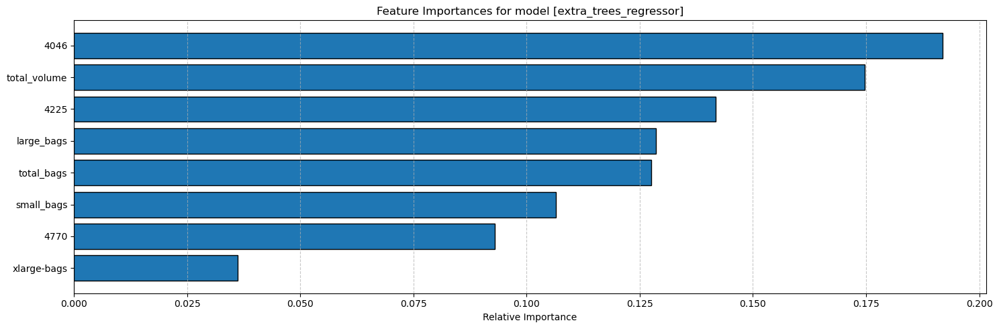

In [111]:
# select best model
best_model_name = df_top_model_performance_metrics_combined.iloc[0].model_name
best_model_outlier_transformation = df_top_model_performance_metrics_combined.iloc[0].outlier_transformation
best_model_r2 = df_top_model_performance_metrics_combined.iloc[0].r2
best_model = dict_top_models[best_model_outlier_transformation]
best_model_scaler = dict_standard_scalers[best_model_outlier_transformation]

# notify
print(f'Best model --> {best_model_name} \noutlier_transformation --> {best_model_outlier_transformation} \nR2 --> {best_model_r2} \nmodel --> {best_model} \nmodel scaler --> {best_model_scaler}\n\n')

# view feature importance
lst_coefficients, plt = display_feature_importance_chart(best_model, best_model_name, list(X_train.columns), 10, '_feature_importance_best_model_' + str(best_model_outlier_transformation) + '_' + str(best_model_name), X_test_scaled, y_test, True)



<hr style="height:30px;color:#000;background-color:#707;">

# <span style="color: purple;"> <b><u> Deploy Model </b></u></span>  

In [112]:
# get instance from X_test or format instance in the same format as data arranged in y_test
# note, use the same scaler to standardize the instance (disregard if taking from X_test and if X_test was already standardized)

# get instance (as a series) and then flatten the values from the instance just to get the data as an array ready for modeling
# here, we'll just take an index from the original dataframe of features - feel free to change this index especially to ensure
# it is an index not included in the training set
index = 0
instance = np.array(df_X_features.iloc[index]).reshape(1, -1)

# standardize the instance
instance_scaled = best_model_scaler.transform(instance) 

# get model's prediction
prediction = best_model.predict(instance_scaled) 

# notify
print(f'Avacado Price Prediction --> {round(prediction[0], 2)}')

print(f'Actual Average Avacado Price --> {df.iloc[index].average_price}')


Avacado Price Prediction --> 1.31
Actual Average Avacado Price --> 1.33
